## Germany & neighbors PV Cut Scenario due to Volcanic Eruption with 130 €/t CO2 price. Transmission Expansion is not allowed in the base model

In [1]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import xarray as xr
import seaborn as sns
import os
import re

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


# Base Scenario

## Import Network

In [2]:
country = 'DE'
buses = '20'
le = '1.0'

In [3]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.0_168h-EQ0.9c.nc")

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.0_168h-EQ0.9c.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [4]:
#gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'CZ')

In [5]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [6]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [7]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [8]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

#### Import solved model, if no changes to the model have been made

In [9]:
def import_nc_file(directory, filename):
    # Construct the full path to the .nc file
    file_path = os.path.join(directory, filename)
    
    # Open the NetCDF file using xarray
    ds = pypsa.Network(file_path)
    
    return ds
directory = os.getcwd()
dir = 'c:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes'


In [10]:
def add_EQ_constraints(n, o, scaling=1e-1):
    """
    Add equity constraints to the network.

    Currently this is only implemented for the electricity sector only.

    Opts must be specified in the config.yaml.

    Parameters
    ----------
    n : pypsa.Network
    o : str

    Example
    -------
    scenario:
        opts: [Co2L-EQ0.7-24h]

    Require each country or node to on average produce a minimal share
    of its total electricity consumption itself. Example: EQ0.7c demands each country
    to produce on average at least 70% of its consumption; EQ0.7 demands
    each node to produce on average at least 70% of its consumption.
    """
    # TODO: Generalize to cover myopic and other sectors?
    float_regex = "[0-9]*\.?[0-9]+"
    level = float(re.findall(float_regex, o)[0])
    if o[-1] == "c":
        ggrouper = n.generators.bus.map(n.buses.country)
        lgrouper = n.loads.bus.map(n.buses.country)
        sgrouper = n.storage_units.bus.map(n.buses.country)
    else:
        ggrouper = n.generators.bus
        lgrouper = n.loads.bus
        sgrouper = n.storage_units.bus
    load = (
        n.snapshot_weightings.generators
        @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
    )
    inflow = (
        n.snapshot_weightings.stores
        @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
    )
    inflow = inflow.reindex(load.index).fillna(0.0)
    rhs = scaling * (level * load - inflow)
    p = n.model["Generator-p"]
    lhs_gen = (
        (p * (n.snapshot_weightings.generators * scaling))
        .groupby(ggrouper.to_xarray())
        .sum()
        .sum("snapshot")
    )
    # TODO: double check that this is really needed, why do have to subtract the spillage
    if not n.storage_units_t.inflow.empty:
        spillage = n.model["StorageUnit-spill"]
        lhs_spill = (
            (spillage * (-n.snapshot_weightings.stores * scaling))
            .groupby(sgrouper.to_xarray())
            .sum()
            .sum("snapshot")
        )
        lhs = lhs_gen + lhs_spill
    else:
        lhs = lhs_gen
    n.model.add_constraints(lhs >= rhs, name="equity_min")

o = 'EQ0.95c'

n.optimize.create_model()
add_EQ_constraints(n, o)
n.optimize.solve_model(solver_name='gurobi')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3382802904.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3382802904.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 10/10 [00:00<00:00, 64.93it/s]
INFO:linopy.io: Writing time: 0.94s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b3wqjjvd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b3wqjjvd.lp


Reading time = 0.34 seconds


INFO:gurobipy:Reading time = 0.34 seconds


obj: 59459 rows, 27740 columns, 122554 nonzeros


INFO:gurobipy:obj: 59459 rows, 27740 columns, 122554 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59459 rows, 27740 columns and 122554 nonzeros


INFO:gurobipy:Optimize a model with 59459 rows, 27740 columns and 122554 nonzeros


Model fingerprint: 0xf7b2e745


INFO:gurobipy:Model fingerprint: 0xf7b2e745


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 43455 rows and 6535 columns


INFO:gurobipy:Presolve removed 43455 rows and 6535 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 16004 rows, 21205 columns, 66561 nonzeros


INFO:gurobipy:Presolved: 16004 rows, 21205 columns, 66561 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 40


INFO:gurobipy: Dense cols : 40


 AA' NZ     : 1.602e+05


INFO:gurobipy: AA' NZ     : 1.602e+05


 Factor NZ  : 8.005e+05 (roughly 20 MB of memory)


INFO:gurobipy: Factor NZ  : 8.005e+05 (roughly 20 MB of memory)


 Factor Ops : 1.296e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.296e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.60735748e+17 -9.54862397e+17  1.51e+10 1.76e+04  3.49e+14     0s


INFO:gurobipy:   0   4.60735748e+17 -9.54862397e+17  1.51e+10 1.76e+04  3.49e+14     0s


   1   3.31157896e+17 -6.40441862e+17  9.59e+09 1.00e+05  2.29e+14     1s


INFO:gurobipy:   1   3.31157896e+17 -6.40441862e+17  9.59e+09 1.00e+05  2.29e+14     1s


   2   1.91277330e+17 -2.05869206e+17  3.55e+09 2.60e+04  7.85e+13     1s


INFO:gurobipy:   2   1.91277330e+17 -2.05869206e+17  3.55e+09 2.60e+04  7.85e+13     1s


   3   7.91154629e+16 -3.90490027e+16  4.65e+08 5.25e+03  1.30e+13     1s


INFO:gurobipy:   3   7.91154629e+16 -3.90490027e+16  4.65e+08 5.25e+03  1.30e+13     1s


   4   1.90493768e+16 -2.11559338e+15  1.62e+07 2.41e+02  8.57e+11     1s


INFO:gurobipy:   4   1.90493768e+16 -2.11559338e+15  1.62e+07 2.41e+02  8.57e+11     1s


   5   3.61681212e+15 -9.03970651e+13  1.46e+06 8.85e-09  1.02e+11     1s


INFO:gurobipy:   5   3.61681212e+15 -9.03970651e+13  1.46e+06 8.85e-09  1.02e+11     1s


   6   1.49535606e+14 -4.66985788e+13  5.88e+04 1.40e-08  5.04e+09     1s


INFO:gurobipy:   6   1.49535606e+14 -4.66985788e+13  5.88e+04 1.40e-08  5.04e+09     1s


   7   1.49002892e+13 -7.85593778e+12  5.55e+03 7.45e-09  5.35e+08     1s


INFO:gurobipy:   7   1.49002892e+13 -7.85593778e+12  5.55e+03 7.45e-09  5.35e+08     1s


   8   6.76504169e+12 -4.83467669e+12  2.31e+03 6.98e-09  2.65e+08     1s


INFO:gurobipy:   8   6.76504169e+12 -4.83467669e+12  2.31e+03 6.98e-09  2.65e+08     1s


   9   4.25940198e+12 -2.86706235e+12  1.40e+03 2.79e-09  1.61e+08     1s


INFO:gurobipy:   9   4.25940198e+12 -2.86706235e+12  1.40e+03 2.79e-09  1.61e+08     1s


  10   1.95099098e+12 -1.39026483e+12  5.84e+02 8.15e-10  7.44e+07     1s


INFO:gurobipy:  10   1.95099098e+12 -1.39026483e+12  5.84e+02 8.15e-10  7.44e+07     1s


  11   8.48504485e+11 -5.96398935e+11  2.07e+02 8.15e-10  3.18e+07     1s


INFO:gurobipy:  11   8.48504485e+11 -5.96398935e+11  2.07e+02 8.15e-10  3.18e+07     1s


  12   3.48732420e+11 -2.62568752e+11  6.46e+01 2.91e-10  1.34e+07     1s


INFO:gurobipy:  12   3.48732420e+11 -2.62568752e+11  6.46e+01 2.91e-10  1.34e+07     1s


  13   2.20201604e+11 -1.48743720e+11  3.43e+01 1.60e-10  8.07e+06     1s


INFO:gurobipy:  13   2.20201604e+11 -1.48743720e+11  3.43e+01 1.60e-10  8.07e+06     1s


  14   1.53061150e+11 -6.02313674e+10  1.99e+01 8.73e-11  4.66e+06     1s


INFO:gurobipy:  14   1.53061150e+11 -6.02313674e+10  1.99e+01 8.73e-11  4.66e+06     1s


  15   1.19263447e+11 -1.35998759e+10  1.31e+01 7.28e-11  2.90e+06     1s


INFO:gurobipy:  15   1.19263447e+11 -1.35998759e+10  1.31e+01 7.28e-11  2.90e+06     1s


  16   8.37432454e+10  1.36825628e+10  6.05e+00 8.00e-11  1.53e+06     1s


INFO:gurobipy:  16   8.37432454e+10  1.36825628e+10  6.05e+00 8.00e-11  1.53e+06     1s


  17   6.78732320e+10  3.27504744e+10  3.00e+00 6.14e-11  7.66e+05     1s


INFO:gurobipy:  17   6.78732320e+10  3.27504744e+10  3.00e+00 6.14e-11  7.66e+05     1s


  18   6.17149005e+10  4.40879395e+10  1.88e+00 5.96e-11  3.85e+05     1s


INFO:gurobipy:  18   6.17149005e+10  4.40879395e+10  1.88e+00 5.96e-11  3.85e+05     1s


  19   5.75527412e+10  4.63246643e+10  1.18e+00 7.44e-11  2.45e+05     1s


INFO:gurobipy:  19   5.75527412e+10  4.63246643e+10  1.18e+00 7.44e-11  2.45e+05     1s


  20   5.45782459e+10  4.76648391e+10  6.80e-01 8.00e-11  1.51e+05     1s


INFO:gurobipy:  20   5.45782459e+10  4.76648391e+10  6.80e-01 8.00e-11  1.51e+05     1s


  21   5.27452024e+10  4.90723369e+10  3.84e-01 7.44e-11  8.01e+04     1s


INFO:gurobipy:  21   5.27452024e+10  4.90723369e+10  3.84e-01 7.44e-11  8.01e+04     1s


  22   5.18834189e+10  4.96255659e+10  2.47e-01 5.97e-11  4.93e+04     1s


INFO:gurobipy:  22   5.18834189e+10  4.96255659e+10  2.47e-01 5.97e-11  4.93e+04     1s


  23   5.11186658e+10  4.98627558e+10  1.32e-01 7.77e-11  2.74e+04     1s


INFO:gurobipy:  23   5.11186658e+10  4.98627558e+10  1.32e-01 7.77e-11  2.74e+04     1s


  24   5.10220652e+10  4.99111560e+10  1.18e-01 8.21e-11  2.42e+04     1s


INFO:gurobipy:  24   5.10220652e+10  4.99111560e+10  1.18e-01 8.21e-11  2.42e+04     1s


  25   5.08314475e+10  4.99606171e+10  8.84e-02 4.17e-11  1.90e+04     1s


INFO:gurobipy:  25   5.08314475e+10  4.99606171e+10  8.84e-02 4.17e-11  1.90e+04     1s


  26   5.06438725e+10  5.00943746e+10  5.86e-02 6.79e-11  1.20e+04     1s


INFO:gurobipy:  26   5.06438725e+10  5.00943746e+10  5.86e-02 6.79e-11  1.20e+04     1s


  27   5.04571385e+10  5.01608075e+10  3.05e-02 5.62e-11  6.47e+03     1s


INFO:gurobipy:  27   5.04571385e+10  5.01608075e+10  3.05e-02 5.62e-11  6.47e+03     1s


  28   5.03409199e+10  5.01925594e+10  1.25e-02 5.63e-11  3.24e+03     1s


INFO:gurobipy:  28   5.03409199e+10  5.01925594e+10  1.25e-02 5.63e-11  3.24e+03     1s


  29   5.03382550e+10  5.02014227e+10  1.21e-02 5.60e-11  2.99e+03     1s


INFO:gurobipy:  29   5.03382550e+10  5.02014227e+10  1.21e-02 5.60e-11  2.99e+03     1s


  30   5.03077788e+10  5.02192273e+10  7.48e-03 5.00e-11  1.93e+03     1s


INFO:gurobipy:  30   5.03077788e+10  5.02192273e+10  7.48e-03 5.00e-11  1.93e+03     1s


  31   5.02831041e+10  5.02347555e+10  3.88e-03 5.53e-11  1.05e+03     1s


INFO:gurobipy:  31   5.02831041e+10  5.02347555e+10  3.88e-03 5.53e-11  1.05e+03     1s


  32   5.02744807e+10  5.02451312e+10  2.69e-03 7.21e-11  6.40e+02     1s


INFO:gurobipy:  32   5.02744807e+10  5.02451312e+10  2.69e-03 7.21e-11  6.40e+02     1s


  33   5.02591675e+10  5.02501872e+10  5.55e-04 5.53e-11  1.96e+02     1s


INFO:gurobipy:  33   5.02591675e+10  5.02501872e+10  5.55e-04 5.53e-11  1.96e+02     1s


  34   5.02570834e+10  5.02523226e+10  2.82e-04 4.73e-11  1.04e+02     2s


INFO:gurobipy:  34   5.02570834e+10  5.02523226e+10  2.82e-04 4.73e-11  1.04e+02     2s


  35   5.02561804e+10  5.02535012e+10  1.65e-04 7.58e-11  5.84e+01     2s


INFO:gurobipy:  35   5.02561804e+10  5.02535012e+10  1.65e-04 7.58e-11  5.84e+01     2s


  36   5.02559666e+10  5.02537008e+10  1.38e-04 5.00e-11  4.94e+01     2s


INFO:gurobipy:  36   5.02559666e+10  5.02537008e+10  1.38e-04 5.00e-11  4.94e+01     2s


  37   5.02555397e+10  5.02540735e+10  8.72e-05 5.84e-11  3.20e+01     2s


INFO:gurobipy:  37   5.02555397e+10  5.02540735e+10  8.72e-05 5.84e-11  3.20e+01     2s


  38   5.02552421e+10  5.02542807e+10  4.90e-05 5.47e-11  2.10e+01     2s


INFO:gurobipy:  38   5.02552421e+10  5.02542807e+10  4.90e-05 5.47e-11  2.10e+01     2s


  39   5.02551523e+10  5.02544647e+10  3.88e-05 6.14e-11  1.50e+01     2s


INFO:gurobipy:  39   5.02551523e+10  5.02544647e+10  3.88e-05 6.14e-11  1.50e+01     2s


  40   5.02550315e+10  5.02546053e+10  2.52e-05 8.03e-11  9.30e+00     2s


INFO:gurobipy:  40   5.02550315e+10  5.02546053e+10  2.52e-05 8.03e-11  9.30e+00     2s


  41   5.02549396e+10  5.02547136e+10  1.55e-05 7.29e-11  4.93e+00     2s


INFO:gurobipy:  41   5.02549396e+10  5.02547136e+10  1.55e-05 7.29e-11  4.93e+00     2s


  42   5.02548985e+10  5.02547566e+10  1.12e-05 9.03e-11  3.09e+00     2s


INFO:gurobipy:  42   5.02548985e+10  5.02547566e+10  1.12e-05 9.03e-11  3.09e+00     2s


  43   5.02548848e+10  5.02547690e+10  9.78e-06 5.29e-10  2.53e+00     2s


INFO:gurobipy:  43   5.02548848e+10  5.02547690e+10  9.78e-06 5.29e-10  2.53e+00     2s


  44   5.02547981e+10  5.02547825e+10  1.69e-05 2.85e-09  3.40e-01     2s


INFO:gurobipy:  44   5.02547981e+10  5.02547825e+10  1.69e-05 2.85e-09  3.40e-01     2s


  45   5.02547942e+10  5.02547886e+10  5.47e-06 1.03e-09  1.21e-01     2s


INFO:gurobipy:  45   5.02547942e+10  5.02547886e+10  5.47e-06 1.03e-09  1.21e-01     2s


  46   5.02547922e+10  5.02547900e+10  9.06e-07 7.93e-10  4.77e-02     2s


INFO:gurobipy:  46   5.02547922e+10  5.02547900e+10  9.06e-07 7.93e-10  4.77e-02     2s


  47   5.02547919e+10  5.02547917e+10  2.14e-08 7.57e-11  3.31e-03     2s


INFO:gurobipy:  47   5.02547919e+10  5.02547917e+10  2.14e-08 7.57e-11  3.31e-03     2s


  48   5.02547919e+10  5.02547919e+10  1.37e-07 7.27e-11  1.85e-05     2s


INFO:gurobipy:  48   5.02547919e+10  5.02547919e+10  1.37e-07 7.27e-11  1.85e-05     2s


  49   5.02547919e+10  5.02547919e+10  6.04e-09 1.30e-10  4.21e-08     2s


INFO:gurobipy:  49   5.02547919e+10  5.02547919e+10  6.04e-09 1.30e-10  4.21e-08     2s


  50   5.02547919e+10  5.02547919e+10  2.79e-09 1.93e-10  1.96e-09     2s


INFO:gurobipy:  50   5.02547919e+10  5.02547919e+10  2.79e-09 1.93e-10  1.96e-09     2s


INFO:gurobipy:


Barrier solved model in 50 iterations and 2.07 seconds (0.76 work units)


INFO:gurobipy:Barrier solved model in 50 iterations and 2.07 seconds (0.76 work units)


Optimal objective 5.02547919e+10


INFO:gurobipy:Optimal objective 5.02547919e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10050 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:   10050 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


     233 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     233 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0003229e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0003229e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5354    5.0254792e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    5354    5.0254792e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 5354 iterations and 2.29 seconds (0.91 work units)


INFO:gurobipy:Solved in 5354 iterations and 2.29 seconds (0.91 work units)


Optimal objective  5.025479186e+10


INFO:gurobipy:Optimal objective  5.025479186e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27740 primals, 59459 duals
Objective: 5.03e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

('ok', 'optimal')

In [11]:
#solve network
#n.optimize(solver_name='gurobi')
#filename = "base_DE_20nodes_1.5_solved_168h.nc"
#n = import_nc_file(dir, filename)
contingency = 'pv'
n.name = f'base_{contingency}'

### Export model for later use

In [12]:
file = f"{country}_{buses}_{le}_base_solved_168h.nc"
output_path = os.path.join(dir, file)

n.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network DE_20_1.0_base_solved_168h.nc has lines, generators, carriers, loads, global_constraints, buses, links, storage_units


<xarray.Dataset> Size: 269kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           ...
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 23,
                                           storage_units_t_p_dispatch_i: 23,
                                           storage_units_t_p_store_i: 13,
                                           storage_units_t_state_of_charge_i: 65)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 184B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 184B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_p_nom_opt               (storage_units_i) float64 520B 5.05...
    storage_units_t_inflow                (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                     (snapshots, storage_units_t_p_i) float64 10kB ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 10kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                base_pv
    network_objective:           50254791855.872345
    network_objective_constant:  18417213809.827305
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {"version": "0.10.0", "tutorial": false, "lo...

In [13]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [14]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


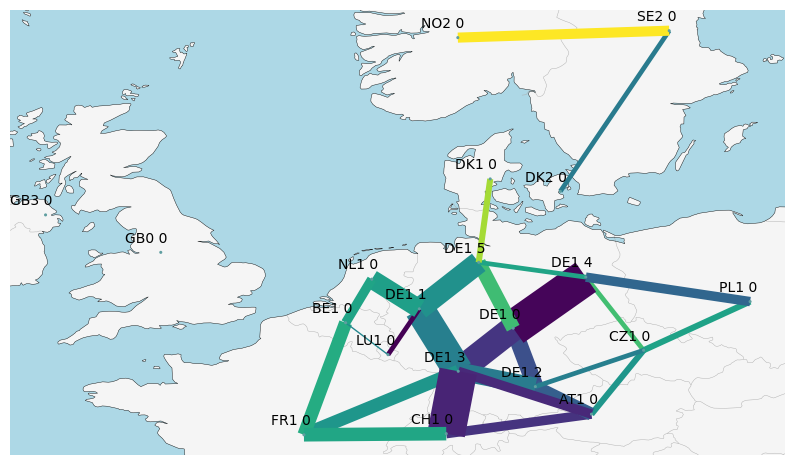

In [15]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [16]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


In [17]:
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
color_map["Import/Export"] = '#133337'

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


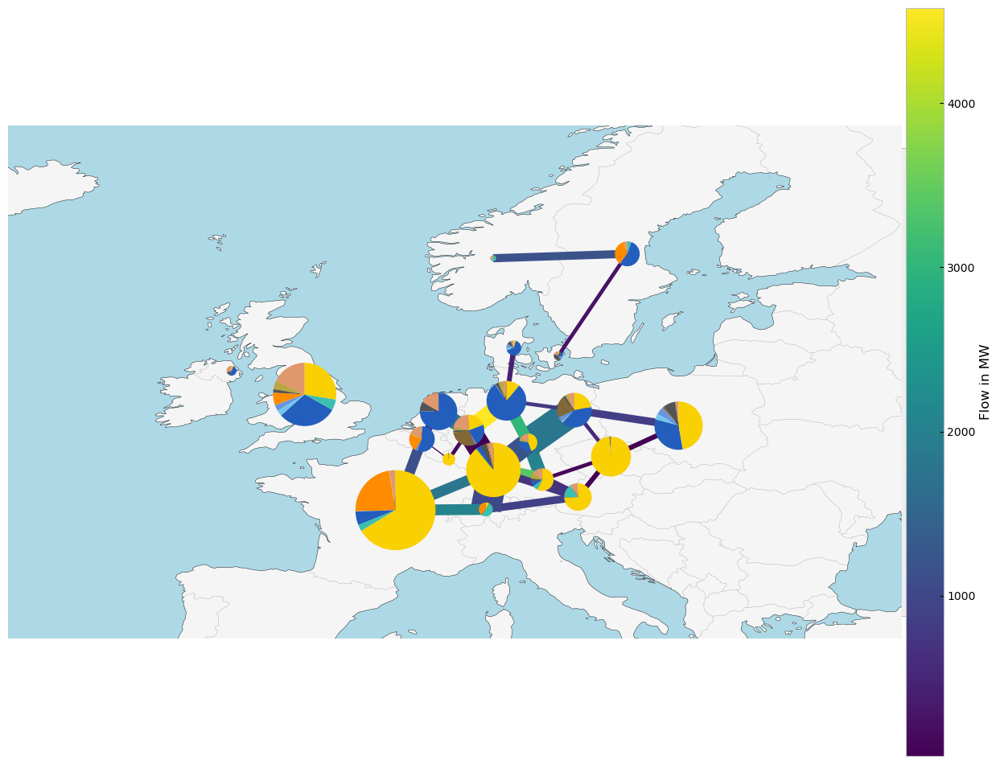

In [18]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_map,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [19]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


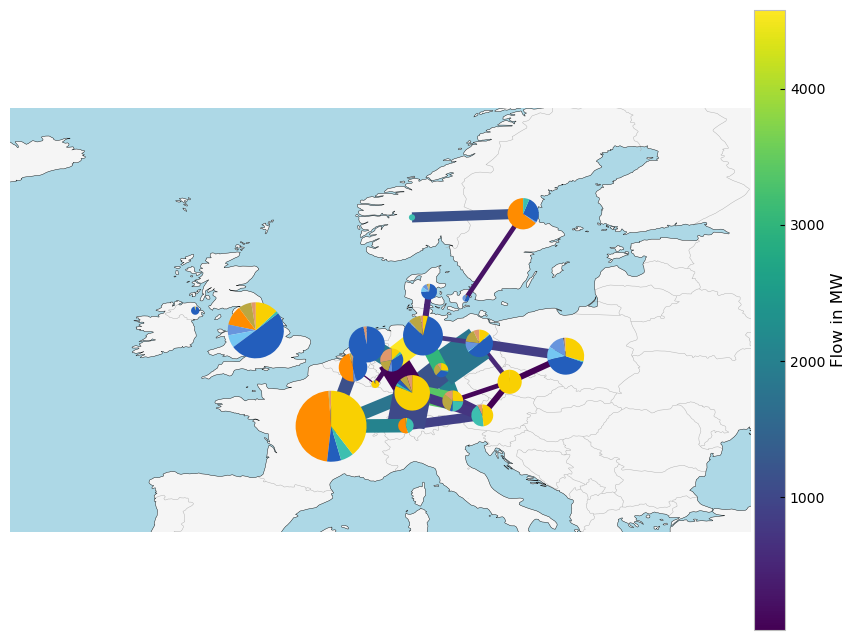

In [20]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

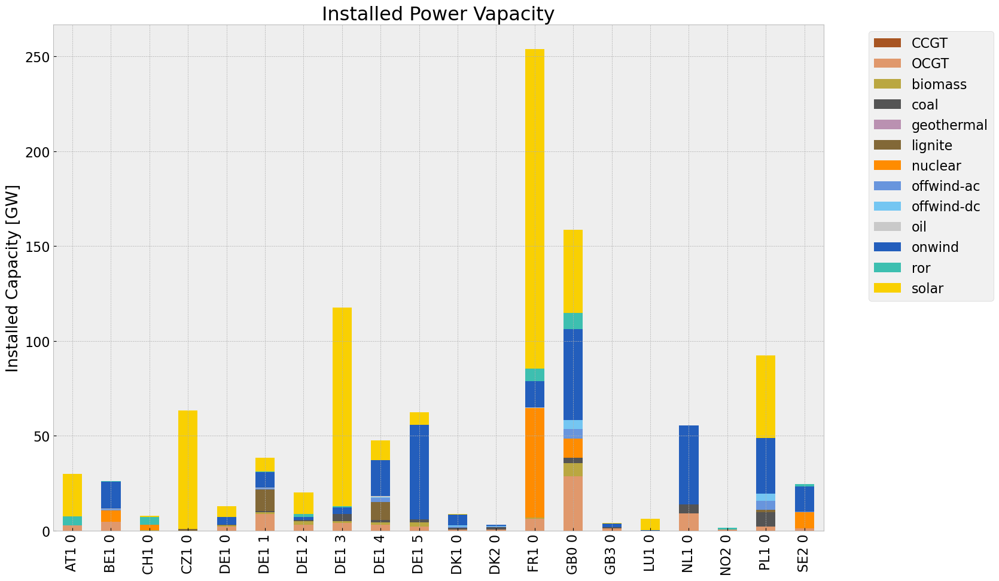

In [21]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

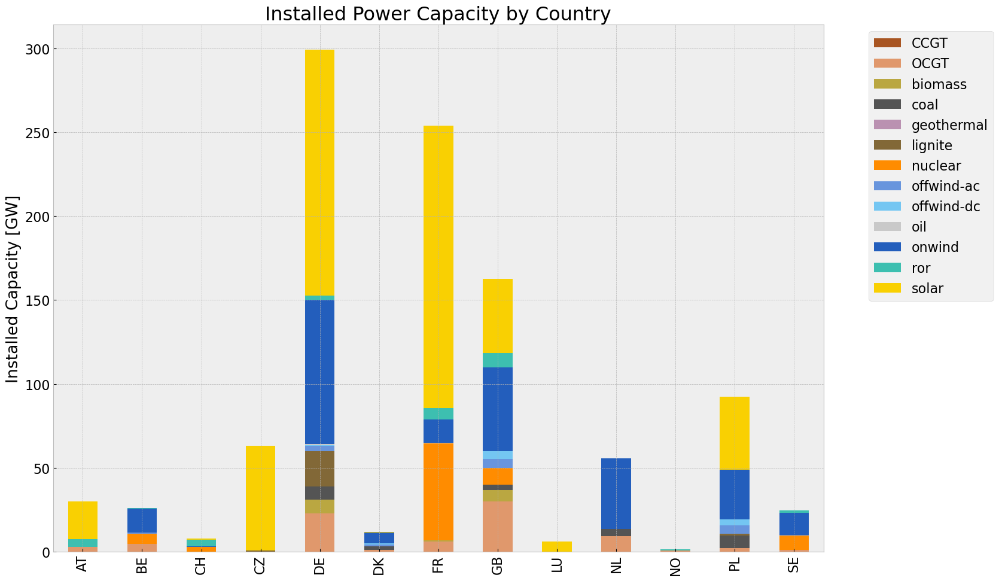

In [22]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color_map,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

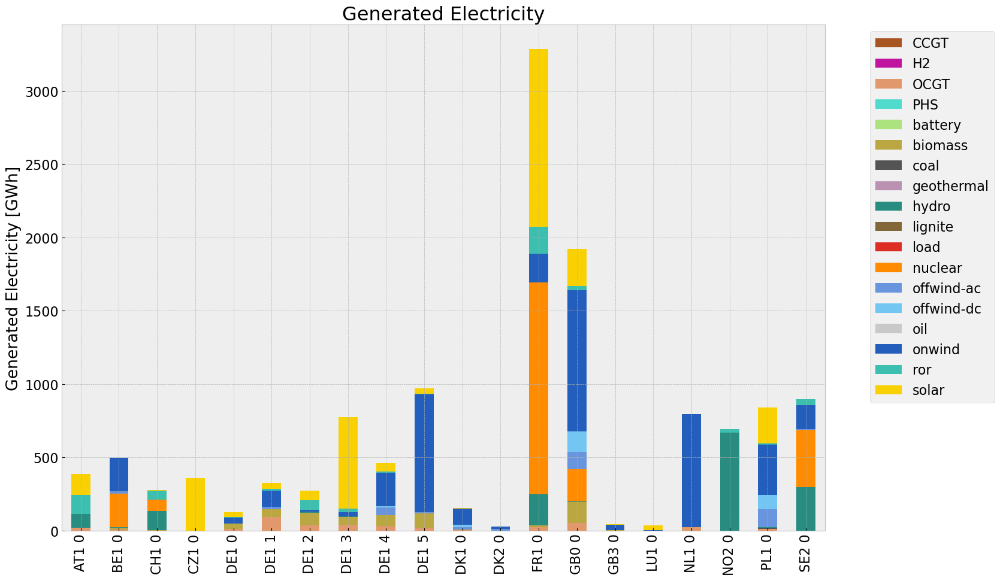

In [23]:
def gen_power_table(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color_map,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    return tot_df

gen_base = gen_power_table(n)

<Figure size 640x480 with 0 Axes>

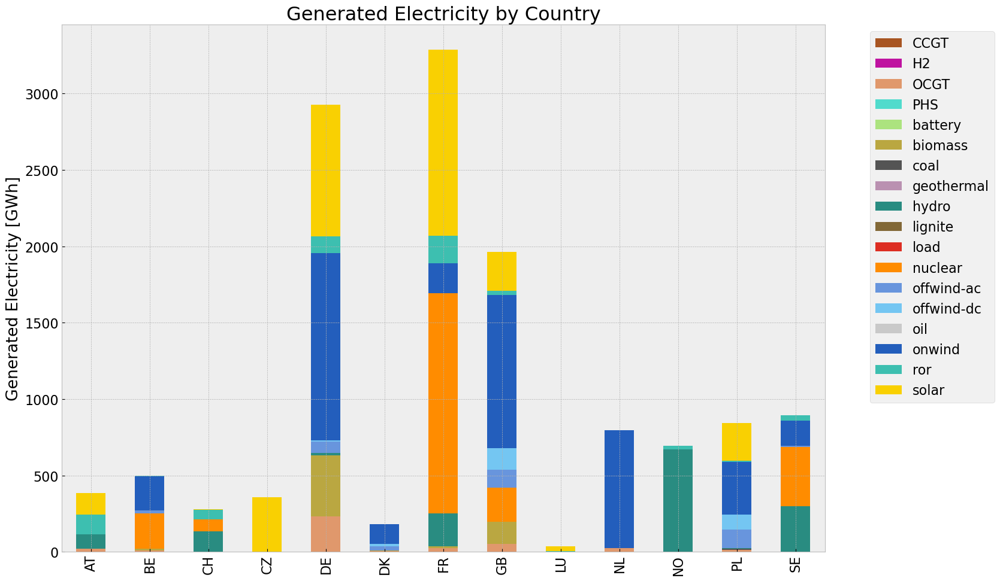

In [24]:
def gen_power_table_country(n):

    carrier_gen = list(n.generators.carrier.unique())
    carrier_sto = list(n.storage_units.carrier.unique())
    carrier = carrier_gen + carrier_sto

    gen_df = n.generators[["carrier","bus","p_nom_opt"]]
    sto_df = n.storage_units[["carrier","bus","p_nom_opt"]]
    tot_df = pd.concat([gen_df, sto_df])
    tot_series = pd.Series(index = tot_df.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    gen_sto = n.storage_units_t.p.sum()
    gen_gen = n.generators_t.p.sum()
    gen = pd.concat([gen_sto, gen_gen])
    gen = gen.clip(lower=0)

    for r in region:
            for tech in carrier:
                key = f"{r} {tech}"
                if key in gen.index:
                    try:
                        tot_series.loc[r, tech] = gen[key]
                    #print(generations.loc[r, tech])
                    except KeyError:
                        print('error')
    #tot_series.fillna(0, inplace=True)

    tot_df = (tot_series.unstack()/1000)
    tot_df.fillna(0,inplace = True)


    
    tot_df['country'] = tot_df.index.str[:2]
    tot_df = tot_df.groupby(['country']).sum()   
    #generations['load']/=1e3

    #define color dict for tech
    color_dict = {}

    for index, row in n.carriers.iterrows():
        key = index
        value = row['color']
        color_dict[key] = value

    #color list
    colors = [color_dict[cat] for cat in tot_df.columns]


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    tot_df.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color_map,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return tot_df

gen_base_country = gen_power_table_country(n)

## Snapshot

In [25]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [26]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [27]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    #colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=color_map,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    p_pos = p_by_carrier.where(p_by_carrier>0).dropna(how='all', axis=1).loc[time]
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(min(charge.sum(axis=1))+(min(charge.sum(axis=1)/100*10)),max(p_pos.sum(axis=1))+(max(p_pos.sum(axis =1))/100*30))
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [28]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [29]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [30]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [31]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

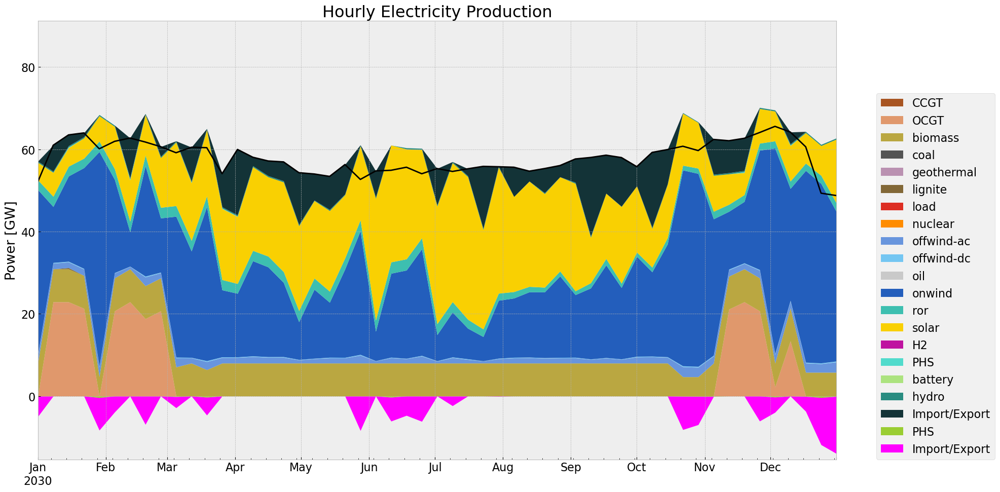

In [32]:
# winter
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'DE')

In [102]:
def system_cost(n, country): #n.statistics.capex()
    #add column country in generaror, storage unit, lines and links
    for index, row in n.generators.iterrows():
        n.generators.at[index,'country'] = row['bus'][:2]

    for index, row in n.storage_units.iterrows():
        n.storage_units.at[index,'country'] = row['bus'][:2]

    for index, row in n.lines.iterrows():
        if country in row['bus0'] or country in row['bus1']:
            n.lines.at[index, 'country'] = country
        else:
            n.lines.at[index,'country'] = row['bus0'][:2]

    for index, row in n.loads.iterrows():
        n.loads.at[index,'country'] = row['bus'][:2]

    for index, row in n.links.iterrows():
        if country in row['bus0'] or country in row['bus1']:
            n.links.at[index, 'country'] = country
        else:
            n.links.at[index,'country'] = row['bus0'][:2]
    


In [105]:
n.loads

,bus,carrier,type,p_set,q_set,sign,country
Load,,,,,,,
AT1 0,AT1 0,,,0.0,0.0,-1.0,AT
BE1 0,BE1 0,,,0.0,0.0,-1.0,BE
CH1 0,CH1 0,,,0.0,0.0,-1.0,CH
CZ1 0,CZ1 0,,,0.0,0.0,-1.0,CZ
DE1 0,DE1 0,,,0.0,0.0,-1.0,DE
DE1 1,DE1 1,,,0.0,0.0,-1.0,DE
DE1 2,DE1 2,,,0.0,0.0,-1.0,DE
DE1 3,DE1 3,,,0.0,0.0,-1.0,DE
DE1 4,DE1 4,,,0.0,0.0,-1.0,DE


In [112]:
n.statistics.supply(comps=["Generator", "StorageUnit",], groupby=["carrier","country"], aggregate_groups="sum", aggregate_time = False).fillna(0).droplevel(0).loc[(slice(None),'DE'),:]/1e3 #GW

,snapshot,2013-01-01,2013-01-08,2013-01-15,2013-01-22,2013-01-29,2013-02-05,2013-02-12,2013-02-19,2013-02-26,2013-03-05,2013-03-12,2013-03-19,2013-03-26,2013-04-02,2013-04-09,2013-04-16,2013-04-23,2013-04-30,2013-05-07,2013-05-14,2013-05-21,2013-05-28,2013-06-04,2013-06-11,2013-06-18,2013-06-25,2013-07-02,2013-07-09,2013-07-16,2013-07-23,2013-07-30,2013-08-06,2013-08-13,2013-08-20,2013-08-27,2013-09-03,2013-09-10,2013-09-17,2013-09-24,2013-10-01,2013-10-08,2013-10-15,2013-10-22,2013-10-29,2013-11-05,2013-11-12,2013-11-19,2013-11-26,2013-12-03,2013-12-10,2013-12-17,2013-12-24,2013-12-31
carrier,country,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
OCGT,DE,0.000000,22.888537,22.888537,21.291711,0.000000,20.684837,22.888537,18.792324,20.684837,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,21.112936,22.888537,20.684837,2.213854,13.376322,0.000000,0.000000,0.000000
biomass,DE,8.004648,8.004648,8.004648,8.004648,4.719173,8.004648,8.004648,8.004648,8.004648,7.065418,8.004648,6.399771,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,8.004648,4.685408,4.685408,8.004648,8.004648,8.004648,8.004648,5.768865,8.004648,5.768865,5.768865,5.768865
lignite,DE,0.000000,0.000000,0.287978,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
offwind-ac,DE,1.906489,1.374528,1.389462,1.544521,2.335720,1.189645,0.579307,2.122460,1.259966,2.185071,1.280186,1.958912,1.352444,1.364395,1.571107,1.400275,1.406527,0.776398,1.061727,1.255314,1.260655,1.899469,0.523909,1.283565,1.070561,1.699763,0.475932,1.327663,0.884191,0.501201,1.059380,1.258830,1.303689,1.186094,1.250593,1.269359,0.908415,1.221334,0.919131,1.478697,1.525325,1.402982,2.429568,2.308350,1.730464,1.537494,1.319456,1.866682,2.122906,1.674751,2.239064,2.076533,2.503772
offwind-dc,DE,0.162064,0.182946,0.167183,0.161894,0.186456,0.100513,0.066129,0.204123,0.147284,0.188919,0.095546,0.218999,0.148186,0.132656,0.159546,0.146795,0.151692,0.094204,0.098759,0.150782,0.114515,0.193755,0.045790,0.129887,0.080281,0.147472,0.080635,0.146338,0.140363,0.046804,0.116820,0.135819,0.132464,0.115218,0.123055,0.134983,0.080005,0.104920,0.082100,0.162741,0.151469,0.119354,0.212258,0.200225,0.160686,0.181920,0.141774,0.171663,0.173466,0.178294,0.197266,0.178794,0.218815
onwind,DE,40.089384,13.594979,20.730865,24.477843,52.151360,22.653518,8.359867,26.832508,13.168489,34.234264,25.855433,37.442384,16.283648,15.451731,23.122972,21.811920,18.022350,9.165649,16.763204,13.359328,21.498298,30.048313,7.150659,20.405493,21.437376,25.893229,6.346538,10.897166,7.438556,5.886282,14.076005,14.404482,15.870879,15.988712,19.781858,15.208286,17.252885,22.505131,17.349073,24.297029,20.489344,27.419783,47.600767,46.890267,33.154451,14.035291,14.914282,28.999074,49.983406,27.207725,46.604042,43.632973,36.319897
ror,DE,2.356680,2.473453,2.369776,2.293396,2.534422,2.583892,2.578875,2.577973,2.576596,2.577726,2.577713,2.574254,2.488511,2.384993,2.504826,2.614976,2.632439,2.695603,2.719913,2.684759,2.675837,2.655024,2.722543,2.748709,2.724816,2.676393,2.650013,2.539875,2.159189,1.848086,1.720099,1.556752,1.308659,1.136183,1.199145,0.929453,1.262208,1.562497,1

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

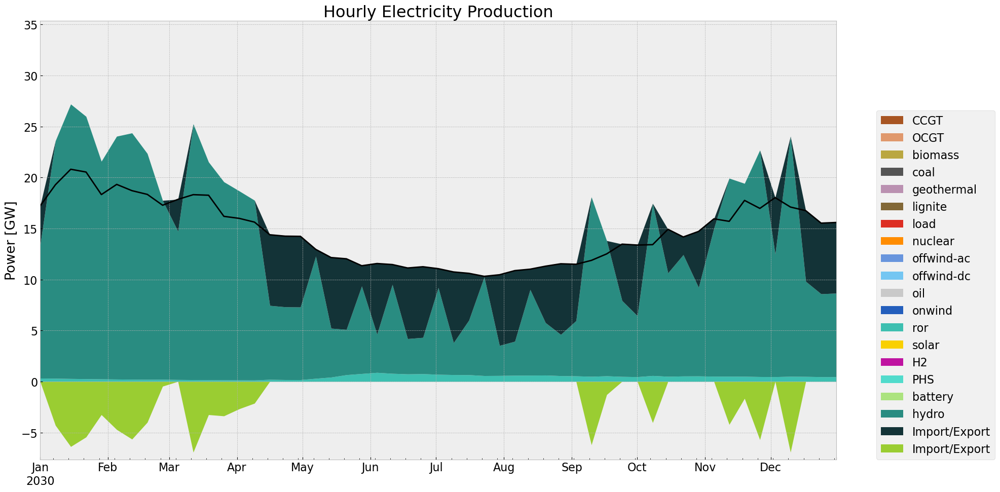

In [33]:
#summer
gen_curve(n, '2030-01-01', '2030-12-31', colors_gen,'NO')

In [34]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='168H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

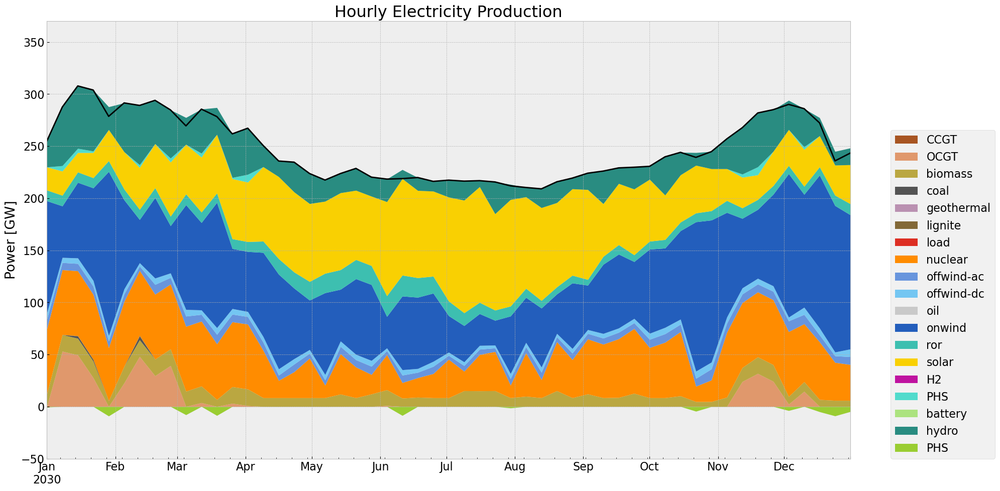

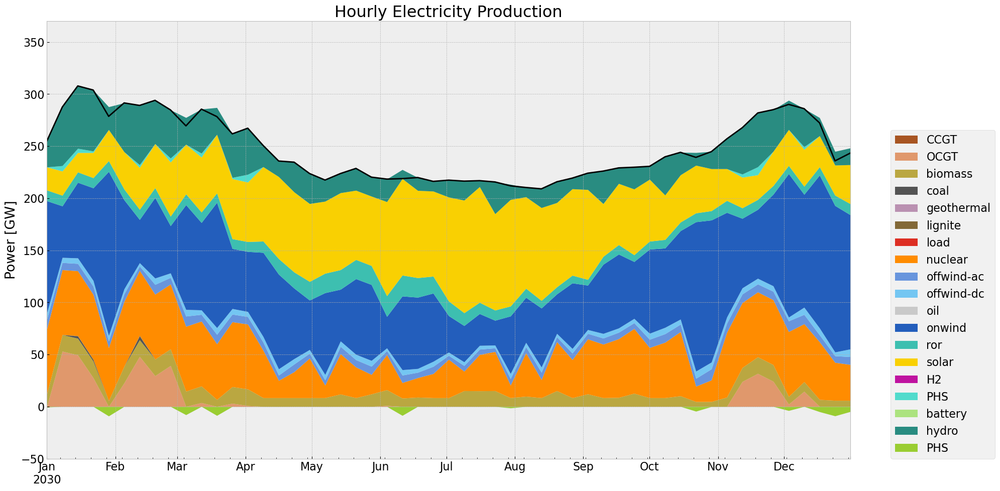

In [35]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-01-01', '2030-12-31', colors_gen)

## Storage

In [36]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["#bf13a0","#51dbcc","#ace37f","#298c81"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

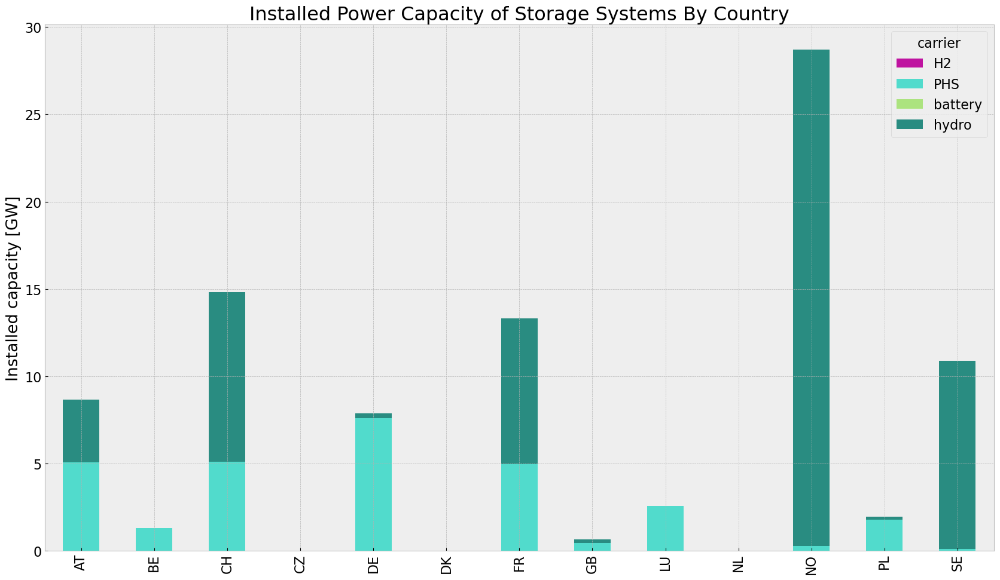

In [37]:
store_base = inst_store_table(n)

In [38]:
def state_of_charge_ctr_plot(n, start_date, end_date, ctr):
    
    col_sto = [col for col in  n.storage_units_t.state_of_charge.columns if col.startswith(ctr)]

    soc = n.storage_units_t.state_of_charge[col_sto]

    soc = soc.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\668665461.py:7: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = soc.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\668665461.py:9: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\668665461.py:15: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


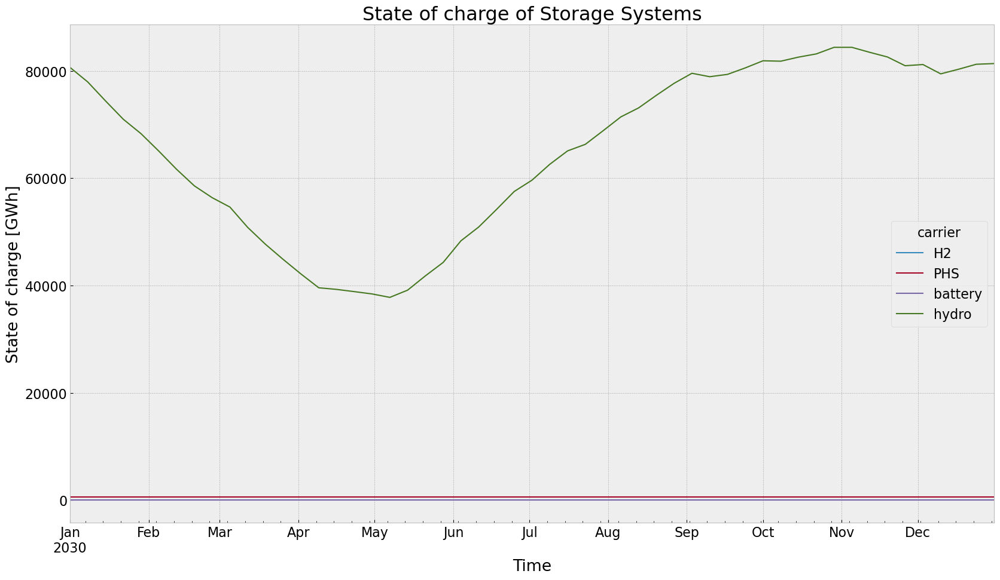

In [39]:
state_of_charge_ctr_plot(n, '2030-01-01', '2030-12-31', 'NO')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\668665461.py:7: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = soc.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\668665461.py:9: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\668665461.py:15: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


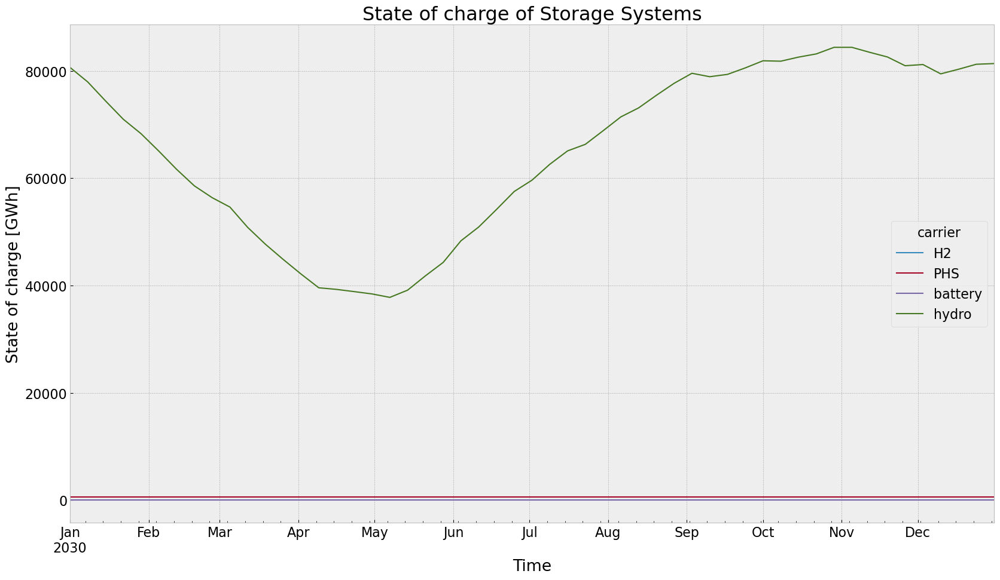

In [40]:
state_of_charge_ctr_plot(n, '2030-01-01', '2030-12-31', 'NO')

In [41]:
def state_of_charge_plot(n, start_date, end_date):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    time = pd.date_range(start= start_date , end= end_date, freq='168H')

    soc.loc[time].plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


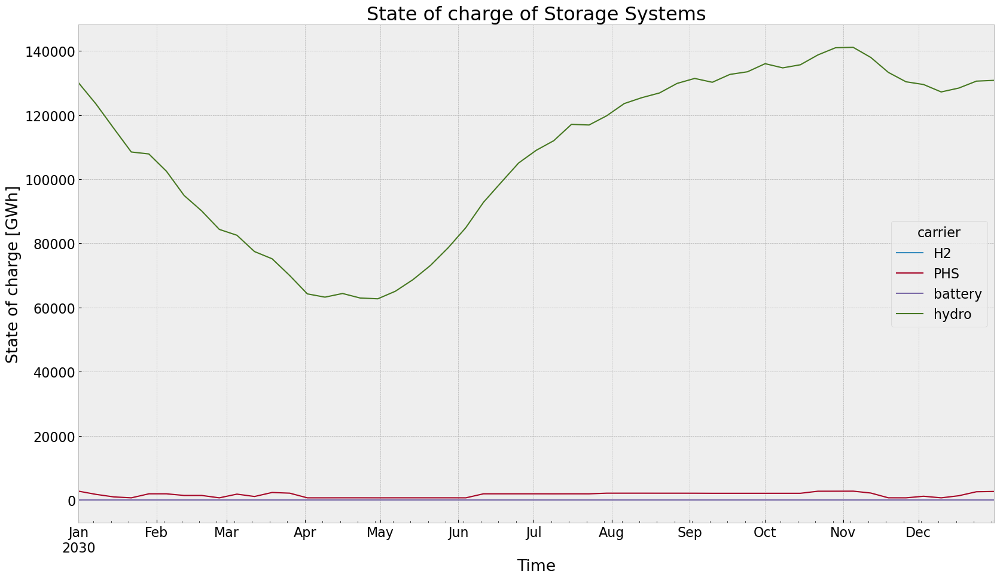

In [42]:
state_of_charge_plot(n, '2030-01-01', '2030-12-31')

## Electricity Price

In [43]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [44]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


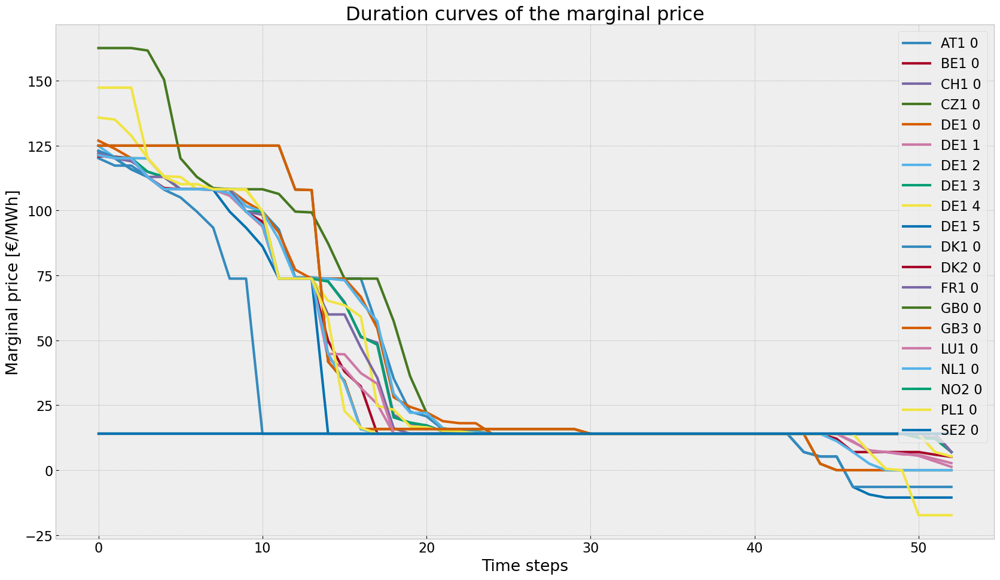

In [45]:
price_dur_curve_plot(n)

In [46]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


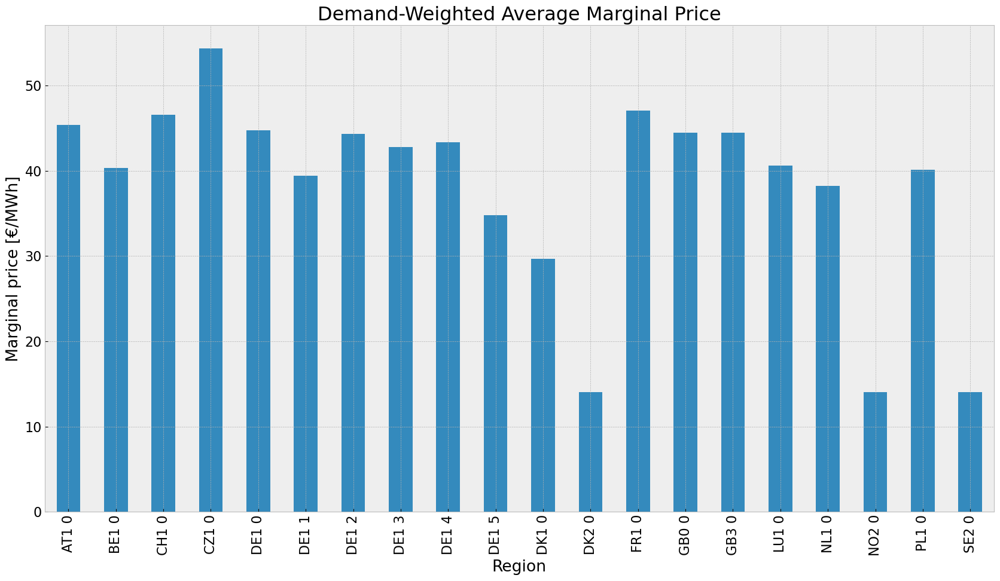

In [47]:
price_regions_table(n)

In [48]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


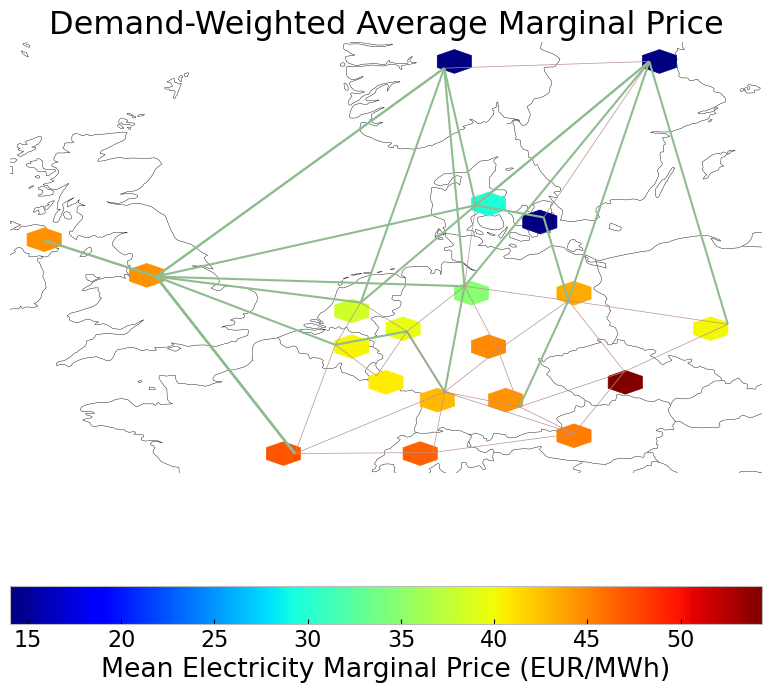

In [49]:
price_regions(n)

## Emission

In [50]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,3.741527e+05,0.451621,0.1980,164036.352887
biomass,5.845722e+05,0.468000,0.0000,0.000000
coal,7.584288e+03,0.329908,0.3361,7726.636139
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,1.034151e+03,0.337285,0.4069,1247.598450
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.361884e+06,0.326600,0.0000,0.000000
offwind-ac,3.647737e+05,1.000000,0.0000,0.000000


# PV Cut Scenario



In [51]:
def extract_carriers(column_names, carriers):
    """
    Filters columns that match the specified carrier names.
    
    Parameters:
    - column_names: List of column names in the DataFrame.
    - carriers: List of carrier names to match.
    
    Returns:
    - List of column names that match the carriers.
    """
    return [col for col in column_names if any(carrier in col for carrier in carriers)]

def max_generation_period(df, num_days, carriers):
    """
    Iterates through the DataFrame and finds the start date with the maximum generation sum for specified carriers over a given number of days.
    
    Parameters:
    - df: DataFrame containing the data.
    - num_days: The total number of days over which to sum the generation.
    - carriers: List of carrier names to be summed (e.g., ['CCGT', 'OCGT', 'biomass']).

    Returns:
    - Start date with the highest generation and the corresponding sum.
    """
    # Determine the timestep in days based on the DataFrame's index
    timestep = (df.index[1] - df.index[0]).total_seconds() / 86400  # Convert seconds to days
    num_rows = round(num_days / timestep)  # Calculate number of rows needed, round to nearest whole number
    
    # Extract column names matching the specified carriers
    relevant_columns = extract_carriers(df.columns, carriers)
    
    max_generation = 0
    start_date_with_max_generation = None

    # Iterate over each row in the DataFrame
    for start_idx in range(len(df)):
        #print(start_idx)
        # Ensure we do not exceed the DataFrame's length
        if start_idx + num_rows <= len(df):
            # Sum the generation for specified carriers over the period
            current_sum = df.iloc[start_idx:start_idx + num_rows][relevant_columns].sum().sum()
            #print(df.index[start_idx],current_sum)
            # Check if the current sum is the highest found so far
            if current_sum > max_generation:
                max_generation = current_sum
                start_date_with_max_generation = df.index[start_idx]

    return start_date_with_max_generation

def allow_inv(n1,n,country):
    #delete line expansion global constraint
    if 'lv_limit' in n1.global_constraints.index:
        n1.global_constraints = n1.global_constraints.drop('lv_limit')

    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, row in n1.generators.iterrows():
        if row['p_nom_extendable'] == True:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = True
        else:
            n1.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            n1.generators.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, row in n1.storage_units.iterrows():
        if row['p_nom_extendable'] == True:
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt'] 
            n1.storage_units.at[index, 'p_nom_extendable'] = True
        else:
            n1.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            n1.storage_units.at[index, 'p_nom_extendable'] = False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, row in n1.lines.iterrows():
        if row['carrier'] == 'AC':
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = True 
        else:
            n1.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            n1.lines.at[index, 's_nom_extendable'] = False 
    
    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, row in n1.links.iterrows():
        if row['carrier'] == 'DC':
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = True 
        else:
            n1.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            n1.links.at[index, 'p_nom_extendable'] = False 
            
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 'p_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

In [52]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
#cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reductionto = 0.25


def pvscenario(n, carriers_to_cut, duration, reductionto):
    #copy network
    n_new=n.copy()

    #define cut start based on the period with max generation of the chosen carrier    
    cut_start = max_generation_period(n.generators_t.p, duration, carriers_to_cut)
    print(f'cut_start: {cut_start}')
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reductionto #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new
        

## 1. Model: perfect foresight with allowed additional investment

In [53]:
carriers_to_cut= ['solar']
n1 = pvscenario(n, carriers_to_cut, duration, reductionto)
n1.name = f'inv_{contingency}'  

cut_start: 2013-04-09 00:00:00


In [54]:
country = 'DE'

### Allow investment

In [55]:
allow_inv(n1,n, country)

In [56]:
n1.optimize.create_model()
add_EQ_constraints(n1, o)
n1.optimize.solve_model(solver_name='gurobi')

Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3382802904.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3382802904.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.99it/s]
INFO:linopy.io: Writing time: 0.94s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6j_bb34.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g6j_bb34.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59569 rows, 27795 columns, 128494 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 128494 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


Model fingerprint: 0x78334aeb


INFO:gurobipy:Model fingerprint: 0x78334aeb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 6116 columns


INFO:gurobipy:Presolve removed 38424 rows and 6116 columns


Presolve time: 0.13s


INFO:gurobipy:Presolve time: 0.13s


Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.06s


INFO:gurobipy:Ordering time: 0.06s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.865e+05


INFO:gurobipy: AA' NZ     : 1.865e+05


 Factor NZ  : 8.933e+05 (roughly 25 MB of memory)


INFO:gurobipy: Factor NZ  : 8.933e+05 (roughly 25 MB of memory)


 Factor Ops : 1.643e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.643e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.17123494e+17 -7.52378765e+17  1.21e+10 1.63e+05  3.73e+14     0s


INFO:gurobipy:   0   5.17123494e+17 -7.52378765e+17  1.21e+10 1.63e+05  3.73e+14     0s


   1   3.74849744e+17 -5.73235293e+17  8.21e+09 1.24e+05  2.73e+14     0s


INFO:gurobipy:   1   3.74849744e+17 -5.73235293e+17  8.21e+09 1.24e+05  2.73e+14     0s


   2   2.88695896e+17 -2.25016179e+17  5.63e+09 4.06e+04  1.57e+14     1s


INFO:gurobipy:   2   2.88695896e+17 -2.25016179e+17  5.63e+09 4.06e+04  1.57e+14     1s


   3   1.04746770e+17 -6.69429853e+16  7.74e+08 1.20e+04  2.97e+13     1s


INFO:gurobipy:   3   1.04746770e+17 -6.69429853e+16  7.74e+08 1.20e+04  2.97e+13     1s


   4   3.56861968e+16 -1.21222501e+16  1.23e+08 2.09e+03  5.27e+12     1s


INFO:gurobipy:   4   3.56861968e+16 -1.21222501e+16  1.23e+08 2.09e+03  5.27e+12     1s


   5   1.11821177e+16 -8.77653002e+14  1.64e+06 1.27e+02  3.49e+11     1s


INFO:gurobipy:   5   1.11821177e+16 -8.77653002e+14  1.64e+06 1.27e+02  3.49e+11     1s


   6   6.02451792e+14 -8.46572373e+13  2.82e+04 1.09e-01  1.51e+10     1s


INFO:gurobipy:   6   6.02451792e+14 -8.46572373e+13  2.82e+04 1.09e-01  1.51e+10     1s


   7   2.98793674e+13 -6.21992317e+12  1.35e+03 3.22e-03  7.72e+08     1s


INFO:gurobipy:   7   2.98793674e+13 -6.21992317e+12  1.35e+03 3.22e-03  7.72e+08     1s


   8   1.20075241e+13 -3.02736855e+12  5.02e+02 1.37e-03  3.20e+08     1s


INFO:gurobipy:   8   1.20075241e+13 -3.02736855e+12  5.02e+02 1.37e-03  3.20e+08     1s


   9   8.15543272e+12 -2.31485733e+12  3.36e+02 9.81e-04  2.23e+08     1s


INFO:gurobipy:   9   8.15543272e+12 -2.31485733e+12  3.36e+02 9.81e-04  2.23e+08     1s


  10   3.85168927e+12 -1.33943495e+12  1.49e+02 5.73e-04  1.10e+08     1s


INFO:gurobipy:  10   3.85168927e+12 -1.33943495e+12  1.49e+02 5.73e-04  1.10e+08     1s


  11   2.28751591e+12 -7.70114893e+11  8.24e+01 3.44e-04  6.48e+07     1s


INFO:gurobipy:  11   2.28751591e+12 -7.70114893e+11  8.24e+01 3.44e-04  6.48e+07     1s


  12   1.07882695e+12 -4.56079236e+11  3.46e+01 2.05e-04  3.25e+07     1s


INFO:gurobipy:  12   1.07882695e+12 -4.56079236e+11  3.46e+01 2.05e-04  3.25e+07     1s


  13   6.16345729e+11 -2.56613926e+11  1.77e+01 1.27e-04  1.84e+07     1s


INFO:gurobipy:  13   6.16345729e+11 -2.56613926e+11  1.77e+01 1.27e-04  1.84e+07     1s


  14   4.05094686e+11 -7.72988235e+10  1.05e+01 5.53e-05  1.02e+07     1s


INFO:gurobipy:  14   4.05094686e+11 -7.72988235e+10  1.05e+01 5.53e-05  1.02e+07     1s


  15   2.85278233e+11 -3.80638381e+10  6.74e+00 3.66e-05  6.83e+06     1s


INFO:gurobipy:  15   2.85278233e+11 -3.80638381e+10  6.74e+00 3.66e-05  6.83e+06     1s


  16   1.72703643e+11 -6.56188394e+08  3.33e+00 1.99e-05  3.66e+06     1s


INFO:gurobipy:  16   1.72703643e+11 -6.56188394e+08  3.33e+00 1.99e-05  3.66e+06     1s


  17   1.27067782e+11  2.29573944e+10  1.97e+00 1.10e-05  2.20e+06     1s


INFO:gurobipy:  17   1.27067782e+11  2.29573944e+10  1.97e+00 1.10e-05  2.20e+06     1s


  18   9.25831347e+10  3.43453832e+10  9.74e-01 6.91e-06  1.23e+06     1s


INFO:gurobipy:  18   9.25831347e+10  3.43453832e+10  9.74e-01 6.91e-06  1.23e+06     1s


  19   7.92101970e+10  4.38942976e+10  5.76e-01 3.92e-06  7.46e+05     1s


INFO:gurobipy:  19   7.92101970e+10  4.38942976e+10  5.76e-01 3.92e-06  7.46e+05     1s


  20   7.10664155e+10  4.62265944e+10  3.50e-01 3.25e-06  5.24e+05     1s


INFO:gurobipy:  20   7.10664155e+10  4.62265944e+10  3.50e-01 3.25e-06  5.24e+05     1s


  21   6.61348090e+10  5.03041277e+10  2.15e-01 2.05e-06  3.34e+05     1s


INFO:gurobipy:  21   6.61348090e+10  5.03041277e+10  2.15e-01 2.05e-06  3.34e+05     1s


  22   6.22224182e+10  5.41171196e+10  1.09e-01 9.63e-07  1.71e+05     1s


INFO:gurobipy:  22   6.22224182e+10  5.41171196e+10  1.09e-01 9.63e-07  1.71e+05     1s


  23   6.03771768e+10  5.53513380e+10  6.13e-02 6.22e-07  1.06e+05     1s


INFO:gurobipy:  23   6.03771768e+10  5.53513380e+10  6.13e-02 6.22e-07  1.06e+05     1s


  24   5.95911641e+10  5.59901565e+10  4.24e-02 4.48e-07  7.60e+04     1s


INFO:gurobipy:  24   5.95911641e+10  5.59901565e+10  4.24e-02 4.48e-07  7.60e+04     1s


  25   5.88094850e+10  5.68368053e+10  2.35e-02 2.22e-07  4.16e+04     1s


INFO:gurobipy:  25   5.88094850e+10  5.68368053e+10  2.35e-02 2.22e-07  4.16e+04     1s


  26   5.83978362e+10  5.71032808e+10  1.44e-02 1.52e-07  2.73e+04     1s


INFO:gurobipy:  26   5.83978362e+10  5.71032808e+10  1.44e-02 1.52e-07  2.73e+04     1s


  27   5.79997481e+10  5.73614252e+10  5.46e-03 8.44e-08  1.35e+04     1s


INFO:gurobipy:  27   5.79997481e+10  5.73614252e+10  5.46e-03 8.44e-08  1.35e+04     1s


  28   5.78341784e+10  5.76536798e+10  2.23e-03 1.27e-08  3.81e+03     1s


INFO:gurobipy:  28   5.78341784e+10  5.76536798e+10  2.23e-03 1.27e-08  3.81e+03     1s


  29   5.77748326e+10  5.76889124e+10  1.12e-03 4.21e-09  1.81e+03     2s


INFO:gurobipy:  29   5.77748326e+10  5.76889124e+10  1.12e-03 4.21e-09  1.81e+03     2s


  30   5.77513027e+10  5.76937784e+10  7.05e-04 3.25e-09  1.21e+03     2s


INFO:gurobipy:  30   5.77513027e+10  5.76937784e+10  7.05e-04 3.25e-09  1.21e+03     2s


  31   5.77380689e+10  5.76989489e+10  4.72e-04 2.23e-09  8.26e+02     2s


INFO:gurobipy:  31   5.77380689e+10  5.76989489e+10  4.72e-04 2.23e-09  8.26e+02     2s


  32   5.77341957e+10  5.77059566e+10  4.00e-04 8.79e-10  5.96e+02     2s


INFO:gurobipy:  32   5.77341957e+10  5.77059566e+10  4.00e-04 8.79e-10  5.96e+02     2s


  33   5.77152515e+10  5.77078505e+10  6.70e-05 5.46e-10  1.56e+02     2s


INFO:gurobipy:  33   5.77152515e+10  5.77078505e+10  6.70e-05 5.46e-10  1.56e+02     2s


  34   5.77115449e+10  5.77100613e+10  3.63e-05 1.76e-10  3.13e+01     2s


INFO:gurobipy:  34   5.77115449e+10  5.77100613e+10  3.63e-05 1.76e-10  3.13e+01     2s


  35   5.77112513e+10  5.77109676e+10  3.52e-05 9.55e-11  5.99e+00     2s


INFO:gurobipy:  35   5.77112513e+10  5.77109676e+10  3.52e-05 9.55e-11  5.99e+00     2s


  36   5.77112150e+10  5.77110670e+10  1.96e-05 6.51e-11  3.12e+00     2s


INFO:gurobipy:  36   5.77112150e+10  5.77110670e+10  1.96e-05 6.51e-11  3.12e+00     2s


  37   5.77111814e+10  5.77111409e+10  5.53e-06 8.43e-11  8.56e-01     2s


INFO:gurobipy:  37   5.77111814e+10  5.77111409e+10  5.53e-06 8.43e-11  8.56e-01     2s


  38   5.77111681e+10  5.77111647e+10  1.17e-06 8.31e-11  7.23e-02     2s


INFO:gurobipy:  38   5.77111681e+10  5.77111647e+10  1.17e-06 8.31e-11  7.23e-02     2s


  39   5.77111666e+10  5.77111664e+10  7.46e-08 8.27e-11  5.55e-03     2s


INFO:gurobipy:  39   5.77111666e+10  5.77111664e+10  7.46e-08 8.27e-11  5.55e-03     2s


  40   5.77111666e+10  5.77111665e+10  6.94e-06 8.90e-11  9.39e-04     2s


INFO:gurobipy:  40   5.77111666e+10  5.77111665e+10  6.94e-06 8.90e-11  9.39e-04     2s


  41   5.77111666e+10  5.77111666e+10  1.39e-06 1.67e-10  1.79e-05     2s


INFO:gurobipy:  41   5.77111666e+10  5.77111666e+10  1.39e-06 1.67e-10  1.79e-05     2s


  42   5.77111666e+10  5.77111666e+10  1.78e-08 9.92e-11  2.99e-08     2s


INFO:gurobipy:  42   5.77111666e+10  5.77111666e+10  1.78e-08 9.92e-11  2.99e-08     2s


  43   5.77111666e+10  5.77111666e+10  4.66e-10 2.55e-10  1.55e-10     2s


INFO:gurobipy:  43   5.77111666e+10  5.77111666e+10  4.66e-10 2.55e-10  1.55e-10     2s


INFO:gurobipy:


Barrier solved model in 43 iterations and 2.23 seconds (0.83 work units)


INFO:gurobipy:Barrier solved model in 43 iterations and 2.23 seconds (0.83 work units)


Optimal objective 5.77111666e+10


INFO:gurobipy:Optimal objective 5.77111666e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10640 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:   10640 DPushes remaining with DInf 0.0000000e+00                 2s


       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 2s


INFO:gurobipy:


     131 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:     131 PPushes remaining with PInf 0.0000000e+00                 2s


       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 2s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3611272e-09      2s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.3611272e-09      2s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5380    5.7711167e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:    5380    5.7711167e+10   0.000000e+00   0.000000e+00      2s


INFO:gurobipy:


Solved in 5380 iterations and 2.48 seconds (1.04 work units)


INFO:gurobipy:Solved in 5380 iterations and 2.48 seconds (1.04 work units)


Optimal objective  5.771116656e+10


INFO:gurobipy:Optimal objective  5.771116656e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 5.77e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

('ok', 'optimal')

In [57]:
#n1.optimize(solver_name= "gurobi")
#filename = f'inv_{contingency}.nc'
#n1 = import_nc_file(directory, filename)
n1.name = f'inv_{contingency}'

### Export model for later use

In [58]:
file = f"{n1.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n1.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_pv.nc has lines, generators, carriers, loads, buses, links, storage_units


<xarray.Dataset> Size: 276kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           ...
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 25,
                                           storage_units_t_p_dispatch_i: 25,
                                           storage_units_t_p_store_i: 15,
                                           storage_units_t_state_of_charge_i: 65)
Coordinates: (12/26)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 200B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 200B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 120B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
Data variables: (12/100)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_country                 (storage_units_i) object 520B 'AT' ...
    storage_units_t_inflow                (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                     (snapshots, storage_units_t_p_i) float64 11kB ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 11kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
Attributes:
    network__linearized_uc:      0
    network__multi_invest:       0
    network_name:                inv_pv
    network_objective:           57711166560.07316
    network_objective_constant:  22911281891.38211
    network_pypsa_version:       0.27.0
    network_srid:                4326
    crs:                         {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"Worl...
    meta:                        {}

In [59]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

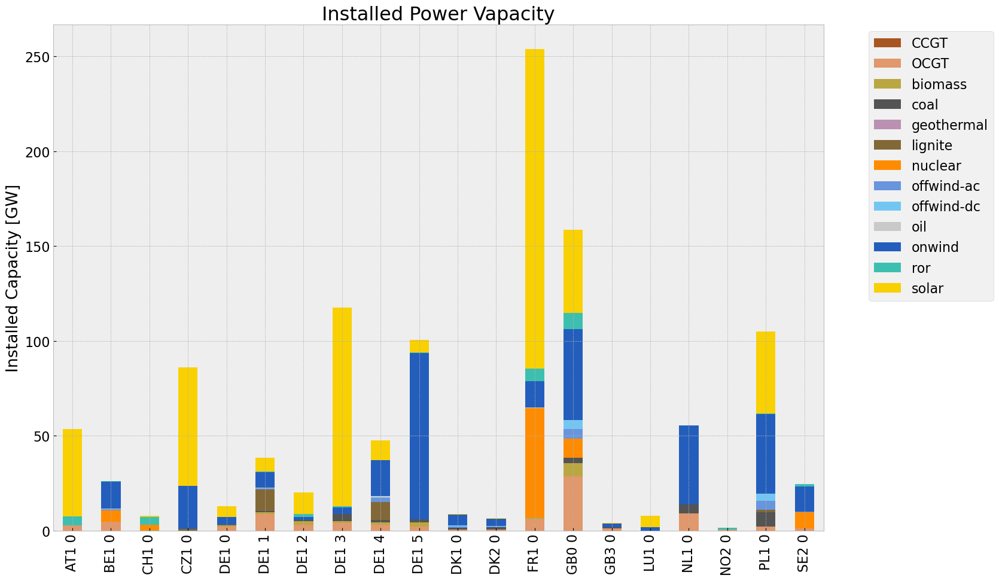

<Figure size 640x480 with 0 Axes>

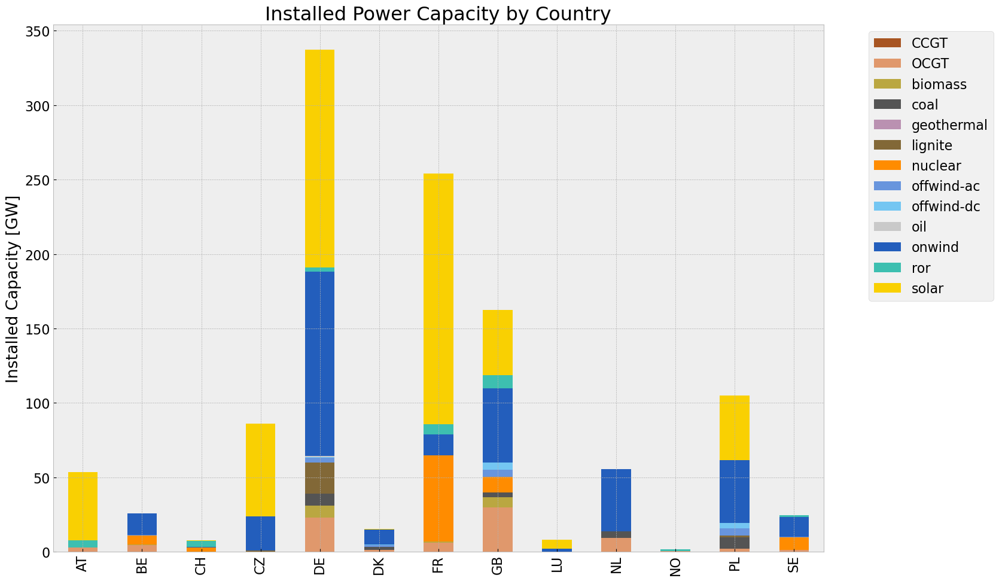

In [60]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


### Generation

<Figure size 640x480 with 0 Axes>

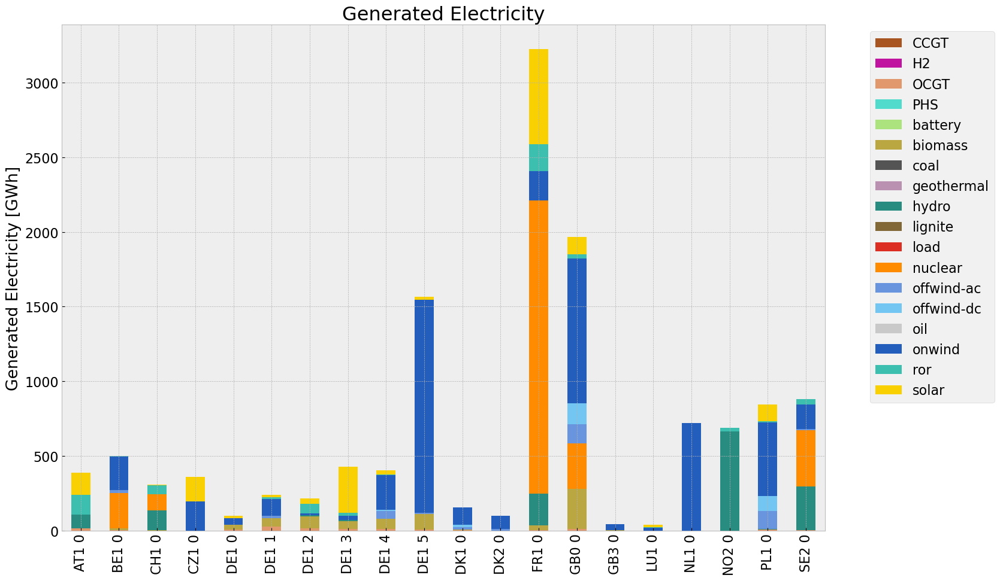

<Figure size 640x480 with 0 Axes>

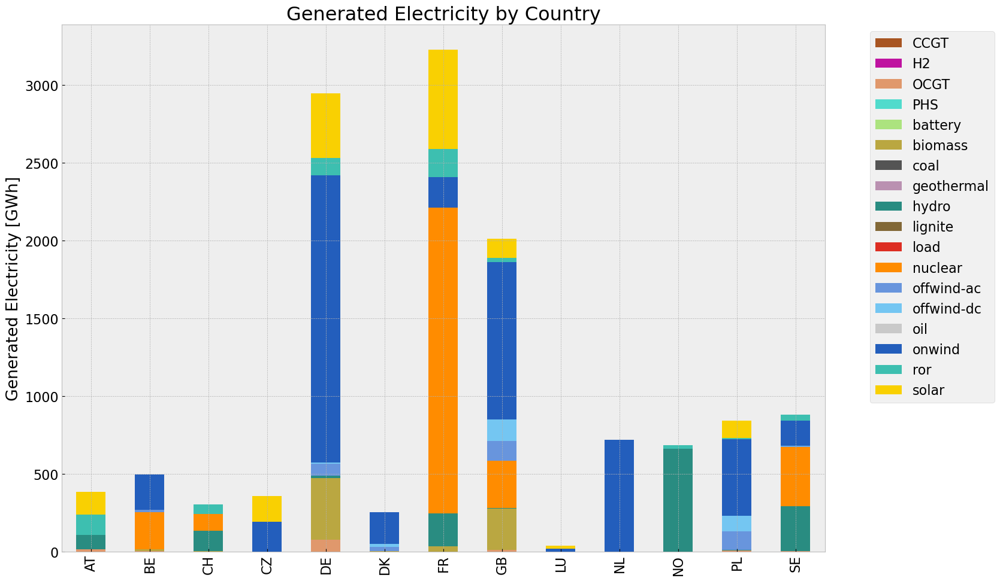

In [61]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1)
gen_inv_country = gen_power_table_country(n1)

### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

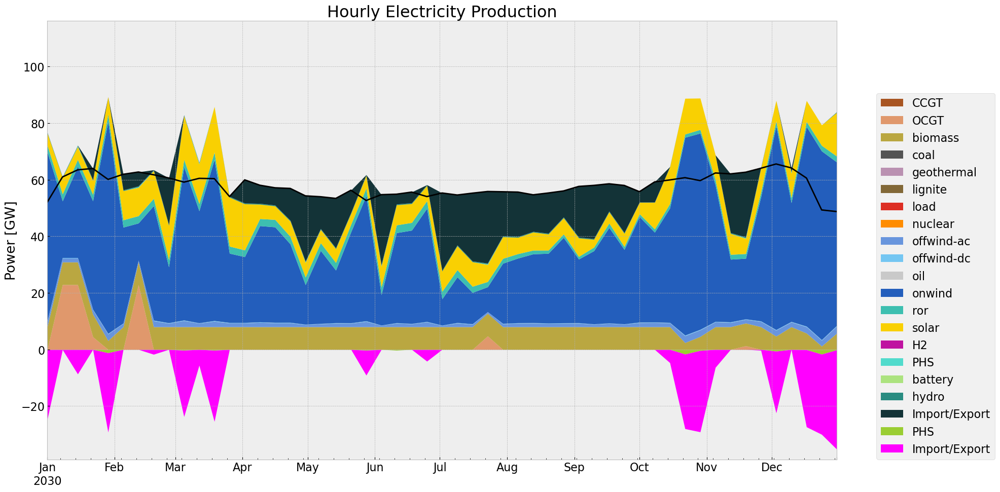

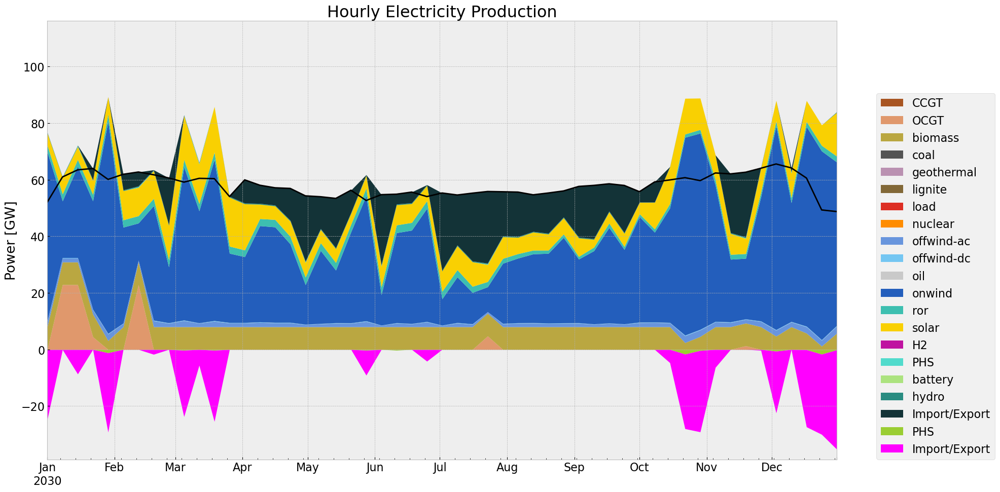

In [62]:
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-01-01', '2030-12-31', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

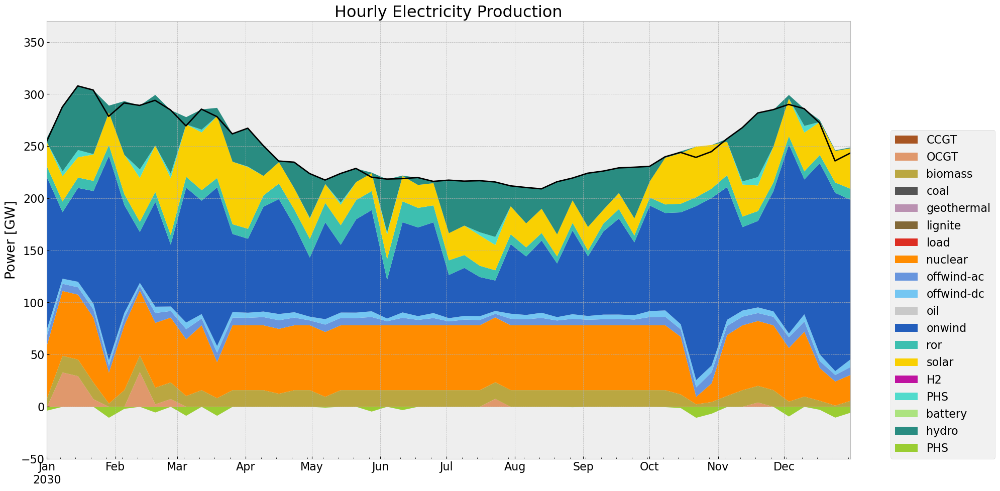

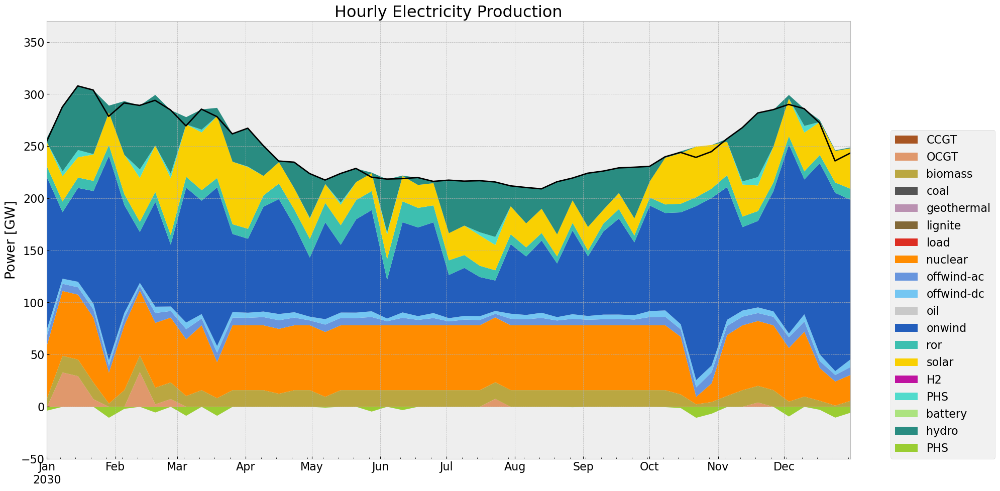

In [63]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-01-01', '2030-12-31', colors_gen)

### Storage

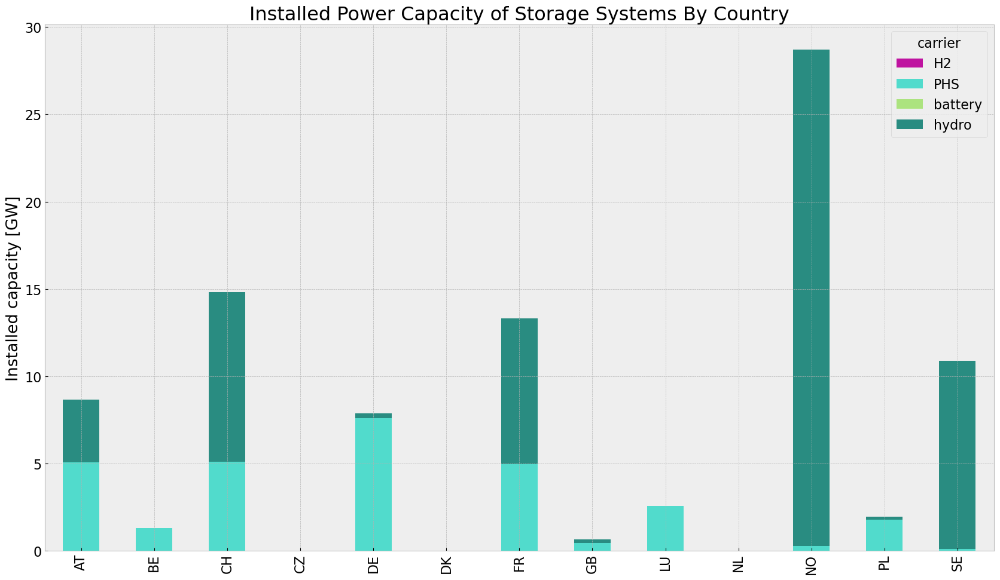

In [64]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')


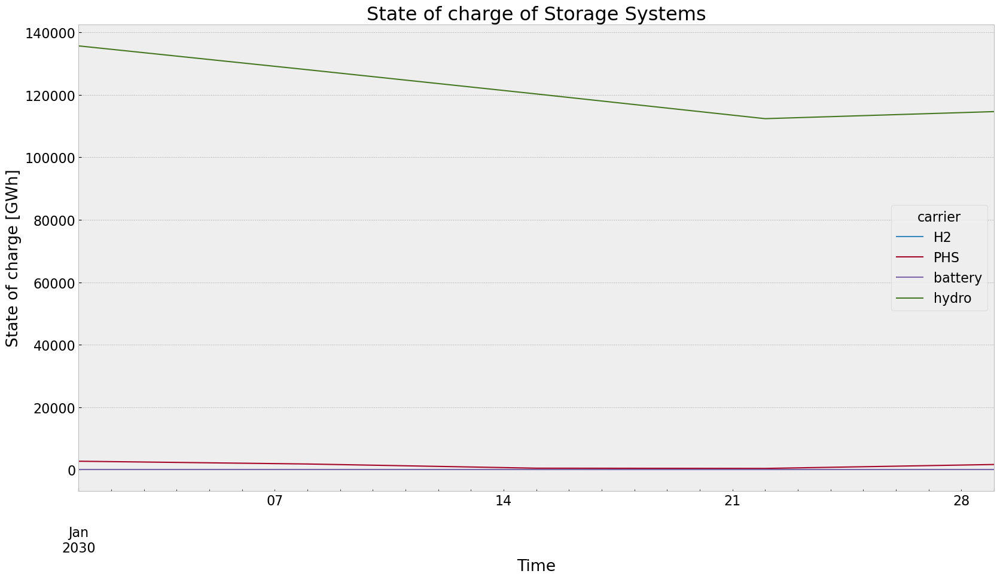

In [65]:
state_of_charge_plot(n1, '2030-01-01 00:00', '2030-02-02 21:00')

### Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


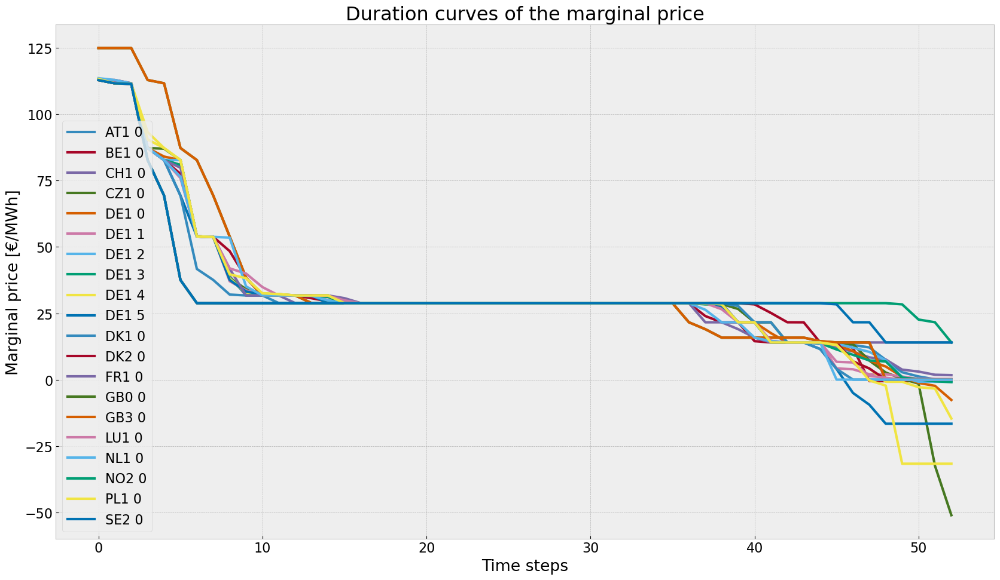

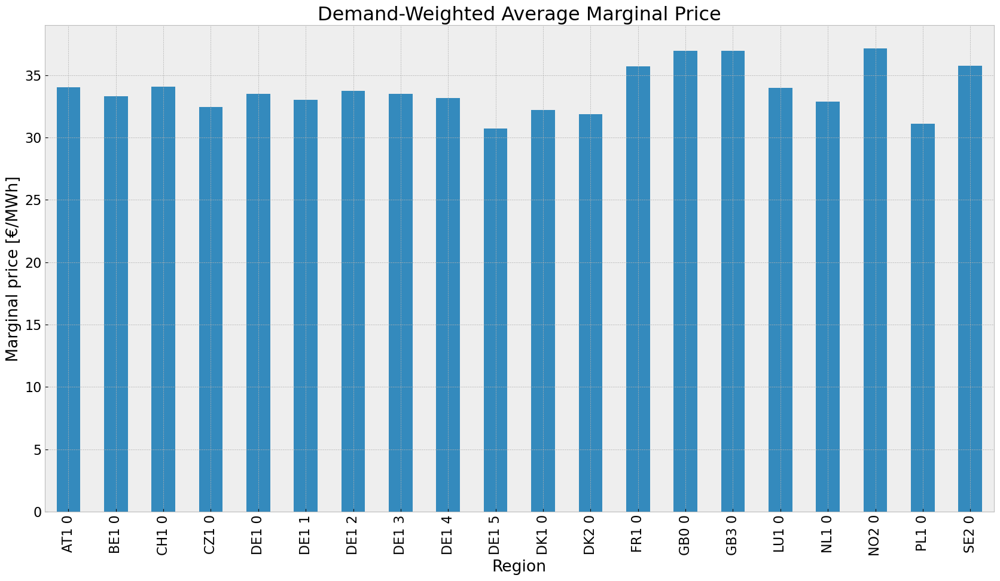

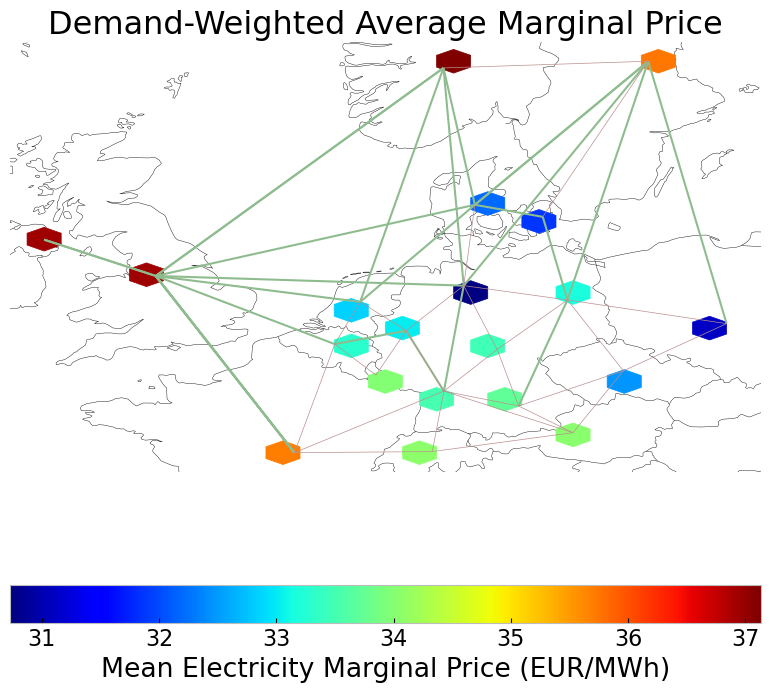

In [66]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


### Emission

In [67]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.243861e+05,0.451621,0.1980,54533.455648
biomass,7.160456e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329908,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,0.000000e+00,0.337285,0.4069,0.000000
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.991845e+06,0.326600,0.0000,0.000000
offwind-ac,3.725227e+05,1.000000,0.0000,0.000000


## Base RH

In [68]:
#BAse RH
n_roll = n.copy()
no_inv(n_roll,n)
n_roll.storage_units['cyclic_state_of_charge'] = False
n_roll.storage_units['cyclic_state_of_charge_per_period'] = False

def set_initial_soc(n1, n):
    for index, value in n.storage_units_t.state_of_charge.iloc[0,:].items():
        n1.storage_units.at[index, 'state_of_charge_initial'] = value

set_initial_soc(n_roll, n)
#_roll.optimize.create_model()
#add_EQ_constraints(n_roll, o)
#n_roll.optimize.solve_model(solver_name='gurobi')

horizon = 4

optimize.optimize_with_rolling_horizon(n_roll, horizon=int(horizon), overlap=0, solver_name='gurobi')
#filename = f"base_{contingency}_roll.nc"
#n_roll = import_nc_file(directory, filename)
n_roll.name = f'base_{contingency}_roll'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knegr_ot.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-knegr_ot.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2b49cad4


INFO:gurobipy:Model fingerprint: 0x2b49cad4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4292 rows and 1236 columns


INFO:gurobipy:Presolve removed 4292 rows and 1236 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 180 rows, 848 columns, 1340 nonzeros


INFO:gurobipy:Presolved: 180 rows, 848 columns, 1340 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9219650e+08   8.828883e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9219650e+08   8.828883e+05   0.000000e+00      0s


     210    3.2387711e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     210    3.2387711e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 210 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 210 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.238771096e+09


INFO:gurobipy:Optimal objective  3.238771096e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zg7s02k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1zg7s02k.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb1492012


INFO:gurobipy:Model fingerprint: 0xb1492012


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4269 rows and 1218 columns


INFO:gurobipy:Presolve removed 4269 rows and 1218 columns


Presolve time: 0.11s


INFO:gurobipy:Presolve time: 0.11s


Presolved: 203 rows, 866 columns, 1400 nonzeros


INFO:gurobipy:Presolved: 203 rows, 866 columns, 1400 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4142868e+08   8.878904e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4142868e+08   8.878904e+05   0.000000e+00      0s


     258    2.6454647e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     258    2.6454647e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 258 iterations and 0.12 seconds (0.01 work units)


INFO:gurobipy:Solved in 258 iterations and 0.12 seconds (0.01 work units)


Optimal objective  2.645464679e+09


INFO:gurobipy:Optimal objective  2.645464679e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5k1uzuw2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5k1uzuw2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc742d1d3


INFO:gurobipy:Model fingerprint: 0xc742d1d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4268 rows and 1212 columns


INFO:gurobipy:Presolve removed 4268 rows and 1212 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 204 rows, 872 columns, 1407 nonzeros


INFO:gurobipy:Presolved: 204 rows, 872 columns, 1407 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9390432e+08   8.729250e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9390432e+08   8.729250e+05   0.000000e+00      0s


     296    1.7280850e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     296    1.7280850e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 296 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 296 iterations and 0.08 seconds (0.01 work units)


Optimal objective  1.728085042e+09


INFO:gurobipy:Optimal objective  1.728085042e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bd0m6ubu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bd0m6ubu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x82425a2d


INFO:gurobipy:Model fingerprint: 0x82425a2d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4270 rows and 1215 columns


INFO:gurobipy:Presolve removed 4270 rows and 1215 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 202 rows, 869 columns, 1400 nonzeros


INFO:gurobipy:Presolved: 202 rows, 869 columns, 1400 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2077480e+07   8.922298e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2077480e+07   8.922298e+05   0.000000e+00      0s


     229    9.0680513e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     229    9.0680513e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 229 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 229 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.068051285e+08


INFO:gurobipy:Optimal objective  9.068051285e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ch31mjx5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ch31mjx5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3e9a0ac1


INFO:gurobipy:Model fingerprint: 0x3e9a0ac1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4270 rows and 1215 columns


INFO:gurobipy:Presolve removed 4270 rows and 1215 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 202 rows, 869 columns, 1400 nonzeros


INFO:gurobipy:Presolved: 202 rows, 869 columns, 1400 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.1542624e+05   9.105321e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.1542624e+05   9.105321e+05   0.000000e+00      0s


     238    1.5917782e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     238    1.5917782e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 238 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 238 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.591778200e+08


INFO:gurobipy:Optimal objective  1.591778200e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i4537d_s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i4537d_s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc10138f3


INFO:gurobipy:Model fingerprint: 0xc10138f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4278 rows and 1206 columns


INFO:gurobipy:Presolve removed 4278 rows and 1206 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 194 rows, 878 columns, 1396 nonzeros


INFO:gurobipy:Presolved: 194 rows, 878 columns, 1396 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6030655e+07   9.350645e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6030655e+07   9.350645e+05   0.000000e+00      0s


     242    1.4723677e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     242    1.4723677e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 242 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 242 iterations and 0.07 seconds (0.01 work units)


Optimal objective  1.472367693e+08


INFO:gurobipy:Optimal objective  1.472367693e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-km4uc478.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-km4uc478.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x14df78da


INFO:gurobipy:Model fingerprint: 0x14df78da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4266 rows and 1190 columns


INFO:gurobipy:Presolve removed 4266 rows and 1190 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 206 rows, 894 columns, 1434 nonzeros


INFO:gurobipy:Presolved: 206 rows, 894 columns, 1434 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6034815e+07   9.111545e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6034815e+07   9.111545e+05   0.000000e+00      0s


     303    1.1669920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    1.1669920e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.07 seconds (0.01 work units)


Optimal objective  1.166992015e+08


INFO:gurobipy:Optimal objective  1.166992015e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nmmbjk_v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nmmbjk_v.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7cfd9831


INFO:gurobipy:Model fingerprint: 0x7cfd9831


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4264 rows and 1187 columns


INFO:gurobipy:Presolve removed 4264 rows and 1187 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 208 rows, 897 columns, 1439 nonzeros


INFO:gurobipy:Presolved: 208 rows, 897 columns, 1439 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1579462e+07   8.971327e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1579462e+07   8.971327e+05   0.000000e+00      0s


     303    2.7147060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    2.7147060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.06 seconds (0.01 work units)


Optimal objective  2.714705985e+08


INFO:gurobipy:Optimal objective  2.714705985e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqvh_82h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqvh_82h.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7c4da7ee


INFO:gurobipy:Model fingerprint: 0x7c4da7ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4264 rows and 1185 columns


INFO:gurobipy:Presolve removed 4264 rows and 1185 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 208 rows, 899 columns, 1441 nonzeros


INFO:gurobipy:Presolved: 208 rows, 899 columns, 1441 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1611979e+07   8.958033e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1611979e+07   8.958033e+05   0.000000e+00      0s


     328    3.6194182e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     328    3.6194182e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 328 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 328 iterations and 0.06 seconds (0.01 work units)


Optimal objective  3.619418156e+08


INFO:gurobipy:Optimal objective  3.619418156e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-493gwvmm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-493gwvmm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc495db91


INFO:gurobipy:Model fingerprint: 0xc495db91


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4264 rows and 1177 columns


INFO:gurobipy:Presolve removed 4264 rows and 1177 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 208 rows, 907 columns, 1449 nonzeros


INFO:gurobipy:Presolved: 208 rows, 907 columns, 1449 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6083843e+07   8.943119e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6083843e+07   8.943119e+05   0.000000e+00      0s


     299    5.5387409e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     299    5.5387409e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 299 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 299 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.538740902e+08


INFO:gurobipy:Optimal objective  5.538740902e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sprc3jru.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sprc3jru.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xbb3c1bdc


INFO:gurobipy:Model fingerprint: 0xbb3c1bdc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4258 rows and 1159 columns


INFO:gurobipy:Presolve removed 4258 rows and 1159 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 214 rows, 925 columns, 1492 nonzeros


INFO:gurobipy:Presolved: 214 rows, 925 columns, 1492 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3688791e+05   9.474718e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3688791e+05   9.474718e+05   0.000000e+00      0s


     298    3.5470479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     298    3.5470479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 298 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 298 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.547047884e+08


INFO:gurobipy:Optimal objective  3.547047884e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9a6tqp8h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9a6tqp8h.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xbe1f32cf


INFO:gurobipy:Model fingerprint: 0xbe1f32cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4256 rows and 1155 columns


INFO:gurobipy:Presolve removed 4256 rows and 1155 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 216 rows, 929 columns, 1498 nonzeros


INFO:gurobipy:Presolved: 216 rows, 929 columns, 1498 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2048595e+07   8.655829e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2048595e+07   8.655829e+05   0.000000e+00      0s


     278    3.3615268e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    3.3615268e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 278 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.361526808e+09


INFO:gurobipy:Optimal objective  3.361526808e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ccgo8oah.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ccgo8oah.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x942d22f2


INFO:gurobipy:Model fingerprint: 0x942d22f2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4260 rows and 1184 columns


INFO:gurobipy:Presolve removed 4260 rows and 1184 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 212 rows, 900 columns, 1458 nonzeros


INFO:gurobipy:Presolved: 212 rows, 900 columns, 1458 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1019138e+05   8.799472e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.1019138e+05   8.799472e+05   0.000000e+00      0s


     292    1.0243407e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    1.0243407e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.024340724e+09


INFO:gurobipy:Optimal objective  1.024340724e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxri30jx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mxri30jx.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xc0a0c414


INFO:gurobipy:Model fingerprint: 0xc0a0c414


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1073 rows and 314 columns


INFO:gurobipy:Presolve removed 1073 rows and 314 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 45 rows, 207 columns, 322 nonzeros


INFO:gurobipy:Presolved: 45 rows, 207 columns, 322 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9525841e+04   8.633949e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.9525841e+04   8.633949e+04   0.000000e+00      0s


      40    8.6462719e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      40    8.6462719e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 40 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 40 iterations and 0.04 seconds (0.00 work units)


Optimal objective  8.646271903e+06


INFO:gurobipy:Optimal objective  8.646271903e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 8.65e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


INFO:pypsa.io:Exported network DE_20_1.0_base_roll_solved_168h.nc has lines, generators, carriers, loads, global_constraints, buses, links, storage_units


<Figure size 640x480 with 0 Axes>

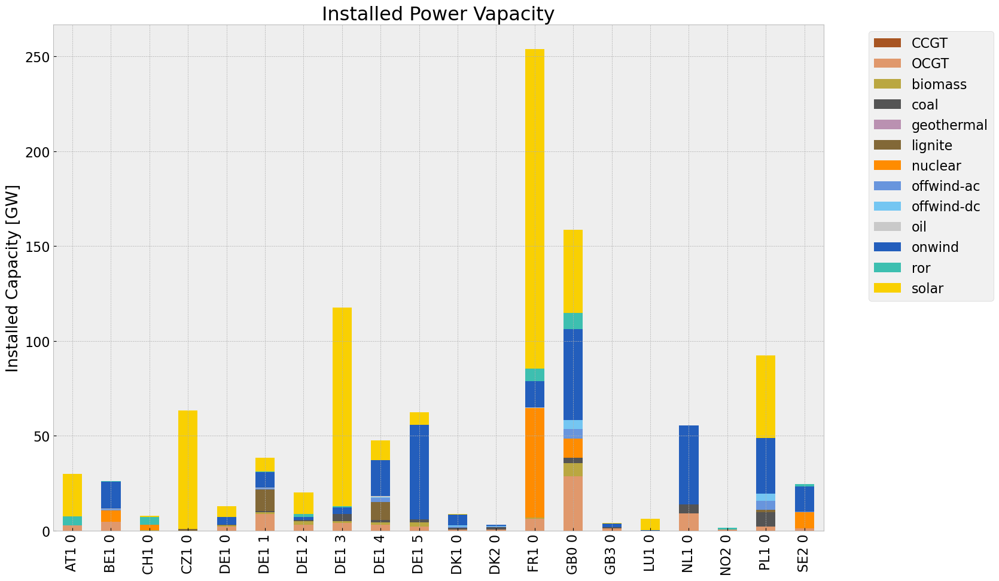

<Figure size 640x480 with 0 Axes>

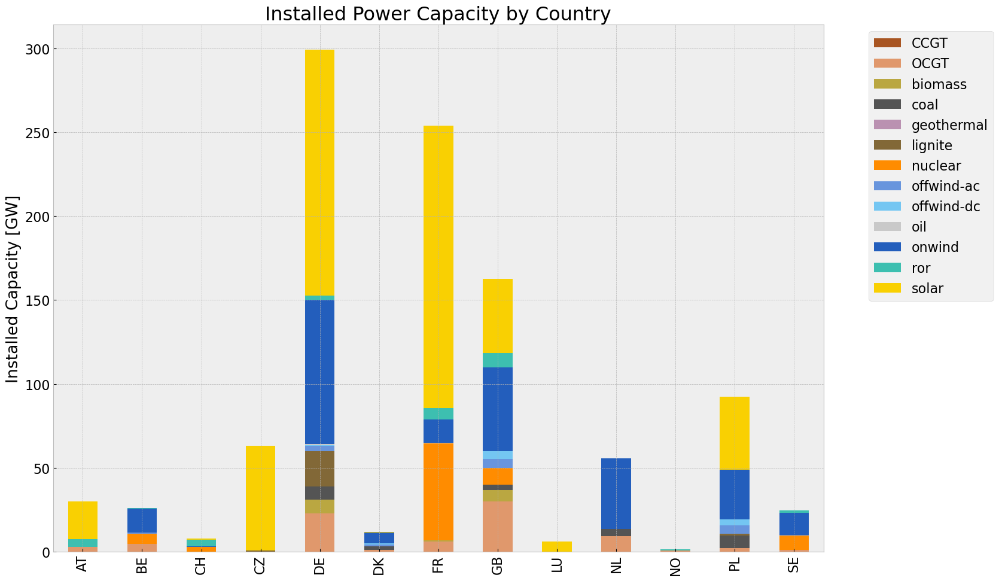

<Figure size 640x480 with 0 Axes>

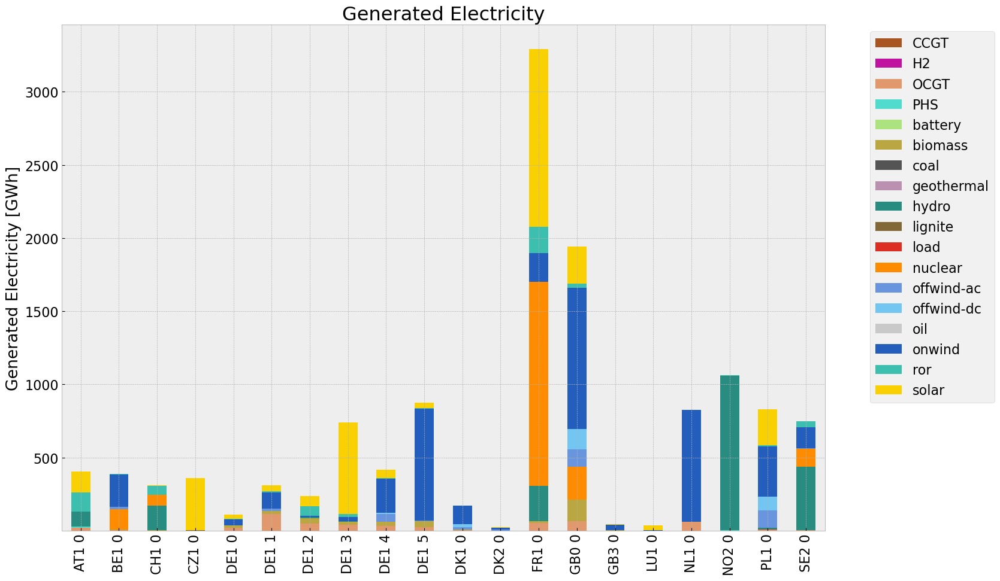

<Figure size 640x480 with 0 Axes>

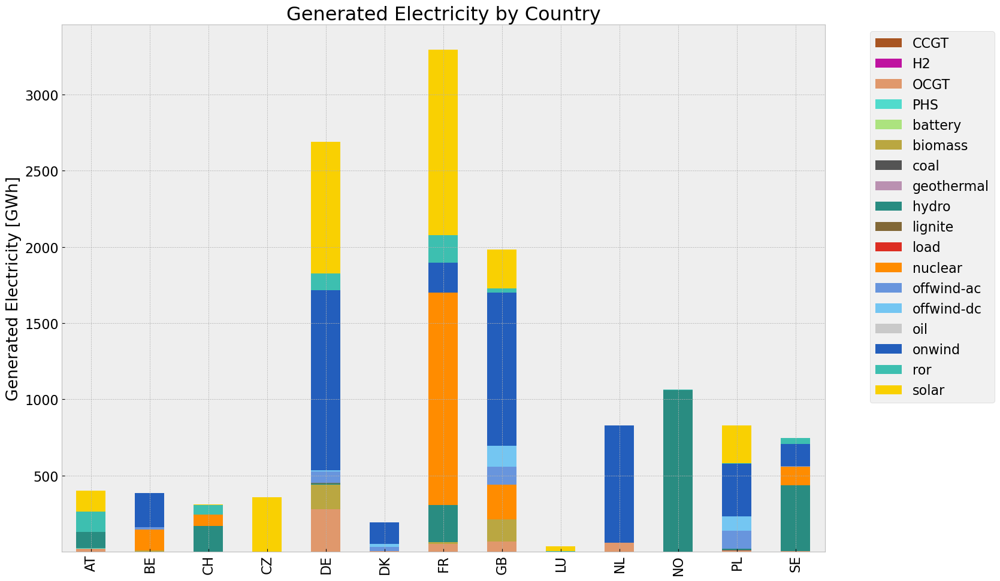

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,4.911440e+05,0.451621,0.1980,215327.770778
biomass,3.259536e+05,0.468000,0.0000,0.000000
coal,5.041211e+03,0.329908,0.3361,5135.827886
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.737522e+03,0.337285,0.4069,3302.544389
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,1.952247e+06,0.326600,0.0000,0.000000
offwind-ac,3.629173e+05,1.000000,0.0000,0.000000


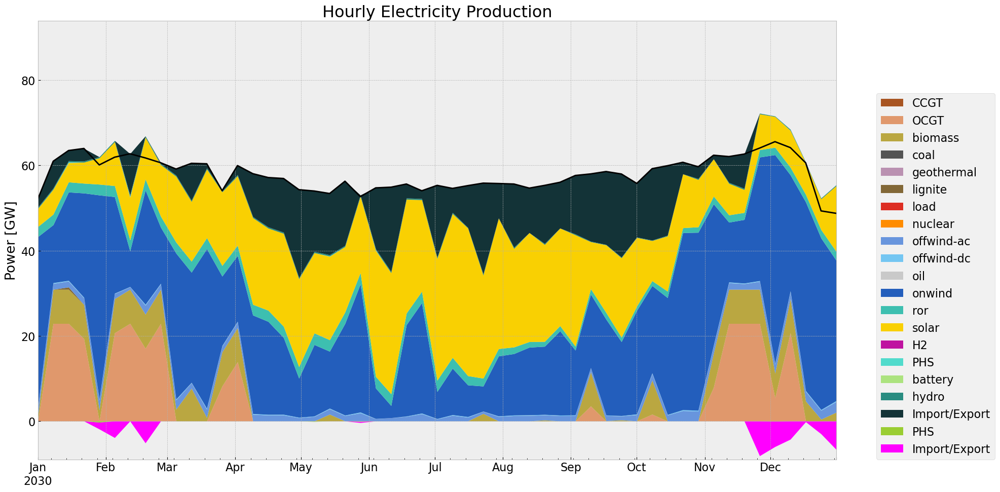

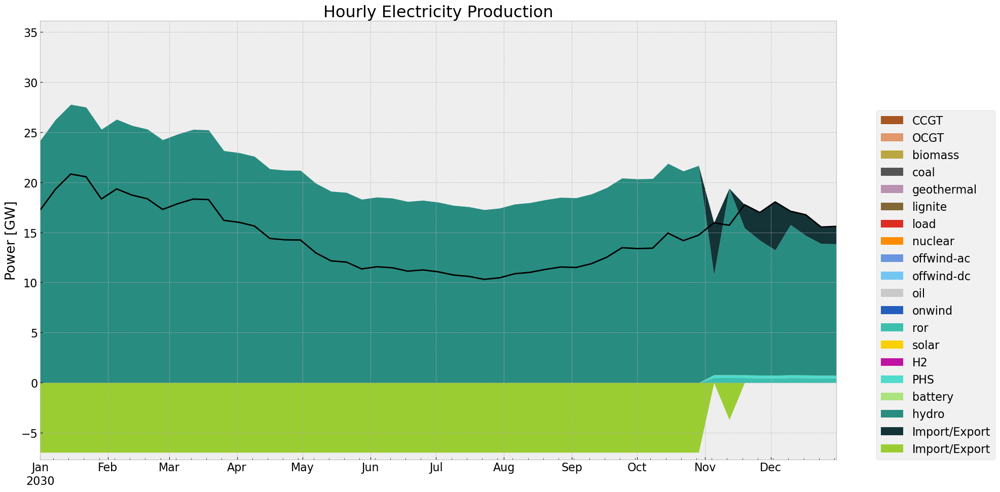

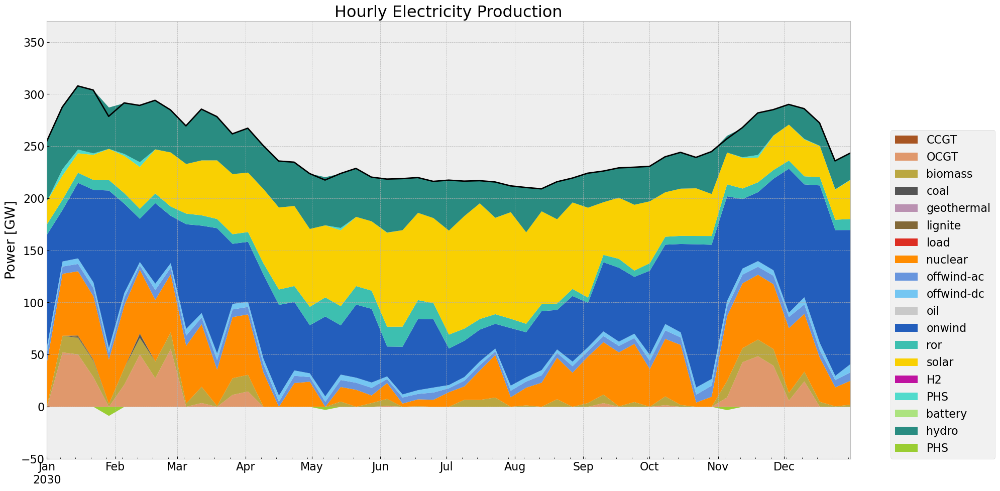

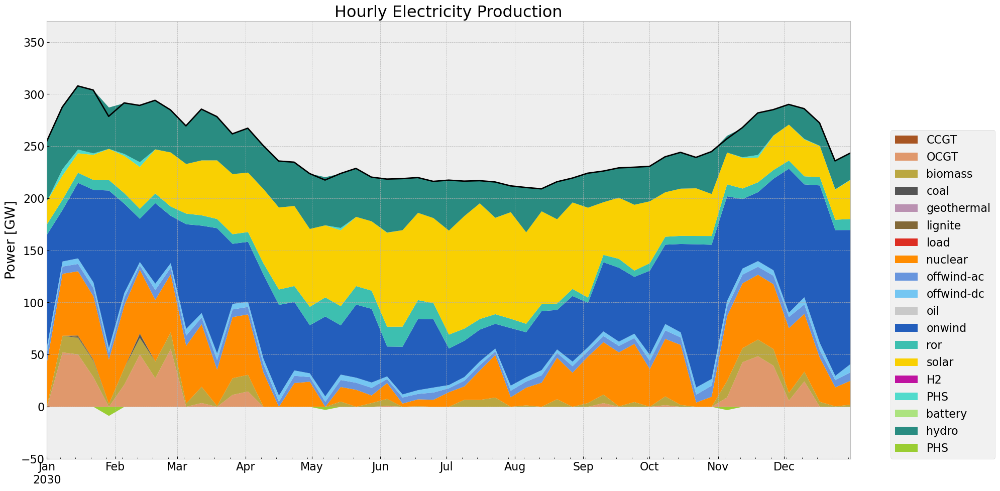

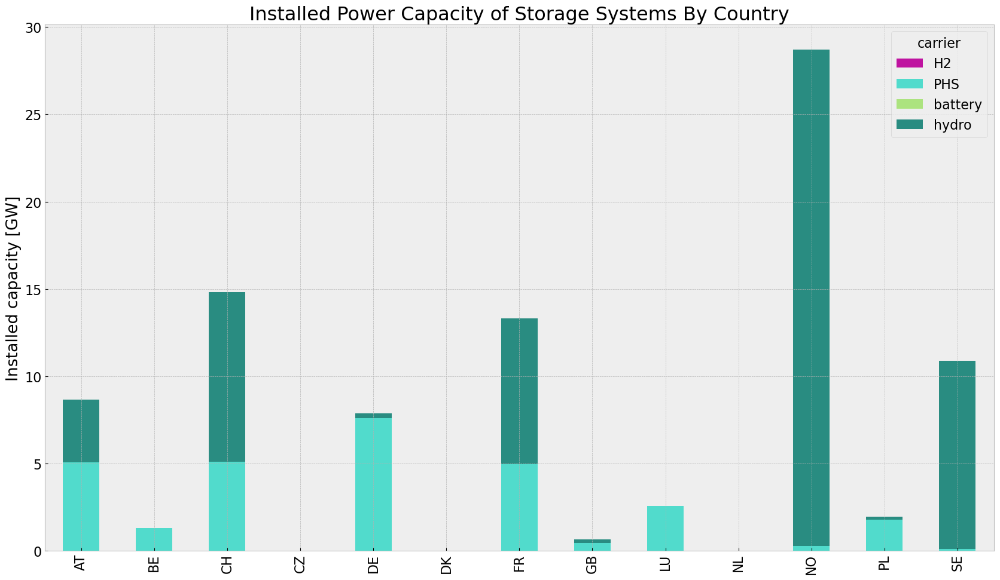

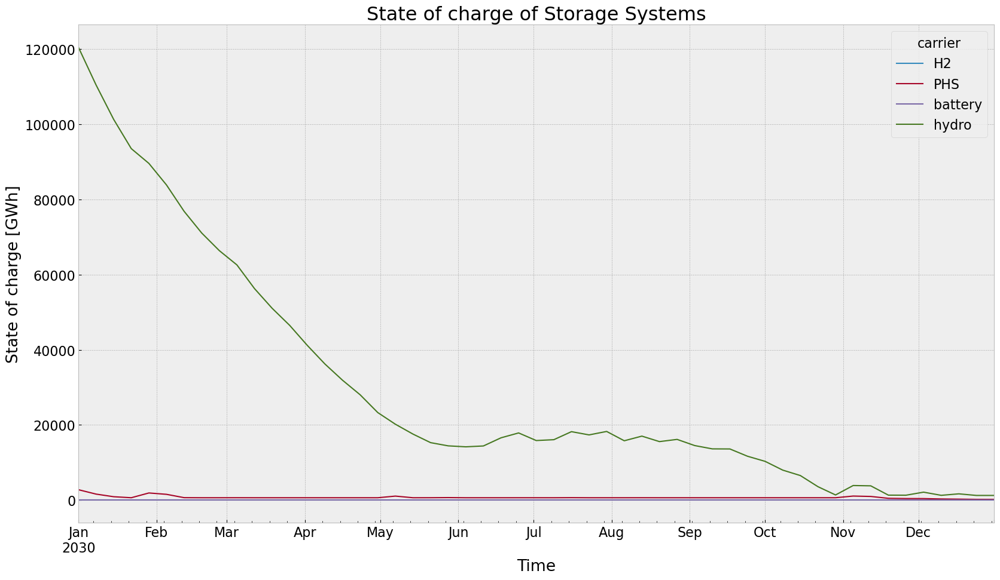

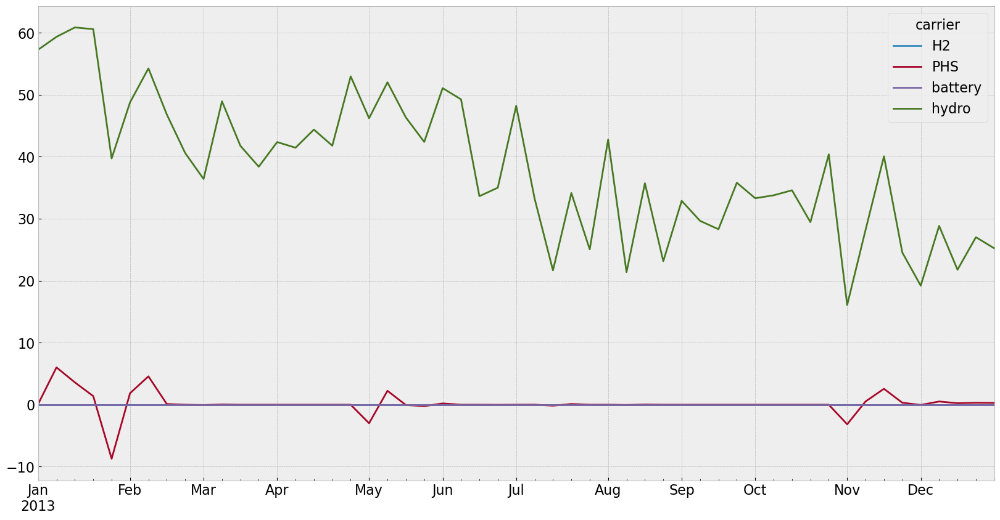

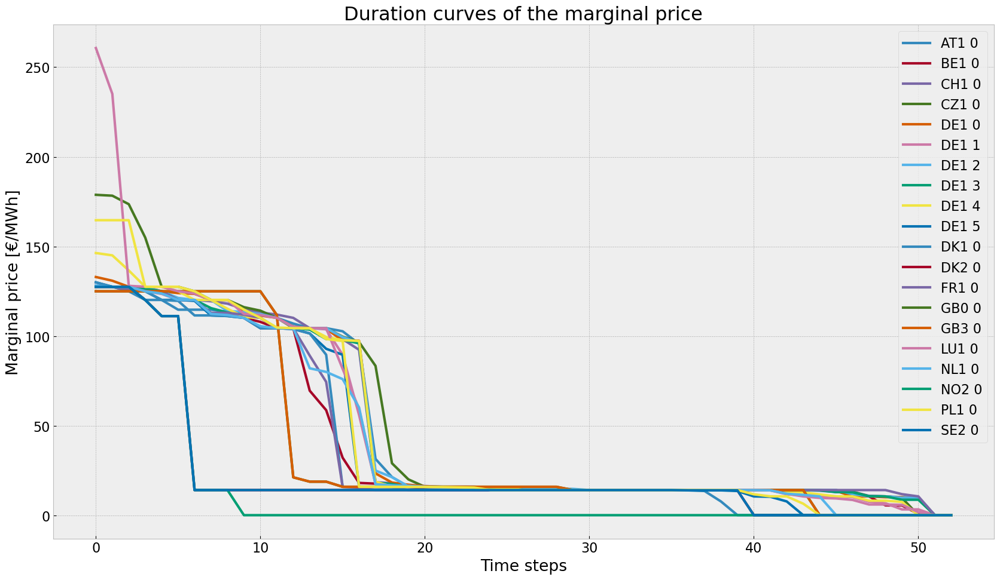

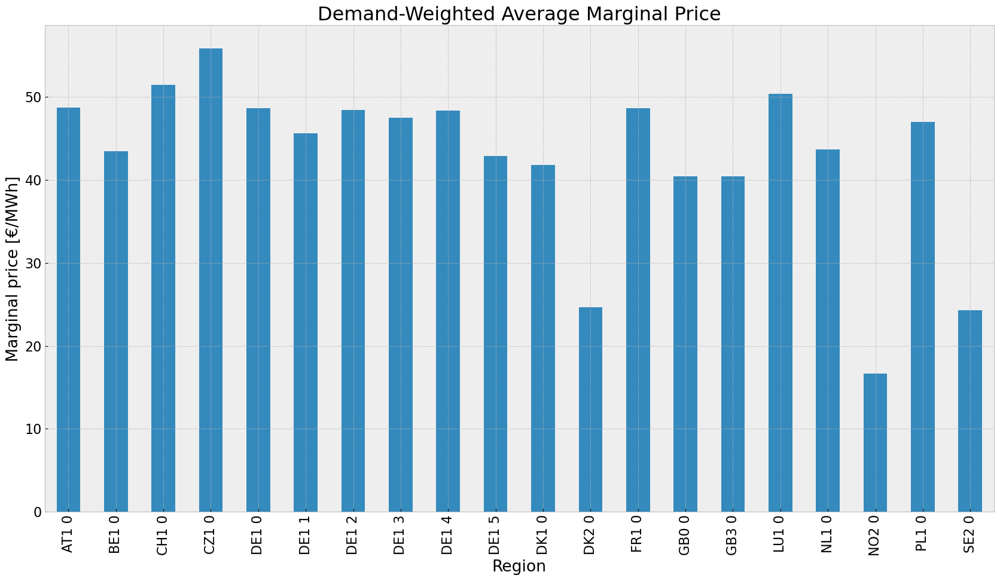

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


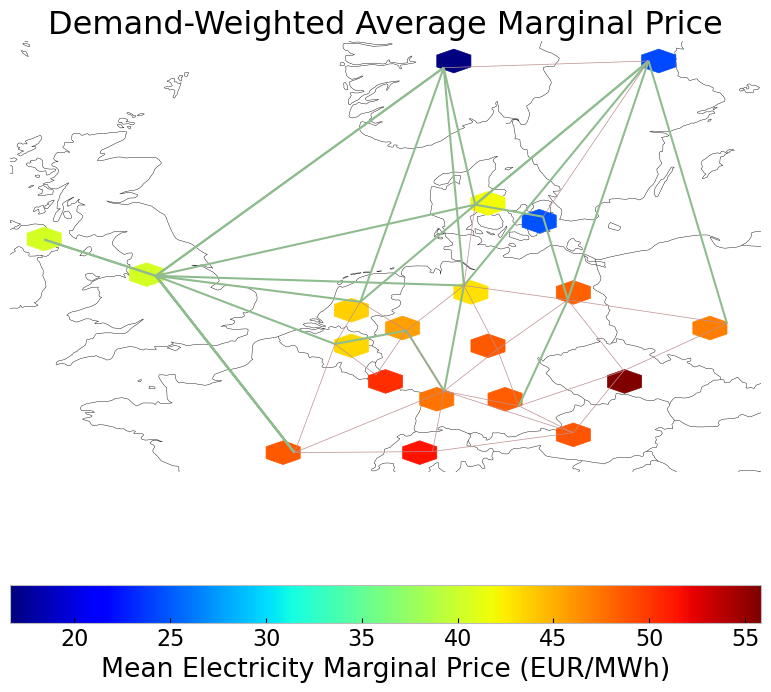

In [69]:
file = f"{country}_{buses}_{le}_base_roll_solved_168h.nc"
output_path = os.path.join(dir, file)
n_roll.export_to_netcdf(output_path)

tot_cos_base_roll=n_roll.objective/1e9 #billion €
system_cost_base_roll = system_cost(n_roll) #million €/a
marg_price_region_base_roll = n_roll.buses_t.marginal_price.mean()
stat_base_roll = n_roll.statistics()

# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_base_roll = inst_cap_table(n_roll, color_cap)
cap_base_roll_country = inst_cap_table_country(n_roll, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_base_roll  = gen_power_table(n_roll)
gen_base_roll_country = gen_power_table_country(n_roll)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'DE')
gen_curve(n_roll, '2030-01-01', '2030-12-31', colors_gen,'NO')
#generation curve all countries
#winter
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n_roll, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_base_roll = inst_store_table(n_roll)

#State of Charge Storage unit
state_of_charge_plot(n_roll, '2030-01-01 00:00', '2030-12-31 21:00')
n_roll.storage_units_t.p.groupby(n_roll.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n_roll)

#avg electricity price
price_regions_table(n_roll)
price_regions(n_roll)

#Emission
em_base_roll =em_table(n_roll)
em_base_roll

## 2. Noinv

In [70]:
n2 = pvscenario(n, carriers_to_cut, duration, reductionto)

cut_start: 2013-04-09 00:00:00


### No Investment

In [71]:
no_inv(n2,n)

In [72]:
#n2.optimize.create_model()
#add_EQ_constraints(n2, o)
#n2.optimize.solve_model(solver_name='gurobi')
n2.optimize(solver_name='gurobi')

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 44.30it/s]
INFO:linopy.io: Writing time: 0.79s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-848no_3i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-848no_3i.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x12f94fda


INFO:gurobipy:Model fingerprint: 0x12f94fda


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14827 columns


INFO:gurobipy:Presolve removed 56286 rows and 14827 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12786 columns, 20842 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12786 columns, 20842 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59150619e+13 -2.93160484e+13  4.45e+05 1.46e-11  6.81e+09     0s


INFO:gurobipy:   0   1.59150619e+13 -2.93160484e+13  4.45e+05 1.46e-11  6.81e+09     0s


   1   1.72949598e+12 -7.54996432e+12  4.08e+04 8.73e-11  7.68e+08     0s


INFO:gurobipy:   1   1.72949598e+12 -7.54996432e+12  4.08e+04 8.73e-11  7.68e+08     0s


   2   3.19309241e+11 -2.19597943e+12  3.74e+03 1.63e-09  1.25e+08     0s


INFO:gurobipy:   2   3.19309241e+11 -2.19597943e+12  3.74e+03 1.63e-09  1.25e+08     0s


   3   9.51964515e+10 -3.63259631e+11  2.89e+02 7.06e-10  1.90e+07     0s


INFO:gurobipy:   3   9.51964515e+10 -3.63259631e+11  2.89e+02 7.06e-10  1.90e+07     0s


   4   5.43186473e+10 -5.48189589e+10  2.05e+01 1.47e-10  4.30e+06     0s


INFO:gurobipy:   4   5.43186473e+10 -5.48189589e+10  2.05e+01 1.47e-10  4.30e+06     0s


   5   4.44925101e+10 -8.24692980e+09  9.35e+00 6.37e-11  2.07e+06     0s


INFO:gurobipy:   5   4.44925101e+10 -8.24692980e+09  9.35e+00 6.37e-11  2.07e+06     0s


   6   3.74492268e+10  1.07049518e+10  4.51e+00 5.82e-11  1.05e+06     0s


INFO:gurobipy:   6   3.74492268e+10  1.07049518e+10  4.51e+00 5.82e-11  1.05e+06     0s


   7   3.34106853e+10  2.12359068e+10  2.18e+00 5.82e-11  4.77e+05     0s


INFO:gurobipy:   7   3.34106853e+10  2.12359068e+10  2.18e+00 5.82e-11  4.77e+05     0s


   8   3.12365339e+10  2.56814155e+10  1.09e+00 5.82e-11  2.17e+05     0s


INFO:gurobipy:   8   3.12365339e+10  2.56814155e+10  1.09e+00 5.82e-11  2.17e+05     0s


   9   2.97340862e+10  2.72548920e+10  4.37e-01 5.82e-11  9.70e+04     0s


INFO:gurobipy:   9   2.97340862e+10  2.72548920e+10  4.37e-01 5.82e-11  9.70e+04     0s


  10   2.90193049e+10  2.80415950e+10  1.42e-01 5.82e-11  3.82e+04     0s


INFO:gurobipy:  10   2.90193049e+10  2.80415950e+10  1.42e-01 5.82e-11  3.82e+04     0s


  11   2.88509960e+10  2.83534828e+10  8.01e-02 5.82e-11  1.95e+04     0s


INFO:gurobipy:  11   2.88509960e+10  2.83534828e+10  8.01e-02 5.82e-11  1.95e+04     0s


  12   2.87586302e+10  2.84769626e+10  4.81e-02 5.82e-11  1.10e+04     0s


INFO:gurobipy:  12   2.87586302e+10  2.84769626e+10  4.81e-02 5.82e-11  1.10e+04     0s


  13   2.86918794e+10  2.85521625e+10  2.49e-02 5.82e-11  5.47e+03     0s


INFO:gurobipy:  13   2.86918794e+10  2.85521625e+10  2.49e-02 5.82e-11  5.47e+03     0s


  14   2.86523177e+10  2.85889650e+10  1.16e-02 5.82e-11  2.48e+03     0s


INFO:gurobipy:  14   2.86523177e+10  2.85889650e+10  1.16e-02 5.82e-11  2.48e+03     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.37 seconds (0.08 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.37 seconds (0.08 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4583    2.8616834e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4583    2.8616834e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4583 iterations and 0.42 seconds (0.12 work units)


INFO:gurobipy:Solved in 4583 iterations and 0.42 seconds (0.12 work units)


Optimal objective  2.861683441e+10


INFO:gurobipy:Optimal objective  2.861683441e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.86e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


('ok', 'optimal')

In [73]:
#n2.optimize(solver_name ='gurobi')
#filename = f"noinv_{contingency}.nc"
#n2 = import_nc_file(directory, filename)
n2.name = f'noinv_{contingency}'    

### Export model for later use

In [74]:
file = f"{n2.name}.nc"
output_path = os.path.join(os.getcwd(), file)
n2.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_pv.nc has lines, generators, carriers, loads, global_constraints, buses, links, storage_units


<xarray.Dataset> Size: 271kB
Dimensions:                               (snapshots: 53,
                                           investment_periods: 0, lines_i: 27,
                                           lines_t_p0_i: 27, lines_t_p1_i: 27,
                                           lines_t_loss_i: 27,
                                           generators_i: 261,
                                           generators_t_p_max_pu_i: 81,
                                           ...
                                           storage_units_i: 65,
                                           storage_units_t_inflow_i: 10,
                                           storage_units_t_p_i: 23,
                                           storage_units_t_p_dispatch_i: 23,
                                           storage_units_t_p_store_i: 13,
                                           storage_units_t_state_of_charge_i: 65)
Coordinates: (12/27)
  * snapshots                             (snapshots) int64 424B 0 1 2 ... 51 52
  * investment_periods                    (investment_periods) int64 0B 
  * lines_i                               (lines_i) object 216B '0' '1' ... '9'
  * lines_t_p0_i                          (lines_t_p0_i) object 216B '0' ... '9'
  * lines_t_p1_i                          (lines_t_p1_i) object 216B '0' ... '9'
  * lines_t_loss_i                        (lines_t_loss_i) object 216B '0' .....
    ...                                    ...
  * storage_units_i                       (storage_units_i) object 520B 'AT1 ...
  * storage_units_t_inflow_i              (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                   (storage_units_t_p_i) object 184B '...
  * storage_units_t_p_dispatch_i          (storage_units_t_p_dispatch_i) object 184B ...
  * storage_units_t_p_store_i             (storage_units_t_p_store_i) object 104B ...
  * storage_units_t_state_of_charge_i     (storage_units_t_state_of_charge_i) object 520B ...
Data variables: (12/98)
    snapshots_snapshot                    (snapshots) datetime64[ns] 424B 201...
    snapshots_objective                   (snapshots) float64 424B 168.0 ... ...
    snapshots_generators                  (snapshots) float64 424B 168.0 ... ...
    snapshots_stores                      (snapshots) float64 424B 168.0 ... ...
    investment_periods_objective          (investment_periods) float64 0B 
    investment_periods_years              (investment_periods) float64 0B 
    ...                                    ...
    storage_units_country                 (storage_units_i) object 520B 'AT' ...
    storage_units_t_inflow                (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                     (snapshots, storage_units_t_p_i) float64 10kB ...
    storage_units_t_p_dispatch            (snapshots, storage_units_t_p_dispatch_i) float64 10kB ...
    storage_units_t_p_store               (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge       (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_pv
    network_objective:       28616834409.836044
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [75]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

### Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

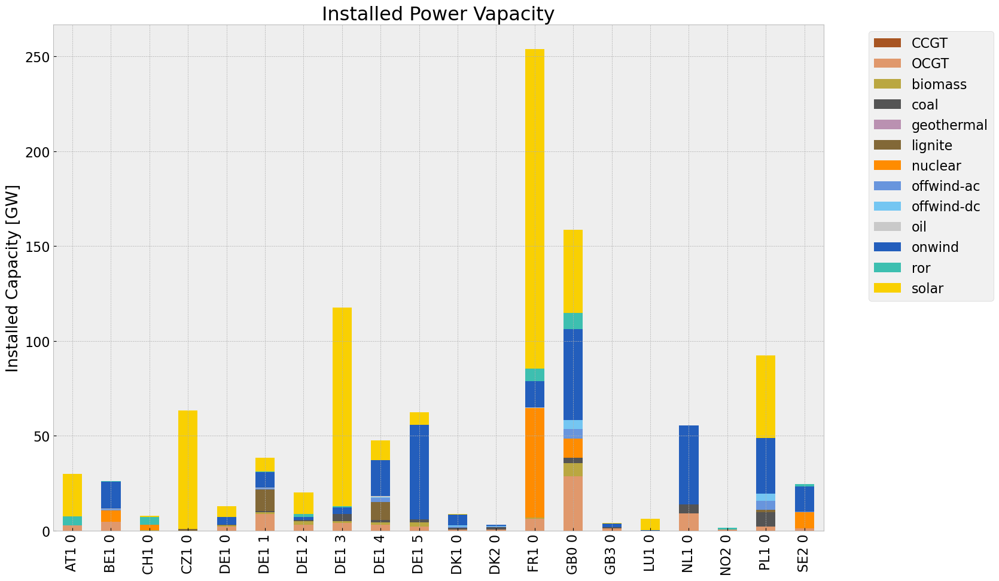

<Figure size 640x480 with 0 Axes>

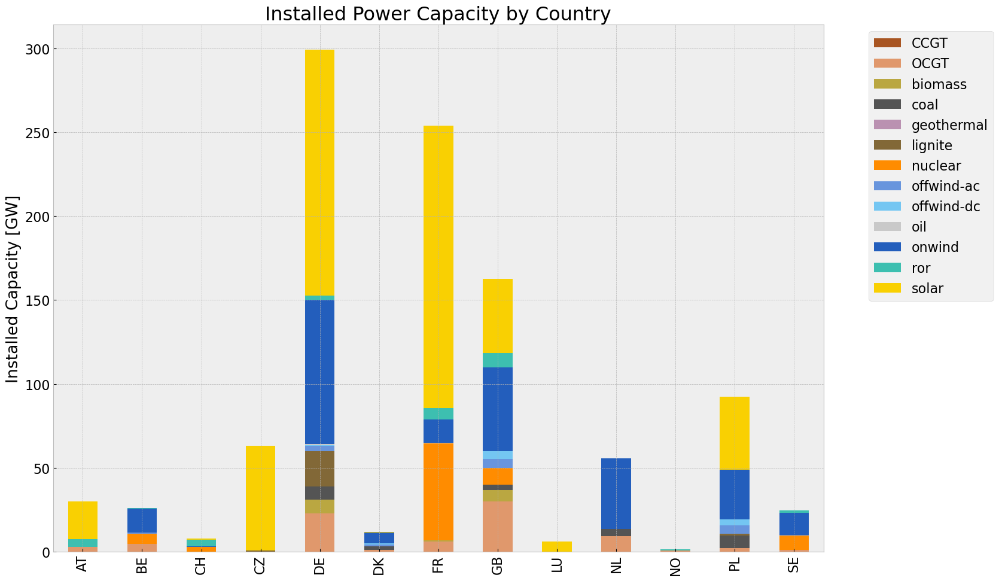

In [76]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



### Generation

<Figure size 640x480 with 0 Axes>

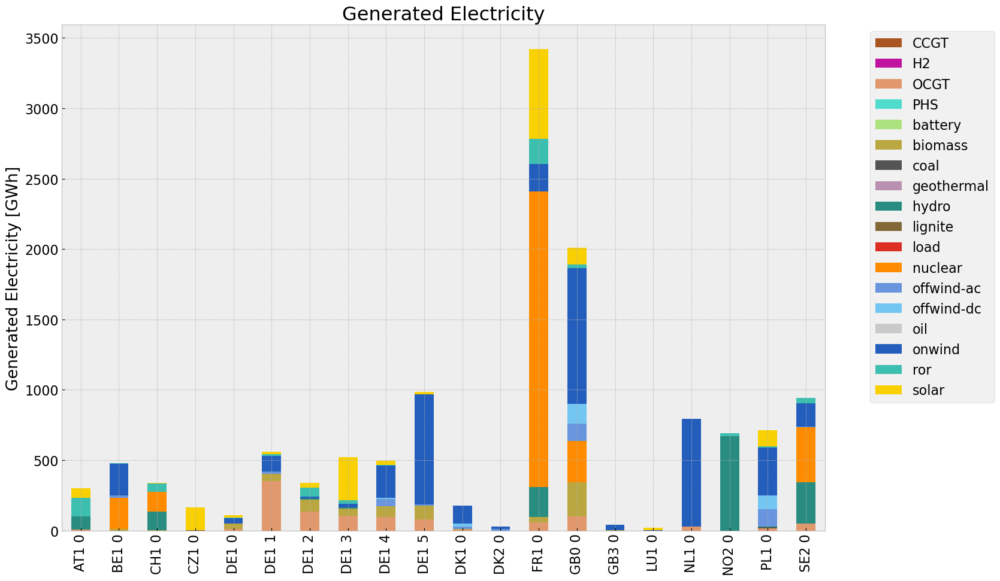

<Figure size 640x480 with 0 Axes>

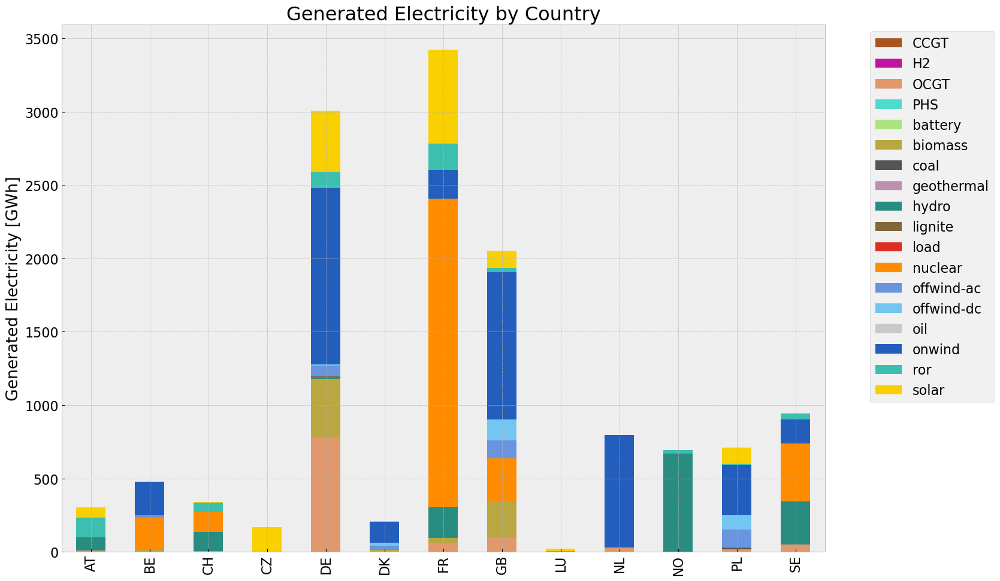

In [77]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2)
gen_noinv_country = gen_power_table_country(n2)


### Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3583045713.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3583045713.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum(

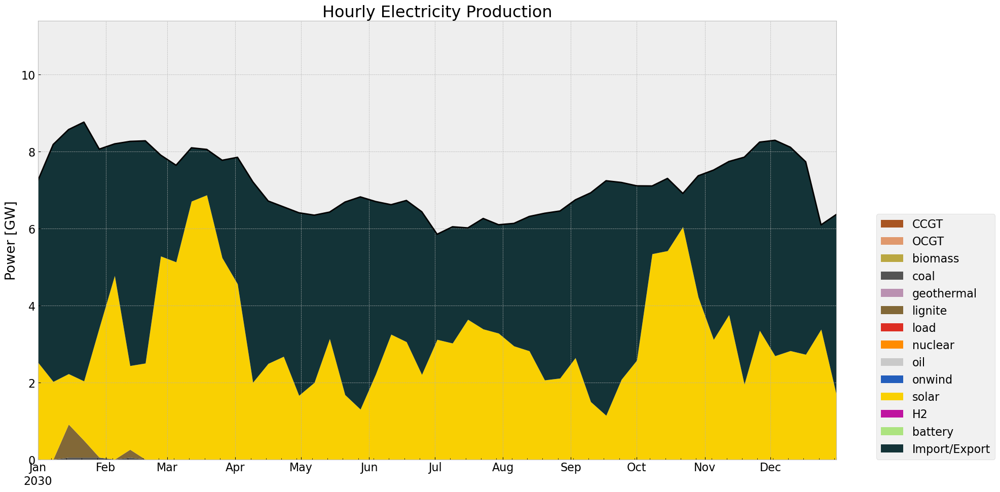

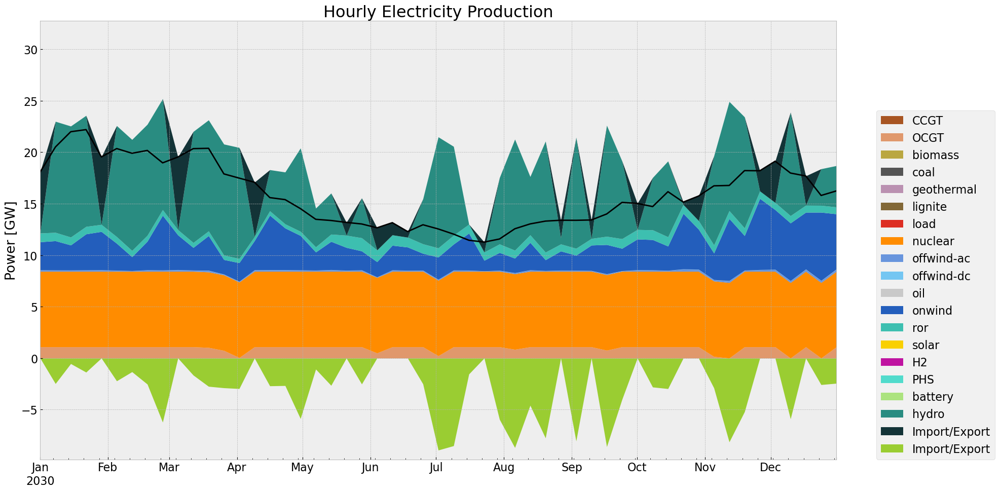

In [78]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'CZ')
gen_curve(n2, '2030-01-01', '2030-12-31', colors_gen,'SE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\2732365766.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq

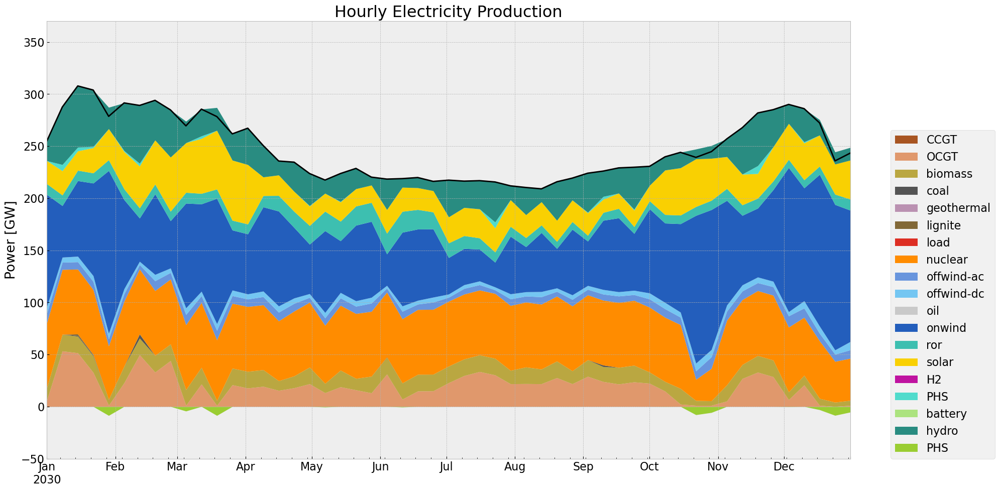

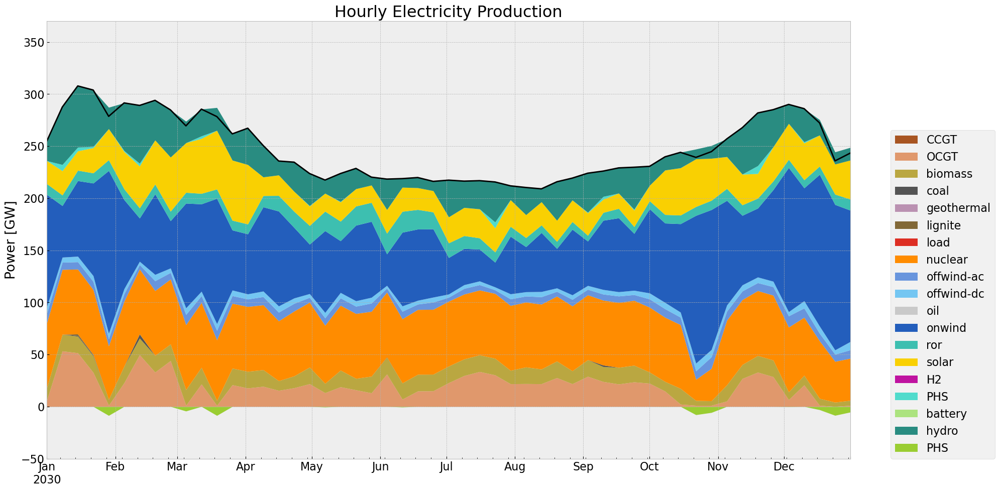

In [79]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-01-01', '2030-12-31', colors_gen)

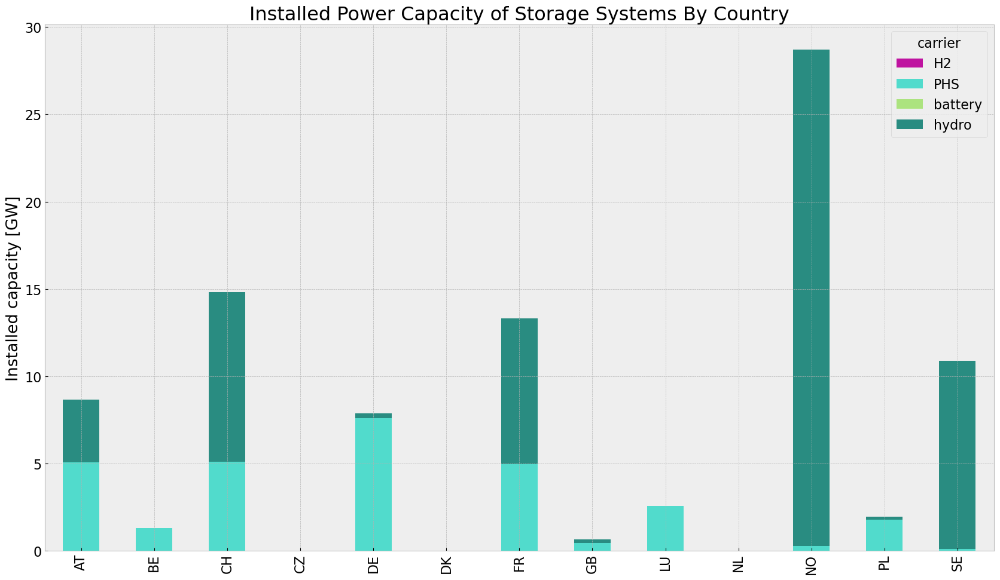

In [80]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start= '2030-01-01 00:00' , end= '2030-12-31 21:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\4184885543.py:11: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start= start_date , end= end_date, freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\3064997258.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, 

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.052259e+06,0.451621,0.1980,461332.286871
biomass,7.002008e+05,0.468000,0.0000,0.000000
coal,7.131584e+03,0.329908,0.3361,7265.435320
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,2.044062e+03,0.337285,0.4069,2465.954902
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,3.138668e+06,0.326600,0.0000,0.000000
offwind-ac,3.736193e+05,1.000000,0.0000,0.000000


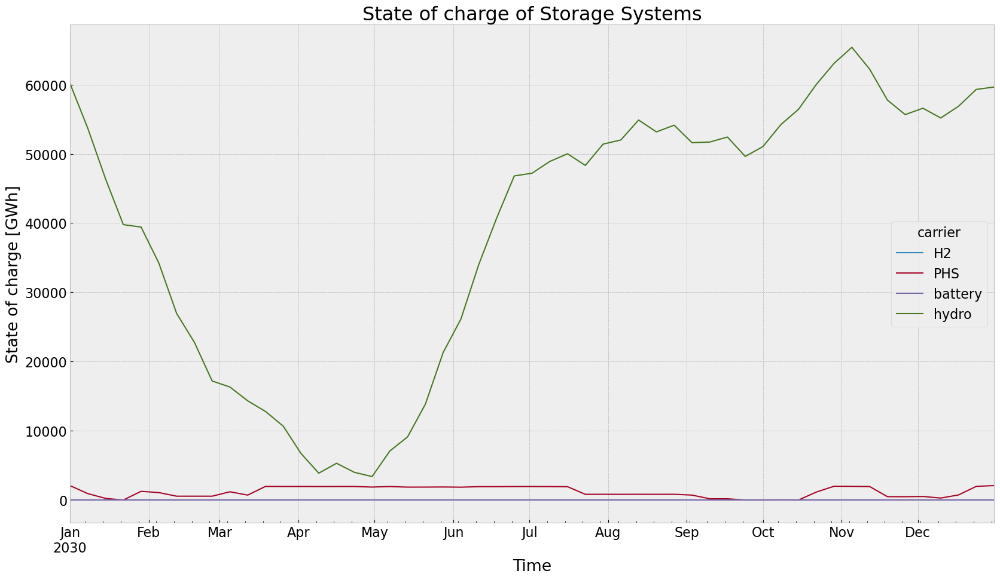

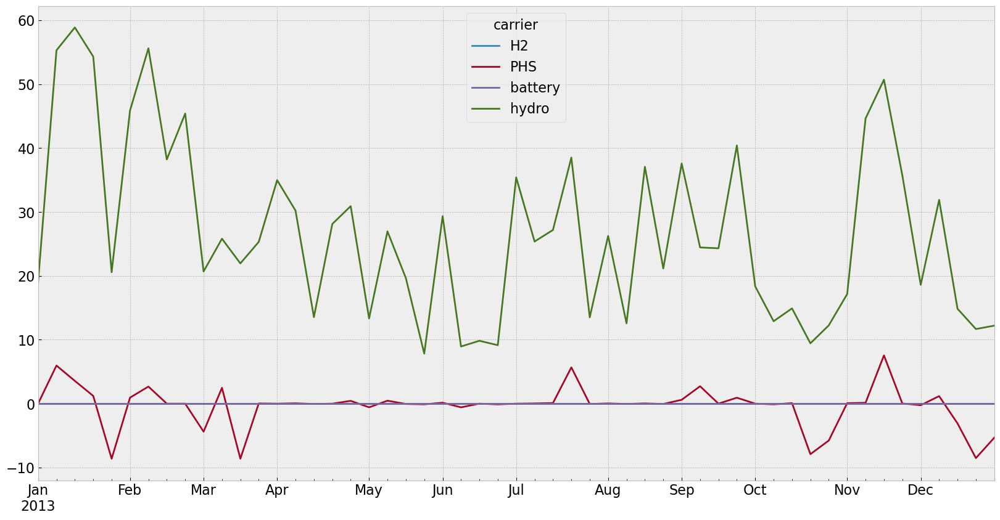

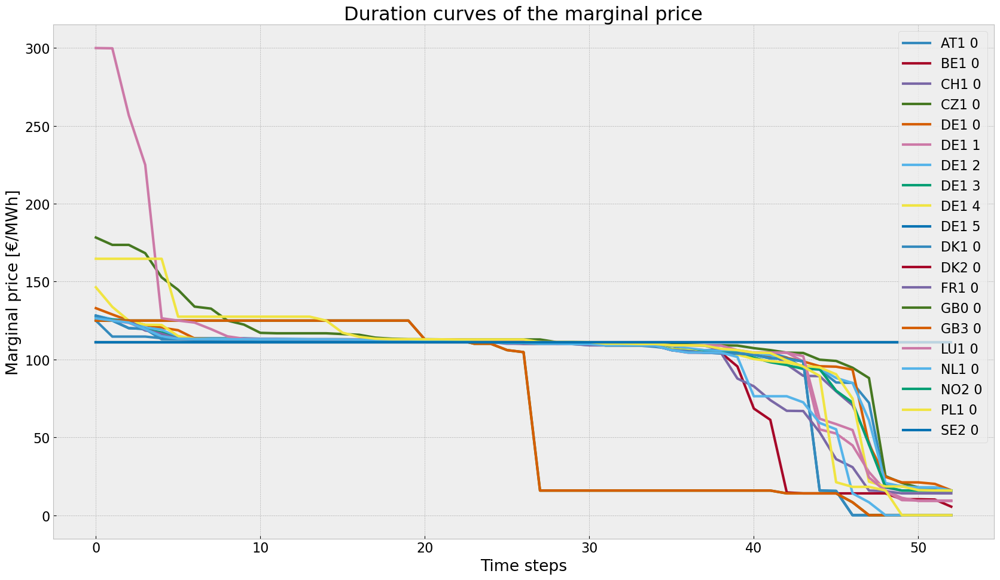

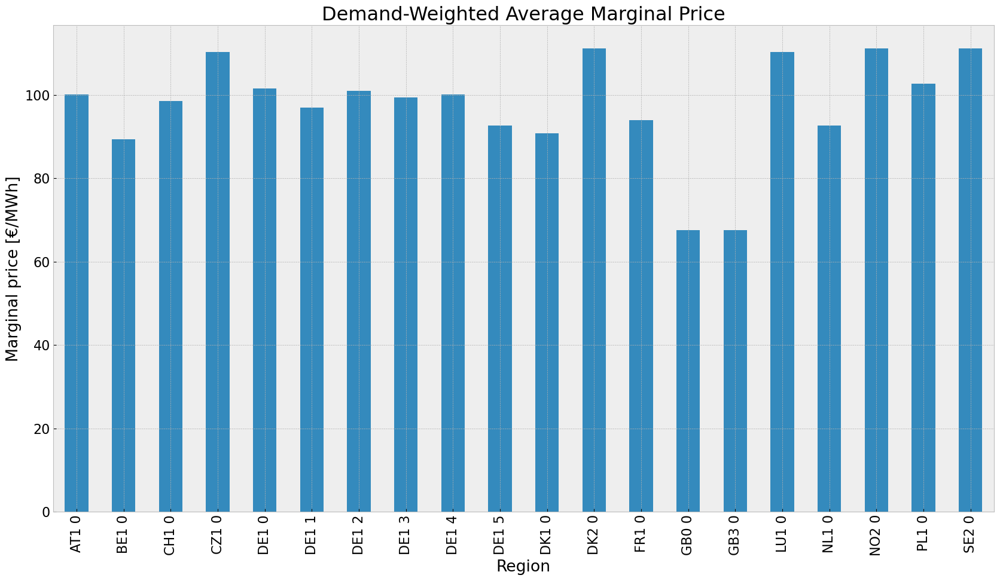

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


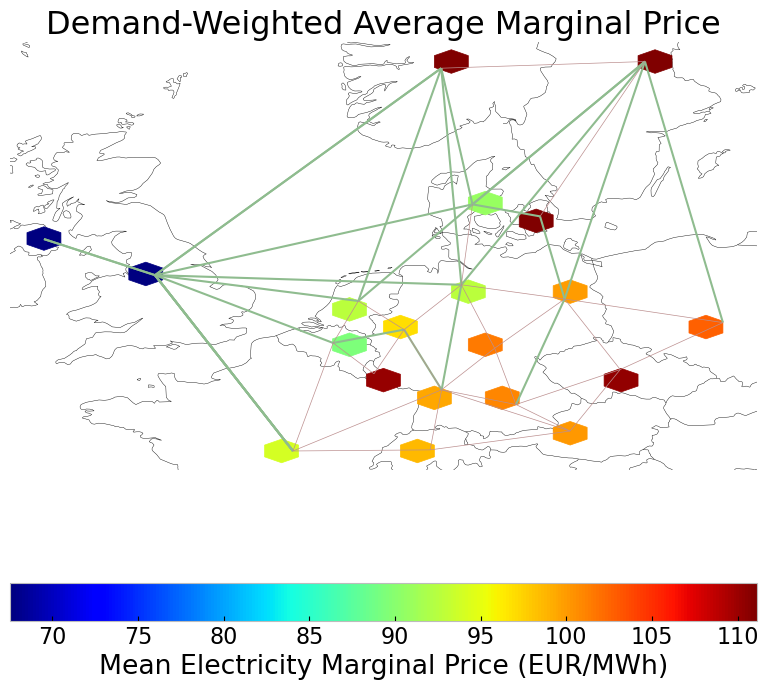

In [81]:
#state of charge
state_of_charge_plot(n2, '2030-01-01 00:00', '2030-12-31 21:00')
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [82]:
n3 = n2.copy()
no_inv(n3,n)

n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False
set_initial_soc(n3, n2)



optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#n3.optimize.create_model()

#filename = f"noinv_roll_{contingency}.nc"
#n3 = import_nc_file(directory, filename)
n3.name = f'noinv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qwkoo5uh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qwkoo5uh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x36ca1d13


INFO:gurobipy:Model fingerprint: 0x36ca1d13


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4288 rows and 1237 columns


INFO:gurobipy:Presolve removed 4288 rows and 1237 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 184 rows, 847 columns, 1347 nonzeros


INFO:gurobipy:Presolved: 184 rows, 847 columns, 1347 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9223232e+08   6.840504e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9223232e+08   6.840504e+05   0.000000e+00      0s


     192    3.2392593e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     192    3.2392593e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 192 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 192 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.239259258e+09


INFO:gurobipy:Optimal objective  3.239259258e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hxjeta6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hxjeta6.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd01b281d


INFO:gurobipy:Model fingerprint: 0xd01b281d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4260 rows and 1201 columns


INFO:gurobipy:Presolve removed 4260 rows and 1201 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 212 rows, 883 columns, 1432 nonzeros


INFO:gurobipy:Presolved: 212 rows, 883 columns, 1432 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4142771e+08   8.806480e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4142771e+08   8.806480e+05   0.000000e+00      0s


     257    2.7063278e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     257    2.7063278e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 257 iterations and 0.10 seconds (0.01 work units)


INFO:gurobipy:Solved in 257 iterations and 0.10 seconds (0.01 work units)


Optimal objective  2.706327838e+09


INFO:gurobipy:Optimal objective  2.706327838e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1wkrlji.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1wkrlji.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7af87e4d


INFO:gurobipy:Model fingerprint: 0x7af87e4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4251 rows and 1154 columns


INFO:gurobipy:Presolve removed 4251 rows and 1154 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 221 rows, 930 columns, 1510 nonzeros


INFO:gurobipy:Presolved: 221 rows, 930 columns, 1510 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9375522e+08   9.351403e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.9375522e+08   9.351403e+05   0.000000e+00      0s


     297    2.1336389e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     297    2.1336389e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 297 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 297 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.133638861e+09


INFO:gurobipy:Optimal objective  2.133638861e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22j_99cw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-22j_99cw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf71f3334


INFO:gurobipy:Model fingerprint: 0xf71f3334


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1163 columns


INFO:gurobipy:Presolve removed 4255 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 921 columns, 1487 nonzeros


INFO:gurobipy:Presolved: 217 rows, 921 columns, 1487 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1816951e+09   9.019006e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1816951e+09   9.019006e+05   0.000000e+00      0s


     302    1.5960045e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     302    1.5960045e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 302 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 302 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.596004512e+10


INFO:gurobipy:Optimal objective  1.596004512e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.60e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-36cib5fp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-36cib5fp.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x28370a83


INFO:gurobipy:Model fingerprint: 0x28370a83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1156 columns


INFO:gurobipy:Presolve removed 4255 rows and 1156 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 217 rows, 928 columns, 1494 nonzeros


INFO:gurobipy:Presolved: 217 rows, 928 columns, 1494 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4934340e+08   9.102113e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4934340e+08   9.102113e+05   0.000000e+00      0s


     266    3.7587416e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    3.7587416e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 266 iterations and 0.08 seconds (0.01 work units)


Optimal objective  3.758741609e+09


INFO:gurobipy:Optimal objective  3.758741609e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.76e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4g_j5xch.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4g_j5xch.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x89bc5b80


INFO:gurobipy:Model fingerprint: 0x89bc5b80


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1180 columns


INFO:gurobipy:Presolve removed 4266 rows and 1180 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 206 rows, 904 columns, 1451 nonzeros


INFO:gurobipy:Presolved: 206 rows, 904 columns, 1451 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3510505e+08   8.979216e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3510505e+08   8.979216e+05   0.000000e+00      0s


     290    1.0056931e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     290    1.0056931e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 290 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 290 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.005693082e+09


INFO:gurobipy:Optimal objective  1.005693082e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wgrh0jrg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wgrh0jrg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2be3a284


INFO:gurobipy:Model fingerprint: 0x2be3a284


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1145 columns


INFO:gurobipy:Presolve removed 4254 rows and 1145 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 218 rows, 939 columns, 1511 nonzeros


INFO:gurobipy:Presolved: 218 rows, 939 columns, 1511 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4828434e+08   9.280142e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4828434e+08   9.280142e+05   0.000000e+00      0s


     307    1.4468224e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    1.4468224e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.446822352e+09


INFO:gurobipy:Optimal objective  1.446822352e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.45e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7i6yv6du.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7i6yv6du.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x182af655


INFO:gurobipy:Model fingerprint: 0x182af655


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1137 columns


INFO:gurobipy:Presolve removed 4248 rows and 1137 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8753673e+08   8.939339e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8753673e+08   8.939339e+05   0.000000e+00      0s


     322    2.9492526e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     322    2.9492526e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 322 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 322 iterations and 0.06 seconds (0.01 work units)


Optimal objective  2.949252626e+09


INFO:gurobipy:Optimal objective  2.949252626e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.95e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5rrpllme.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5rrpllme.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x1eadbc11


INFO:gurobipy:Model fingerprint: 0x1eadbc11


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1134 columns


INFO:gurobipy:Presolve removed 4248 rows and 1134 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 950 columns, 1533 nonzeros


INFO:gurobipy:Presolved: 224 rows, 950 columns, 1533 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3194051e+07   8.942153e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3194051e+07   8.942153e+05   0.000000e+00      0s


     337    2.7851685e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     337    2.7851685e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 337 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 337 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.785168532e+09


INFO:gurobipy:Optimal objective  2.785168532e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.79e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4k699ui.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4k699ui.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xfb6710b0


INFO:gurobipy:Model fingerprint: 0xfb6710b0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1142 columns


INFO:gurobipy:Presolve removed 4248 rows and 1142 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 942 columns, 1525 nonzeros


INFO:gurobipy:Presolved: 224 rows, 942 columns, 1525 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6152937e+07   8.947072e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6152937e+07   8.947072e+05   0.000000e+00      0s


     332    2.5494229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    2.5494229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.549422910e+09


INFO:gurobipy:Optimal objective  2.549422910e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_zmjrhec.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_zmjrhec.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xabab8dee


INFO:gurobipy:Model fingerprint: 0xabab8dee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1140 columns


INFO:gurobipy:Presolve removed 4248 rows and 1140 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 944 columns, 1527 nonzeros


INFO:gurobipy:Presolved: 224 rows, 944 columns, 1527 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3591612e+05   8.945825e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.3591612e+05   8.945825e+05   0.000000e+00      0s


     306    3.8130868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     306    3.8130868e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 306 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 306 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.813086786e+08


INFO:gurobipy:Optimal objective  3.813086786e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mkat6z2p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mkat6z2p.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xfa4ff84d


INFO:gurobipy:Model fingerprint: 0xfa4ff84d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1140 columns


INFO:gurobipy:Presolve removed 4248 rows and 1140 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 944 columns, 1527 nonzeros


INFO:gurobipy:Presolved: 224 rows, 944 columns, 1527 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2047623e+07   8.622242e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2047623e+07   8.622242e+05   0.000000e+00      0s


     325    3.3916691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     325    3.3916691e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 325 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 325 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.391669053e+09


INFO:gurobipy:Optimal objective  3.391669053e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.26s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jbqcb313.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jbqcb313.lp


Reading time = 0.13 seconds


INFO:gurobipy:Reading time = 0.13 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x9f1b5764


INFO:gurobipy:Model fingerprint: 0x9f1b5764


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1165 columns


INFO:gurobipy:Presolve removed 4248 rows and 1165 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 919 columns, 1502 nonzeros


INFO:gurobipy:Presolved: 224 rows, 919 columns, 1502 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.0921959e+05   8.856737e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.0921959e+05   8.856737e+05   0.000000e+00      0s


     266    1.0366792e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     266    1.0366792e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 266 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 266 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.036679218e+09


INFO:gurobipy:Optimal objective  1.036679218e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iui0d82g.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iui0d82g.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x85c7ca70


INFO:gurobipy:Model fingerprint: 0x85c7ca70


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 313 columns


INFO:gurobipy:Presolve removed 1072 rows and 313 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 208 columns, 325 nonzeros


INFO:gurobipy:Presolved: 46 rows, 208 columns, 325 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.9508455e+04   8.634826e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.9508455e+04   8.634826e+04   0.000000e+00      0s


      41    8.7678792e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      41    8.7678792e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 41 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 41 iterations and 0.03 seconds (0.00 work units)


Optimal objective  8.767879154e+06


INFO:gurobipy:Optimal objective  8.767879154e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 8.77e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


In [83]:
n3.model

Linopy LP model

Variables:
----------
 * Generator-p (snapshot, Generator)
 * Line-s (snapshot, Line)
 * Link-p (snapshot, Link)
 * StorageUnit-p_dispatch (snapshot, StorageUnit)
 * StorageUnit-p_store (snapshot, StorageUnit)
 * StorageUnit-state_of_charge (snapshot, StorageUnit)
 * StorageUnit-spill (snapshot, StorageUnit)

Constraints:
------------
 * Generator-fix-p-lower (snapshot, Generator-fix)
 * Generator-fix-p-upper (snapshot, Generator-fix)
 * Line-fix-s-lower (snapshot, Line-fix)
 * Line-fix-s-upper (snapshot, Line-fix)
 * Link-fix-p-lower (snapshot, Link-fix)
 * Link-fix-p-upper (snapshot, Link-fix)
 * StorageUnit-fix-p_dispatch-lower (snapshot, StorageUnit-fix)
 * StorageUnit-fix-p_dispatch-upper (snapshot, StorageUnit-fix)
 * StorageUnit-fix-p_store-lower (snapshot, StorageUnit-fix)
 * StorageUnit-fix-p_store-upper (snapshot, StorageUnit-fix)
 * StorageUnit-fix-state_of_charge-lower (snapshot, StorageUnit-fix)
 * StorageUnit-fix-state_of_charge-upper (snapshot, StorageUn

### Export Model for later use

In [84]:
filename = f"{n3.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n3.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network noinv_roll_pv.nc has lines, generators, carriers, loads, global_constraints, buses, links, storage_units


<xarray.Dataset> Size: 279kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      ...
                                                      storage_units_t_inflow_i: 10,
                                                      storage_units_t_p_i: 24,
                                                      storage_units_t_p_dispatch_i: 24,
                                                      storage_units_t_p_store_i: 14,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 8)
Coordinates: (12/28)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
    ...                                               ...
  * storage_units_t_inflow_i                         (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                              (storage_units_t_p_i) object 192B ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 192B ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 112B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 64B ...
Data variables: (12/99)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    storage_units_t_inflow                           (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                                (snapshots, storage_units_t_p_i) float64 10kB ...
    storage_units_t_p_dispatch                       (snapshots, storage_units_t_p_dispatch_i) float64 10kB ...
    storage_units_t_p_store                          (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge                  (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
    storage_units_t_spill                            (snapshots, storage_units_t_spill_i) float64 3kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            noinv_roll_pv
    network_objective:       8767879.154253755
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [85]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

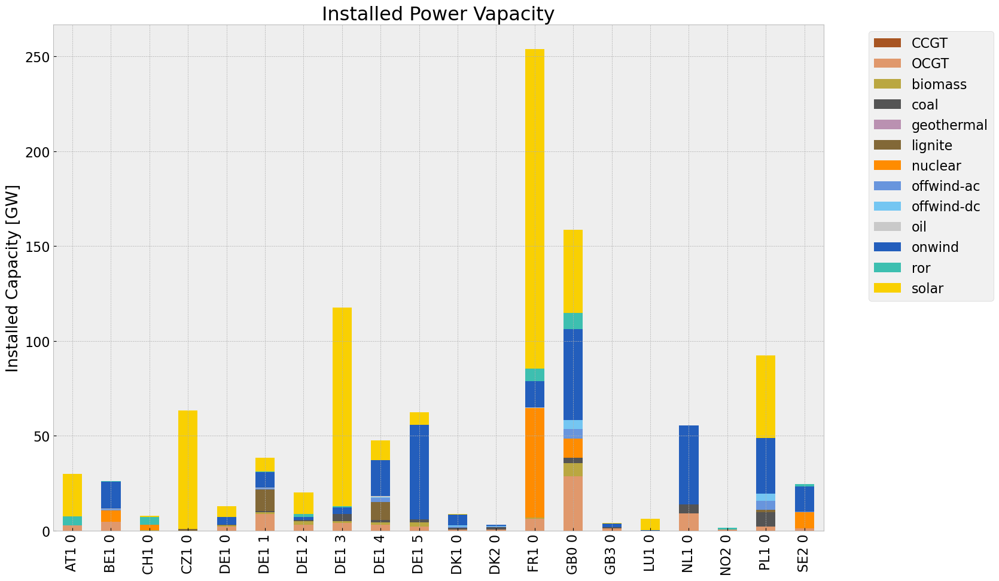

<Figure size 640x480 with 0 Axes>

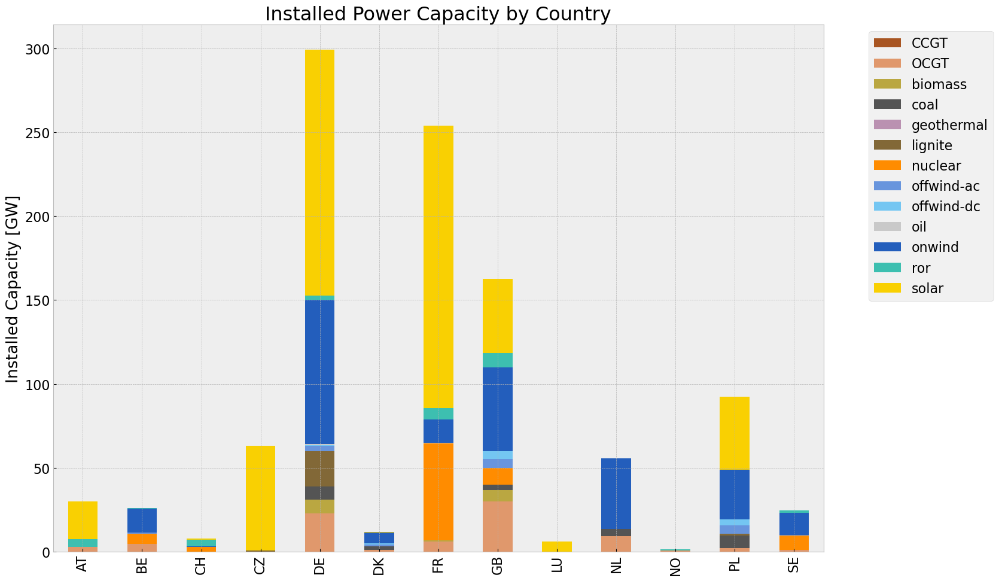

<Figure size 640x480 with 0 Axes>

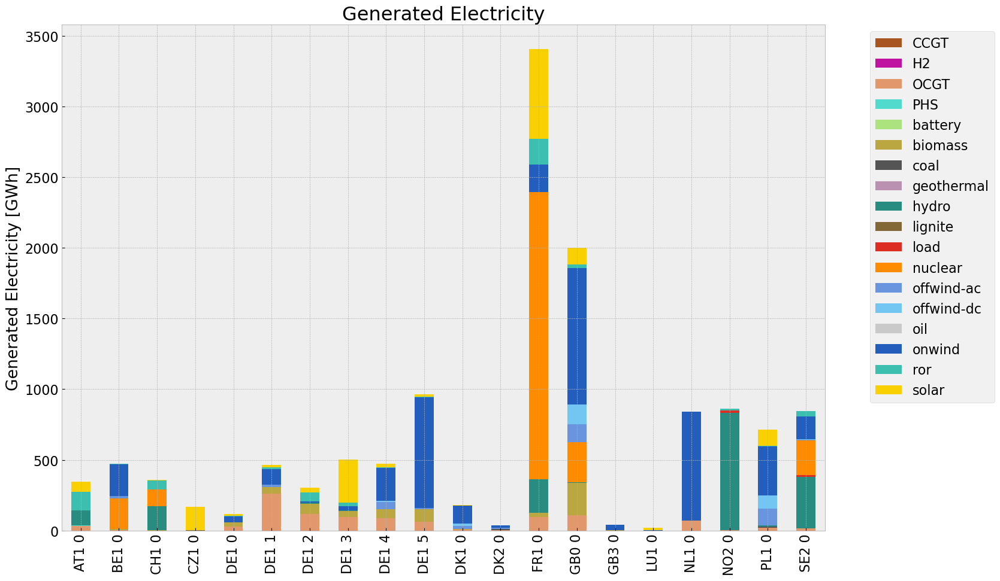

<Figure size 640x480 with 0 Axes>

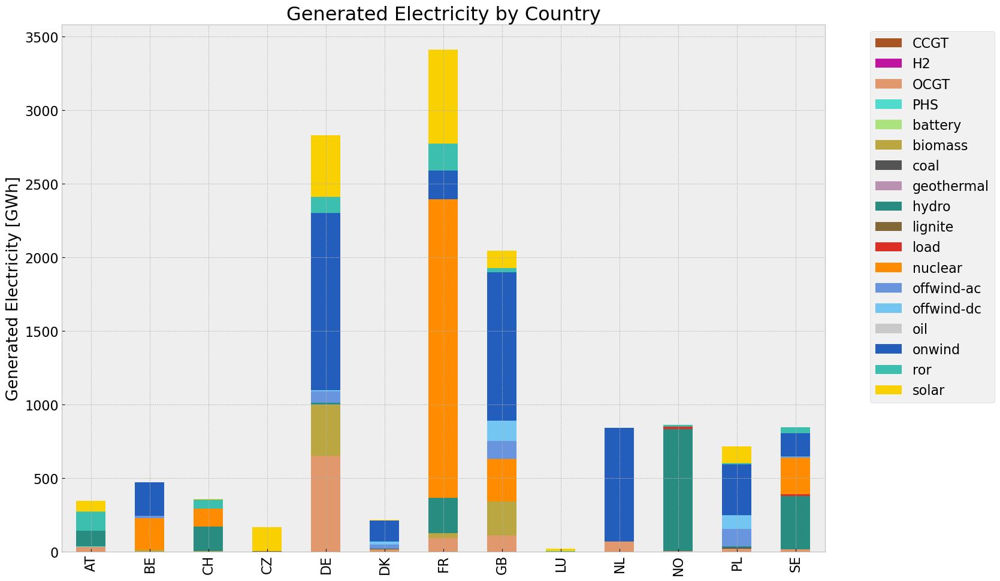

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
C:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,1.014930e+06,0.451621,0.1980,444966.615424
biomass,6.305580e+05,0.468000,0.0000,0.000000
coal,1.572912e+04,0.329908,0.3361,16024.334002
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,3.603328e+03,0.337285,0.4069,4347.051858
load,3.078915e+04,1.000000,0.0000,0.000000
nuclear,2.894255e+06,0.326600,0.0000,0.000000
offwind-ac,3.720722e+05,1.000000,0.0000,0.000000


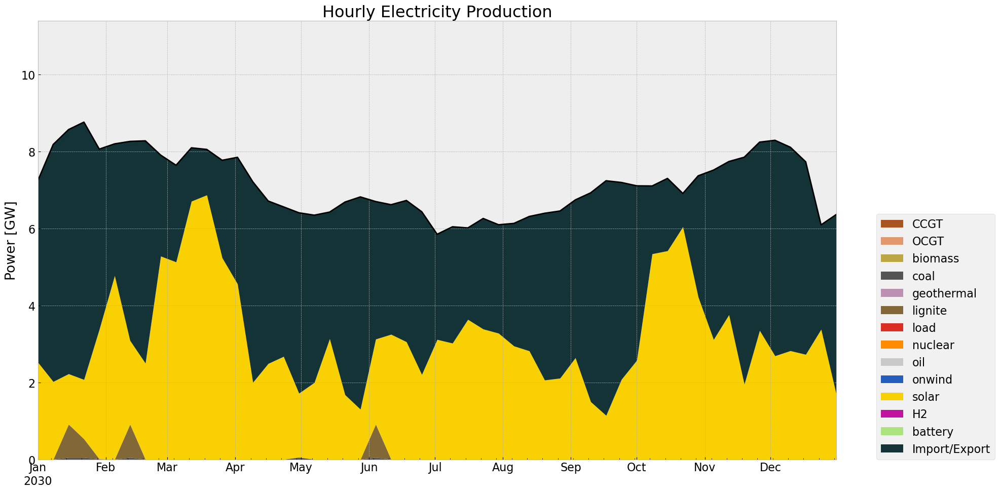

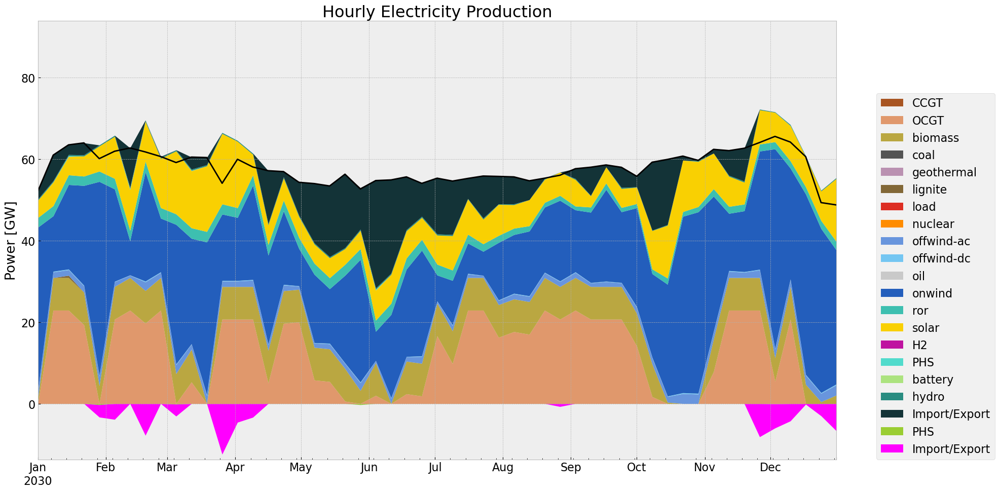

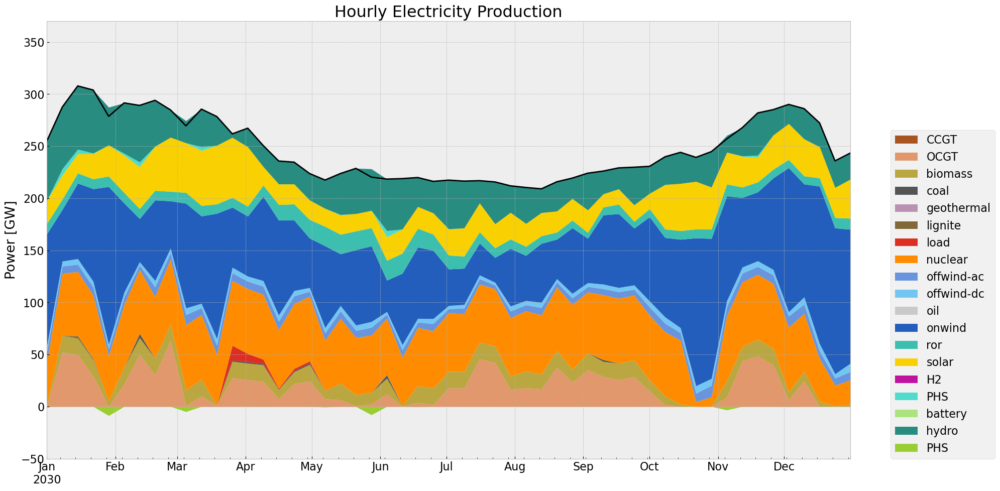

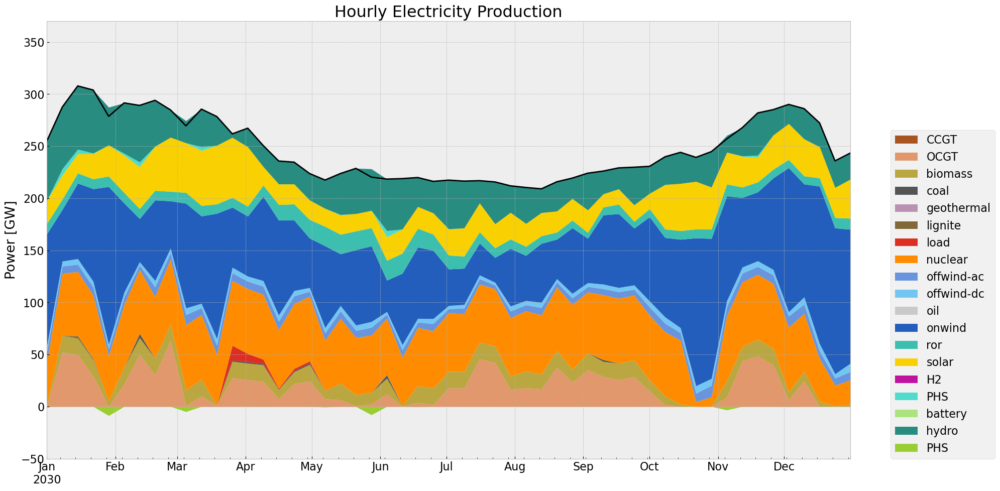

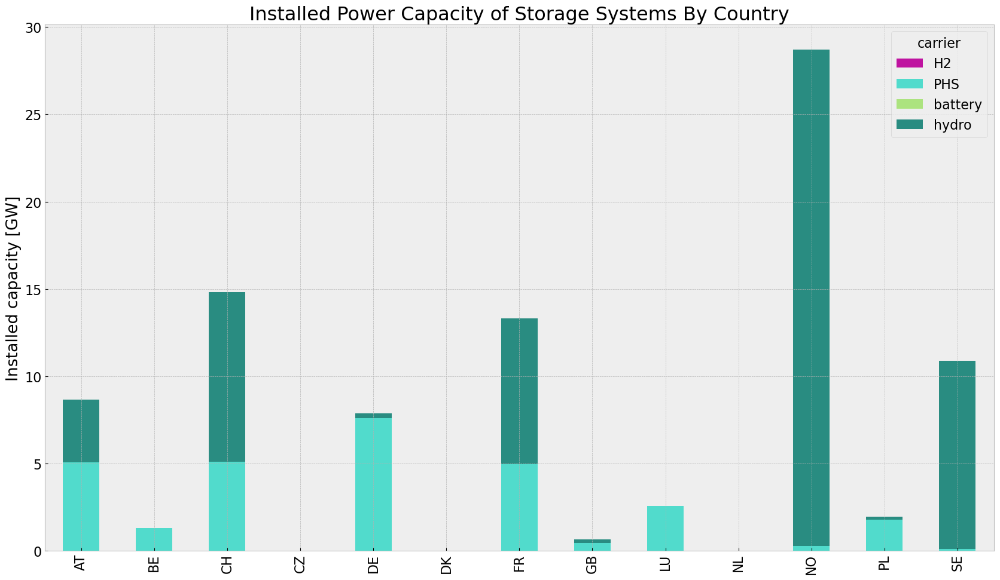

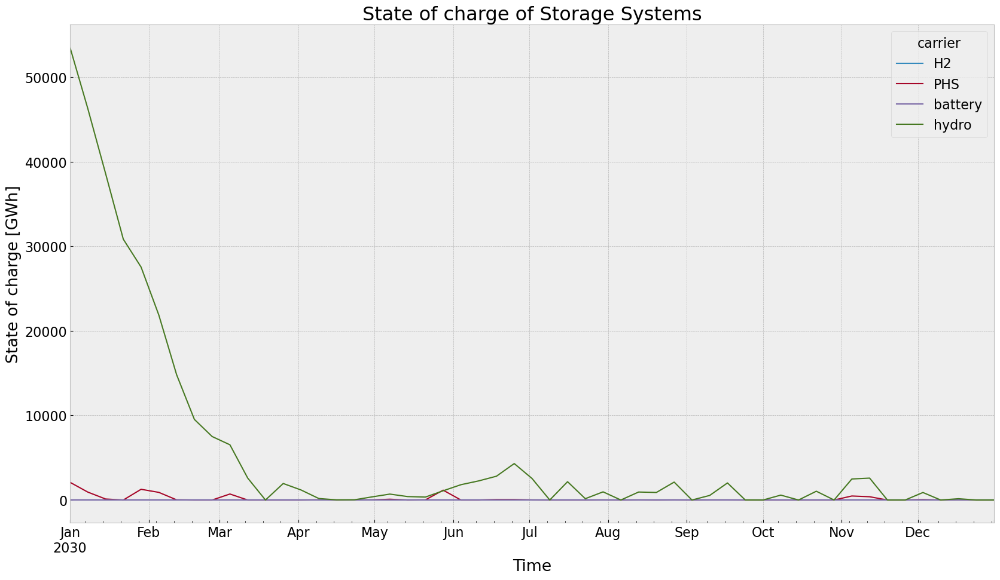

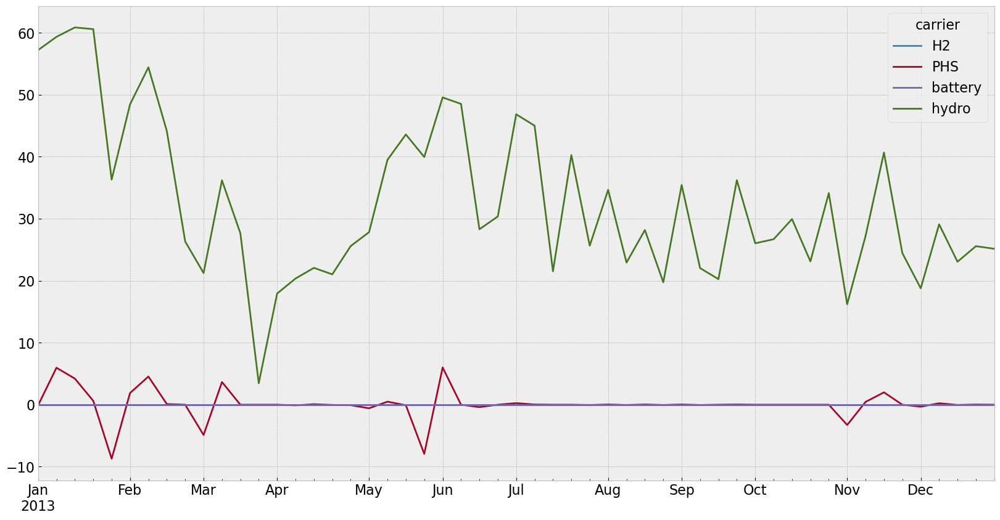

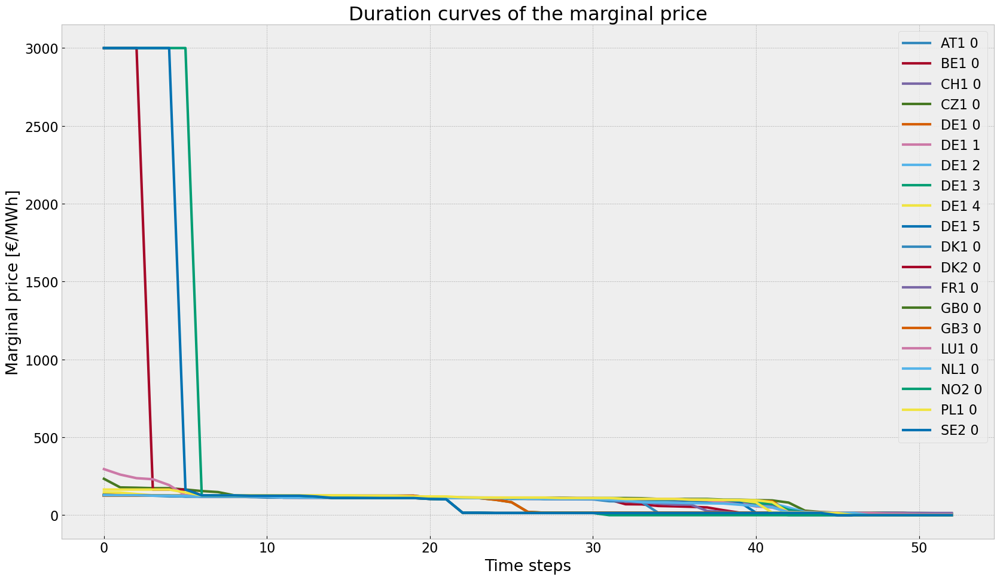

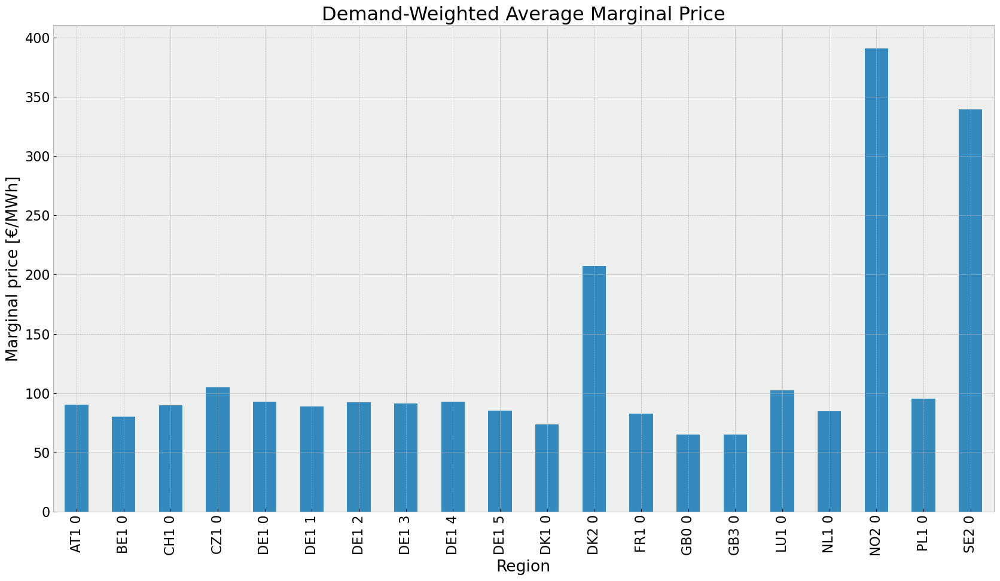

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


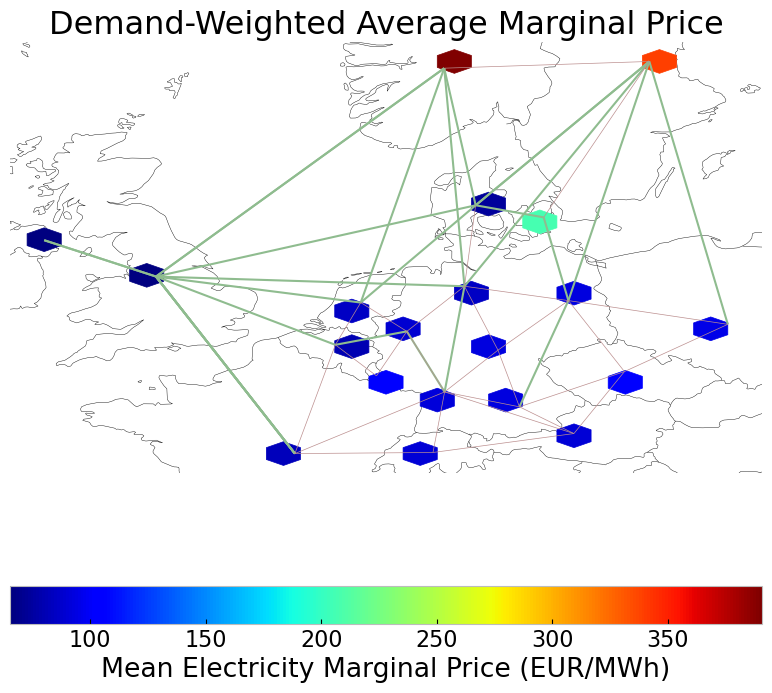

In [86]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3)
gen_noinv_roll_country = gen_power_table_country(n3)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'CZ')
gen_curve(n3, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3, '2030-01-01 00:00', '2030-12-31 21:00')
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [87]:
n4 = n1.copy()

no_inv(n4,n1)

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False
set_initial_soc(n4, n1)



optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')

filename = f"inv_roll_{contingency}.nc"
#n4 = import_nc_file(directory, filename)
n4.name = f'inv_roll_{contingency}'

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5oiq2hna.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5oiq2hna.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x1679799d


INFO:gurobipy:Model fingerprint: 0x1679799d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4281 rows and 1167 columns


INFO:gurobipy:Presolve removed 4281 rows and 1167 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 191 rows, 917 columns, 1453 nonzeros


INFO:gurobipy:Presolved: 191 rows, 917 columns, 1453 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6053287e+07   1.640662e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6053287e+07   1.640662e+06   0.000000e+00      0s


     236    1.8786883e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     236    1.8786883e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 236 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 236 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.878688334e+09


INFO:gurobipy:Optimal objective  1.878688334e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.88e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t30oj2r0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t30oj2r0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe8bc773e


INFO:gurobipy:Model fingerprint: 0xe8bc773e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4270 rows and 1171 columns


INFO:gurobipy:Presolve removed 4270 rows and 1171 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 202 rows, 913 columns, 1467 nonzeros


INFO:gurobipy:Presolved: 202 rows, 913 columns, 1467 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6216270e+07   1.178372e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6216270e+07   1.178372e+06   0.000000e+00      0s


     248    1.2551982e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     248    1.2551982e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 248 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 248 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.255198214e+09


INFO:gurobipy:Optimal objective  1.255198214e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.26e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o005feyy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o005feyy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x45c75534


INFO:gurobipy:Model fingerprint: 0x45c75534


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4266 rows and 1155 columns


INFO:gurobipy:Presolve removed 4266 rows and 1155 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 929 columns, 1494 nonzeros


INFO:gurobipy:Presolved: 206 rows, 929 columns, 1494 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3881158e+07   1.160918e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.3881158e+07   1.160918e+06   0.000000e+00      0s


     246    9.1629109e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     246    9.1629109e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 246 iterations and 0.07 seconds (0.00 work units)


INFO:gurobipy:Solved in 246 iterations and 0.07 seconds (0.00 work units)


Optimal objective  9.162910873e+08


INFO:gurobipy:Optimal objective  9.162910873e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.16e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_9hgc8fu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_9hgc8fu.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x88e4bdb0


INFO:gurobipy:Model fingerprint: 0x88e4bdb0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1149 columns


INFO:gurobipy:Presolve removed 4266 rows and 1149 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 935 columns, 1498 nonzeros


INFO:gurobipy:Presolved: 206 rows, 935 columns, 1498 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.2458185e+05   1.178109e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.2458185e+05   1.178109e+06   0.000000e+00      0s


     316    5.0475497e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     316    5.0475497e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 316 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 316 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.047549661e+08


INFO:gurobipy:Optimal objective  5.047549661e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5b5zn4k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5b5zn4k.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x89706f36


INFO:gurobipy:Model fingerprint: 0x89706f36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4264 rows and 1130 columns


INFO:gurobipy:Presolve removed 4264 rows and 1130 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 208 rows, 954 columns, 1522 nonzeros


INFO:gurobipy:Presolved: 208 rows, 954 columns, 1522 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.3877968e+04   1.273596e+06   0.000000e+00      0s


INFO:gurobipy:       0    9.3877968e+04   1.273596e+06   0.000000e+00      0s


     297    4.5121640e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     297    4.5121640e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 297 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 297 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.512164025e+08


INFO:gurobipy:Optimal objective  4.512164025e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgcnbh37.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hgcnbh37.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf480661d


INFO:gurobipy:Model fingerprint: 0xf480661d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4272 rows and 1157 columns


INFO:gurobipy:Presolve removed 4272 rows and 1157 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 200 rows, 927 columns, 1479 nonzeros


INFO:gurobipy:Presolved: 200 rows, 927 columns, 1479 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5798820e+07   1.182501e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5798820e+07   1.182501e+06   0.000000e+00      0s


     283    4.0314806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     283    4.0314806e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 283 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 283 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.031480647e+08


INFO:gurobipy:Optimal objective  4.031480647e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8hjh8w8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s8hjh8w8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x127f5149


INFO:gurobipy:Model fingerprint: 0x127f5149


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4262 rows and 1127 columns


INFO:gurobipy:Presolve removed 4262 rows and 1127 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 210 rows, 957 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 210 rows, 957 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5801586e+07   1.185207e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5801586e+07   1.185207e+06   0.000000e+00      0s


     264    5.7239426e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    5.7239426e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 264 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.723942594e+08


INFO:gurobipy:Optimal objective  5.723942594e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-701z2yqe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-701z2yqe.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc8057814


INFO:gurobipy:Model fingerprint: 0xc8057814


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4258 rows and 1128 columns


INFO:gurobipy:Presolve removed 4258 rows and 1128 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 214 rows, 956 columns, 1535 nonzeros


INFO:gurobipy:Presolved: 214 rows, 956 columns, 1535 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1391596e+07   1.193513e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1391596e+07   1.193513e+06   0.000000e+00      0s


     302    1.5836317e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     302    1.5836317e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 302 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 302 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.583631706e+09


INFO:gurobipy:Optimal objective  1.583631706e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nl9p8nwc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nl9p8nwc.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x39762df6


INFO:gurobipy:Model fingerprint: 0x39762df6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4256 rows and 1121 columns


INFO:gurobipy:Presolve removed 4256 rows and 1121 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 216 rows, 963 columns, 1544 nonzeros


INFO:gurobipy:Presolved: 216 rows, 963 columns, 1544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5705337e+07   1.170498e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5705337e+07   1.170498e+06   0.000000e+00      0s


     364    1.3626971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     364    1.3626971e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 364 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 364 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.362697072e+09


INFO:gurobipy:Optimal objective  1.362697072e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-titmkktp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-titmkktp.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xcfa78f59


INFO:gurobipy:Model fingerprint: 0xcfa78f59


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4256 rows and 1129 columns


INFO:gurobipy:Presolve removed 4256 rows and 1129 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 216 rows, 955 columns, 1536 nonzeros


INFO:gurobipy:Presolved: 216 rows, 955 columns, 1536 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6837135e+05   1.169493e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6837135e+05   1.169493e+06   0.000000e+00      0s


     326    1.2596429e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     326    1.2596429e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 326 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 326 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.259642911e+09


INFO:gurobipy:Optimal objective  1.259642911e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.26e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1gm4svj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j1gm4svj.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2df3c494


INFO:gurobipy:Model fingerprint: 0x2df3c494


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4256 rows and 1135 columns


INFO:gurobipy:Presolve removed 4256 rows and 1135 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 216 rows, 949 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 216 rows, 949 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2605008e+04   1.164899e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.2605008e+04   1.164899e+06   0.000000e+00      0s


     349    2.1710185e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     349    2.1710185e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 349 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 349 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.171018550e+08


INFO:gurobipy:Optimal objective  2.171018550e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwuchvqq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwuchvqq.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd96e52cf


INFO:gurobipy:Model fingerprint: 0xd96e52cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4256 rows and 1131 columns


INFO:gurobipy:Presolve removed 4256 rows and 1131 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 216 rows, 953 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 216 rows, 953 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7020313e+05   1.138414e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.7020313e+05   1.138414e+06   0.000000e+00      0s


     343    1.6414120e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     343    1.6414120e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 343 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 343 iterations and 0.07 seconds (0.01 work units)


Optimal objective  1.641411963e+09


INFO:gurobipy:Optimal objective  1.641411963e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipw1cw_m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipw1cw_m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x5838020f


INFO:gurobipy:Model fingerprint: 0x5838020f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4256 rows and 1165 columns


INFO:gurobipy:Presolve removed 4256 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 216 rows, 919 columns, 1500 nonzeros


INFO:gurobipy:Presolved: 216 rows, 919 columns, 1500 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.4203189e+05   1.164038e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.4203189e+05   1.164038e+06   0.000000e+00      0s


     320    3.0925114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     320    3.0925114e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 320 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 320 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.092511366e+08


INFO:gurobipy:Optimal objective  3.092511366e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v378ntup.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-v378ntup.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xc5367b0b


INFO:gurobipy:Model fingerprint: 0xc5367b0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1073 rows and 308 columns


INFO:gurobipy:Presolve removed 1073 rows and 308 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 45 rows, 213 columns, 331 nonzeros


INFO:gurobipy:Presolved: 45 rows, 213 columns, 331 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4299138e+04   1.040234e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4299138e+04   1.040234e+05   0.000000e+00      0s


      44    3.9729482e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      44    3.9729482e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 44 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 44 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.972948164e+06


INFO:gurobipy:Optimal objective  3.972948164e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 3.97e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


### Export Model for later use

In [88]:
filename = f"{n4.name}.nc"
output_path = os.path.join(os.getcwd(), filename)
n4.export_to_netcdf(output_path)

INFO:pypsa.io:Exported network inv_roll_pv.nc has lines, generators, carriers, loads, buses, links, storage_units


<xarray.Dataset> Size: 278kB
Dimensions:                                          (snapshots: 53,
                                                      investment_periods: 0,
                                                      lines_i: 27,
                                                      lines_t_p0_i: 27,
                                                      lines_t_p1_i: 27,
                                                      lines_t_loss_i: 27,
                                                      ...
                                                      storage_units_t_inflow_i: 10,
                                                      storage_units_t_p_i: 25,
                                                      storage_units_t_p_dispatch_i: 25,
                                                      storage_units_t_p_store_i: 14,
                                                      storage_units_t_state_of_charge_i: 65,
                                                      storage_units_t_spill_i: 7)
Coordinates: (12/27)
  * snapshots                                        (snapshots) int64 424B 0...
  * investment_periods                               (investment_periods) int64 0B ...
  * lines_i                                          (lines_i) object 216B '0...
  * lines_t_p0_i                                     (lines_t_p0_i) object 216B ...
  * lines_t_p1_i                                     (lines_t_p1_i) object 216B ...
  * lines_t_loss_i                                   (lines_t_loss_i) object 216B ...
    ...                                               ...
  * storage_units_t_inflow_i                         (storage_units_t_inflow_i) object 80B ...
  * storage_units_t_p_i                              (storage_units_t_p_i) object 200B ...
  * storage_units_t_p_dispatch_i                     (storage_units_t_p_dispatch_i) object 200B ...
  * storage_units_t_p_store_i                        (storage_units_t_p_store_i) object 112B ...
  * storage_units_t_state_of_charge_i                (storage_units_t_state_of_charge_i) object 520B ...
  * storage_units_t_spill_i                          (storage_units_t_spill_i) object 56B ...
Data variables: (12/98)
    snapshots_snapshot                               (snapshots) datetime64[ns] 424B ...
    snapshots_objective                              (snapshots) float64 424B ...
    snapshots_generators                             (snapshots) float64 424B ...
    snapshots_stores                                 (snapshots) float64 424B ...
    investment_periods_objective                     (investment_periods) float64 0B ...
    investment_periods_years                         (investment_periods) float64 0B ...
    ...                                               ...
    storage_units_t_inflow                           (snapshots, storage_units_t_inflow_i) float64 4kB ...
    storage_units_t_p                                (snapshots, storage_units_t_p_i) float64 11kB ...
    storage_units_t_p_dispatch                       (snapshots, storage_units_t_p_dispatch_i) float64 11kB ...
    storage_units_t_p_store                          (snapshots, storage_units_t_p_store_i) float64 6kB ...
    storage_units_t_state_of_charge                  (snapshots, storage_units_t_state_of_charge_i) float64 28kB ...
    storage_units_t_spill                            (snapshots, storage_units_t_spill_i) float64 3kB ...
Attributes:
    network__linearized_uc:  0
    network__multi_invest:   0
    network_name:            inv_roll_pv
    network_objective:       3972948.1642957246
    network_pypsa_version:   0.27.0
    network_srid:            4326
    crs:                     {"_crs": "GEOGCRS[\"WGS 84\",ENSEMBLE[\"World Ge...
    meta:                    {}

In [89]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

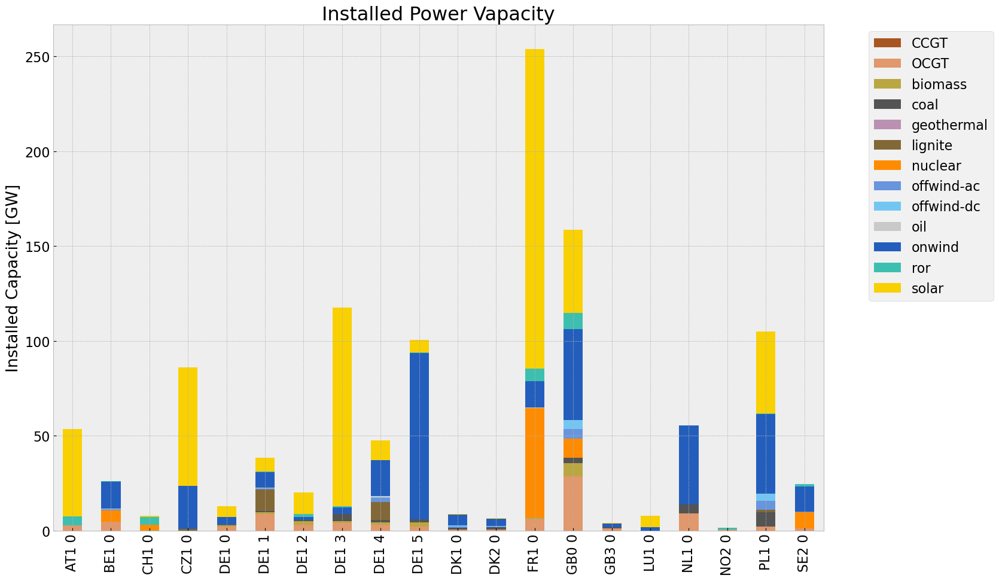

<Figure size 640x480 with 0 Axes>

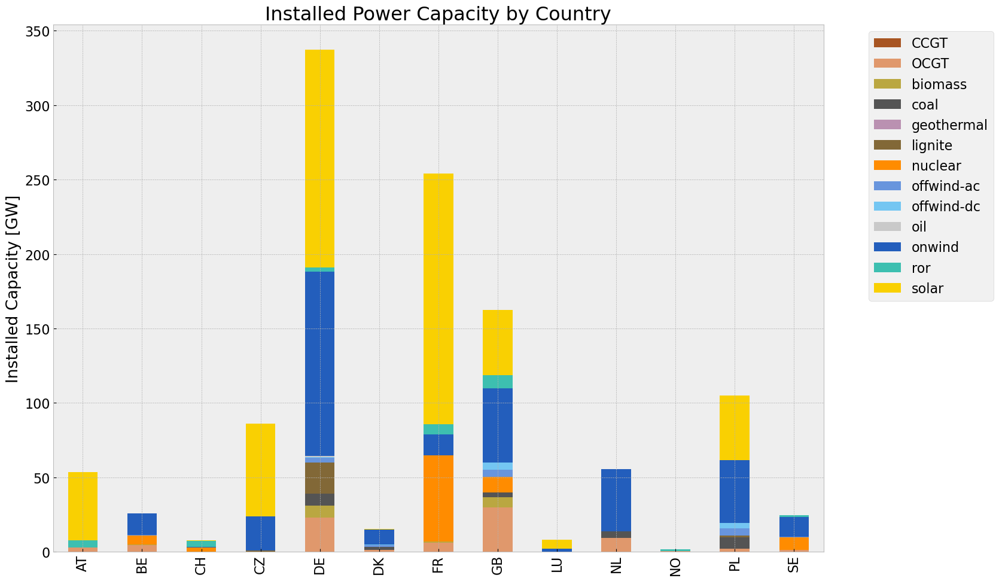

<Figure size 640x480 with 0 Axes>

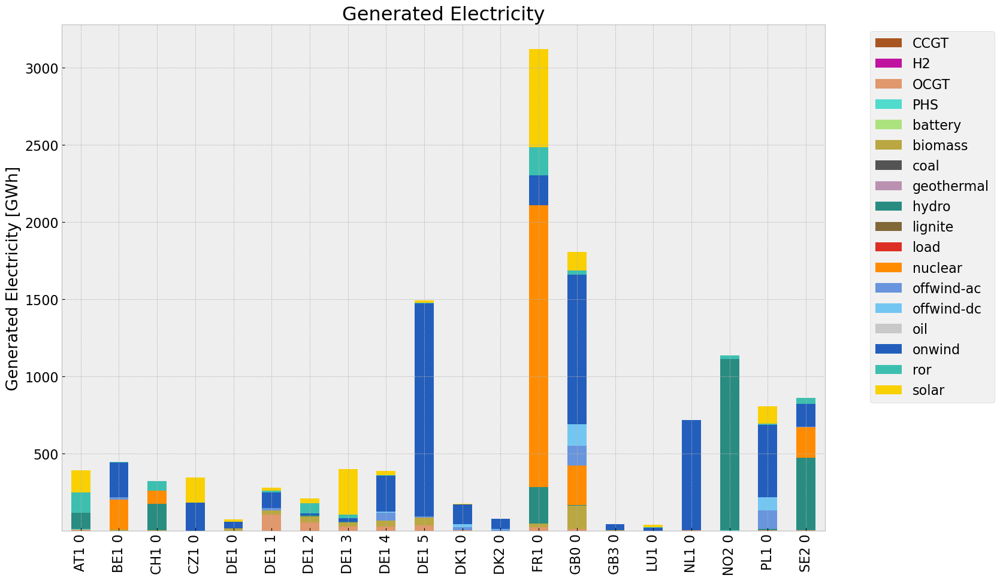

<Figure size 640x480 with 0 Axes>

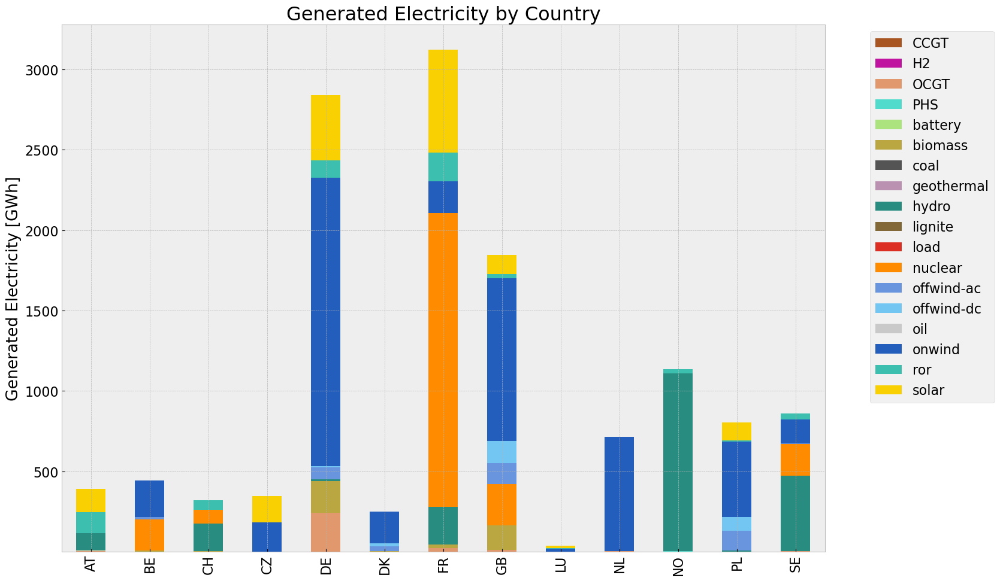

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='168H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_3412\1951327063.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='168H')
c:\Users\

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000
OCGT,2.971462e+05,0.451621,0.1980,130275.078247
biomass,3.802395e+05,0.468000,0.0000,0.000000
coal,0.000000e+00,0.329908,0.3361,0.000000
geothermal,0.000000e+00,1.000000,0.1200,0.000000
lignite,0.000000e+00,0.337285,0.4069,0.000000
load,0.000000e+00,1.000000,0.0000,0.000000
nuclear,2.555852e+06,0.326600,0.0000,0.000000
offwind-ac,3.728091e+05,1.000000,0.0000,0.000000


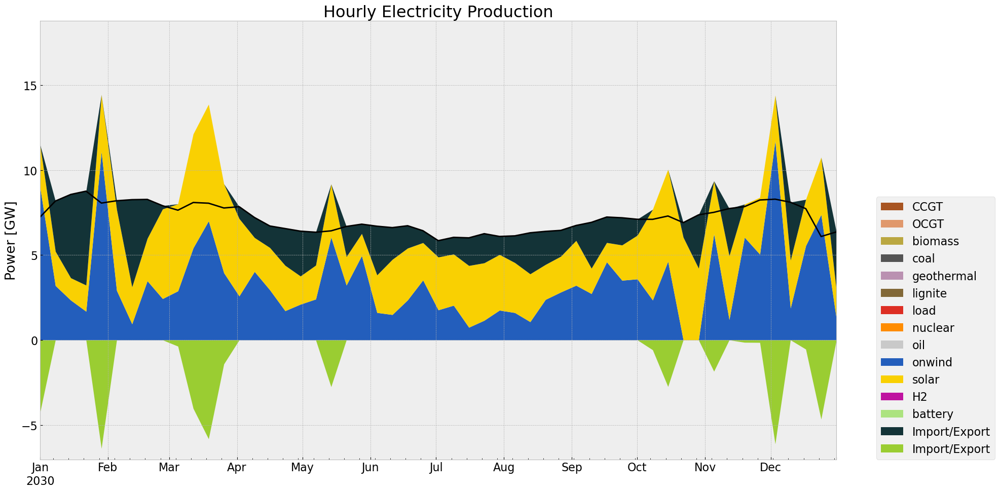

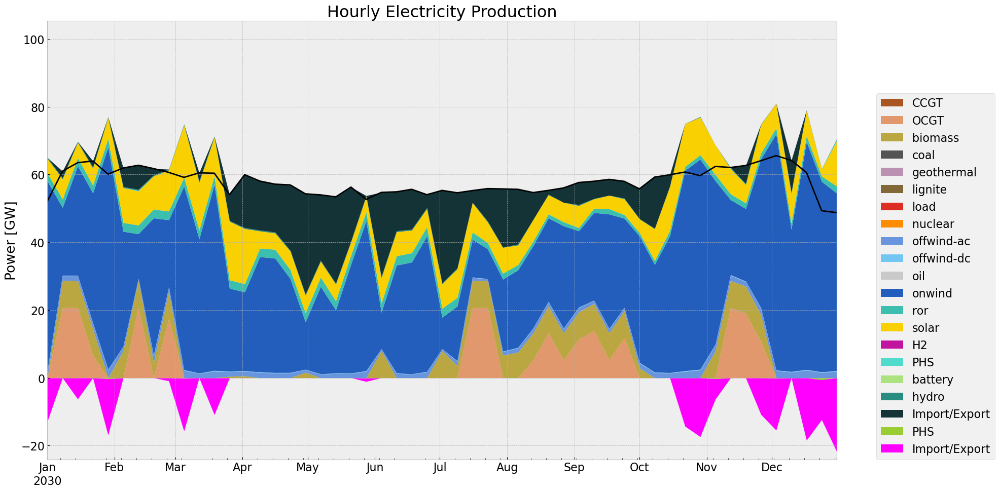

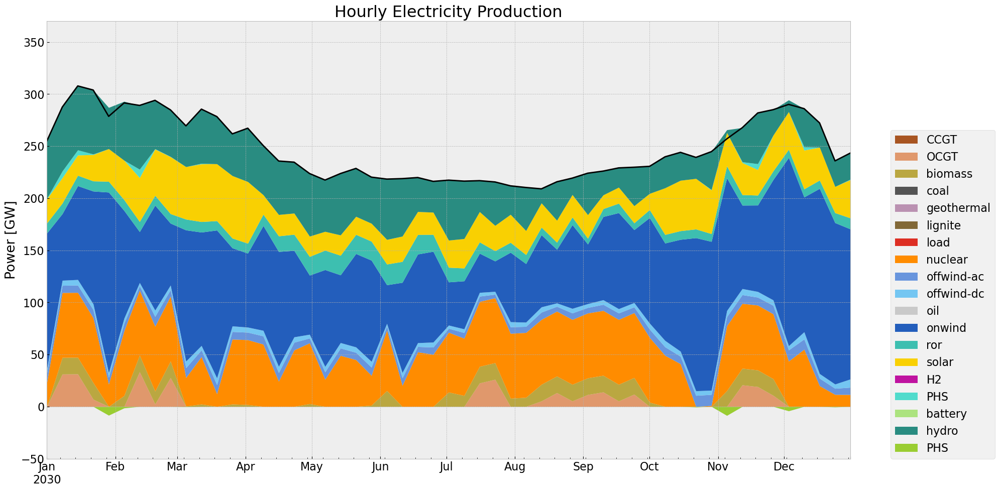

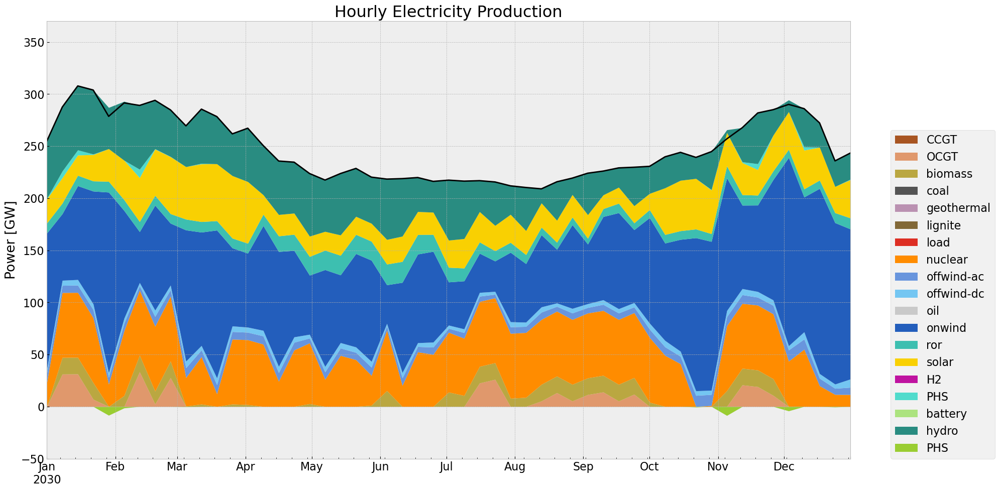

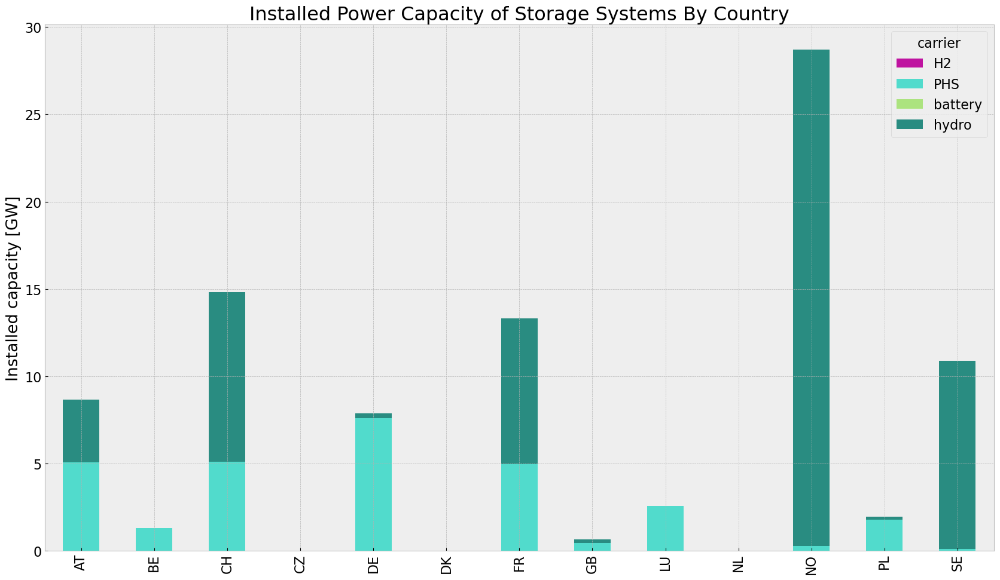

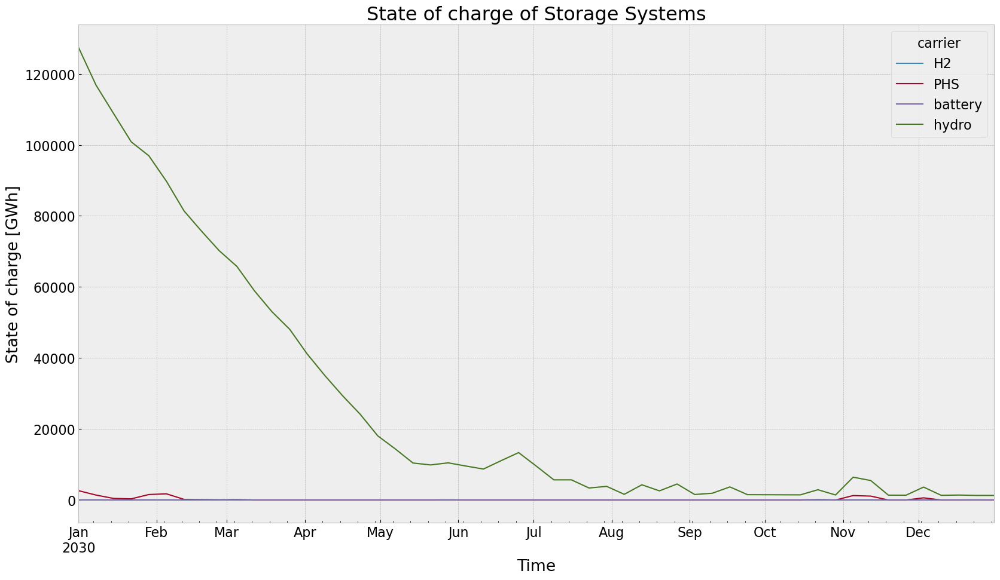

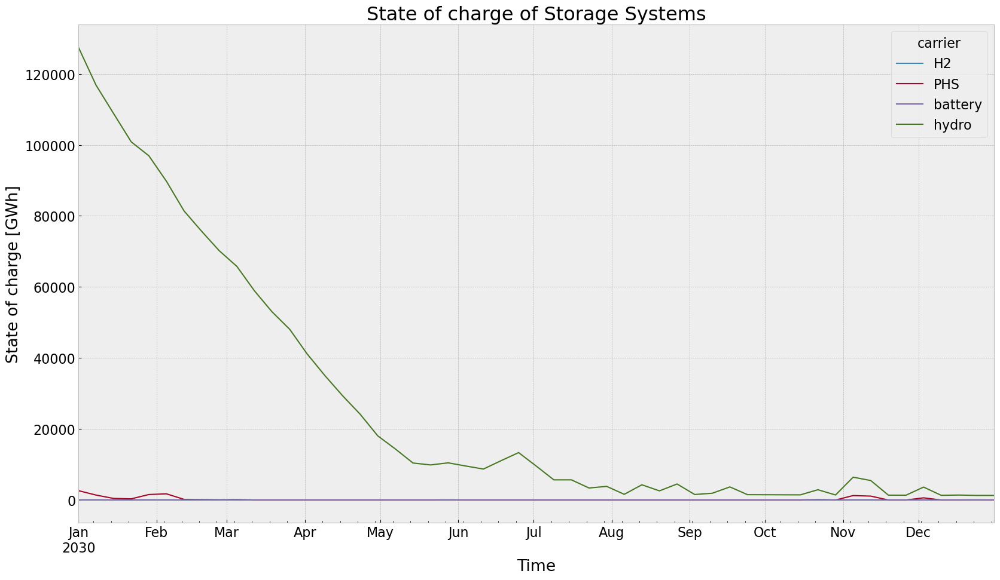

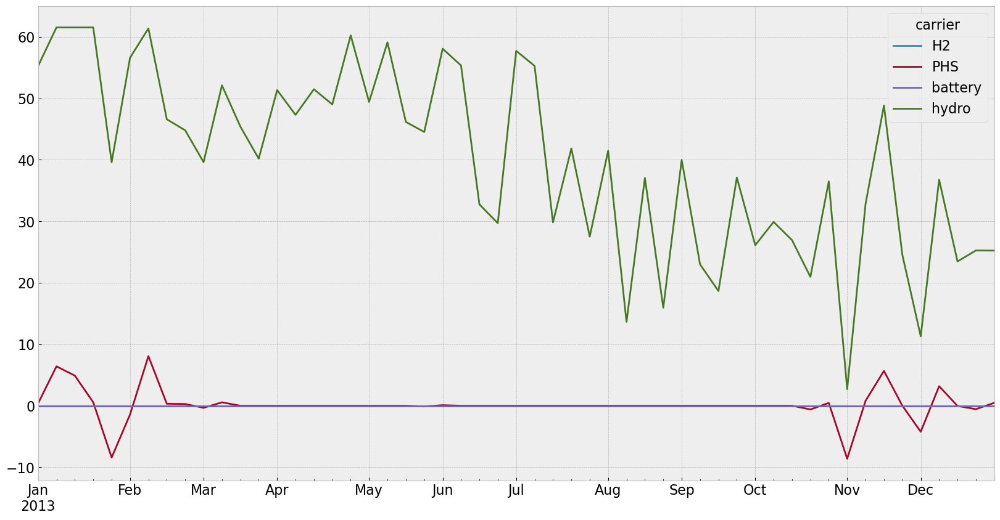

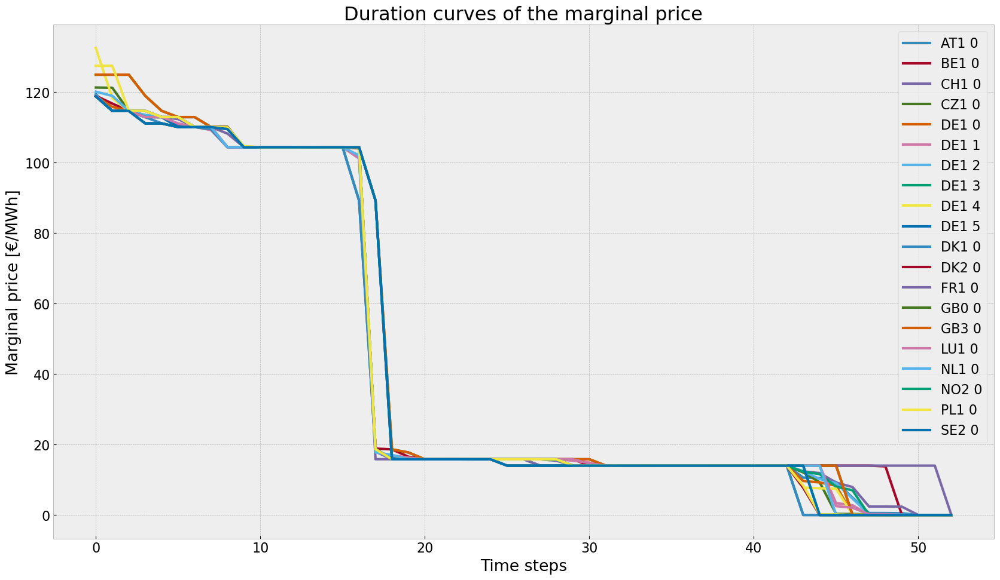

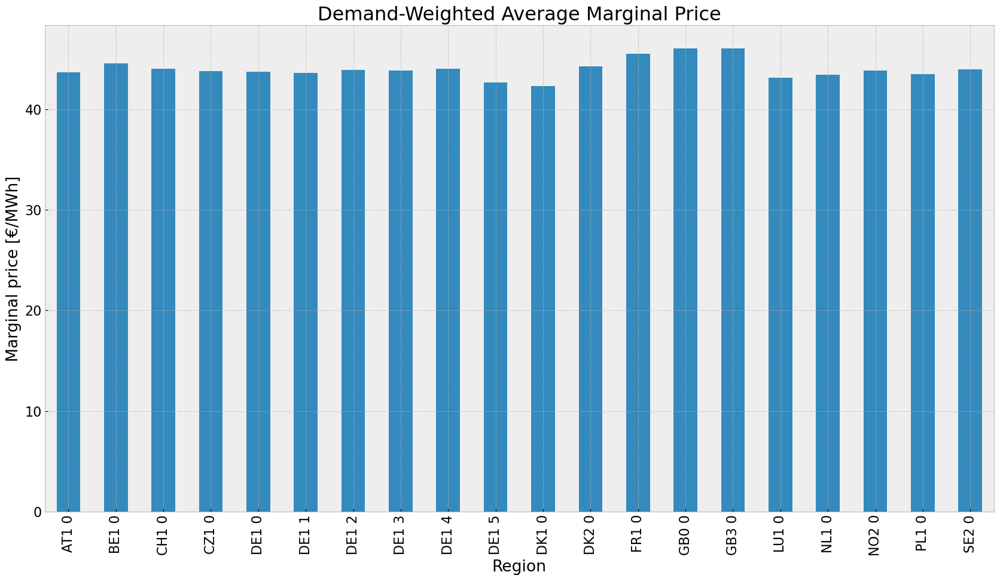

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


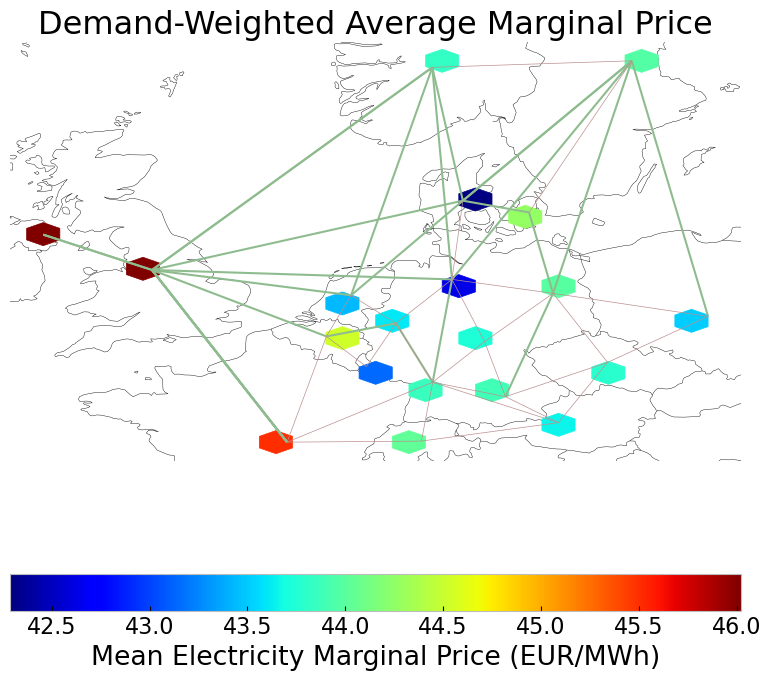

In [90]:

#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4)
gen_inv_roll_country = gen_power_table_country(n4)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'CZ')
gen_curve(n4, '2030-01-01', '2030-12-31', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-01-01', '2030-12-31', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
state_of_charge_plot(n4, '2030-01-01 00:00', '2030-12-31 21:00')
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='168H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [91]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

In [119]:
n.loads

,bus,carrier,type,p_set,q_set,sign,country
Load,,,,,,,
AT1 0,AT1 0,,,0.0,0.0,-1.0,AT
BE1 0,BE1 0,,,0.0,0.0,-1.0,BE
CH1 0,CH1 0,,,0.0,0.0,-1.0,CH
CZ1 0,CZ1 0,,,0.0,0.0,-1.0,CZ
DE1 0,DE1 0,,,0.0,0.0,-1.0,DE
DE1 1,DE1 1,,,0.0,0.0,-1.0,DE
DE1 2,DE1 2,,,0.0,0.0,-1.0,DE
DE1 3,DE1 3,,,0.0,0.0,-1.0,DE
DE1 4,DE1 4,,,0.0,0.0,-1.0,DE


In [124]:
n.loads_t.p

Load,AT1 0,BE1 0,CH1 0,CZ1 0,DE1 0,DE1 1,DE1 2,DE1 3,DE1 4,DE1 5,DK1 0,DK2 0,FR1 0,GB0 0,GB3 0,LU1 0,NL1 0,NO2 0,PL1 0,SE2 0
snapshot,,,,,,,,,,,,,,,,,,,,
2013-01-01,7898.869048,9549.130952,5709.608077,7238.154762,5670.995113,11432.746437,10272.860823,10859.997150,5597.480987,8262.695400,2675.728160,1322.373031,62616.447969,39310.029296,699.593204,732.390441,13019.886905,17211.976190,16760.041667,18068.416667
2013-01-08,8793.297619,10888.065476,6248.457111,8177.898810,6637.053480,13380.323560,12022.850542,12709.343440,6551.016165,9670.251897,2786.731992,1377.232294,70555.707888,43785.989316,779.251023,848.055895,14097.202381,19293.785714,18394.654762,20509.196429
2013-01-15,9065.297619,11435.636905,6583.049015,8564.803571,6910.742029,13932.080655,12518.630264,13233.549191,6821.156841,10069.018794,3173.414928,1568.335072,79153.505696,46772.752146,832.405880,878.482518,14691.577381,20809.809524,18753.035714,21990.577381
2013-01-22,9096.964286,11294.345238,6693.287418,8758.678571,6963.297764,14038.033205,12613.833617,13334.281365,6873.031287,10145.593014,3179.669226,1571.426012,75921.742260,45509.066420,809.916303,865.144835,14571.345238,20537.208333,18851.410714,22195.952381
2013-01-29,8786.613095,10437.779762,6154.426600,8057.375000,6543.128560,13190.970587,11852.707983,12529.477347,6458.308812,9533.402370,3007.030680,1486.106225,67345.665957,42020.261120,747.826690,829.046268,13851.791667,18327.345238,17866.148810,19541.869048
2013-02-05,8886.952381,10765.928571,6339.742121,8194.017857,6740.295072,13588.458979,12209.870014,12907.032509,6652.919418,9820.675908,2941.735011,1453.836418,73675.335085,43985.884576,782.808521,843.183190,14002.511905,19325.732143,17985.327381,20355.535714
2013-02-12,8895.380952,10735.708333,6476.198303,8258.190476,6827.879904,13765.030313,12368.527668,13074.831836,6739.368872,9948.287865,2773.211554,1370.550351,72173.369996,43421.779773,772.769254,848.231110,13960.505952,18709.226190,18038.857143,19898.696429
2013-02-19,8942.005952,10799.363095,6717.643441,8272.702381,6721.626164,13550.822394,12176.051771,12871.887317,6634.492519,9793.475127,2726.611058,1347.519895,76622.898812,44566.794069,793.146859,850.210251,14008.702381,18345.755952,18022.982143,20172.833333
2013-02-26,8658.166667,10670.904762,6708.258065,7901.410714,6598.182208,13301.958937,11952.436240,12635.666730,6512.648789,9613.616074,2529.365633,1250.039129,73495.735397,43851.705912,780.420569,823.949549,13712.839286,17281.839286,17493.785714,18966.875000


# Scenario Analysis

## Installed Capacity

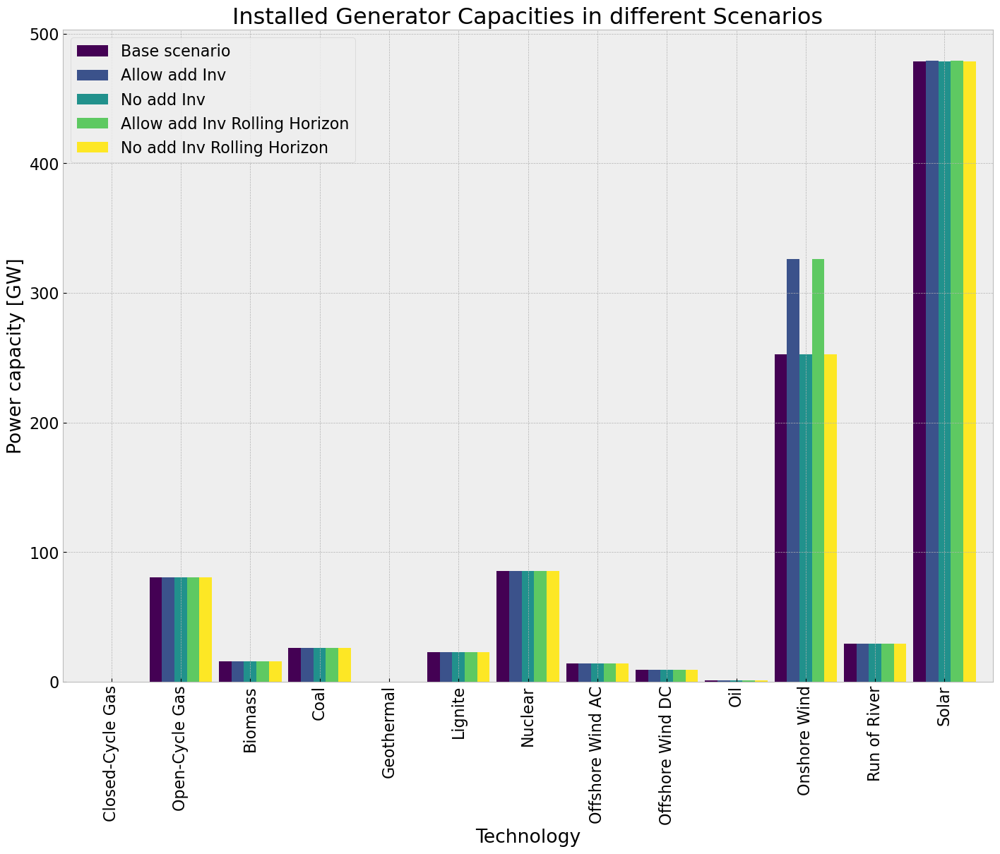

In [92]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

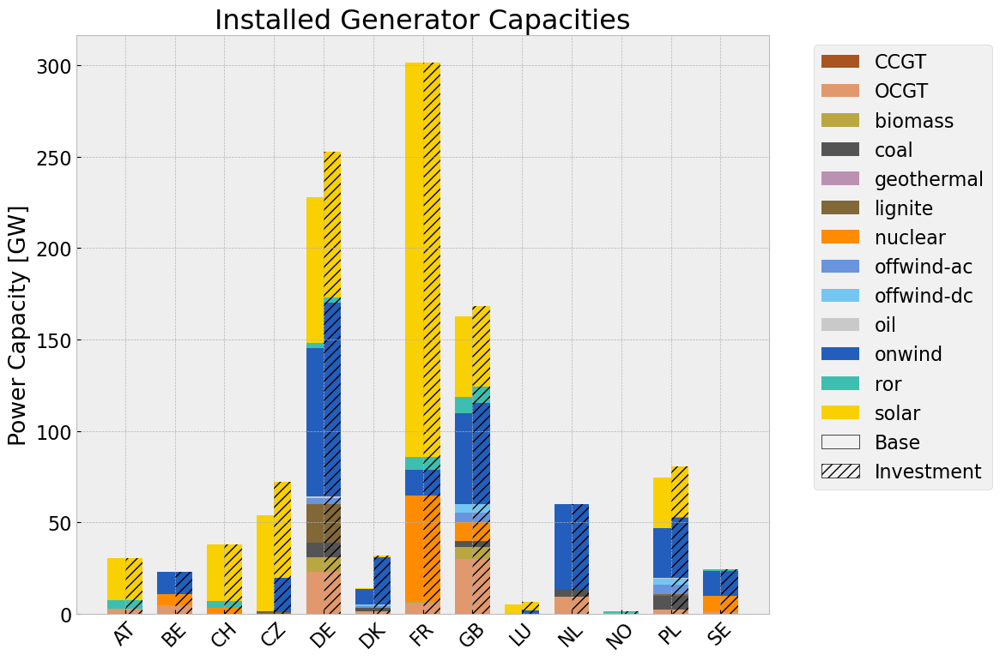

In [93]:
from matplotlib.patches import Patch



base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
#color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

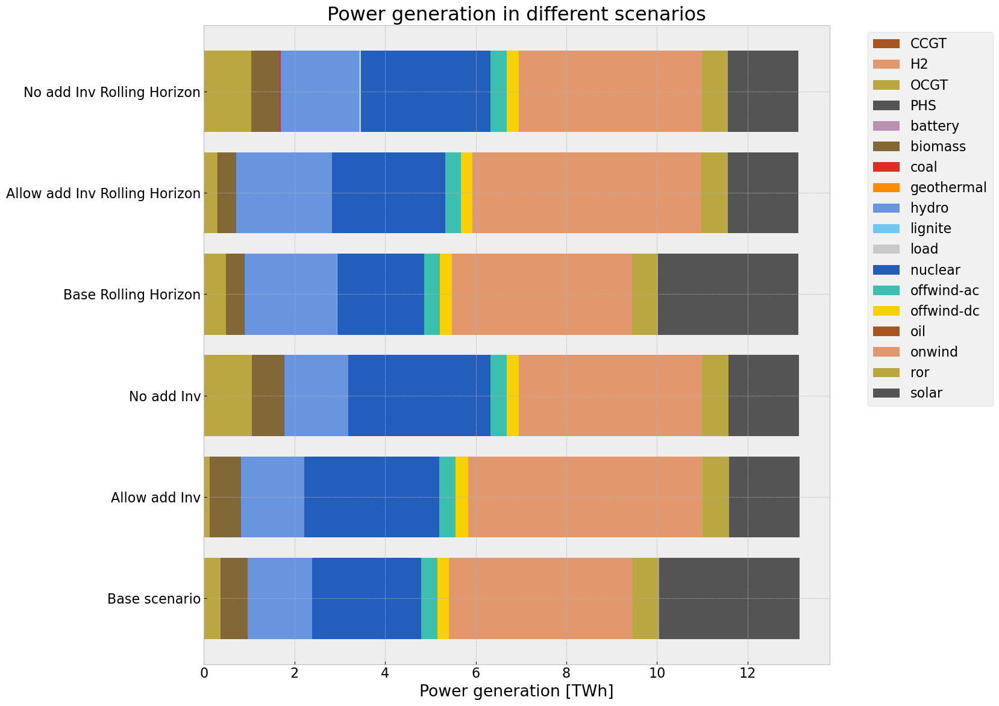

In [94]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = gen_base.columns.tolist())

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Base Rolling Horizon"] = gen_base_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

#define color dict for tech
color_dict = {}

for index, row in n.carriers.iterrows():
    key = index
    value = row['color']
    color_dict[key] = value

#color list
colors = [color_dict[cat] for cat in gen_base.columns]

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

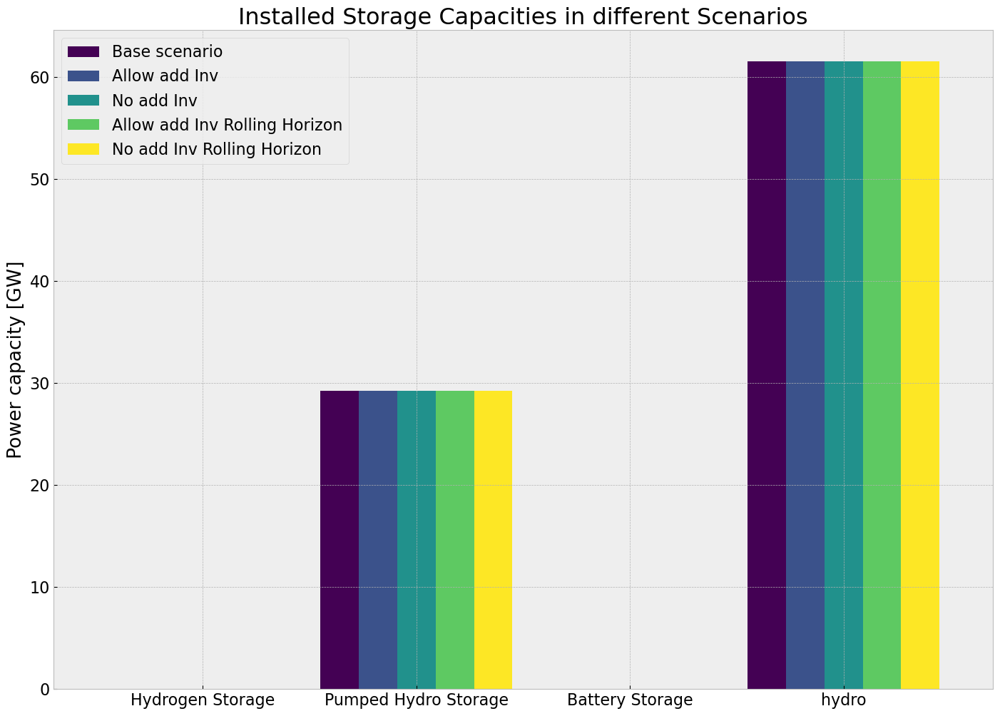

In [95]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

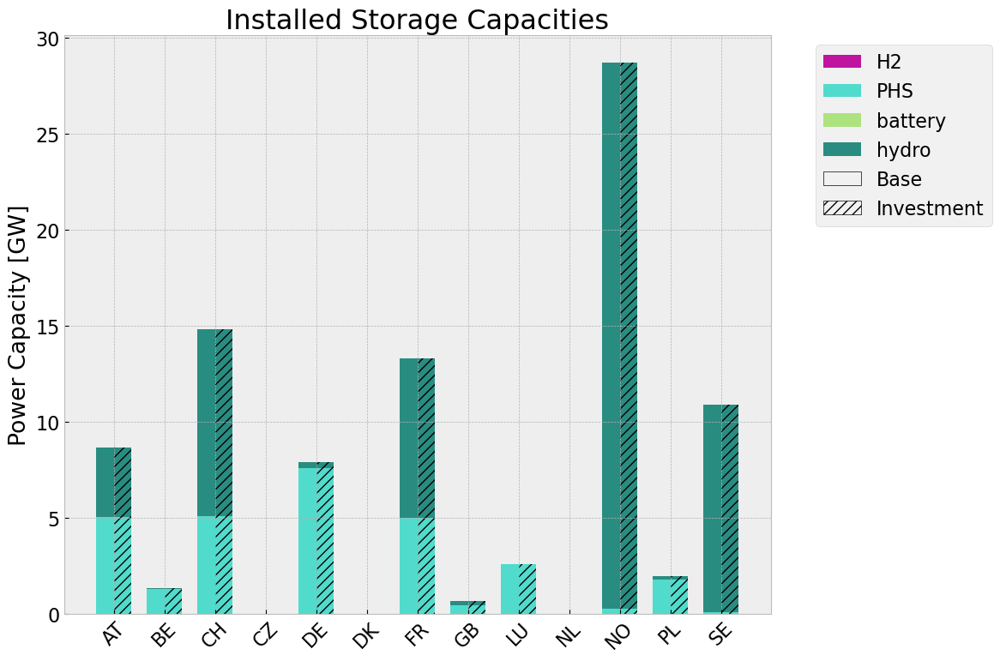

In [96]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [97]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Base Rolling Horizon"] = system_cost_base_roll # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


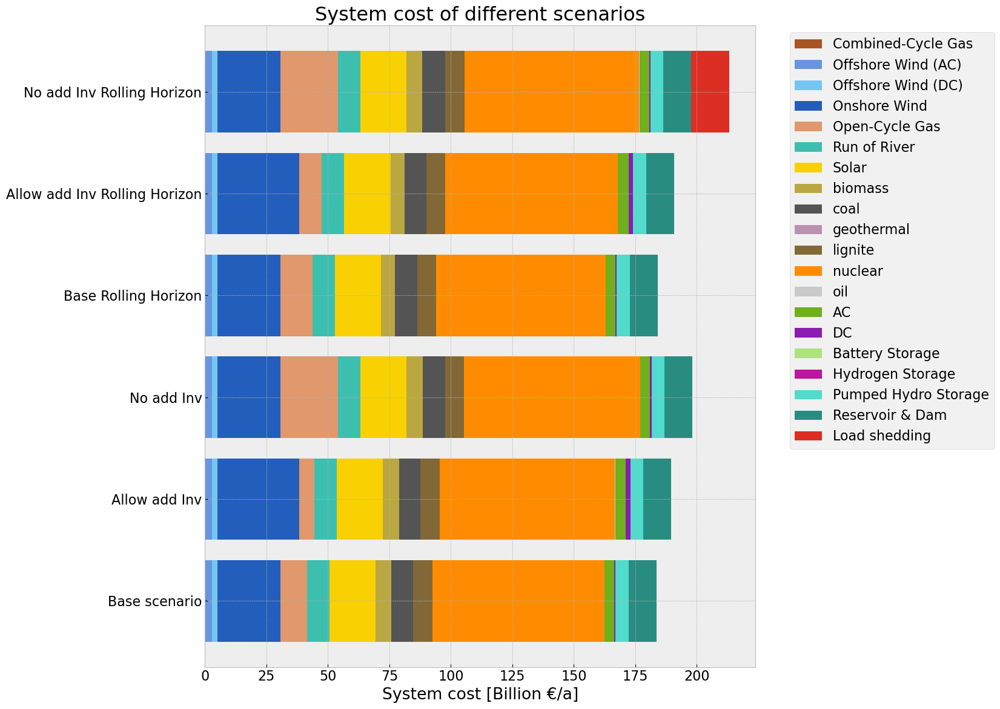

In [98]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

In [99]:
comp_system_cost.sum(axis=1)

Base scenario                    183.515837
Allow add Inv                    189.545296
No add Inv                       198.166168
Base Rolling Horizon             184.039315
Allow add Inv Rolling Horizon    190.721603
No add Inv Rolling Horizon       213.110133
dtype: object

## Curtailment

In [100]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Base Rolling Horizon"] = stat_base_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [101]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


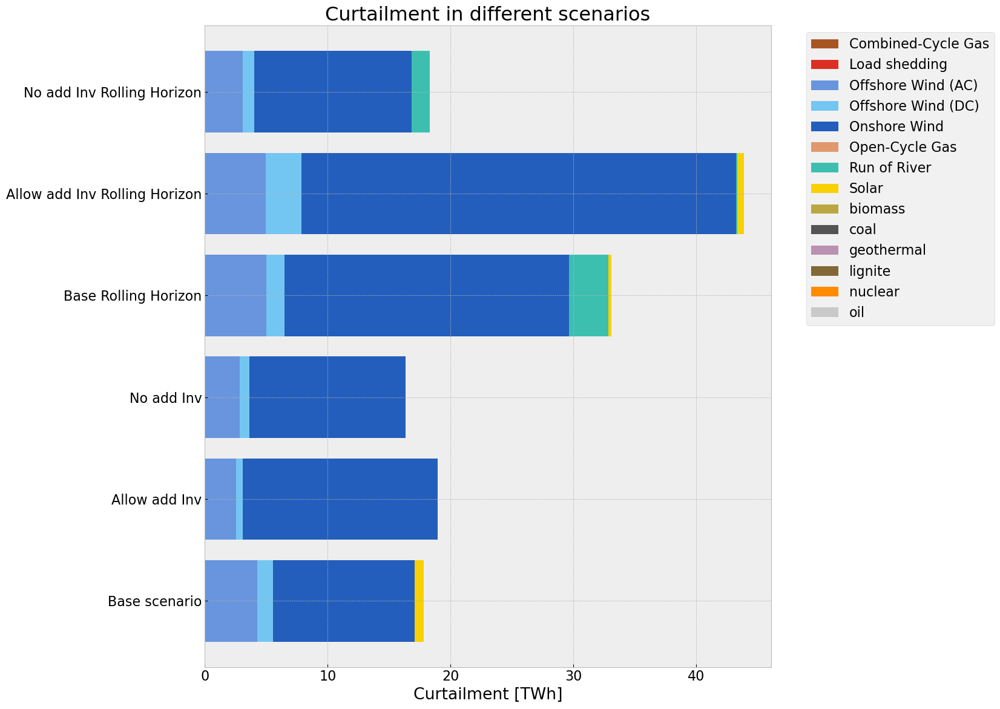

In [102]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\3480178836.py:21: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


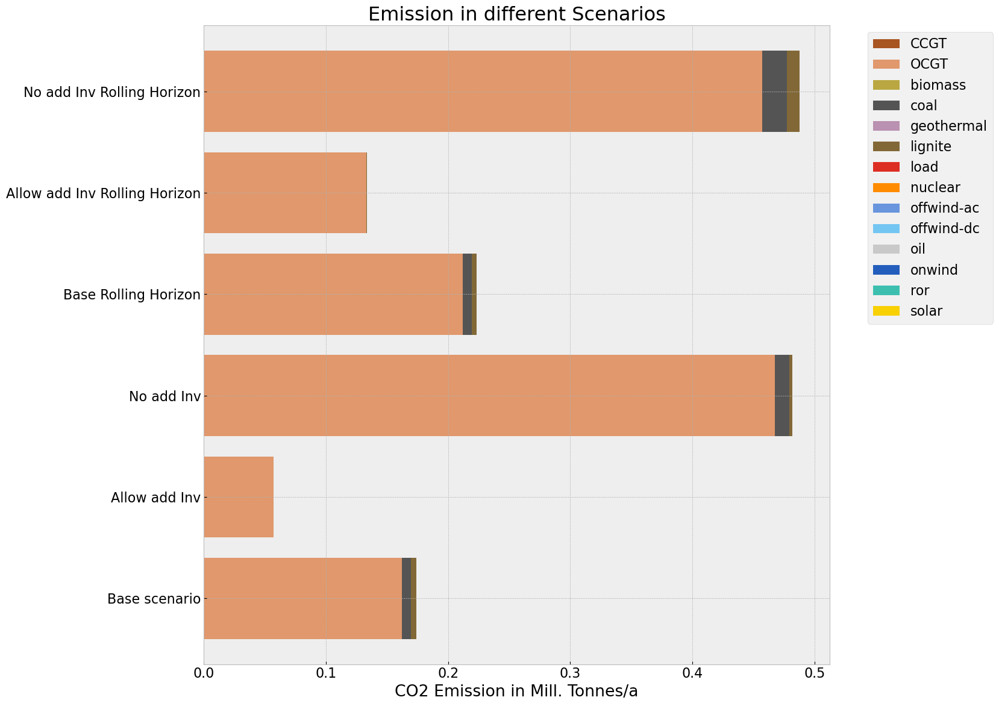

In [103]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Base Rolling Horizon","Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Base Rolling Horizon"] = em_base_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Transmission Lines

In [104]:
models = [n, n1, n2, n4]

In [105]:
model_trans = [n,n1]
for m in model_trans:
    #create empty df
    trans_df = {
        'Country' : cap_base_country.index,
        'AC': np.zeros(len(cap_base_country.index)),
        'DC': np.zeros(len(cap_base_country.index))
    }

    trans_df = pd.DataFrame(trans_df)
    trans_df.set_index('Country', inplace=True)
    
    #AC
    ac_df = m.lines
    ac_df['country'] = ac_df['bus0'].str[:2]
    ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
    ac_df.fillna(0, inplace=True)
    ac_df = ac_df.unstack().div(1e3) #GVA
            
    #DC
    dc_df = m.links
    dc_df['country'] = dc_df['bus0'].str[:2]
    dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
    dc_df.fillna(0, inplace=True)
    dc_df = dc_df.unstack().div(1e3) #GW

    #fill empty df with AC Cap
    for index, row in trans_df.iterrows():
        if index in ac_df.index:
            try:
                trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
            except KeyError: 
                trans_df.loc[index, 'AC'] = 0

    #fill empty df with DC Cap
    for index, row in trans_df.iterrows():
        if index in dc_df.index:
            try:
                trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
            except KeyError: 
                trans_df.loc[index, 'DC'] = 0


    #trans_df = pd.concat([ac_df, dc_df], axis=1)
    #trans_df.fillna(0, inplace=True)
    globals()[f'trans_{m.name}'] = trans_df

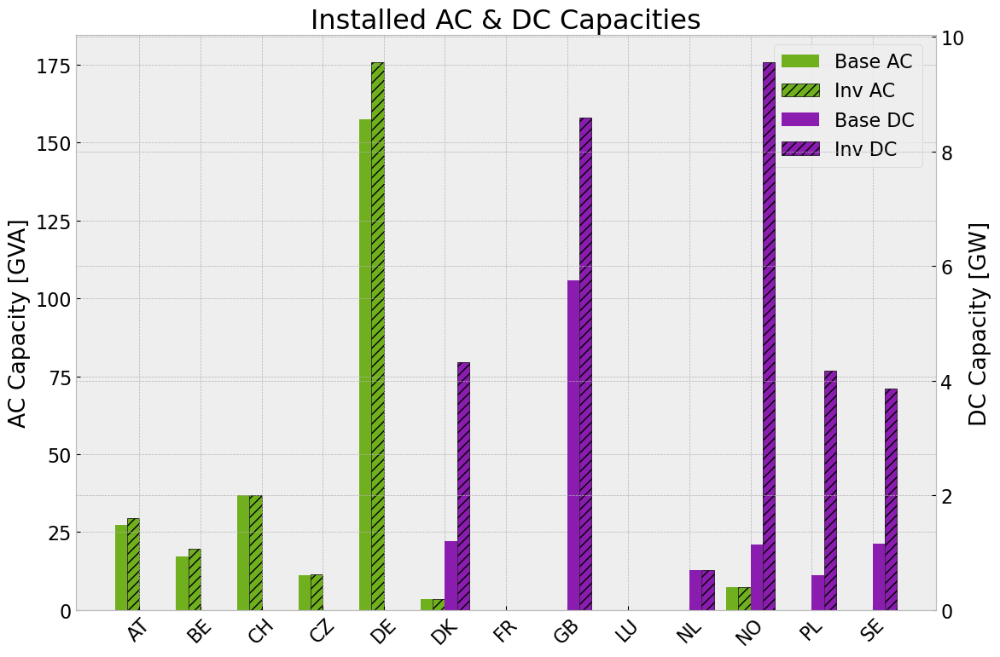

In [106]:
# Setting up bar plot parameters
bar_width = 0.2
indices = np.arange(len(trans_base_pv.index))
base_ac_indices = indices - bar_width * 1.5  # Shift slightly to the left
inv_ac_indices = indices - bar_width * 0.5  # Shift slightly to the right
base_dc_indices = indices + bar_width * 0.5
inv_dc_indices = indices + bar_width * 1.5

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Create secondary axis
ax2 = ax.twinx()

# Plot the base DataFrame (no hatching)
ax.bar(base_ac_indices, trans_base_pv.AC, bar_width, color = n.carriers.loc['AC','color'], label='Base AC')
ax2.bar(base_dc_indices, trans_base_pv.DC, bar_width, color = n.carriers.loc['DC','color'], label='Base DC')

# Plot the inv DataFrame (with hatching)
ax.bar(inv_ac_indices, trans_inv_pv.AC, bar_width, label='Inv AC', edgecolor = 'black', color = n.carriers.loc['AC','color'], hatch='///')
ax2.bar(inv_dc_indices, trans_inv_pv.DC, bar_width, label='Inv DC', edgecolor = 'black', color = n.carriers.loc['DC','color'], hatch='///')


# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + ax2.get_legend_handles_labels()[0]

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(0.8, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed AC & DC Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(trans_base_pv.index, rotation=45)
ax.set_ylabel('AC Capacity [GVA]')
ax2.set_ylabel('DC Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_trans_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

In [107]:
for index, row in n.links.iterrows():
    pnomoptn = n.links.at[index,'p_nom_opt']
    pnomoptn1 = n1.links.at[index,'p_nom_opt']
    bus0 = row['bus0']
    bus1 = row['bus1']
    if 'DE' in bus0 or 'DE' in bus1:
        print(f'{bus0},{bus1}: {index}, p_nom_opt: {pnomoptn}, {pnomoptn1}')

DE1 1,BE1 0: 14801, p_nom_opt: 0.0, 0.0
DK2 0,DE1 4: 14824, p_nom_opt: 600.0, 3728.5934727734884
SE2 0,DE1 5: 5601, p_nom_opt: 600.0, 3317.3949615587944
DE1 5,NO2 0: 14848, p_nom_opt: 0.0, 0.0
DE1 4,DE1 2: T10, p_nom_opt: 0.0, 0.0
SE2 0,DE1 4: T16, p_nom_opt: 0.0, 0.0
DE1 5,DE1 3: T18, p_nom_opt: 0.0, 0.0
DE1 1,DE1 3: T20, p_nom_opt: 0.0, 0.0
GB0 0,DE1 5: T22, p_nom_opt: 0.0, 0.0


In [108]:
n1.links

,bus0,bus1,carrier,geometry,length,p_nom,tags,under_construction,underground,p_min_pu,underwater_fraction,capital_cost,p_nom_max,build_year,marginal_cost,min_up_time,min_down_time,up_time_before,down_time_before,p_nom_opt,reversed,type,efficiency,lifetime,p_nom_mod,p_nom_extendable,p_nom_min,p_set,p_max_pu,marginal_cost_quadratic,stand_by_cost,terrain_factor,committable,start_up_cost,shut_down_cost,ramp_limit_up,ramp_limit_down,ramp_limit_start_up,ramp_limit_shut_down,country
Link,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
14801,DE1 1,BE1 0,DC,"LINESTRING(6.43068069229957 50.8136946409214,6...",239.848593,0.0,,True,False,-1.0,0.000000,25854.398714,30000.0,0,0.010393,0,0,1,0,0.000000,False,,1.0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DE
14814,GB0 0,NL1 0,DC,"LINESTRING(4.04528166772434 51.9611233898246,2...",645.936772,1000.0,,False,False,-1.0,0.352490,51412.795403,31000.0,0,0.009572,0,0,1,0,1523.033137,False,,1.0,inf,0.0,True,1000.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14826,GB0 0,FR1 0,DC,"LINESTRING(1.75051314494826 50.9186901861196,1...",1013.198189,2000.0,,False,False,-1.0,0.049244,60275.254416,32000.0,0,0.009454,0,0,1,0,2526.432015,False,,1.0,inf,0.0,True,2000.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,GB
14805,DK2 0,DK1 0,DC,"LINESTRING(11.2853515176222 55.5308076825323,1...",205.403041,600.0,,False,True,-1.0,0.134963,25432.524245,30600.0,0,0.010103,0,0,1,0,600.000000,False,,1.0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
14824,DK2 0,DE1 4,DC,"LINESTRING(11.9669051857726 55.421747727341,12...",432.140281,600.0,,False,False,-1.0,0.163988,36579.446436,30600.0,0,0.010439,0,0,1,0,3728.593473,False,,1.0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,DK
5601,SE2 0,DE1 5,DC,"LINESTRING(12.9299984288384 55.0630403498842,1...",1257.572542,600.0,"""MW""=>""None"", ""TSO""=>""None"", ""oid""=>""32550"", ""...",False,False,-1.0,0.029686,70092.252666,30600.0,0,0.009846,0,0,1,0,3317.394962,False,,1.0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,SE
14823,PL1 0,SE2 0,DC,"LINESTRING(16.861267 54.533833,16.274872 55.09...",1362.362308,600.0,,False,False,-1.0,0.157706,81109.224571,30600.0,0,0.010962,0,0,1,0,4173.492693,False,,1.0,inf,0.0,True,600.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,PL
14803,NL1 0,DK1 0,DC,"LINESTRING(6.75668661933496 53.437616158174,6....",604.737909,0.0,,True,False,-1.0,0.426199,50794.620717,30000.0,0,0.010370,0,0,1,0,0.000000,False,,1.0,inf,0.0,True,0.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL
14821,NL1 0,NO2 0,DC,"LINESTRING(6.83036734046461 53.4374933986115,6...",1221.169700,700.0,,False,False,-1.0,0.446703,87427.969265,30700.0,0,0.009962,0,0,1,0,700.000000,False,,1.0,inf,0.0,True,700.0,0.0,1.0,0.0,0.0,1.0,False,0.0,0.0,NaN,NaN,1.0,1.0,NL


# Sensitivity Analysis

In [109]:
sens_reductionto = [0.5, reductionto,0]

sens_duration = [
    int(duration-(0.5*duration)),
    duration,
    int(duration+(0.5*duration)) 
]

#### Create and Solve Models

In [110]:
def sanitize_variable_name(name):
    """
    Sanitize a string to be used as a valid Python variable name.

    Args:
    name (str): The name to sanitize.

    Returns:
    str: A sanitized name.
    """
    # Replace periods and hyphens with underscores
    return name.replace('.', '_').replace('-', '_')

In [111]:
# Assuming sens_reductionto and sens_duration are defined and iterable

for red in sens_reductionto:
    for dur in sens_duration:
        name = f'n_{red}_{dur}'

        # Skip iteration if both conditions are met
        if red == reductionto and dur == duration:
            continue

        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        # Variable names for models
        inv_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv'
        inv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'
        noinv_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
        noinv_roll_model_name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'

        # Create inv model with perfect foresight
        globals()[inv_model_name] = pvscenario(n, carriers_to_cut, dur, red)
        allow_inv(globals()[inv_model_name], n, country)
        globals()[inv_model_name].name = inv_model_name
        print(globals()[inv_model_name].name)
        globals()[inv_model_name].optimize.create_model()
        add_EQ_constraints(globals()[inv_model_name], o)

        # Solve and export
        filename = f'{globals()[inv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[inv_model_name].optimize.solve_model(solver_name="gurobi")
            print(f'{globals()[inv_model_name].name}.nc does not exist in current wd')
            globals()[inv_model_name].export_to_netcdf(output_path)
        

        # Create inv model rolling horizon
        globals()[inv_roll_model_name] = globals()[inv_model_name].copy()
        no_inv(globals()[inv_roll_model_name], globals()[inv_model_name])
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[inv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[inv_roll_model_name].name = inv_roll_model_name
        print(globals()[inv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[inv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[inv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[inv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[inv_roll_model_name].name}.nc does not exist in current wd')
            globals()[inv_roll_model_name].export_to_netcdf(output_path)

        # Create noinv model perfect foresight
        globals()[noinv_model_name] = pvscenario(n, carriers_to_cut, dur, red)
        no_inv(globals()[noinv_model_name], n)
        globals()[noinv_model_name].name = noinv_model_name
        print(globals()[noinv_model_name].name)
        #globals()[noinv_model_name].optimize.create_model()
        #add_EQ_constraints(globals()[noinv_model_name], o)

        # Solve and export
        filename = f'{globals()[noinv_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_model_name] = import_nc_file(directory, filename)
        else:
            globals()[noinv_model_name].optimize(solver_name="gurobi")
            print(f'{globals()[noinv_model_name].name}.nc does not exist in current wd')
            globals()[noinv_model_name].export_to_netcdf(output_path)

        # Create noinv model rolling horizon
        globals()[noinv_roll_model_name] = globals()[noinv_model_name].copy()
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge'] = False
        globals()[noinv_roll_model_name].storage_units['cyclic_state_of_charge_per_period'] = False
        globals()[noinv_roll_model_name].name = noinv_roll_model_name
        print(globals()[noinv_roll_model_name].name)

        # Solve with rolling horizon and export model
        filename = f'{globals()[noinv_roll_model_name].name}.nc'
        output_path = os.path.join(os.getcwd(), filename)
        if os.path.isfile(output_path):
            globals()[noinv_roll_model_name] = import_nc_file(directory, filename)
        else:
            optimize.optimize_with_rolling_horizon(globals()[noinv_roll_model_name], horizon=horizon, overlap=0, solver_name='gurobi')
            print(f'{globals()[noinv_roll_model_name].name}.nc does not exist in current wd')
            globals()[noinv_roll_model_name].export_to_netcdf(output_path)

cut_start: 2013-06-04 00:00:00
n_0_5_90_inv


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:pypsa.io:Imported network n_0_5_90_inv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_90_inv_roll


Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4bbouwnx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4bbouwnx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x26a69573


INFO:gurobipy:Model fingerprint: 0x26a69573


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1134 columns


INFO:gurobipy:Presolve removed 4248 rows and 1134 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 950 columns, 1541 nonzeros


INFO:gurobipy:Presolved: 224 rows, 950 columns, 1541 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.6428455e+07   9.746686e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.6428455e+07   9.746686e+05   0.000000e+00      0s


     311    5.5263099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     311    5.5263099e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 311 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 311 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.526309926e+09


INFO:gurobipy:Optimal objective  5.526309926e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.53e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfr51vzz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lfr51vzz.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xab2aa6c6


INFO:gurobipy:Model fingerprint: 0xab2aa6c6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1140 columns


INFO:gurobipy:Presolve removed 4248 rows and 1140 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 944 columns, 1535 nonzeros


INFO:gurobipy:Presolved: 224 rows, 944 columns, 1535 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.4627764e+07   9.562427e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.4627764e+07   9.562427e+05   0.000000e+00      0s


     280    6.7224528e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     280    6.7224528e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 280 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 280 iterations and 0.05 seconds (0.01 work units)


Optimal objective  6.722452795e+09


INFO:gurobipy:Optimal objective  6.722452795e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p7siusj7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p7siusj7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xbdda2f90


INFO:gurobipy:Model fingerprint: 0xbdda2f90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1131 columns


INFO:gurobipy:Presolve removed 4248 rows and 1131 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 953 columns, 1544 nonzeros


INFO:gurobipy:Presolved: 224 rows, 953 columns, 1544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1839313e+08   9.517241e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1839313e+08   9.517241e+05   0.000000e+00      0s


     312    6.0003009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     312    6.0003009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 312 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 312 iterations and 0.04 seconds (0.01 work units)


Optimal objective  6.000300858e+09


INFO:gurobipy:Optimal objective  6.000300858e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xy8rcj83.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xy8rcj83.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x95880227


INFO:gurobipy:Model fingerprint: 0x95880227


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1147 columns


INFO:gurobipy:Presolve removed 4255 rows and 1147 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 217 rows, 937 columns, 1510 nonzeros


INFO:gurobipy:Presolved: 217 rows, 937 columns, 1510 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6446548e+08   9.838704e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.6446548e+08   9.838704e+05   0.000000e+00      0s


     289    3.3282906e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     289    3.3282906e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 289 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 289 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.328290558e+09


INFO:gurobipy:Optimal objective  3.328290558e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hn3tc6z.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8hn3tc6z.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x028236b6


INFO:gurobipy:Model fingerprint: 0x028236b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1140 columns


INFO:gurobipy:Presolve removed 4254 rows and 1140 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 944 columns, 1524 nonzeros


INFO:gurobipy:Presolved: 218 rows, 944 columns, 1524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4479717e+05   9.885601e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4479717e+05   9.885601e+05   0.000000e+00      0s


     275    2.7114945e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     275    2.7114945e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 275 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 275 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.711494488e+08


INFO:gurobipy:Optimal objective  2.711494488e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b9t2sqhl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b9t2sqhl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x34bbbe90


INFO:gurobipy:Model fingerprint: 0x34bbbe90


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1173 columns


INFO:gurobipy:Presolve removed 4266 rows and 1173 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 911 columns, 1465 nonzeros


INFO:gurobipy:Presolved: 206 rows, 911 columns, 1465 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5820802e+07   9.745911e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5820802e+07   9.745911e+05   0.000000e+00      0s


     284    2.0045543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     284    2.0045543e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 284 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 284 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.004554261e+08


INFO:gurobipy:Optimal objective  2.004554261e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wktf53k5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wktf53k5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xed287573


INFO:gurobipy:Model fingerprint: 0xed287573


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4252 rows and 1117 columns


INFO:gurobipy:Presolve removed 4252 rows and 1117 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 220 rows, 967 columns, 1554 nonzeros


INFO:gurobipy:Presolved: 220 rows, 967 columns, 1554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5854907e+07   9.930593e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5854907e+07   9.930593e+05   0.000000e+00      0s


     324    4.8244584e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     324    4.8244584e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 324 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 324 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.824458400e+08


INFO:gurobipy:Optimal objective  4.824458400e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t1ts86u5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t1ts86u5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x873735aa


INFO:gurobipy:Model fingerprint: 0x873735aa


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1118 columns


INFO:gurobipy:Presolve removed 4248 rows and 1118 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 966 columns, 1557 nonzeros


INFO:gurobipy:Presolved: 224 rows, 966 columns, 1557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1421783e+07   9.682021e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1421783e+07   9.682021e+05   0.000000e+00      0s


     358    9.6109033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     358    9.6109033e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 358 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 358 iterations and 0.05 seconds (0.01 work units)


Optimal objective  9.610903306e+08


INFO:gurobipy:Optimal objective  9.610903306e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifiusvpc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifiusvpc.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0d9eb11e


INFO:gurobipy:Model fingerprint: 0x0d9eb11e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1117 columns


INFO:gurobipy:Presolve removed 4248 rows and 1117 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 967 columns, 1558 nonzeros


INFO:gurobipy:Presolved: 224 rows, 967 columns, 1558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5733898e+07   9.696852e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5733898e+07   9.696852e+05   0.000000e+00      0s


     310    6.3554002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     310    6.3554002e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 310 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 310 iterations and 0.04 seconds (0.01 work units)


Optimal objective  6.355400182e+08


INFO:gurobipy:Optimal objective  6.355400182e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gsasiwra.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gsasiwra.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xbf7e3cf9


INFO:gurobipy:Model fingerprint: 0xbf7e3cf9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1122 columns


INFO:gurobipy:Presolve removed 4248 rows and 1122 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 962 columns, 1553 nonzeros


INFO:gurobipy:Presolved: 224 rows, 962 columns, 1553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1785277e+05   9.723524e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1785277e+05   9.723524e+05   0.000000e+00      0s


     307    4.8943661e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    4.8943661e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.894366119e+08


INFO:gurobipy:Optimal objective  4.894366119e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-envfhzvi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-envfhzvi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0458e8f


INFO:gurobipy:Model fingerprint: 0xf0458e8f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1131 columns


INFO:gurobipy:Presolve removed 4248 rows and 1131 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 953 columns, 1544 nonzeros


INFO:gurobipy:Presolved: 224 rows, 953 columns, 1544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0388107e+05   9.672007e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.0388107e+05   9.672007e+05   0.000000e+00      0s


     327    2.9071210e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     327    2.9071210e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 327 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 327 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.907120984e+08


INFO:gurobipy:Optimal objective  2.907120984e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hn6jh4el.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hn6jh4el.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0bc046b1


INFO:gurobipy:Model fingerprint: 0x0bc046b1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1124 columns


INFO:gurobipy:Presolve removed 4248 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 960 columns, 1551 nonzeros


INFO:gurobipy:Presolved: 224 rows, 960 columns, 1551 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6044972e+05   9.368114e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.6044972e+05   9.368114e+05   0.000000e+00      0s


     355    2.8195840e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     355    2.8195840e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 355 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 355 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.819584036e+09


INFO:gurobipy:Optimal objective  2.819584036e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.82e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se685278.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-se685278.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc7f055e7


INFO:gurobipy:Model fingerprint: 0xc7f055e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1147 columns


INFO:gurobipy:Presolve removed 4248 rows and 1147 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 937 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 937 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0304703e+05   9.632083e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0304703e+05   9.632083e+05   0.000000e+00      0s


     298    4.2710204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     298    4.2710204e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 298 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 298 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.271020439e+08


INFO:gurobipy:Optimal objective  4.271020439e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['BE1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.12s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0jul5ony.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0jul5ony.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x69f23277


INFO:gurobipy:Model fingerprint: 0x69f23277


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 306 columns


INFO:gurobipy:Presolve removed 1072 rows and 306 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 215 columns, 334 nonzeros


INFO:gurobipy:Presolved: 46 rows, 215 columns, 334 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9098797e+04   9.512644e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.9098797e+04   9.512644e+04   0.000000e+00      0s


      48    4.4734402e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      48    4.4734402e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 48 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 48 iterations and 0.03 seconds (0.00 work units)


Optimal objective  4.473440157e+06


INFO:gurobipy:Optimal objective  4.473440157e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 4.47e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-06-04 00:00:00
n_0_5_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 39.10it/s]
INFO:linopy.io: Writing time: 0.86s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqfwggng.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqfwggng.lp


Reading time = 0.38 seconds


INFO:gurobipy:Reading time = 0.38 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x01deddad


INFO:gurobipy:Model fingerprint: 0x01deddad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14864 columns


INFO:gurobipy:Presolve removed 56286 rows and 14864 columns


Presolve time: 0.16s


INFO:gurobipy:Presolve time: 0.16s


Presolved: 2968 rows, 12749 columns, 20805 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12749 columns, 20805 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48033470e+13 -2.94893651e+13  4.24e+05 1.46e-11  6.54e+09     1s


INFO:gurobipy:   0   1.48033470e+13 -2.94893651e+13  4.24e+05 1.46e-11  6.54e+09     1s


   1   1.62495953e+12 -7.51047479e+12  3.97e+04 1.16e-10  7.50e+08     1s


INFO:gurobipy:   1   1.62495953e+12 -7.51047479e+12  3.97e+04 1.16e-10  7.50e+08     1s


INFO:gurobipy:


Barrier performed 1 iterations in 0.58 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.58 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4606    1.8634790e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4606    1.8634790e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4606 iterations and 0.64 seconds (0.12 work units)


INFO:gurobipy:Solved in 4606 iterations and 0.64 seconds (0.12 work units)


Optimal objective  1.863478954e+10


INFO:gurobipy:Optimal objective  1.863478954e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 1.86e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_5_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tzzd1kh_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tzzd1kh_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-magfh8l4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-magfh8l4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x55f97d82


INFO:gurobipy:Model fingerprint: 0x55f97d82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1165 columns


INFO:gurobipy:Presolve removed 4249 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 279 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.226733948e+10


INFO:gurobipy:Optimal objective  2.226733948e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.23e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sblexa0a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sblexa0a.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd2b4dcf4


INFO:gurobipy:Model fingerprint: 0xd2b4dcf4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1154 columns


INFO:gurobipy:Presolve removed 4249 rows and 1154 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.161545383e+10


INFO:gurobipy:Optimal objective  2.161545383e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5nx98k6m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5nx98k6m.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x84d7f63c


INFO:gurobipy:Model fingerprint: 0x84d7f63c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1166 columns


INFO:gurobipy:Presolve removed 4255 rows and 1166 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 217 rows, 918 columns, 1484 nonzeros


INFO:gurobipy:Presolved: 217 rows, 918 columns, 1484 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1998803e+09   9.081789e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1998803e+09   9.081789e+05   0.000000e+00      0s


     281    1.5149695e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     281    1.5149695e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 281 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 281 iterations and 0.08 seconds (0.01 work units)


Optimal objective  1.514969451e+10


INFO:gurobipy:Optimal objective  1.514969451e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.51e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xa8t_w1a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xa8t_w1a.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc05fe003


INFO:gurobipy:Model fingerprint: 0xc05fe003


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1167 columns


INFO:gurobipy:Presolve removed 4255 rows and 1167 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 217 rows, 917 columns, 1483 nonzeros


INFO:gurobipy:Presolved: 217 rows, 917 columns, 1483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4920135e+08   9.141638e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4920135e+08   9.141638e+05   0.000000e+00      0s


     282    2.3455314e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    2.3455314e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 282 iterations and 0.06 seconds (0.01 work units)


Optimal objective  2.345531422e+09


INFO:gurobipy:Optimal objective  2.345531422e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdl2tptk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdl2tptk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xde35de83


INFO:gurobipy:Model fingerprint: 0xde35de83


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1192 columns


INFO:gurobipy:Presolve removed 4266 rows and 1192 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 206 rows, 892 columns, 1439 nonzeros


INFO:gurobipy:Presolved: 206 rows, 892 columns, 1439 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.1810280e+07   9.141832e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.1810280e+07   9.141832e+05   0.000000e+00      0s


     301    4.7164311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    4.7164311e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.716431087e+08


INFO:gurobipy:Optimal objective  4.716431087e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.72e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-090w57a3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-090w57a3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe66920e7


INFO:gurobipy:Model fingerprint: 0xe66920e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1151 columns


INFO:gurobipy:Presolve removed 4254 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 933 columns, 1505 nonzeros


INFO:gurobipy:Presolved: 218 rows, 933 columns, 1505 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2824876e+07   9.287487e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2824876e+07   9.287487e+05   0.000000e+00      0s


     303    7.6343463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    7.6343463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.634346317e+08


INFO:gurobipy:Optimal objective  7.634346317e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uwqqu2u9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uwqqu2u9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdda6de43


INFO:gurobipy:Model fingerprint: 0xdda6de43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1143 columns


INFO:gurobipy:Presolve removed 4248 rows and 1143 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2880120e+07   8.946860e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2880120e+07   8.946860e+05   0.000000e+00      0s


     303    1.7153514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    1.7153514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.06 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.06 seconds (0.01 work units)


Optimal objective  1.715351398e+09


INFO:gurobipy:Optimal objective  1.715351398e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3stb72j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o3stb72j.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd95e34c1


INFO:gurobipy:Model fingerprint: 0xd95e34c1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1140 columns


INFO:gurobipy:Presolve removed 4248 rows and 1140 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 944 columns, 1527 nonzeros


INFO:gurobipy:Presolved: 224 rows, 944 columns, 1527 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1682504e+07   8.950646e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1682504e+07   8.950646e+05   0.000000e+00      0s


     326    1.2216238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     326    1.2216238e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 326 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 326 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.221623795e+09


INFO:gurobipy:Optimal objective  1.221623795e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6v209ej2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6v209ej2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3e85dc85


INFO:gurobipy:Model fingerprint: 0x3e85dc85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1147 columns


INFO:gurobipy:Presolve removed 4248 rows and 1147 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 937 columns, 1520 nonzeros


INFO:gurobipy:Presolved: 224 rows, 937 columns, 1520 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6027572e+07   8.986188e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6027572e+07   8.986188e+05   0.000000e+00      0s


     264    6.8736931e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    6.8736931e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 264 iterations and 0.07 seconds (0.01 work units)


Optimal objective  6.873693100e+08


INFO:gurobipy:Optimal objective  6.873693100e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3lksthfx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3lksthfx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2117ee9e


INFO:gurobipy:Model fingerprint: 0x2117ee9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 373 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 373 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.763152770e+08


INFO:gurobipy:Optimal objective  4.763152770e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nf1qn84q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nf1qn84q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d4cxf8tk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d4cxf8tk.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zq7ebmek.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zq7ebmek.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_90_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


cut_start: 2013-04-02 00:00:00
n_0_5_180_inv


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 93.74it/s]
INFO:linopy.io: Writing time: 1.35s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ivrwd3uy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ivrwd3uy.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59569 rows, 27795 columns, 128494 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 128494 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


Model fingerprint: 0x913952dd


INFO:gurobipy:Model fingerprint: 0x913952dd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 6116 columns


INFO:gurobipy:Presolve removed 38424 rows and 6116 columns


Presolve time: 0.13s


INFO:gurobipy:Presolve time: 0.13s


Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.08s


INFO:gurobipy:Ordering time: 0.08s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.865e+05


INFO:gurobipy: AA' NZ     : 1.865e+05


 Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


INFO:gurobipy: Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


 Factor Ops : 1.623e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.623e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.25924422e+17 -7.18449483e+17  1.20e+10 1.63e+05  3.72e+14     0s


INFO:gurobipy:   0   5.25924422e+17 -7.18449483e+17  1.20e+10 1.63e+05  3.72e+14     0s


   1   3.85145939e+17 -5.21202452e+17  8.21e+09 1.15e+05  2.63e+14     0s


INFO:gurobipy:   1   3.85145939e+17 -5.21202452e+17  8.21e+09 1.15e+05  2.63e+14     0s


   2   2.82011429e+17 -2.21852377e+17  5.26e+09 4.22e+04  1.50e+14     1s


INFO:gurobipy:   2   2.82011429e+17 -2.21852377e+17  5.26e+09 4.22e+04  1.50e+14     1s


   3   1.00914622e+17 -6.24510028e+16  7.08e+08 1.21e+04  2.82e+13     1s


INFO:gurobipy:   3   1.00914622e+17 -6.24510028e+16  7.08e+08 1.21e+04  2.82e+13     1s


   4   3.53031575e+16 -1.40489603e+16  1.13e+08 2.62e+03  5.47e+12     1s


INFO:gurobipy:   4   3.53031575e+16 -1.40489603e+16  1.13e+08 2.62e+03  5.47e+12     1s


   5   1.26349376e+16 -9.89580537e+14  1.42e+06 1.57e+02  3.95e+11     1s


INFO:gurobipy:   5   1.26349376e+16 -9.89580537e+14  1.42e+06 1.57e+02  3.95e+11     1s


   6   9.98869319e+14 -8.35942051e+13  3.04e+04 5.20e-01  2.35e+10     1s


INFO:gurobipy:   6   9.98869319e+14 -8.35942051e+13  3.04e+04 5.20e-01  2.35e+10     1s


   7   5.16837722e+13 -8.12163819e+12  1.53e+03 2.58e-02  1.27e+09     2s


INFO:gurobipy:   7   5.16837722e+13 -8.12163819e+12  1.53e+03 2.58e-02  1.27e+09     2s


   8   2.31160641e+13 -2.83506149e+12  6.67e+02 4.16e-03  5.52e+08     2s


INFO:gurobipy:   8   2.31160641e+13 -2.83506149e+12  6.67e+02 4.16e-03  5.52e+08     2s


   9   1.24688965e+13 -2.32981355e+12  3.56e+02 3.20e-03  3.14e+08     2s


INFO:gurobipy:   9   1.24688965e+13 -2.32981355e+12  3.56e+02 3.20e-03  3.14e+08     2s


  10   6.56400038e+12 -1.72609027e+12  1.79e+02 2.19e-03  1.76e+08     2s


INFO:gurobipy:  10   6.56400038e+12 -1.72609027e+12  1.79e+02 2.19e-03  1.76e+08     2s


  11   3.05722056e+12 -8.72009065e+11  7.85e+01 1.13e-03  8.32e+07     2s


INFO:gurobipy:  11   3.05722056e+12 -8.72009065e+11  7.85e+01 1.13e-03  8.32e+07     2s


  12   1.62593796e+12 -5.81334609e+11  3.76e+01 8.11e-04  4.67e+07     2s


INFO:gurobipy:  12   1.62593796e+12 -5.81334609e+11  3.76e+01 8.11e-04  4.67e+07     2s


  13   1.05608545e+12 -3.60675223e+11  2.30e+01 5.26e-04  3.00e+07     2s


INFO:gurobipy:  13   1.05608545e+12 -3.60675223e+11  2.30e+01 5.26e-04  3.00e+07     2s


  14   5.99673799e+11 -2.28341741e+11  1.20e+01 3.55e-04  1.75e+07     2s


INFO:gurobipy:  14   5.99673799e+11 -2.28341741e+11  1.20e+01 3.55e-04  1.75e+07     2s


  15   3.58022428e+11 -1.38342893e+11  6.22e+00 2.40e-04  1.05e+07     2s


INFO:gurobipy:  15   3.58022428e+11 -1.38342893e+11  6.22e+00 2.40e-04  1.05e+07     2s


  16   2.08379486e+11 -4.52760474e+10  2.93e+00 1.21e-04  5.36e+06     2s


INFO:gurobipy:  16   2.08379486e+11 -4.52760474e+10  2.93e+00 1.21e-04  5.36e+06     2s


  17   1.28579311e+11 -2.90578656e+09  1.37e+00 6.18e-05  2.78e+06     2s


INFO:gurobipy:  17   1.28579311e+11 -2.90578656e+09  1.37e+00 6.18e-05  2.78e+06     2s


  18   9.58731799e+10  1.40499132e+10  7.75e-01 4.04e-05  1.73e+06     2s


INFO:gurobipy:  18   9.58731799e+10  1.40499132e+10  7.75e-01 4.04e-05  1.73e+06     2s


  19   8.17939347e+10  2.69162452e+10  5.18e-01 2.61e-05  1.16e+06     2s


INFO:gurobipy:  19   8.17939347e+10  2.69162452e+10  5.18e-01 2.61e-05  1.16e+06     2s


  20   7.30712074e+10  3.53704436e+10  3.61e-01 1.69e-05  7.96e+05     2s


INFO:gurobipy:  20   7.30712074e+10  3.53704436e+10  3.61e-01 1.69e-05  7.96e+05     2s


  21   6.82330651e+10  4.29329749e+10  2.74e-01 9.27e-06  5.34e+05     2s


INFO:gurobipy:  21   6.82330651e+10  4.29329749e+10  2.74e-01 9.27e-06  5.34e+05     2s


  22   6.16838998e+10  4.62397355e+10  1.60e-01 5.89e-06  3.26e+05     2s


INFO:gurobipy:  22   6.16838998e+10  4.62397355e+10  1.60e-01 5.89e-06  3.26e+05     2s


  23   5.77043176e+10  4.88815808e+10  8.96e-02 3.12e-06  1.86e+05     2s


INFO:gurobipy:  23   5.77043176e+10  4.88815808e+10  8.96e-02 3.12e-06  1.86e+05     2s


  24   5.60431400e+10  5.02401409e+10  6.15e-02 1.81e-06  1.22e+05     2s


INFO:gurobipy:  24   5.60431400e+10  5.02401409e+10  6.15e-02 1.81e-06  1.22e+05     2s


  25   5.42360526e+10  5.10454542e+10  3.13e-02 1.05e-06  6.73e+04     3s


INFO:gurobipy:  25   5.42360526e+10  5.10454542e+10  3.13e-02 1.05e-06  6.73e+04     3s


  26   5.36178710e+10  5.14865755e+10  2.08e-02 6.60e-07  4.50e+04     3s


INFO:gurobipy:  26   5.36178710e+10  5.14865755e+10  2.08e-02 6.60e-07  4.50e+04     3s


  27   5.30894994e+10  5.18408461e+10  1.23e-02 3.45e-07  2.64e+04     3s


INFO:gurobipy:  27   5.30894994e+10  5.18408461e+10  1.23e-02 3.45e-07  2.64e+04     3s


  28   5.26038110e+10  5.20147181e+10  4.97e-03 1.94e-07  1.24e+04     3s


INFO:gurobipy:  28   5.26038110e+10  5.20147181e+10  4.97e-03 1.94e-07  1.24e+04     3s


  29   5.24650013e+10  5.21818518e+10  2.92e-03 5.74e-08  5.98e+03     3s


INFO:gurobipy:  29   5.24650013e+10  5.21818518e+10  2.92e-03 5.74e-08  5.98e+03     3s


  30   5.23775958e+10  5.22199128e+10  1.69e-03 2.57e-08  3.33e+03     3s


INFO:gurobipy:  30   5.23775958e+10  5.22199128e+10  1.69e-03 2.57e-08  3.33e+03     3s


  31   5.23243222e+10  5.22387053e+10  9.45e-04 1.19e-08  1.81e+03     3s


INFO:gurobipy:  31   5.23243222e+10  5.22387053e+10  9.45e-04 1.19e-08  1.81e+03     3s


  32   5.22727809e+10  5.22496973e+10  2.27e-04 3.89e-09  4.87e+02     3s


INFO:gurobipy:  32   5.22727809e+10  5.22496973e+10  2.27e-04 3.89e-09  4.87e+02     3s


  33   5.22635900e+10  5.22539563e+10  1.01e-04 1.15e-09  2.03e+02     3s


INFO:gurobipy:  33   5.22635900e+10  5.22539563e+10  1.01e-04 1.15e-09  2.03e+02     3s


  34   5.22570671e+10  5.22546313e+10  1.37e-05 7.31e-10  5.14e+01     3s


INFO:gurobipy:  34   5.22570671e+10  5.22546313e+10  1.37e-05 7.31e-10  5.14e+01     3s


  35   5.22565932e+10  5.22552386e+10  8.33e-06 4.05e-10  2.86e+01     3s


INFO:gurobipy:  35   5.22565932e+10  5.22552386e+10  8.33e-06 4.05e-10  2.86e+01     3s


  36   5.22560417e+10  5.22558066e+10  4.07e-06 2.22e-10  4.96e+00     3s


INFO:gurobipy:  36   5.22560417e+10  5.22558066e+10  4.07e-06 2.22e-10  4.96e+00     3s


  37   5.22560066e+10  5.22559436e+10  1.17e-06 5.50e-11  1.33e+00     3s


INFO:gurobipy:  37   5.22560066e+10  5.22559436e+10  1.17e-06 5.50e-11  1.33e+00     3s


  38   5.22559936e+10  5.22559873e+10  6.80e-07 6.93e-11  1.33e-01     3s


INFO:gurobipy:  38   5.22559936e+10  5.22559873e+10  6.80e-07 6.93e-11  1.33e-01     3s


  39   5.22559918e+10  5.22559913e+10  8.80e-08 7.62e-11  1.02e-02     3s


INFO:gurobipy:  39   5.22559918e+10  5.22559913e+10  8.80e-08 7.62e-11  1.02e-02     3s


  40   5.22559916e+10  5.22559916e+10  9.52e-06 5.08e-11  1.22e-04     3s


INFO:gurobipy:  40   5.22559916e+10  5.22559916e+10  9.52e-06 5.08e-11  1.22e-04     3s


  41   5.22559916e+10  5.22559916e+10  5.12e-08 1.33e-10  1.30e-07     3s


INFO:gurobipy:  41   5.22559916e+10  5.22559916e+10  5.12e-08 1.33e-10  1.30e-07     3s


  42   5.22559916e+10  5.22559916e+10  4.66e-10 2.23e-10  4.24e-10     3s


INFO:gurobipy:  42   5.22559916e+10  5.22559916e+10  4.66e-10 2.23e-10  4.24e-10     3s


INFO:gurobipy:


Barrier solved model in 42 iterations and 3.32 seconds (0.81 work units)


INFO:gurobipy:Barrier solved model in 42 iterations and 3.32 seconds (0.81 work units)


Optimal objective 5.22559916e+10


INFO:gurobipy:Optimal objective 5.22559916e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10793 DPushes remaining with DInf 0.0000000e+00                 3s


INFO:gurobipy:   10793 DPushes remaining with DInf 0.0000000e+00                 3s


       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


     153 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:     153 PPushes remaining with PInf 0.0000000e+00                 4s


       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 4s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0709037e-09      4s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0709037e-09      4s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5462    5.2255992e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:    5462    5.2255992e+10   0.000000e+00   0.000000e+00      4s


INFO:gurobipy:


Solved in 5462 iterations and 3.85 seconds (1.03 work units)


INFO:gurobipy:Solved in 5462 iterations and 3.85 seconds (1.03 work units)


Optimal objective  5.225599159e+10


INFO:gurobipy:Optimal objective  5.225599159e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 5.23e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv.nc has lines, storage_units, carriers, links, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_180_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4_iuty14.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4_iuty14.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x81215186


INFO:gurobipy:Model fingerprint: 0x81215186


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1133 columns


INFO:gurobipy:Presolve removed 4248 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 951 columns, 1542 nonzeros


INFO:gurobipy:Presolved: 224 rows, 951 columns, 1542 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.7958183e+07   9.751698e+05   0.000000e+00      0s


INFO:gurobipy:       0    7.7958183e+07   9.751698e+05   0.000000e+00      0s


     335    5.2063396e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     335    5.2063396e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 335 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 335 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.206339594e+09


INFO:gurobipy:Optimal objective  5.206339594e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmq64tof.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fmq64tof.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xad529377


INFO:gurobipy:Model fingerprint: 0xad529377


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1144 columns


INFO:gurobipy:Presolve removed 4248 rows and 1144 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 940 columns, 1531 nonzeros


INFO:gurobipy:Presolved: 224 rows, 940 columns, 1531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.6032401e+07   9.550888e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.6032401e+07   9.550888e+05   0.000000e+00      0s


     300    3.8299028e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     300    3.8299028e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 300 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 300 iterations and 0.07 seconds (0.01 work units)


Optimal objective  3.829902757e+09


INFO:gurobipy:Optimal objective  3.829902757e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tji58bky.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tji58bky.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xda2c0acc


INFO:gurobipy:Model fingerprint: 0xda2c0acc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1129 columns


INFO:gurobipy:Presolve removed 4248 rows and 1129 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 224 rows, 955 columns, 1546 nonzeros


INFO:gurobipy:Presolved: 224 rows, 955 columns, 1546 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1918967e+08   9.511562e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1918967e+08   9.511562e+05   0.000000e+00      0s


     314    2.2963700e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    2.2963700e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 314 iterations and 0.07 seconds (0.01 work units)


Optimal objective  2.296370033e+09


INFO:gurobipy:Optimal objective  2.296370033e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khg3bvzz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khg3bvzz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x566da0ed


INFO:gurobipy:Model fingerprint: 0x566da0ed


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4254 rows and 1132 columns


INFO:gurobipy:Presolve removed 4254 rows and 1132 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 218 rows, 952 columns, 1532 nonzeros


INFO:gurobipy:Presolved: 218 rows, 952 columns, 1532 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1634174e+07   9.662553e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1634174e+07   9.662553e+05   0.000000e+00      0s


     308    2.5117896e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     308    2.5117896e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 308 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 308 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.511789647e+09


INFO:gurobipy:Optimal objective  2.511789647e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wvuc_bj1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wvuc_bj1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd4652ceb


INFO:gurobipy:Model fingerprint: 0xd4652ceb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1127 columns


INFO:gurobipy:Presolve removed 4254 rows and 1127 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 218 rows, 957 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 218 rows, 957 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7570020e+04   9.903113e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7570020e+04   9.903113e+05   0.000000e+00      0s


     307    7.9321174e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    7.9321174e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.05 seconds (0.01 work units)


Optimal objective  7.932117418e+08


INFO:gurobipy:Optimal objective  7.932117418e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88o_tuwf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-88o_tuwf.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x577a6249


INFO:gurobipy:Model fingerprint: 0x577a6249


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4264 rows and 1151 columns


INFO:gurobipy:Presolve removed 4264 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 208 rows, 933 columns, 1495 nonzeros


INFO:gurobipy:Presolved: 208 rows, 933 columns, 1495 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5780581e+07   9.730253e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5780581e+07   9.730253e+05   0.000000e+00      0s


     294    3.3182999e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     294    3.3182999e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 294 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 294 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.318299902e+08


INFO:gurobipy:Optimal objective  3.318299902e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lk5rjza2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lk5rjza2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x4e0c6d1a


INFO:gurobipy:Model fingerprint: 0x4e0c6d1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4250 rows and 1124 columns


INFO:gurobipy:Presolve removed 4250 rows and 1124 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 222 rows, 960 columns, 1549 nonzeros


INFO:gurobipy:Presolved: 222 rows, 960 columns, 1549 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5868877e+07   9.880633e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5868877e+07   9.880633e+05   0.000000e+00      0s


     330    4.6885424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     330    4.6885424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 330 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 330 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.688542371e+08


INFO:gurobipy:Optimal objective  4.688542371e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqiyy9js.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zqiyy9js.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf9ea7a03


INFO:gurobipy:Model fingerprint: 0xf9ea7a03


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1122 columns


INFO:gurobipy:Presolve removed 4248 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 962 columns, 1553 nonzeros


INFO:gurobipy:Presolved: 224 rows, 962 columns, 1553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1424264e+07   9.645792e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1424264e+07   9.645792e+05   0.000000e+00      0s


     304    9.7751998e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     304    9.7751998e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 304 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 304 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.775199773e+08


INFO:gurobipy:Optimal objective  9.775199773e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0szhqwyw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0szhqwyw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x43daa1c0


INFO:gurobipy:Model fingerprint: 0x43daa1c0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1117 columns


INFO:gurobipy:Presolve removed 4248 rows and 1117 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 967 columns, 1558 nonzeros


INFO:gurobipy:Presolved: 224 rows, 967 columns, 1558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5721695e+07   9.665823e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.5721695e+07   9.665823e+05   0.000000e+00      0s


     439    7.3874027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     439    7.3874027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 439 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 439 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.387402683e+08


INFO:gurobipy:Optimal objective  7.387402683e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9mj2h9d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h9mj2h9d.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xeb65a549


INFO:gurobipy:Model fingerprint: 0xeb65a549


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1122 columns


INFO:gurobipy:Presolve removed 4248 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 962 columns, 1553 nonzeros


INFO:gurobipy:Presolved: 224 rows, 962 columns, 1553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2641488e+05   9.718622e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2641488e+05   9.718622e+05   0.000000e+00      0s


     345    9.7995480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     345    9.7995480e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 345 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 345 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.799548014e+08


INFO:gurobipy:Optimal objective  9.799548014e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpdz3700.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qpdz3700.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7a8ac6e4


INFO:gurobipy:Model fingerprint: 0x7a8ac6e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1131 columns


INFO:gurobipy:Presolve removed 4248 rows and 1131 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 953 columns, 1544 nonzeros


INFO:gurobipy:Presolved: 224 rows, 953 columns, 1544 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.5744312e+04   9.685194e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.5744312e+04   9.685194e+05   0.000000e+00      0s


     290    2.7815189e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     290    2.7815189e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 290 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 290 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.781518932e+08


INFO:gurobipy:Optimal objective  2.781518932e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-51y7nzxo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-51y7nzxo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x657dc0d6


INFO:gurobipy:Model fingerprint: 0x657dc0d6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 961 columns, 1552 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1552 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.8025953e+05   9.325914e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.8025953e+05   9.325914e+05   0.000000e+00      0s


     348    2.6137689e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     348    2.6137689e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 348 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 348 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.613768928e+09


INFO:gurobipy:Optimal objective  2.613768928e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8zq056y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b8zq056y.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb8e7d5bc


INFO:gurobipy:Model fingerprint: 0xb8e7d5bc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 938 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4712265e+05   9.612918e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.4712265e+05   9.612918e+05   0.000000e+00      0s


     309    3.9784065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     309    3.9784065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 309 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 309 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.978406453e+08


INFO:gurobipy:Optimal objective  3.978406453e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8sltwyag.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8sltwyag.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x44de11af


INFO:gurobipy:Model fingerprint: 0x44de11af


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 307 columns


INFO:gurobipy:Presolve removed 1072 rows and 307 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 46 rows, 214 columns, 333 nonzeros


INFO:gurobipy:Presolved: 46 rows, 214 columns, 333 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9297663e+04   9.663647e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.9297663e+04   9.663647e+04   0.000000e+00      0s


      43    3.3732156e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      43    3.3732156e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 43 iterations and 0.05 seconds (0.00 work units)


INFO:gurobipy:Solved in 43 iterations and 0.05 seconds (0.00 work units)


Optimal objective  3.373215603e+06


INFO:gurobipy:Optimal objective  3.373215603e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 3.37e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-04-02 00:00:00
n_0_5_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 58.82it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yid9jpbf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yid9jpbf.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x0737ace4


INFO:gurobipy:Model fingerprint: 0x0737ace4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14827 columns


INFO:gurobipy:Presolve removed 56286 rows and 14827 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 2968 rows, 12786 columns, 20842 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12786 columns, 20842 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


Barrier performed 0 iterations in 0.55 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.55 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4571    2.2318336e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4571    2.2318336e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4571 iterations and 0.59 seconds (0.12 work units)


INFO:gurobipy:Solved in 4571 iterations and 0.59 seconds (0.12 work units)


Optimal objective  2.231833634e+10


INFO:gurobipy:Optimal objective  2.231833634e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.23e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_5_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ppalssqi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ppalssqi.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.05 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jn5xuexa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jn5xuexa.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x55f97d82


INFO:gurobipy:Model fingerprint: 0x55f97d82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1165 columns


INFO:gurobipy:Presolve removed 4249 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 279 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.226733948e+10


INFO:gurobipy:Optimal objective  2.226733948e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.23e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1rzzf15.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h1rzzf15.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd2b4dcf4


INFO:gurobipy:Model fingerprint: 0xd2b4dcf4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1154 columns


INFO:gurobipy:Presolve removed 4249 rows and 1154 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.161545383e+10


INFO:gurobipy:Optimal objective  2.161545383e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-81fla3q4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-81fla3q4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdbfef868


INFO:gurobipy:Model fingerprint: 0xdbfef868


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1159 columns


INFO:gurobipy:Presolve removed 4255 rows and 1159 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 925 columns, 1491 nonzeros


INFO:gurobipy:Presolved: 217 rows, 925 columns, 1491 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2360957e+09   9.068537e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2360957e+09   9.068537e+05   0.000000e+00      0s


     284    1.6090698e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     284    1.6090698e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 284 iterations and 0.08 seconds (0.01 work units)


INFO:gurobipy:Solved in 284 iterations and 0.08 seconds (0.01 work units)


Optimal objective  1.609069836e+10


INFO:gurobipy:Optimal objective  1.609069836e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.61e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j528ahc9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j528ahc9.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x33760ec4


INFO:gurobipy:Model fingerprint: 0x33760ec4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1157 columns


INFO:gurobipy:Presolve removed 4255 rows and 1157 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 927 columns, 1493 nonzeros


INFO:gurobipy:Presolved: 217 rows, 927 columns, 1493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4930959e+08   9.113146e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4930959e+08   9.113146e+05   0.000000e+00      0s


     318    3.0747581e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     318    3.0747581e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 318 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 318 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.074758097e+09


INFO:gurobipy:Optimal objective  3.074758097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.07e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5it6b5fz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5it6b5fz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x58beb850


INFO:gurobipy:Model fingerprint: 0x58beb850


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1184 columns


INFO:gurobipy:Presolve removed 4266 rows and 1184 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 900 columns, 1447 nonzeros


INFO:gurobipy:Presolved: 206 rows, 900 columns, 1447 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7497058e+07   9.130998e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7497058e+07   9.130998e+05   0.000000e+00      0s


     286    6.4296536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     286    6.4296536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 286 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 286 iterations and 0.04 seconds (0.01 work units)


Optimal objective  6.429653584e+08


INFO:gurobipy:Optimal objective  6.429653584e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ib0z7xwv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ib0z7xwv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe66920e7


INFO:gurobipy:Model fingerprint: 0xe66920e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1151 columns


INFO:gurobipy:Presolve removed 4254 rows and 1151 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 218 rows, 933 columns, 1505 nonzeros


INFO:gurobipy:Presolved: 218 rows, 933 columns, 1505 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2824876e+07   9.287487e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2824876e+07   9.287487e+05   0.000000e+00      0s


     303    7.6343463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    7.6343463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.07 seconds (0.01 work units)


Optimal objective  7.634346317e+08


INFO:gurobipy:Optimal objective  7.634346317e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-la72rffr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-la72rffr.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdda6de43


INFO:gurobipy:Model fingerprint: 0xdda6de43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1143 columns


INFO:gurobipy:Presolve removed 4248 rows and 1143 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2880120e+07   8.946860e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2880120e+07   8.946860e+05   0.000000e+00      0s


     303    1.7153514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    1.7153514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.715351398e+09


INFO:gurobipy:Optimal objective  1.715351398e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9dn91els.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9dn91els.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0bac7710


INFO:gurobipy:Model fingerprint: 0x0bac7710


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1137 columns


INFO:gurobipy:Presolve removed 4248 rows and 1137 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1669842e+07   8.955882e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1669842e+07   8.955882e+05   0.000000e+00      0s


     350    1.6273594e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     350    1.6273594e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 350 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 350 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.627359371e+09


INFO:gurobipy:Optimal objective  1.627359371e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0djqc7v_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0djqc7v_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0f487d37


INFO:gurobipy:Model fingerprint: 0x0f487d37


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1138 columns


INFO:gurobipy:Presolve removed 4248 rows and 1138 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 946 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 224 rows, 946 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6018151e+07   8.991726e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6018151e+07   8.991726e+05   0.000000e+00      0s


     299    1.4393652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     299    1.4393652e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 299 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 299 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.439365183e+09


INFO:gurobipy:Optimal objective  1.439365183e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hnzrq59c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hnzrq59c.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2117ee9e


INFO:gurobipy:Model fingerprint: 0x2117ee9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 373 iterations and 0.15 seconds (0.01 work units)


INFO:gurobipy:Solved in 373 iterations and 0.15 seconds (0.01 work units)


Optimal objective  4.763152770e+08


INFO:gurobipy:Optimal objective  4.763152770e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cl4mmn2x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cl4mmn2x.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dlyii40l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dlyii40l.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_4nfx8k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c_4nfx8k.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_180_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


cut_start: 2013-02-05 00:00:00
n_0_5_270_inv


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.23it/s]
INFO:linopy.io: Writing time: 0.98s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3mal6p3e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3mal6p3e.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59569 rows, 27795 columns, 128494 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 128494 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


Model fingerprint: 0x1a0f86c3


INFO:gurobipy:Model fingerprint: 0x1a0f86c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [9e-03, 3e+02]


INFO:gurobipy:  Matrix range     [9e-03, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 6116 columns


INFO:gurobipy:Presolve removed 38424 rows and 6116 columns


Presolve time: 0.15s


INFO:gurobipy:Presolve time: 0.15s


Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.17s


INFO:gurobipy:Ordering time: 0.17s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.865e+05


INFO:gurobipy: AA' NZ     : 1.865e+05


 Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


INFO:gurobipy: Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


 Factor Ops : 1.623e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.623e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.26743927e+17 -7.18521071e+17  1.21e+10 1.63e+05  3.73e+14     1s


INFO:gurobipy:   0   5.26743927e+17 -7.18521071e+17  1.21e+10 1.63e+05  3.73e+14     1s


   1   3.86156920e+17 -5.21315615e+17  8.22e+09 1.15e+05  2.64e+14     1s


INFO:gurobipy:   1   3.86156920e+17 -5.21315615e+17  8.22e+09 1.15e+05  2.64e+14     1s


   2   2.82607829e+17 -2.22922772e+17  5.27e+09 4.24e+04  1.51e+14     1s


INFO:gurobipy:   2   2.82607829e+17 -2.22922772e+17  5.27e+09 4.24e+04  1.51e+14     1s


   3   1.01116175e+17 -6.24539709e+16  7.13e+08 1.22e+04  2.83e+13     1s


INFO:gurobipy:   3   1.01116175e+17 -6.24539709e+16  7.13e+08 1.22e+04  2.83e+13     1s


   4   3.54202172e+16 -1.43054986e+16  1.14e+08 2.68e+03  5.55e+12     1s


INFO:gurobipy:   4   3.54202172e+16 -1.43054986e+16  1.14e+08 2.68e+03  5.55e+12     1s


   5   1.27882098e+16 -1.00621768e+15  1.47e+06 1.61e+02  4.02e+11     2s


INFO:gurobipy:   5   1.27882098e+16 -1.00621768e+15  1.47e+06 1.61e+02  4.02e+11     2s


   6   1.03019485e+15 -8.38983714e+13  3.12e+04 5.27e-01  2.42e+10     2s


INFO:gurobipy:   6   1.03019485e+15 -8.38983714e+13  3.12e+04 5.27e-01  2.42e+10     2s


   7   5.40986331e+13 -8.28394788e+12  1.60e+03 2.63e-02  1.33e+09     2s


INFO:gurobipy:   7   5.40986331e+13 -8.28394788e+12  1.60e+03 2.63e-02  1.33e+09     2s


   8   2.40820600e+13 -2.65079956e+12  6.90e+02 2.89e-03  5.69e+08     2s


INFO:gurobipy:   8   2.40820600e+13 -2.65079956e+12  6.90e+02 2.89e-03  5.69e+08     2s


   9   1.30219582e+13 -2.15784462e+12  3.71e+02 1.95e-03  3.23e+08     2s


INFO:gurobipy:   9   1.30219582e+13 -2.15784462e+12  3.71e+02 1.95e-03  3.23e+08     2s


  10   1.02780114e+13 -1.44186925e+12  2.90e+02 1.23e-03  2.49e+08     2s


INFO:gurobipy:  10   1.02780114e+13 -1.44186925e+12  2.90e+02 1.23e-03  2.49e+08     2s


  11   3.94198539e+12 -9.20498903e+11  1.06e+02 8.05e-04  1.03e+08     2s


INFO:gurobipy:  11   3.94198539e+12 -9.20498903e+11  1.06e+02 8.05e-04  1.03e+08     2s


  12   1.85657901e+12 -5.74819167e+11  4.47e+01 5.45e-04  5.15e+07     2s


INFO:gurobipy:  12   1.85657901e+12 -5.74819167e+11  4.47e+01 5.45e-04  5.15e+07     2s


  13   1.32745738e+12 -3.25805710e+11  3.03e+01 3.45e-04  3.50e+07     2s


INFO:gurobipy:  13   1.32745738e+12 -3.25805710e+11  3.03e+01 3.45e-04  3.50e+07     2s


  14   9.06932298e+11 -1.89345545e+11  1.99e+01 1.92e-04  2.32e+07     2s


INFO:gurobipy:  14   9.06932298e+11 -1.89345545e+11  1.99e+01 1.92e-04  2.32e+07     2s


  15   5.80353596e+11 -9.80732930e+10  1.20e+01 1.06e-04  1.43e+07     2s


INFO:gurobipy:  15   5.80353596e+11 -9.80732930e+10  1.20e+01 1.06e-04  1.43e+07     2s


  16   3.50997515e+11 -3.71617111e+10  6.58e+00 5.56e-05  8.20e+06     2s


INFO:gurobipy:  16   3.50997515e+11 -3.71617111e+10  6.58e+00 5.56e-05  8.20e+06     2s


  17   2.30546626e+11 -1.68707229e+09  3.86e+00 3.07e-05  4.90e+06     2s


INFO:gurobipy:  17   2.30546626e+11 -1.68707229e+09  3.86e+00 3.07e-05  4.90e+06     2s


  18   1.69270156e+11  2.08218512e+10  2.50e+00 1.72e-05  3.13e+06     3s


INFO:gurobipy:  18   1.69270156e+11  2.08218512e+10  2.50e+00 1.72e-05  3.13e+06     3s


  19   1.28205893e+11  3.15228494e+10  1.62e+00 1.12e-05  2.04e+06     3s


INFO:gurobipy:  19   1.28205893e+11  3.15228494e+10  1.62e+00 1.12e-05  2.04e+06     3s


  20   1.12274767e+11  3.71606575e+10  1.26e+00 8.16e-06  1.59e+06     3s


INFO:gurobipy:  20   1.12274767e+11  3.71606575e+10  1.26e+00 8.16e-06  1.59e+06     3s


  21   8.92604360e+10  3.98369388e+10  7.75e-01 6.83e-06  1.04e+06     3s


INFO:gurobipy:  21   8.92604360e+10  3.98369388e+10  7.75e-01 6.83e-06  1.04e+06     3s


  22   7.49110491e+10  4.92644713e+10  4.34e-01 2.32e-06  5.41e+05     3s


INFO:gurobipy:  22   7.49110491e+10  4.92644713e+10  4.34e-01 2.32e-06  5.41e+05     3s


  23   6.60928553e+10  5.02603972e+10  2.38e-01 1.88e-06  3.34e+05     3s


INFO:gurobipy:  23   6.60928553e+10  5.02603972e+10  2.38e-01 1.88e-06  3.34e+05     3s


  24   6.30235528e+10  5.21811325e+10  1.68e-01 1.13e-06  2.29e+05     3s


INFO:gurobipy:  24   6.30235528e+10  5.21811325e+10  1.68e-01 1.13e-06  2.29e+05     3s


  25   6.10595500e+10  5.34903186e+10  1.24e-01 6.17e-07  1.60e+05     3s


INFO:gurobipy:  25   6.10595500e+10  5.34903186e+10  1.24e-01 6.17e-07  1.60e+05     3s


  26   5.95510762e+10  5.41259808e+10  9.16e-02 3.78e-07  1.15e+05     3s


INFO:gurobipy:  26   5.95510762e+10  5.41259808e+10  9.16e-02 3.78e-07  1.15e+05     3s


  27   5.81416315e+10  5.45153135e+10  6.19e-02 2.37e-07  7.65e+04     3s


INFO:gurobipy:  27   5.81416315e+10  5.45153135e+10  6.19e-02 2.37e-07  7.65e+04     3s


  28   5.67778912e+10  5.48553189e+10  3.20e-02 1.24e-07  4.06e+04     3s


INFO:gurobipy:  28   5.67778912e+10  5.48553189e+10  3.20e-02 1.24e-07  4.06e+04     3s


  29   5.63593181e+10  5.49781301e+10  2.30e-02 8.18e-08  2.92e+04     3s


INFO:gurobipy:  29   5.63593181e+10  5.49781301e+10  2.30e-02 8.18e-08  2.92e+04     3s


  30   5.59399238e+10  5.50976497e+10  1.39e-02 4.53e-08  1.78e+04     3s


INFO:gurobipy:  30   5.59399238e+10  5.50976497e+10  1.39e-02 4.53e-08  1.78e+04     3s


  31   5.56614894e+10  5.51456264e+10  8.05e-03 3.09e-08  1.09e+04     4s


INFO:gurobipy:  31   5.56614894e+10  5.51456264e+10  8.05e-03 3.09e-08  1.09e+04     4s


  32   5.54222691e+10  5.52045168e+10  3.19e-03 1.45e-08  4.60e+03     4s


INFO:gurobipy:  32   5.54222691e+10  5.52045168e+10  3.19e-03 1.45e-08  4.60e+03     4s


  33   5.53308525e+10  5.52294977e+10  1.29e-03 7.70e-09  2.14e+03     4s


INFO:gurobipy:  33   5.53308525e+10  5.52294977e+10  1.29e-03 7.70e-09  2.14e+03     4s


  34   5.53085081e+10  5.52489229e+10  8.51e-04 3.05e-09  1.26e+03     4s


INFO:gurobipy:  34   5.53085081e+10  5.52489229e+10  8.51e-04 3.05e-09  1.26e+03     4s


  35   5.52841429e+10  5.52541684e+10  3.97e-04 1.69e-09  6.33e+02     4s


INFO:gurobipy:  35   5.52841429e+10  5.52541684e+10  3.97e-04 1.69e-09  6.33e+02     4s


  36   5.52740010e+10  5.52585348e+10  2.19e-04 6.38e-10  3.26e+02     4s


INFO:gurobipy:  36   5.52740010e+10  5.52585348e+10  2.19e-04 6.38e-10  3.26e+02     4s


  37   5.52656468e+10  5.52599927e+10  7.13e-05 3.03e-10  1.19e+02     4s


INFO:gurobipy:  37   5.52656468e+10  5.52599927e+10  7.13e-05 3.03e-10  1.19e+02     4s


  38   5.52622494e+10  5.52611404e+10  1.24e-05 9.40e-11  2.34e+01     4s


INFO:gurobipy:  38   5.52622494e+10  5.52611404e+10  1.24e-05 9.40e-11  2.34e+01     4s


  39   5.52616088e+10  5.52614126e+10  2.82e-06 7.88e-11  4.14e+00     5s


INFO:gurobipy:  39   5.52616088e+10  5.52614126e+10  2.82e-06 7.88e-11  4.14e+00     5s


  40   5.52614819e+10  5.52614548e+10  5.86e-06 1.40e-10  5.72e-01     5s


INFO:gurobipy:  40   5.52614819e+10  5.52614548e+10  5.86e-06 1.40e-10  5.72e-01     5s


  41   5.52614684e+10  5.52614619e+10  1.61e-06 9.13e-11  1.38e-01     5s


INFO:gurobipy:  41   5.52614684e+10  5.52614619e+10  1.61e-06 9.13e-11  1.38e-01     5s


  42   5.52614633e+10  5.52614630e+10  2.22e-06 5.36e-11  6.63e-03     5s


INFO:gurobipy:  42   5.52614633e+10  5.52614630e+10  2.22e-06 5.36e-11  6.63e-03     5s


  43   5.52614631e+10  5.52614631e+10  6.52e-07 1.09e-10  8.14e-06     5s


INFO:gurobipy:  43   5.52614631e+10  5.52614631e+10  6.52e-07 1.09e-10  8.14e-06     5s


  44   5.52614631e+10  5.52614631e+10  2.06e-08 2.67e-10  1.94e-08     5s


INFO:gurobipy:  44   5.52614631e+10  5.52614631e+10  2.06e-08 2.67e-10  1.94e-08     5s


  45   5.52614631e+10  5.52614631e+10  3.49e-10 2.18e-10  1.08e-09     5s


INFO:gurobipy:  45   5.52614631e+10  5.52614631e+10  3.49e-10 2.18e-10  1.08e-09     5s


INFO:gurobipy:


Barrier solved model in 45 iterations and 5.00 seconds (0.82 work units)


INFO:gurobipy:Barrier solved model in 45 iterations and 5.00 seconds (0.82 work units)


Optimal objective 5.52614631e+10


INFO:gurobipy:Optimal objective 5.52614631e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10694 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:   10694 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:


     180 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:     180 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2498665e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2498665e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5390    5.5261463e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5390    5.5261463e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5390 iterations and 5.32 seconds (1.03 work units)


INFO:gurobipy:Solved in 5390 iterations and 5.32 seconds (1.03 work units)


Optimal objective  5.526146309e+10


INFO:gurobipy:Optimal objective  5.526146309e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 5.53e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_5_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv.nc has lines, storage_units, carriers, links, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_5_270_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1r9vhjjo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1r9vhjjo.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3c21bf85


INFO:gurobipy:Model fingerprint: 0x3c21bf85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1141 columns


INFO:gurobipy:Presolve removed 4248 rows and 1141 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    7.5416740e+07   1.031411e+06   0.000000e+00      0s


INFO:gurobipy:       0    7.5416740e+07   1.031411e+06   0.000000e+00      0s


     332    4.6205359e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    4.6205359e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.05 seconds (0.01 work units)


Optimal objective  4.620535877e+09


INFO:gurobipy:Optimal objective  4.620535877e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo42hjtb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lo42hjtb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe4869917


INFO:gurobipy:Model fingerprint: 0xe4869917


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1152 columns


INFO:gurobipy:Presolve removed 4248 rows and 1152 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 932 columns, 1523 nonzeros


INFO:gurobipy:Presolved: 224 rows, 932 columns, 1523 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0670406e+08   1.015850e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.0670406e+08   1.015850e+06   0.000000e+00      0s


     287    4.8860966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    4.8860966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 287 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.886096603e+09


INFO:gurobipy:Optimal objective  4.886096603e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.89e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55h_n9ha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-55h_n9ha.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xfdc96ea0


INFO:gurobipy:Model fingerprint: 0xfdc96ea0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1144 columns


INFO:gurobipy:Presolve removed 4248 rows and 1144 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 940 columns, 1531 nonzeros


INFO:gurobipy:Presolved: 224 rows, 940 columns, 1531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5501357e+08   1.004268e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5501357e+08   1.004268e+06   0.000000e+00      0s


     331    3.5499905e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     331    3.5499905e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 331 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 331 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.549990521e+09


INFO:gurobipy:Optimal objective  3.549990521e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.55e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q8nvv1r9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q8nvv1r9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x276e219a


INFO:gurobipy:Model fingerprint: 0x276e219a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4254 rows and 1143 columns


INFO:gurobipy:Presolve removed 4254 rows and 1143 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 941 columns, 1521 nonzeros


INFO:gurobipy:Presolved: 218 rows, 941 columns, 1521 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1690163e+07   1.018335e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1690163e+07   1.018335e+06   0.000000e+00      0s


     277    2.8119796e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     277    2.8119796e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 277 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 277 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.811979568e+09


INFO:gurobipy:Optimal objective  2.811979568e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.81e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m90h6uee.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m90h6uee.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xbab4df70


INFO:gurobipy:Model fingerprint: 0xbab4df70


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1135 columns


INFO:gurobipy:Presolve removed 4254 rows and 1135 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 949 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 218 rows, 949 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0268802e+04   1.046007e+06   0.000000e+00      0s


INFO:gurobipy:       0    9.0268802e+04   1.046007e+06   0.000000e+00      0s


     293    6.8702150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     293    6.8702150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 293 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 293 iterations and 0.04 seconds (0.01 work units)


Optimal objective  6.870214992e+08


INFO:gurobipy:Optimal objective  6.870214992e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7pktpwas.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7pktpwas.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc1870731


INFO:gurobipy:Model fingerprint: 0xc1870731


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4265 rows and 1159 columns


INFO:gurobipy:Presolve removed 4265 rows and 1159 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 207 rows, 925 columns, 1486 nonzeros


INFO:gurobipy:Presolved: 207 rows, 925 columns, 1486 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5784954e+07   1.322451e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5784954e+07   1.322451e+06   0.000000e+00      0s


     280    2.9460858e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     280    2.9460858e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 280 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 280 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.946085750e+08


INFO:gurobipy:Optimal objective  2.946085750e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ntwkbog9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ntwkbog9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x603d7590


INFO:gurobipy:Model fingerprint: 0x603d7590


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4252 rows and 1131 columns


INFO:gurobipy:Presolve removed 4252 rows and 1131 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 220 rows, 953 columns, 1540 nonzeros


INFO:gurobipy:Presolved: 220 rows, 953 columns, 1540 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5859566e+07   1.046120e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5859566e+07   1.046120e+06   0.000000e+00      0s


     278    4.4069742e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    4.4069742e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 278 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.406974232e+08


INFO:gurobipy:Optimal objective  4.406974232e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iu2dk2sb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iu2dk2sb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x79ea0f1a


INFO:gurobipy:Model fingerprint: 0x79ea0f1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1129 columns


INFO:gurobipy:Presolve removed 4249 rows and 1129 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 955 columns, 1545 nonzeros


INFO:gurobipy:Presolved: 223 rows, 955 columns, 1545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1439145e+07   1.232206e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1439145e+07   1.232206e+06   0.000000e+00      0s


     332    9.8335812e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     332    9.8335812e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 332 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 332 iterations and 0.05 seconds (0.01 work units)


Optimal objective  9.833581166e+08


INFO:gurobipy:Optimal objective  9.833581166e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lokenkjo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lokenkjo.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x41adbcb6


INFO:gurobipy:Model fingerprint: 0x41adbcb6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1121 columns


INFO:gurobipy:Presolve removed 4248 rows and 1121 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 963 columns, 1554 nonzeros


INFO:gurobipy:Presolved: 224 rows, 963 columns, 1554 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5713960e+07   1.020908e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5713960e+07   1.020908e+06   0.000000e+00      0s


     412    6.7804951e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     412    6.7804951e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 412 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 412 iterations and 0.05 seconds (0.01 work units)


Optimal objective  6.780495089e+08


INFO:gurobipy:Optimal objective  6.780495089e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6c2kdl0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d6c2kdl0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x90299cf7


INFO:gurobipy:Model fingerprint: 0x90299cf7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1124 columns


INFO:gurobipy:Presolve removed 4248 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 960 columns, 1551 nonzeros


INFO:gurobipy:Presolved: 224 rows, 960 columns, 1551 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0813479e+05   1.028322e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.0813479e+05   1.028322e+06   0.000000e+00      0s


     373    7.9922829e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     373    7.9922829e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 373 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 373 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.992282877e+08


INFO:gurobipy:Optimal objective  7.992282877e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w9y8gtu3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w9y8gtu3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb24bbc26


INFO:gurobipy:Model fingerprint: 0xb24bbc26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1141 columns


INFO:gurobipy:Presolve removed 4248 rows and 1141 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8428976e+05   1.021289e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.8428976e+05   1.021289e+06   0.000000e+00      0s


     299    4.2456150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     299    4.2456150e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 299 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 299 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.245615045e+08


INFO:gurobipy:Optimal objective  4.245615045e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ku6yog_w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ku6yog_w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7402628c


INFO:gurobipy:Model fingerprint: 0x7402628c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1130 columns


INFO:gurobipy:Presolve removed 4248 rows and 1130 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 954 columns, 1545 nonzeros


INFO:gurobipy:Presolved: 224 rows, 954 columns, 1545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.7884368e+05   9.866840e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.7884368e+05   9.866840e+05   0.000000e+00      0s


     340    2.0758552e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     340    2.0758552e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 340 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 340 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.075855232e+09


INFO:gurobipy:Optimal objective  2.075855232e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwdh1guy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wwdh1guy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x8bfa8305


INFO:gurobipy:Model fingerprint: 0x8bfa8305


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1165 columns


INFO:gurobipy:Presolve removed 4248 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 919 columns, 1510 nonzeros


INFO:gurobipy:Presolved: 224 rows, 919 columns, 1510 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9461367e+05   1.020494e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.9461367e+05   1.020494e+06   0.000000e+00      0s


     303    3.1970457e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    3.1970457e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.197045739e+08


INFO:gurobipy:Optimal objective  3.197045739e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2wtf1e8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_2wtf1e8.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x50db67b5


INFO:gurobipy:Model fingerprint: 0x50db67b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 313 columns


INFO:gurobipy:Presolve removed 1072 rows and 313 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 208 columns, 327 nonzeros


INFO:gurobipy:Presolved: 46 rows, 208 columns, 327 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3059801e+04   9.950714e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.3059801e+04   9.950714e+04   0.000000e+00      0s


      40    2.7073152e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      40    2.7073152e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 40 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 40 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.707315157e+06


INFO:gurobipy:Optimal objective  2.707315157e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 2.71e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-02-05 00:00:00
n_0_5_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.31it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifg3nliv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ifg3nliv.lp


Reading time = 0.18 seconds


INFO:gurobipy:Reading time = 0.18 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x24ed0141


INFO:gurobipy:Model fingerprint: 0x24ed0141


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14838 columns


INFO:gurobipy:Presolve removed 56286 rows and 14838 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12775 columns, 20831 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12775 columns, 20831 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49019267e+13 -2.93286558e+13  4.21e+05 1.46e-11  6.50e+09     0s


INFO:gurobipy:   0   1.49019267e+13 -2.93286558e+13  4.21e+05 1.46e-11  6.50e+09     0s


   1   1.66351431e+12 -7.40840780e+12  3.97e+04 8.73e-11  7.47e+08     0s


INFO:gurobipy:   1   1.66351431e+12 -7.40840780e+12  3.97e+04 8.73e-11  7.47e+08     0s


   2   2.82953299e+11 -1.91762993e+12  3.05e+03 3.55e-09  1.07e+08     1s


INFO:gurobipy:   2   2.82953299e+11 -1.91762993e+12  3.05e+03 3.55e-09  1.07e+08     1s


INFO:gurobipy:


Barrier performed 2 iterations in 0.61 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.61 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4804    2.6783307e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4804    2.6783307e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4804 iterations and 0.70 seconds (0.13 work units)


INFO:gurobipy:Solved in 4804 iterations and 0.70 seconds (0.13 work units)


Optimal objective  2.678330730e+10


INFO:gurobipy:Optimal objective  2.678330730e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.68e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_5_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2lpg82uq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2lpg82uq.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipvrz4d7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ipvrz4d7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x7e9030d3


INFO:gurobipy:Model fingerprint: 0x7e9030d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1168 columns


INFO:gurobipy:Presolve removed 4249 rows and 1168 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 916 columns, 1493 nonzeros


INFO:gurobipy:Presolved: 223 rows, 916 columns, 1493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1599152e+09   8.408645e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1599152e+09   8.408645e+05   0.000000e+00      0s


     293    2.3703106e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     293    2.3703106e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 293 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 293 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.370310555e+10


INFO:gurobipy:Optimal objective  2.370310555e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.37e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uz5gqeft.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uz5gqeft.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb367b625


INFO:gurobipy:Model fingerprint: 0xb367b625


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1159 columns


INFO:gurobipy:Presolve removed 4249 rows and 1159 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 925 columns, 1502 nonzeros


INFO:gurobipy:Presolved: 223 rows, 925 columns, 1502 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3039077e+09   8.859027e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3039077e+09   8.859027e+05   0.000000e+00      0s


     293    2.3400507e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     293    2.3400507e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 293 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 293 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.340050692e+10


INFO:gurobipy:Optimal objective  2.340050692e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.34e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5z2gl_j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5z2gl_j.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x250093d8


INFO:gurobipy:Model fingerprint: 0x250093d8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1161 columns


INFO:gurobipy:Presolve removed 4255 rows and 1161 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 923 columns, 1489 nonzeros


INFO:gurobipy:Presolved: 217 rows, 923 columns, 1489 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2887248e+09   9.047984e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2887248e+09   9.047984e+05   0.000000e+00      0s


     280    1.6664371e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     280    1.6664371e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 280 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 280 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.666437132e+10


INFO:gurobipy:Optimal objective  1.666437132e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.67e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ldkgofh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ldkgofh.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x33760ec4


INFO:gurobipy:Model fingerprint: 0x33760ec4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1157 columns


INFO:gurobipy:Presolve removed 4255 rows and 1157 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 927 columns, 1493 nonzeros


INFO:gurobipy:Presolved: 217 rows, 927 columns, 1493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4930959e+08   9.113146e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4930959e+08   9.113146e+05   0.000000e+00      0s


     318    3.0747581e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     318    3.0747581e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 318 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 318 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.074758097e+09


INFO:gurobipy:Optimal objective  3.074758097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.07e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wf56lnzi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wf56lnzi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x58beb850


INFO:gurobipy:Model fingerprint: 0x58beb850


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1184 columns


INFO:gurobipy:Presolve removed 4266 rows and 1184 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 900 columns, 1447 nonzeros


INFO:gurobipy:Presolved: 206 rows, 900 columns, 1447 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.7497058e+07   9.130998e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.7497058e+07   9.130998e+05   0.000000e+00      0s


     286    6.4296536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     286    6.4296536e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 286 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 286 iterations and 0.03 seconds (0.01 work units)


Optimal objective  6.429653584e+08


INFO:gurobipy:Optimal objective  6.429653584e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eimo7s87.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eimo7s87.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe66920e7


INFO:gurobipy:Model fingerprint: 0xe66920e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1151 columns


INFO:gurobipy:Presolve removed 4254 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 933 columns, 1505 nonzeros


INFO:gurobipy:Presolved: 218 rows, 933 columns, 1505 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    6.2824876e+07   9.287487e+05   0.000000e+00      0s


INFO:gurobipy:       0    6.2824876e+07   9.287487e+05   0.000000e+00      0s


     303    7.6343463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    7.6343463e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.634346317e+08


INFO:gurobipy:Optimal objective  7.634346317e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m35fcsu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_m35fcsu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdda6de43


INFO:gurobipy:Model fingerprint: 0xdda6de43


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1143 columns


INFO:gurobipy:Presolve removed 4248 rows and 1143 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2880120e+07   8.946860e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2880120e+07   8.946860e+05   0.000000e+00      0s


     303    1.7153514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    1.7153514e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.07 seconds (0.01 work units)


Optimal objective  1.715351398e+09


INFO:gurobipy:Optimal objective  1.715351398e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-08a4u87s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-08a4u87s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0bac7710


INFO:gurobipy:Model fingerprint: 0x0bac7710


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1137 columns


INFO:gurobipy:Presolve removed 4248 rows and 1137 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1669842e+07   8.955882e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1669842e+07   8.955882e+05   0.000000e+00      0s


     350    1.6273594e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     350    1.6273594e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 350 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 350 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.627359371e+09


INFO:gurobipy:Optimal objective  1.627359371e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.63e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yzfwhm6r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yzfwhm6r.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x1e5433ac


INFO:gurobipy:Model fingerprint: 0x1e5433ac


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1137 columns


INFO:gurobipy:Presolve removed 4248 rows and 1137 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:Presolved: 224 rows, 947 columns, 1530 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6076350e+07   8.975110e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6076350e+07   8.975110e+05   0.000000e+00      0s


     317    1.5367080e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     317    1.5367080e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 317 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 317 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.536708029e+09


INFO:gurobipy:Optimal objective  1.536708029e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lxvx8zr1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lxvx8zr1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2969c0da


INFO:gurobipy:Model fingerprint: 0x2969c0da


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1148 columns


INFO:gurobipy:Presolve removed 4248 rows and 1148 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 936 columns, 1519 nonzeros


INFO:gurobipy:Presolved: 224 rows, 936 columns, 1519 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.1397828e+05   8.883924e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.1397828e+05   8.883924e+05   0.000000e+00      0s


     292    1.0260574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    1.0260574e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.026057432e+09


INFO:gurobipy:Optimal objective  1.026057432e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kf13h71_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kf13h71_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tysvr98x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tysvr98x.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45fnoxvp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45fnoxvp.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_5_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_5_270_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


cut_start: 2013-06-04 00:00:00
n_0_25_90_inv


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 91.59it/s]
INFO:linopy.io: Writing time: 0.98s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0bzy7afa.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0bzy7afa.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59569 rows, 27795 columns, 128494 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 128494 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


Model fingerprint: 0xe8ac4e79


INFO:gurobipy:Model fingerprint: 0xe8ac4e79


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 6116 columns


INFO:gurobipy:Presolve removed 38424 rows and 6116 columns


Presolve time: 0.15s


INFO:gurobipy:Presolve time: 0.15s


Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.07s


INFO:gurobipy:Ordering time: 0.07s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.865e+05


INFO:gurobipy: AA' NZ     : 1.865e+05


 Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


INFO:gurobipy: Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


 Factor Ops : 1.623e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.623e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.17019291e+17 -7.52187715e+17  1.21e+10 1.63e+05  3.74e+14     1s


INFO:gurobipy:   0   5.17019291e+17 -7.52187715e+17  1.21e+10 1.63e+05  3.74e+14     1s


   1   3.77616270e+17 -5.56521002e+17  8.24e+09 1.19e+05  2.69e+14     1s


INFO:gurobipy:   1   3.77616270e+17 -5.56521002e+17  8.24e+09 1.19e+05  2.69e+14     1s


   2   2.83945098e+17 -2.21925530e+17  5.45e+09 4.01e+04  1.52e+14     1s


INFO:gurobipy:   2   2.83945098e+17 -2.21925530e+17  5.45e+09 4.01e+04  1.52e+14     1s


   3   1.02831043e+17 -6.36521914e+16  7.38e+08 1.17e+04  2.86e+13     1s


INFO:gurobipy:   3   1.02831043e+17 -6.36521914e+16  7.38e+08 1.17e+04  2.86e+13     1s


   4   3.49186390e+16 -1.34507959e+16  1.14e+08 2.45e+03  5.31e+12     1s


INFO:gurobipy:   4   3.49186390e+16 -1.34507959e+16  1.14e+08 2.45e+03  5.31e+12     1s


   5   1.29778125e+16 -1.03179760e+15  1.64e+06 1.61e+02  4.12e+11     1s


INFO:gurobipy:   5   1.29778125e+16 -1.03179760e+15  1.64e+06 1.61e+02  4.12e+11     1s


   6   1.07006567e+15 -8.37860194e+13  3.04e+04 5.23e-06  2.50e+10     1s


INFO:gurobipy:   6   1.07006567e+15 -8.37860194e+13  3.04e+04 5.23e-06  2.50e+10     1s


   7   5.80418257e+13 -6.36195295e+12  1.61e+03 1.79e-06  1.37e+09     1s


INFO:gurobipy:   7   5.80418257e+13 -6.36195295e+12  1.61e+03 1.79e-06  1.37e+09     1s


   8   2.42661114e+13 -2.80183448e+12  6.50e+02 4.11e-07  5.75e+08     2s


INFO:gurobipy:   8   2.42661114e+13 -2.80183448e+12  6.50e+02 4.11e-07  5.75e+08     2s


   9   1.28080546e+13 -2.30609755e+12  3.39e+02 3.33e-07  3.21e+08     2s


INFO:gurobipy:   9   1.28080546e+13 -2.30609755e+12  3.39e+02 3.33e-07  3.21e+08     2s


  10   6.55560051e+12 -1.64800546e+12  1.66e+02 2.31e-07  1.74e+08     2s


INFO:gurobipy:  10   6.55560051e+12 -1.64800546e+12  1.66e+02 2.31e-07  1.74e+08     2s


  11   3.85771132e+12 -9.29321059e+11  9.30e+01 1.34e-07  1.01e+08     2s


INFO:gurobipy:  11   3.85771132e+12 -9.29321059e+11  9.30e+01 1.34e-07  1.01e+08     2s


  12   1.89958960e+12 -6.10854924e+11  4.05e+01 9.12e-08  5.31e+07     2s


INFO:gurobipy:  12   1.89958960e+12 -6.10854924e+11  4.05e+01 9.12e-08  5.31e+07     2s


  13   1.09644476e+12 -4.15710661e+11  2.16e+01 6.45e-08  3.20e+07     2s


INFO:gurobipy:  13   1.09644476e+12 -4.15710661e+11  2.16e+01 6.45e-08  3.20e+07     2s


  14   7.91592673e+11 -3.17371422e+11  1.49e+01 5.08e-08  2.34e+07     2s


INFO:gurobipy:  14   7.91592673e+11 -3.17371422e+11  1.49e+01 5.08e-08  2.34e+07     2s


  15   4.66557544e+11 -1.96163839e+11  8.00e+00 3.36e-08  1.40e+07     3s


INFO:gurobipy:  15   4.66557544e+11 -1.96163839e+11  8.00e+00 3.36e-08  1.40e+07     3s


  16   2.47570785e+11 -7.46489524e+10  3.48e+00 1.51e-08  6.80e+06     3s


INFO:gurobipy:  16   2.47570785e+11 -7.46489524e+10  3.48e+00 1.51e-08  6.80e+06     3s


  17   1.63457008e+11 -8.13429164e+09  1.89e+00 6.12e-09  3.62e+06     3s


INFO:gurobipy:  17   1.63457008e+11 -8.13429164e+09  1.89e+00 6.12e-09  3.62e+06     3s


  18   1.17555302e+11  9.95907822e+09  1.10e+00 3.95e-09  2.27e+06     3s


INFO:gurobipy:  18   1.17555302e+11  9.95907822e+09  1.10e+00 3.95e-09  2.27e+06     3s


  19   1.09671221e+11  1.86768226e+10  9.66e-01 3.06e-09  1.92e+06     3s


INFO:gurobipy:  19   1.09671221e+11  1.86768226e+10  9.66e-01 3.06e-09  1.92e+06     3s


  20   8.85006745e+10  3.03377089e+10  6.11e-01 1.78e-09  1.23e+06     3s


INFO:gurobipy:  20   8.85006745e+10  3.03377089e+10  6.11e-01 1.78e-09  1.23e+06     3s


  21   7.28236693e+10  4.00487755e+10  3.44e-01 9.46e-10  6.92e+05     3s


INFO:gurobipy:  21   7.28236693e+10  4.00487755e+10  3.44e-01 9.46e-10  6.92e+05     3s


  22   6.46289305e+10  4.38980891e+10  2.07e-01 6.09e-10  4.38e+05     3s


INFO:gurobipy:  22   6.46289305e+10  4.38980891e+10  2.07e-01 6.09e-10  4.38e+05     3s


  23   5.92456345e+10  4.69323706e+10  1.16e-01 3.69e-10  2.60e+05     3s


INFO:gurobipy:  23   5.92456345e+10  4.69323706e+10  1.16e-01 3.69e-10  2.60e+05     3s


  24   5.71985234e+10  4.82774440e+10  8.28e-02 2.65e-10  1.88e+05     3s


INFO:gurobipy:  24   5.71985234e+10  4.82774440e+10  8.28e-02 2.65e-10  1.88e+05     3s


  25   5.48888951e+10  4.99418931e+10  4.47e-02 1.38e-10  1.04e+05     3s


INFO:gurobipy:  25   5.48888951e+10  4.99418931e+10  4.47e-02 1.38e-10  1.04e+05     3s


  26   5.39030594e+10  5.06163717e+10  2.90e-02 9.19e-11  6.94e+04     3s


INFO:gurobipy:  26   5.39030594e+10  5.06163717e+10  2.90e-02 9.19e-11  6.94e+04     3s


  27   5.29881567e+10  5.13050159e+10  1.47e-02 7.71e-11  3.55e+04     3s


INFO:gurobipy:  27   5.29881567e+10  5.13050159e+10  1.47e-02 7.71e-11  3.55e+04     3s


  28   5.25308695e+10  5.16130720e+10  7.81e-03 9.52e-11  1.94e+04     3s


INFO:gurobipy:  28   5.25308695e+10  5.16130720e+10  7.81e-03 9.52e-11  1.94e+04     3s


  29   5.22606227e+10  5.17218762e+10  3.80e-03 8.57e-11  1.14e+04     3s


INFO:gurobipy:  29   5.22606227e+10  5.17218762e+10  3.80e-03 8.57e-11  1.14e+04     3s


  30   5.22411567e+10  5.17967179e+10  3.52e-03 6.90e-11  9.38e+03     4s


INFO:gurobipy:  30   5.22411567e+10  5.17967179e+10  3.52e-03 6.90e-11  9.38e+03     4s


  31   5.21593954e+10  5.18579105e+10  2.35e-03 5.61e-11  6.36e+03     4s


INFO:gurobipy:  31   5.21593954e+10  5.18579105e+10  2.35e-03 5.61e-11  6.36e+03     4s


  32   5.20683892e+10  5.19011131e+10  1.13e-03 6.30e-11  3.53e+03     4s


INFO:gurobipy:  32   5.20683892e+10  5.19011131e+10  1.13e-03 6.30e-11  3.53e+03     4s


  33   5.20101594e+10  5.19462563e+10  3.37e-04 8.27e-11  1.35e+03     4s


INFO:gurobipy:  33   5.20101594e+10  5.19462563e+10  3.37e-04 8.27e-11  1.35e+03     4s


  34   5.19990815e+10  5.19696657e+10  1.96e-04 1.68e-10  6.21e+02     4s


INFO:gurobipy:  34   5.19990815e+10  5.19696657e+10  1.96e-04 1.68e-10  6.21e+02     4s


  35   5.19951364e+10  5.19747602e+10  1.48e-04 1.95e-10  4.30e+02     4s


INFO:gurobipy:  35   5.19951364e+10  5.19747602e+10  1.48e-04 1.95e-10  4.30e+02     4s


  36   5.19879553e+10  5.19794491e+10  6.17e-05 8.98e-11  1.80e+02     4s


INFO:gurobipy:  36   5.19879553e+10  5.19794491e+10  6.17e-05 8.98e-11  1.80e+02     4s


  37   5.19859579e+10  5.19808820e+10  3.93e-05 1.01e-10  1.07e+02     4s


INFO:gurobipy:  37   5.19859579e+10  5.19808820e+10  3.93e-05 1.01e-10  1.07e+02     4s


  38   5.19850493e+10  5.19811587e+10  2.93e-05 6.04e-11  8.21e+01     4s


INFO:gurobipy:  38   5.19850493e+10  5.19811587e+10  2.93e-05 6.04e-11  8.21e+01     4s


  39   5.19843005e+10  5.19816383e+10  2.11e-05 8.58e-11  5.62e+01     4s


INFO:gurobipy:  39   5.19843005e+10  5.19816383e+10  2.11e-05 8.58e-11  5.62e+01     4s


  40   5.19830665e+10  5.19821114e+10  8.08e-06 1.71e-10  2.02e+01     4s


INFO:gurobipy:  40   5.19830665e+10  5.19821114e+10  8.08e-06 1.71e-10  2.02e+01     4s


  41   5.19827722e+10  5.19822290e+10  1.19e-05 1.23e-10  1.15e+01     4s


INFO:gurobipy:  41   5.19827722e+10  5.19822290e+10  1.19e-05 1.23e-10  1.15e+01     4s


  42   5.19826326e+10  5.19822421e+10  8.27e-06 1.04e-10  8.24e+00     4s


INFO:gurobipy:  42   5.19826326e+10  5.19822421e+10  8.27e-06 1.04e-10  8.24e+00     4s


  43   5.19826126e+10  5.19822625e+10  7.74e-06 7.07e-11  7.39e+00     4s


INFO:gurobipy:  43   5.19826126e+10  5.19822625e+10  7.74e-06 7.07e-11  7.39e+00     4s


  44   5.19824591e+10  5.19822822e+10  3.87e-06 6.17e-11  3.73e+00     4s


INFO:gurobipy:  44   5.19824591e+10  5.19822822e+10  3.87e-06 6.17e-11  3.73e+00     4s


  45   5.19824028e+10  5.19822884e+10  2.45e-06 3.82e-11  2.41e+00     5s


INFO:gurobipy:  45   5.19824028e+10  5.19822884e+10  2.45e-06 3.82e-11  2.41e+00     5s


  46   5.19823261e+10  5.19822941e+10  5.03e-07 5.60e-11  6.75e-01     5s


INFO:gurobipy:  46   5.19823261e+10  5.19822941e+10  5.03e-07 5.60e-11  6.75e-01     5s


  47   5.19823058e+10  5.19823017e+10  3.71e-08 5.31e-11  8.64e-02     5s


INFO:gurobipy:  47   5.19823058e+10  5.19823017e+10  3.71e-08 5.31e-11  8.64e-02     5s


  48   5.19823035e+10  5.19823034e+10  2.08e-07 5.63e-11  2.38e-03     5s


INFO:gurobipy:  48   5.19823035e+10  5.19823034e+10  2.08e-07 5.63e-11  2.38e-03     5s


  49   5.19823035e+10  5.19823035e+10  1.73e-05 7.68e-11  1.40e-04     5s


INFO:gurobipy:  49   5.19823035e+10  5.19823035e+10  1.73e-05 7.68e-11  1.40e-04     5s


  50   5.19823035e+10  5.19823035e+10  7.36e-07 9.77e-11  4.06e-07     5s


INFO:gurobipy:  50   5.19823035e+10  5.19823035e+10  7.36e-07 9.77e-11  4.06e-07     5s


  51   5.19823035e+10  5.19823035e+10  1.40e-09 2.11e-10  1.27e-08     5s


INFO:gurobipy:  51   5.19823035e+10  5.19823035e+10  1.40e-09 2.11e-10  1.27e-08     5s


  52   5.19823035e+10  5.19823035e+10  2.79e-09 2.09e-10  2.99e-10     5s


INFO:gurobipy:  52   5.19823035e+10  5.19823035e+10  2.79e-09 2.09e-10  2.99e-10     5s


INFO:gurobipy:


Barrier solved model in 52 iterations and 5.02 seconds (0.97 work units)


INFO:gurobipy:Barrier solved model in 52 iterations and 5.02 seconds (0.97 work units)


Optimal objective 5.19823035e+10


INFO:gurobipy:Optimal objective 5.19823035e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10742 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:   10742 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


     157 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:     157 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 9.6052359e-10      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 9.6052359e-10      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5679    5.1982303e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5679    5.1982303e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5679 iterations and 5.33 seconds (1.17 work units)


INFO:gurobipy:Solved in 5679 iterations and 5.33 seconds (1.17 work units)


Optimal objective  5.198230348e+10


INFO:gurobipy:Optimal objective  5.198230348e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 5.20e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv.nc has lines, storage_units, carriers, links, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_25_90_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cqrwlyzy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cqrwlyzy.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa8d83077


INFO:gurobipy:Model fingerprint: 0xa8d83077


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1128 columns


INFO:gurobipy:Presolve removed 4248 rows and 1128 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 956 columns, 1547 nonzeros


INFO:gurobipy:Presolved: 224 rows, 956 columns, 1547 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5981953e+07   1.015187e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5981953e+07   1.015187e+06   0.000000e+00      0s


     322    5.1113703e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     322    5.1113703e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 322 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 322 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.111370270e+09


INFO:gurobipy:Optimal objective  5.111370270e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y7hdn5gy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y7hdn5gy.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x300bd2db


INFO:gurobipy:Model fingerprint: 0x300bd2db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1134 columns


INFO:gurobipy:Presolve removed 4248 rows and 1134 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 950 columns, 1541 nonzeros


INFO:gurobipy:Presolved: 224 rows, 950 columns, 1541 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6196023e+07   9.944805e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6196023e+07   9.944805e+05   0.000000e+00      0s


     293    3.6604835e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     293    3.6604835e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 293 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 293 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.660483543e+09


INFO:gurobipy:Optimal objective  3.660483543e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7xar02t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7xar02t.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x73a8e8be


INFO:gurobipy:Model fingerprint: 0x73a8e8be


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1124 columns


INFO:gurobipy:Presolve removed 4248 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 960 columns, 1551 nonzeros


INFO:gurobipy:Presolved: 224 rows, 960 columns, 1551 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.5122644e+07   9.963693e+05   0.000000e+00      0s


INFO:gurobipy:       0    5.5122644e+07   9.963693e+05   0.000000e+00      0s


     301    2.1857485e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    2.1857485e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.185748548e+09


INFO:gurobipy:Optimal objective  2.185748548e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c1w06gqu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c1w06gqu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa89614c8


INFO:gurobipy:Model fingerprint: 0xa89614c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4254 rows and 1131 columns


INFO:gurobipy:Presolve removed 4254 rows and 1131 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 953 columns, 1533 nonzeros


INFO:gurobipy:Presolved: 218 rows, 953 columns, 1533 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.2256410e+04   1.011923e+06   0.000000e+00      0s


INFO:gurobipy:       0    9.2256410e+04   1.011923e+06   0.000000e+00      0s


     272    1.5660118e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     272    1.5660118e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 272 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 272 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.566011843e+09


INFO:gurobipy:Optimal objective  1.566011843e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-luyw782h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-luyw782h.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa513586d


INFO:gurobipy:Model fingerprint: 0xa513586d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1133 columns


INFO:gurobipy:Presolve removed 4254 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 951 columns, 1531 nonzeros


INFO:gurobipy:Presolved: 218 rows, 951 columns, 1531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.6549256e+04   1.026296e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.6549256e+04   1.026296e+06   0.000000e+00      0s


     327    2.4351492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     327    2.4351492e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 327 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 327 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.435149165e+08


INFO:gurobipy:Optimal objective  2.435149165e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.44e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7symwpgs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7symwpgs.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6effaf54


INFO:gurobipy:Model fingerprint: 0x6effaf54


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4264 rows and 1152 columns


INFO:gurobipy:Presolve removed 4264 rows and 1152 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 208 rows, 932 columns, 1494 nonzeros


INFO:gurobipy:Presolved: 208 rows, 932 columns, 1494 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5713368e+07   1.012758e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5713368e+07   1.012758e+06   0.000000e+00      0s


     298    2.7909873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     298    2.7909873e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 298 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 298 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.790987299e+08


INFO:gurobipy:Optimal objective  2.790987299e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xiioojxm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xiioojxm.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x991685b8


INFO:gurobipy:Model fingerprint: 0x991685b8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4250 rows and 1116 columns


INFO:gurobipy:Presolve removed 4250 rows and 1116 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 968 columns, 1557 nonzeros


INFO:gurobipy:Presolved: 222 rows, 968 columns, 1557 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5771456e+07   1.024380e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5771456e+07   1.024380e+06   0.000000e+00      0s


     311    7.0328548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     311    7.0328548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 311 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 311 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.032854810e+08


INFO:gurobipy:Optimal objective  7.032854810e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94wf3ynl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-94wf3ynl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x5c96afa2


INFO:gurobipy:Model fingerprint: 0x5c96afa2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1117 columns


INFO:gurobipy:Presolve removed 4248 rows and 1117 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 967 columns, 1558 nonzeros


INFO:gurobipy:Presolved: 224 rows, 967 columns, 1558 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1334468e+07   1.005343e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1334468e+07   1.005343e+06   0.000000e+00      0s


     379    2.1176096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     379    2.1176096e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 379 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 379 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.117609577e+09


INFO:gurobipy:Optimal objective  2.117609577e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.12e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-19wh_inb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-19wh_inb.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x52e2d7c3


INFO:gurobipy:Model fingerprint: 0x52e2d7c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1115 columns


INFO:gurobipy:Presolve removed 4248 rows and 1115 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 969 columns, 1560 nonzeros


INFO:gurobipy:Presolved: 224 rows, 969 columns, 1560 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5631809e+07   1.007105e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5631809e+07   1.007105e+06   0.000000e+00      0s


     342    1.2790294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     342    1.2790294e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 342 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 342 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.279029395e+09


INFO:gurobipy:Optimal objective  1.279029395e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ushpxj00.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ushpxj00.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x14bcf01f


INFO:gurobipy:Model fingerprint: 0x14bcf01f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1119 columns


INFO:gurobipy:Presolve removed 4248 rows and 1119 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 965 columns, 1556 nonzeros


INFO:gurobipy:Presolved: 224 rows, 965 columns, 1556 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.9302034e+04   1.011024e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.9302034e+04   1.011024e+06   0.000000e+00      0s


     320    4.6657424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     320    4.6657424e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 320 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 320 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.665742357e+08


INFO:gurobipy:Optimal objective  4.665742357e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.32s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nfh8p0d7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nfh8p0d7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd80953bd


INFO:gurobipy:Model fingerprint: 0xd80953bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1126 columns


INFO:gurobipy:Presolve removed 4248 rows and 1126 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 224 rows, 958 columns, 1549 nonzeros


INFO:gurobipy:Presolved: 224 rows, 958 columns, 1549 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3639662e+04   1.003716e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.3639662e+04   1.003716e+06   0.000000e+00      0s


     333    2.7813552e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     333    2.7813552e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 333 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 333 iterations and 0.05 seconds (0.01 work units)


Optimal objective  2.781355166e+08


INFO:gurobipy:Optimal objective  2.781355166e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.78e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lsytvn8r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lsytvn8r.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xfa13bd36


INFO:gurobipy:Model fingerprint: 0xfa13bd36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1120 columns


INFO:gurobipy:Presolve removed 4248 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 964 columns, 1555 nonzeros


INFO:gurobipy:Presolved: 224 rows, 964 columns, 1555 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1296748e+05   9.752461e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1296748e+05   9.752461e+05   0.000000e+00      0s


     360    2.5847009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    2.5847009e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.584700929e+09


INFO:gurobipy:Optimal objective  2.584700929e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t61mum__.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t61mum__.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0d874cec


INFO:gurobipy:Model fingerprint: 0x0d874cec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1141 columns


INFO:gurobipy:Presolve removed 4248 rows and 1141 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2228880e+05   9.992110e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2228880e+05   9.992110e+05   0.000000e+00      0s


     299    3.9248035e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     299    3.9248035e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 299 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 299 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.924803467e+08


INFO:gurobipy:Optimal objective  3.924803467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qplxa8hm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qplxa8hm.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xe8468db9


INFO:gurobipy:Model fingerprint: 0xe8468db9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 307 columns


INFO:gurobipy:Presolve removed 1072 rows and 307 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 214 columns, 333 nonzeros


INFO:gurobipy:Presolved: 46 rows, 214 columns, 333 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.0801220e+04   9.765114e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.0801220e+04   9.765114e+04   0.000000e+00      0s


      43    3.1613607e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      43    3.1613607e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 43 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 43 iterations and 0.03 seconds (0.00 work units)


Optimal objective  3.161360665e+06


INFO:gurobipy:Optimal objective  3.161360665e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 3.16e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-06-04 00:00:00
n_0_25_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 57.37it/s]
INFO:linopy.io: Writing time: 0.77s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5n5drb6n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5n5drb6n.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xabe08b71


INFO:gurobipy:Model fingerprint: 0xabe08b71


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14849 columns


INFO:gurobipy:Presolve removed 56286 rows and 14849 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2968 rows, 12764 columns, 20820 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12764 columns, 20820 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49399078e+13 -2.94334269e+13  4.24e+05 1.46e-11  6.54e+09     0s


INFO:gurobipy:   0   1.49399078e+13 -2.94334269e+13  4.24e+05 1.46e-11  6.54e+09     0s


   1   1.64755623e+12 -7.47494756e+12  3.97e+04 1.16e-10  7.49e+08     0s


INFO:gurobipy:   1   1.64755623e+12 -7.47494756e+12  3.97e+04 1.16e-10  7.49e+08     0s


   2   2.78530063e+11 -1.88938415e+12  3.18e+03 1.80e-09  1.07e+08     0s


INFO:gurobipy:   2   2.78530063e+11 -1.88938415e+12  3.18e+03 1.80e-09  1.07e+08     0s


   3   8.90199912e+10 -2.79299726e+11  2.87e+02 2.26e-10  1.54e+07     0s


INFO:gurobipy:   3   8.90199912e+10 -2.79299726e+11  2.87e+02 2.26e-10  1.54e+07     0s


   4   5.11986563e+10 -6.54807520e+10  4.99e+01 6.55e-11  4.64e+06     0s


INFO:gurobipy:   4   5.11986563e+10 -6.54807520e+10  4.99e+01 6.55e-11  4.64e+06     0s


   5   4.16693900e+10 -1.81429996e+10  2.74e+01 5.82e-11  2.36e+06     0s


INFO:gurobipy:   5   4.16693900e+10 -1.81429996e+10  2.74e+01 5.82e-11  2.36e+06     0s


   6   3.36831814e+10 -9.81196370e+08  1.48e+01 5.82e-11  1.37e+06     0s


INFO:gurobipy:   6   3.36831814e+10 -9.81196370e+08  1.48e+01 5.82e-11  1.37e+06     0s


   7   2.83187526e+10  1.29083482e+10  7.75e+00 5.82e-11  6.06e+05     0s


INFO:gurobipy:   7   2.83187526e+10  1.29083482e+10  7.75e+00 5.82e-11  6.06e+05     0s


   8   2.50605886e+10  1.70531361e+10  3.70e+00 5.82e-11  3.14e+05     0s


INFO:gurobipy:   8   2.50605886e+10  1.70531361e+10  3.70e+00 5.82e-11  3.14e+05     0s


   9   2.35392607e+10  1.96138803e+10  1.90e+00 5.82e-11  1.54e+05     0s


INFO:gurobipy:   9   2.35392607e+10  1.96138803e+10  1.90e+00 5.82e-11  1.54e+05     0s


  10   2.23120418e+10  2.10216617e+10  5.41e-01 5.82e-11  5.06e+04     0s


INFO:gurobipy:  10   2.23120418e+10  2.10216617e+10  5.41e-01 5.82e-11  5.06e+04     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.50 seconds (0.07 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.50 seconds (0.07 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4661    2.1716101e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:    4661    2.1716101e+10   0.000000e+00   0.000000e+00      1s


INFO:gurobipy:


Solved in 4661 iterations and 0.57 seconds (0.12 work units)


INFO:gurobipy:Solved in 4661 iterations and 0.57 seconds (0.12 work units)


Optimal objective  2.171610143e+10


INFO:gurobipy:Optimal objective  2.171610143e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.17e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_25_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0xdv04h_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0xdv04h_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vz3j9wt.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_vz3j9wt.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x55f97d82


INFO:gurobipy:Model fingerprint: 0x55f97d82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1165 columns


INFO:gurobipy:Presolve removed 4249 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 279 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.226733948e+10


INFO:gurobipy:Optimal objective  2.226733948e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.23e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q06oprc4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q06oprc4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd2b4dcf4


INFO:gurobipy:Model fingerprint: 0xd2b4dcf4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1154 columns


INFO:gurobipy:Presolve removed 4249 rows and 1154 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.161545383e+10


INFO:gurobipy:Optimal objective  2.161545383e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1uz9teyx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1uz9teyx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x84d7f63c


INFO:gurobipy:Model fingerprint: 0x84d7f63c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1166 columns


INFO:gurobipy:Presolve removed 4255 rows and 1166 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 918 columns, 1484 nonzeros


INFO:gurobipy:Presolved: 217 rows, 918 columns, 1484 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1998803e+09   9.081789e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1998803e+09   9.081789e+05   0.000000e+00      0s


     281    1.5149695e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     281    1.5149695e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 281 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 281 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.514969451e+10


INFO:gurobipy:Optimal objective  1.514969451e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.51e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8z7n3bbw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8z7n3bbw.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc05fe003


INFO:gurobipy:Model fingerprint: 0xc05fe003


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1167 columns


INFO:gurobipy:Presolve removed 4255 rows and 1167 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 917 columns, 1483 nonzeros


INFO:gurobipy:Presolved: 217 rows, 917 columns, 1483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4920135e+08   9.141638e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4920135e+08   9.141638e+05   0.000000e+00      0s


     282    2.3455314e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    2.3455314e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.345531422e+09


INFO:gurobipy:Optimal objective  2.345531422e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.27s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5fn2x8l_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5fn2x8l_.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x696c205c


INFO:gurobipy:Model fingerprint: 0x696c205c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1189 columns


INFO:gurobipy:Presolve removed 4266 rows and 1189 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 895 columns, 1442 nonzeros


INFO:gurobipy:Presolved: 206 rows, 895 columns, 1442 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.1969178e+08   9.007022e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.1969178e+08   9.007022e+05   0.000000e+00      0s


     259    7.8140486e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     259    7.8140486e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 259 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 259 iterations and 0.05 seconds (0.01 work units)


Optimal objective  7.814048612e+08


INFO:gurobipy:Optimal objective  7.814048612e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28vvuitb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-28vvuitb.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x88ce87ad


INFO:gurobipy:Model fingerprint: 0x88ce87ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1148 columns


INFO:gurobipy:Presolve removed 4254 rows and 1148 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 936 columns, 1508 nonzeros


INFO:gurobipy:Presolved: 218 rows, 936 columns, 1508 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4875152e+08   9.276943e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4875152e+08   9.276943e+05   0.000000e+00      0s


     303    1.5565972e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    1.5565972e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.556597150e+09


INFO:gurobipy:Optimal objective  1.556597150e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jcp8c23l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jcp8c23l.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xae4b836f


INFO:gurobipy:Model fingerprint: 0xae4b836f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1138 columns


INFO:gurobipy:Presolve removed 4248 rows and 1138 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 946 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 224 rows, 946 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8874263e+08   8.942687e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8874263e+08   8.942687e+05   0.000000e+00      0s


     312    3.0369663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     312    3.0369663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 312 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 312 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.036966337e+09


INFO:gurobipy:Optimal objective  3.036966337e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahggmek3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ahggmek3.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc9f8d4b4


INFO:gurobipy:Model fingerprint: 0xc9f8d4b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1136 columns


INFO:gurobipy:Presolve removed 4248 rows and 1136 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 948 columns, 1531 nonzeros


INFO:gurobipy:Presolved: 224 rows, 948 columns, 1531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3883612e+07   8.944957e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3883612e+07   8.944957e+05   0.000000e+00      0s


     328    2.0007626e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     328    2.0007626e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 328 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 328 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.000762634e+09


INFO:gurobipy:Optimal objective  2.000762634e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.00e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gecr2oha.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gecr2oha.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3e85dc85


INFO:gurobipy:Model fingerprint: 0x3e85dc85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1147 columns


INFO:gurobipy:Presolve removed 4248 rows and 1147 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 937 columns, 1520 nonzeros


INFO:gurobipy:Presolved: 224 rows, 937 columns, 1520 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6027572e+07   8.986188e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6027572e+07   8.986188e+05   0.000000e+00      0s


     264    6.8736931e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    6.8736931e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 264 iterations and 0.04 seconds (0.01 work units)


Optimal objective  6.873693100e+08


INFO:gurobipy:Optimal objective  6.873693100e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdjriex3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdjriex3.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2117ee9e


INFO:gurobipy:Model fingerprint: 0x2117ee9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 373 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 373 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.763152770e+08


INFO:gurobipy:Optimal objective  4.763152770e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.29s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3yo6i8ap.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3yo6i8ap.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-857css_x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-857css_x.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.23s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ii0gaoba.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ii0gaoba.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_90_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


cut_start: 2013-02-05 00:00:00
n_0_25_270_inv


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.23it/s]
INFO:linopy.io: Writing time: 0.97s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwkcn1o2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hwkcn1o2.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59569 rows, 27795 columns, 128494 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 128494 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 128494 nonzeros


Model fingerprint: 0x5a686291


INFO:gurobipy:Model fingerprint: 0x5a686291


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [4e-03, 3e+02]


INFO:gurobipy:  Matrix range     [4e-03, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38424 rows and 6116 columns


INFO:gurobipy:Presolve removed 38424 rows and 6116 columns


Presolve time: 0.14s


INFO:gurobipy:Presolve time: 0.14s


Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:Presolved: 21145 rows, 21679 columns, 79493 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.11s


INFO:gurobipy:Ordering time: 0.11s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.865e+05


INFO:gurobipy: AA' NZ     : 1.865e+05


 Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


INFO:gurobipy: Factor NZ  : 8.904e+05 (roughly 25 MB of memory)


 Factor Ops : 1.623e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.623e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.71256160e+17 -7.40450937e+17  1.21e+10 2.02e+05  4.60e+14     0s


INFO:gurobipy:   0   5.71256160e+17 -7.40450937e+17  1.21e+10 2.02e+05  4.60e+14     0s


   1   4.16647344e+17 -5.24044984e+17  8.20e+09 1.39e+05  3.21e+14     1s


INFO:gurobipy:   1   4.16647344e+17 -5.24044984e+17  8.20e+09 1.39e+05  3.21e+14     1s


   2   2.96679795e+17 -1.98247411e+17  5.14e+09 4.19e+04  1.89e+14     1s


INFO:gurobipy:   2   2.96679795e+17 -1.98247411e+17  5.14e+09 4.19e+04  1.89e+14     1s


   3   9.69135151e+16 -4.84099522e+16  6.84e+08 1.03e+04  3.10e+13     1s


INFO:gurobipy:   3   9.69135151e+16 -4.84099522e+16  6.84e+08 1.03e+04  3.10e+13     1s


   4   2.92435922e+16 -7.80782106e+15  6.86e+07 1.55e+03  3.92e+12     1s


INFO:gurobipy:   4   2.92435922e+16 -7.80782106e+15  6.86e+07 1.55e+03  3.92e+12     1s


   5   9.71727351e+15 -7.93011436e+14  7.59e+05 1.26e+02  2.95e+11     1s


INFO:gurobipy:   5   9.71727351e+15 -7.93011436e+14  7.59e+05 1.26e+02  2.95e+11     1s


   6   6.79060193e+14 -9.09640481e+13  1.75e+04 4.01e-01  1.68e+10     1s


INFO:gurobipy:   6   6.79060193e+14 -9.09640481e+13  1.75e+04 4.01e-01  1.68e+10     1s


   7   3.06821078e+13 -6.04740462e+12  7.57e+02 1.18e-02  7.82e+08     2s


INFO:gurobipy:   7   3.06821078e+13 -6.04740462e+12  7.57e+02 1.18e-02  7.82e+08     2s


   8   1.23974775e+13 -3.70568524e+12  2.86e+02 6.82e-03  3.42e+08     2s


INFO:gurobipy:   8   1.23974775e+13 -3.70568524e+12  2.86e+02 6.82e-03  3.42e+08     2s


   9   9.03577019e+12 -2.44666005e+12  2.05e+02 4.45e-03  2.44e+08     2s


INFO:gurobipy:   9   9.03577019e+12 -2.44666005e+12  2.05e+02 4.45e-03  2.44e+08     2s


  10   4.44321442e+12 -1.46503342e+12  9.46e+01 2.59e-03  1.25e+08     2s


INFO:gurobipy:  10   4.44321442e+12 -1.46503342e+12  9.46e+01 2.59e-03  1.25e+08     2s


  11   1.93115300e+12 -8.78814455e+11  3.68e+01 1.59e-03  5.94e+07     2s


INFO:gurobipy:  11   1.93115300e+12 -8.78814455e+11  3.68e+01 1.59e-03  5.94e+07     2s


  12   7.77457598e+11 -4.44820851e+11  1.21e+01 7.67e-04  2.58e+07     2s


INFO:gurobipy:  12   7.77457598e+11 -4.44820851e+11  1.21e+01 7.67e-04  2.58e+07     2s


  13   4.91486717e+11 -1.50673364e+11  6.87e+00 3.08e-04  1.36e+07     2s


INFO:gurobipy:  13   4.91486717e+11 -1.50673364e+11  6.87e+00 3.08e-04  1.36e+07     2s


  14   3.26101091e+11 -8.73035123e+10  4.06e+00 2.06e-04  8.73e+06     3s


INFO:gurobipy:  14   3.26101091e+11 -8.73035123e+10  4.06e+00 2.06e-04  8.73e+06     3s


  15   2.39792947e+11 -3.31250989e+10  2.68e+00 1.24e-04  5.76e+06     3s


INFO:gurobipy:  15   2.39792947e+11 -3.31250989e+10  2.68e+00 1.24e-04  5.76e+06     3s


  16   1.52964285e+11 -5.35516945e+09  1.33e+00 8.09e-05  3.34e+06     3s


INFO:gurobipy:  16   1.52964285e+11 -5.35516945e+09  1.33e+00 8.09e-05  3.34e+06     3s


  17   1.15711632e+11  2.14732225e+10  7.83e-01 4.60e-05  1.99e+06     3s


INFO:gurobipy:  17   1.15711632e+11  2.14732225e+10  7.83e-01 4.60e-05  1.99e+06     3s


  18   8.71434072e+10  3.36648627e+10  3.74e-01 3.05e-05  1.13e+06     3s


INFO:gurobipy:  18   8.71434072e+10  3.36648627e+10  3.74e-01 3.05e-05  1.13e+06     3s


  19   8.06234773e+10  3.79375766e+10  2.75e-01 2.54e-05  9.01e+05     3s


INFO:gurobipy:  19   8.06234773e+10  3.79375766e+10  2.75e-01 2.54e-05  9.01e+05     3s


  20   7.44909516e+10  4.50421665e+10  1.92e-01 1.69e-05  6.22e+05     3s


INFO:gurobipy:  20   7.44909516e+10  4.50421665e+10  1.92e-01 1.69e-05  6.22e+05     3s


  21   6.96166093e+10  5.13400587e+10  1.21e-01 9.44e-06  3.86e+05     3s


INFO:gurobipy:  21   6.96166093e+10  5.13400587e+10  1.21e-01 9.44e-06  3.86e+05     3s


  22   6.47827713e+10  5.43123216e+10  5.93e-02 6.03e-06  2.21e+05     3s


INFO:gurobipy:  22   6.47827713e+10  5.43123216e+10  5.93e-02 6.03e-06  2.21e+05     3s


  23   6.30855735e+10  5.63935889e+10  3.81e-02 3.69e-06  1.41e+05     3s


INFO:gurobipy:  23   6.30855735e+10  5.63935889e+10  3.81e-02 3.69e-06  1.41e+05     3s


  24   6.18855280e+10  5.74677302e+10  2.29e-02 2.50e-06  9.32e+04     3s


INFO:gurobipy:  24   6.18855280e+10  5.74677302e+10  2.29e-02 2.50e-06  9.32e+04     3s


  25   6.09627822e+10  5.83822866e+10  1.21e-02 1.51e-06  5.45e+04     3s


INFO:gurobipy:  25   6.09627822e+10  5.83822866e+10  1.21e-02 1.51e-06  5.45e+04     3s


  26   6.05908023e+10  5.87632970e+10  8.00e-03 1.08e-06  3.86e+04     3s


INFO:gurobipy:  26   6.05908023e+10  5.87632970e+10  8.00e-03 1.08e-06  3.86e+04     3s


  27   6.04595239e+10  5.92317565e+10  6.64e-03 5.85e-07  2.59e+04     3s


INFO:gurobipy:  27   6.04595239e+10  5.92317565e+10  6.64e-03 5.85e-07  2.59e+04     3s


  28   6.00997405e+10  5.95009163e+10  2.92e-03 3.07e-07  1.26e+04     3s


INFO:gurobipy:  28   6.00997405e+10  5.95009163e+10  2.92e-03 3.07e-07  1.26e+04     3s


  29   6.00019242e+10  5.96372251e+10  1.90e-03 1.68e-07  7.70e+03     3s


INFO:gurobipy:  29   6.00019242e+10  5.96372251e+10  1.90e-03 1.68e-07  7.70e+03     3s


  30   5.99165702e+10  5.97030433e+10  1.04e-03 1.02e-07  4.51e+03     3s


INFO:gurobipy:  30   5.99165702e+10  5.97030433e+10  1.04e-03 1.02e-07  4.51e+03     3s


  31   5.98664967e+10  5.97533309e+10  5.52e-04 5.25e-08  2.39e+03     3s


INFO:gurobipy:  31   5.98664967e+10  5.97533309e+10  5.52e-04 5.25e-08  2.39e+03     3s


  32   5.98311199e+10  5.97922950e+10  1.95e-04 1.46e-08  8.20e+02     4s


INFO:gurobipy:  32   5.98311199e+10  5.97922950e+10  1.95e-04 1.46e-08  8.20e+02     4s


  33   5.98145372e+10  5.98053079e+10  4.64e-05 2.60e-09  1.95e+02     4s


INFO:gurobipy:  33   5.98145372e+10  5.98053079e+10  4.64e-05 2.60e-09  1.95e+02     4s


  34   5.98098795e+10  5.98079201e+10  9.96e-06 4.23e-10  4.14e+01     4s


INFO:gurobipy:  34   5.98098795e+10  5.98079201e+10  9.96e-06 4.23e-10  4.14e+01     4s


  35   5.98088849e+10  5.98083566e+10  2.84e-06 1.18e-10  1.12e+01     4s


INFO:gurobipy:  35   5.98088849e+10  5.98083566e+10  2.84e-06 1.18e-10  1.12e+01     4s


  36   5.98086282e+10  5.98085006e+10  1.65e-06 1.40e-10  2.69e+00     4s


INFO:gurobipy:  36   5.98086282e+10  5.98085006e+10  1.65e-06 1.40e-10  2.69e+00     4s


  37   5.98085657e+10  5.98085203e+10  5.95e-07 8.50e-11  9.59e-01     4s


INFO:gurobipy:  37   5.98085657e+10  5.98085203e+10  5.95e-07 8.50e-11  9.59e-01     4s


  38   5.98085382e+10  5.98085327e+10  7.99e-07 8.61e-11  1.16e-01     4s


INFO:gurobipy:  38   5.98085382e+10  5.98085327e+10  7.99e-07 8.61e-11  1.16e-01     4s


  39   5.98085353e+10  5.98085352e+10  6.18e-08 1.31e-10  3.38e-03     4s


INFO:gurobipy:  39   5.98085353e+10  5.98085352e+10  6.18e-08 1.31e-10  3.38e-03     4s


  40   5.98085353e+10  5.98085353e+10  3.10e-06 6.69e-11  1.36e-05     4s


INFO:gurobipy:  40   5.98085353e+10  5.98085353e+10  3.10e-06 6.69e-11  1.36e-05     4s


  41   5.98085353e+10  5.98085353e+10  6.20e-09 1.51e-10  2.60e-08     4s


INFO:gurobipy:  41   5.98085353e+10  5.98085353e+10  6.20e-09 1.51e-10  2.60e-08     4s


  42   5.98085353e+10  5.98085353e+10  2.33e-10 2.54e-10  1.65e-10     4s


INFO:gurobipy:  42   5.98085353e+10  5.98085353e+10  2.33e-10 2.54e-10  1.65e-10     4s


INFO:gurobipy:


Barrier solved model in 42 iterations and 4.33 seconds (0.80 work units)


INFO:gurobipy:Barrier solved model in 42 iterations and 4.33 seconds (0.80 work units)


Optimal objective 5.98085353e+10


INFO:gurobipy:Optimal objective 5.98085353e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10668 DPushes remaining with DInf 0.0000000e+00                 4s


INFO:gurobipy:   10668 DPushes remaining with DInf 0.0000000e+00                 4s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


     138 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:     138 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2332227e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.2332227e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5330    5.9808535e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5330    5.9808535e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5330 iterations and 4.65 seconds (1.01 work units)


INFO:gurobipy:Solved in 5330 iterations and 4.65 seconds (1.01 work units)


Optimal objective  5.980853532e+10


INFO:gurobipy:Optimal objective  5.980853532e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 5.98e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_25_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv.nc has lines, storage_units, carriers, links, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_25_270_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7bovo9s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7bovo9s.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3b0d1e8d


INFO:gurobipy:Model fingerprint: 0x3b0d1e8d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1138 columns


INFO:gurobipy:Presolve removed 4248 rows and 1138 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 946 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 224 rows, 946 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6012790e+07   1.132442e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6012790e+07   1.132442e+06   0.000000e+00      0s


     286    3.7081730e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     286    3.7081730e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 286 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 286 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.708172956e+09


INFO:gurobipy:Optimal objective  3.708172956e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.71e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r68i_bzi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r68i_bzi.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x40e6af5f


INFO:gurobipy:Model fingerprint: 0x40e6af5f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1148 columns


INFO:gurobipy:Presolve removed 4248 rows and 1148 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 936 columns, 1527 nonzeros


INFO:gurobipy:Presolved: 224 rows, 936 columns, 1527 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.5956107e+07   1.115812e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.5956107e+07   1.115812e+06   0.000000e+00      0s


     287    4.7553235e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    4.7553235e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 287 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.755323500e+09


INFO:gurobipy:Optimal objective  4.755323500e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.76e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-urtkg7nv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-urtkg7nv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb0cfb9bd


INFO:gurobipy:Model fingerprint: 0xb0cfb9bd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1142 columns


INFO:gurobipy:Presolve removed 4248 rows and 1142 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 942 columns, 1533 nonzeros


INFO:gurobipy:Presolved: 224 rows, 942 columns, 1533 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.9378822e+07   1.110364e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.9378822e+07   1.110364e+06   0.000000e+00      0s


     297    3.3303529e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     297    3.3303529e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 297 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 297 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.330352913e+09


INFO:gurobipy:Optimal objective  3.330352913e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wrdcjf8w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wrdcjf8w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6c4fe20e


INFO:gurobipy:Model fingerprint: 0x6c4fe20e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4254 rows and 1144 columns


INFO:gurobipy:Presolve removed 4254 rows and 1144 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 218 rows, 940 columns, 1520 nonzeros


INFO:gurobipy:Presolved: 218 rows, 940 columns, 1520 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1535227e+07   1.120908e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1535227e+07   1.120908e+06   0.000000e+00      0s


     313    3.0832982e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     313    3.0832982e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 313 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 313 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.083298205e+09


INFO:gurobipy:Optimal objective  3.083298205e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ejh7lmv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8ejh7lmv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x38de1dc9


INFO:gurobipy:Model fingerprint: 0x38de1dc9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1133 columns


INFO:gurobipy:Presolve removed 4254 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 951 columns, 1531 nonzeros


INFO:gurobipy:Presolved: 218 rows, 951 columns, 1531 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.6975897e+04   1.143249e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.6975897e+04   1.143249e+06   0.000000e+00      0s


     291    7.0611950e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    7.0611950e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.061194996e+08


INFO:gurobipy:Optimal objective  7.061194996e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.06e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uq5mscu7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uq5mscu7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe2124247


INFO:gurobipy:Model fingerprint: 0xe2124247


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4264 rows and 1155 columns


INFO:gurobipy:Presolve removed 4264 rows and 1155 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 208 rows, 929 columns, 1491 nonzeros


INFO:gurobipy:Presolved: 208 rows, 929 columns, 1491 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5746372e+07   1.130602e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5746372e+07   1.130602e+06   0.000000e+00      0s


     256    3.7389219e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     256    3.7389219e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 256 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 256 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.738921926e+08


INFO:gurobipy:Optimal objective  3.738921926e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oj5akkup.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oj5akkup.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x53391e1b


INFO:gurobipy:Model fingerprint: 0x53391e1b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4250 rows and 1120 columns


INFO:gurobipy:Presolve removed 4250 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 964 columns, 1553 nonzeros


INFO:gurobipy:Presolved: 222 rows, 964 columns, 1553 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5741966e+07   1.144998e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5741966e+07   1.144998e+06   0.000000e+00      0s


     309    5.5967530e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     309    5.5967530e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 309 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 309 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.596752983e+08


INFO:gurobipy:Optimal objective  5.596752983e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vx6yla0e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vx6yla0e.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x799f59f3


INFO:gurobipy:Model fingerprint: 0x799f59f3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1124 columns


INFO:gurobipy:Presolve removed 4249 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 960 columns, 1550 nonzeros


INFO:gurobipy:Presolved: 223 rows, 960 columns, 1550 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1372205e+07   1.339197e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1372205e+07   1.339197e+06   0.000000e+00      0s


     321    1.6726012e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     321    1.6726012e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 321 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 321 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.672601225e+09


INFO:gurobipy:Optimal objective  1.672601225e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9fdnq3bv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9fdnq3bv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xfaa2b389


INFO:gurobipy:Model fingerprint: 0xfaa2b389


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1120 columns


INFO:gurobipy:Presolve removed 4248 rows and 1120 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 964 columns, 1555 nonzeros


INFO:gurobipy:Presolved: 224 rows, 964 columns, 1555 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5671709e+07   1.120890e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5671709e+07   1.120890e+06   0.000000e+00      0s


     405    9.3417429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     405    9.3417429e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 405 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 405 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.341742914e+08


INFO:gurobipy:Optimal objective  9.341742914e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rr1caj4w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rr1caj4w.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3b18205d


INFO:gurobipy:Model fingerprint: 0x3b18205d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1128 columns


INFO:gurobipy:Presolve removed 4248 rows and 1128 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 956 columns, 1547 nonzeros


INFO:gurobipy:Presolved: 224 rows, 956 columns, 1547 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1785477e+04   1.124626e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.1785477e+04   1.124626e+06   0.000000e+00      0s


     341    1.0139358e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     341    1.0139358e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 341 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 341 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.013935803e+09


INFO:gurobipy:Optimal objective  1.013935803e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3lz7stm5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3lz7stm5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x45923e62


INFO:gurobipy:Model fingerprint: 0x45923e62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1148 columns


INFO:gurobipy:Presolve removed 4248 rows and 1148 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 936 columns, 1527 nonzeros


INFO:gurobipy:Presolved: 224 rows, 936 columns, 1527 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3801218e+05   1.118296e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.3801218e+05   1.118296e+06   0.000000e+00      0s


     317    4.1811183e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     317    4.1811183e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 317 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 317 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.181118265e+08


INFO:gurobipy:Optimal objective  4.181118265e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e8i0j35q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e8i0j35q.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x51e8393c


INFO:gurobipy:Model fingerprint: 0x51e8393c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1130 columns


INFO:gurobipy:Presolve removed 4248 rows and 1130 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 954 columns, 1545 nonzeros


INFO:gurobipy:Presolved: 224 rows, 954 columns, 1545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7008416e+05   1.087262e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.7008416e+05   1.087262e+06   0.000000e+00      0s


     287    1.1448991e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    1.1448991e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 287 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.144899122e+09


INFO:gurobipy:Optimal objective  1.144899122e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.14e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i16ikh2u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i16ikh2u.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe06c071e


INFO:gurobipy:Model fingerprint: 0xe06c071e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1170 columns


INFO:gurobipy:Presolve removed 4248 rows and 1170 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 914 columns, 1505 nonzeros


INFO:gurobipy:Presolved: 224 rows, 914 columns, 1505 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.6357585e+05   1.116474e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.6357585e+05   1.116474e+06   0.000000e+00      0s


     308    2.3467013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     308    2.3467013e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 308 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 308 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.346701251e+08


INFO:gurobipy:Optimal objective  2.346701251e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_0difsc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o_0difsc.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xf176e707


INFO:gurobipy:Model fingerprint: 0xf176e707


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1073 rows and 320 columns


INFO:gurobipy:Presolve removed 1073 rows and 320 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 45 rows, 201 columns, 318 nonzeros


INFO:gurobipy:Presolved: 45 rows, 201 columns, 318 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0643777e+04   9.911709e+04   0.000000e+00      0s


INFO:gurobipy:       0    2.0643777e+04   9.911709e+04   0.000000e+00      0s


      42    2.0564693e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      42    2.0564693e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 42 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 42 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.056469328e+06


INFO:gurobipy:Optimal objective  2.056469328e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 2.06e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-02-05 00:00:00
n_0_25_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 58.82it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-il0_0oba.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-il0_0oba.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x4320cf31


INFO:gurobipy:Model fingerprint: 0x4320cf31


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 14837 columns


INFO:gurobipy:Presolve removed 56286 rows and 14837 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 2968 rows, 12776 columns, 20832 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12776 columns, 20832 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53741814e+13 -2.92036566e+13  4.30e+05 1.46e-11  6.61e+09     0s


INFO:gurobipy:   0   1.53741814e+13 -2.92036566e+13  4.30e+05 1.46e-11  6.61e+09     0s


   1   1.72195925e+12 -7.36167273e+12  4.01e+04 1.16e-10  7.53e+08     0s


INFO:gurobipy:   1   1.72195925e+12 -7.36167273e+12  4.01e+04 1.16e-10  7.53e+08     0s


   2   3.10370858e+11 -1.98677802e+12  3.25e+03 7.13e-10  1.13e+08     0s


INFO:gurobipy:   2   3.10370858e+11 -1.98677802e+12  3.25e+03 7.13e-10  1.13e+08     0s


   3   9.66776625e+10 -3.69378915e+11  1.96e+02 1.60e-10  1.89e+07     0s


INFO:gurobipy:   3   9.66776625e+10 -3.69378915e+11  1.96e+02 1.60e-10  1.89e+07     0s


   4   6.10807804e+10 -4.84085531e+10  1.38e+01 8.73e-11  4.30e+06     0s


INFO:gurobipy:   4   6.10807804e+10 -4.84085531e+10  1.38e+01 8.73e-11  4.30e+06     0s


   5   5.13937809e+10 -7.29982137e+09  6.66e+00 5.82e-11  2.30e+06     0s


INFO:gurobipy:   5   5.13937809e+10 -7.29982137e+09  6.66e+00 5.82e-11  2.30e+06     0s


   6   4.67779344e+10  1.27562916e+10  3.93e+00 5.82e-11  1.33e+06     0s


INFO:gurobipy:   6   4.67779344e+10  1.27562916e+10  3.93e+00 5.82e-11  1.33e+06     0s


   7   4.22551425e+10  2.59558016e+10  1.79e+00 5.82e-11  6.38e+05     0s


INFO:gurobipy:   7   4.22551425e+10  2.59558016e+10  1.79e+00 5.82e-11  6.38e+05     0s


   8   3.95013497e+10  3.17938157e+10  8.33e-01 5.82e-11  3.02e+05     0s


INFO:gurobipy:   8   3.95013497e+10  3.17938157e+10  8.33e-01 5.82e-11  3.02e+05     0s


   9   3.75775766e+10  3.42850601e+10  2.20e-01 5.82e-11  1.29e+05     0s


INFO:gurobipy:   9   3.75775766e+10  3.42850601e+10  2.20e-01 5.82e-11  1.29e+05     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.36 seconds (0.06 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.36 seconds (0.06 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4840    3.6643318e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4840    3.6643318e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4840 iterations and 0.40 seconds (0.13 work units)


INFO:gurobipy:Solved in 4840 iterations and 0.40 seconds (0.13 work units)


Optimal objective  3.664331753e+10


INFO:gurobipy:Optimal objective  3.664331753e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 3.66e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_25_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6w7rf7o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z6w7rf7o.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xxecolbx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xxecolbx.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x910f4e57


INFO:gurobipy:Model fingerprint: 0x910f4e57


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1168 columns


INFO:gurobipy:Presolve removed 4249 rows and 1168 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 916 columns, 1493 nonzeros


INFO:gurobipy:Presolved: 223 rows, 916 columns, 1493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1933717e+09   8.433377e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1933717e+09   8.433377e+05   0.000000e+00      0s


     279    2.4509357e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    2.4509357e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 279 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.450935719e+10


INFO:gurobipy:Optimal objective  2.450935719e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fk720qa2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fk720qa2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa5d8701d


INFO:gurobipy:Model fingerprint: 0xa5d8701d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1159 columns


INFO:gurobipy:Presolve removed 4249 rows and 1159 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 925 columns, 1502 nonzeros


INFO:gurobipy:Presolved: 223 rows, 925 columns, 1502 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3452385e+09   8.897819e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3452385e+09   8.897819e+05   0.000000e+00      0s


     307    2.4516984e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    2.4516984e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.451698431e+10


INFO:gurobipy:Optimal objective  2.451698431e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.45e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c22acz6u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c22acz6u.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x42ef5650


INFO:gurobipy:Model fingerprint: 0x42ef5650


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1163 columns


INFO:gurobipy:Presolve removed 4255 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 921 columns, 1487 nonzeros


INFO:gurobipy:Presolved: 217 rows, 921 columns, 1487 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3528205e+09   9.052938e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3528205e+09   9.052938e+05   0.000000e+00      0s


     281    1.7741839e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     281    1.7741839e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 281 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 281 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.774183950e+10


INFO:gurobipy:Optimal objective  1.774183950e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.77e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_a51cgeq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_a51cgeq.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x828f32e7


INFO:gurobipy:Model fingerprint: 0x828f32e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1157 columns


INFO:gurobipy:Presolve removed 4255 rows and 1157 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 927 columns, 1493 nonzeros


INFO:gurobipy:Presolved: 217 rows, 927 columns, 1493 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4934401e+08   9.101492e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4934401e+08   9.101492e+05   0.000000e+00      0s


     272    3.8257532e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     272    3.8257532e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 272 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 272 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.825753238e+09


INFO:gurobipy:Optimal objective  3.825753238e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wdsldy4b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wdsldy4b.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x1f7a6f02


INFO:gurobipy:Model fingerprint: 0x1f7a6f02


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1181 columns


INFO:gurobipy:Presolve removed 4266 rows and 1181 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 903 columns, 1450 nonzeros


INFO:gurobipy:Presolved: 206 rows, 903 columns, 1450 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.3540190e+08   8.988029e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.3540190e+08   8.988029e+05   0.000000e+00      0s


     289    1.1119928e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     289    1.1119928e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 289 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 289 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.111992753e+09


INFO:gurobipy:Optimal objective  1.111992753e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9a0jbmm9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9a0jbmm9.lp


Reading time = 0.07 seconds


INFO:gurobipy:Reading time = 0.07 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x88ce87ad


INFO:gurobipy:Model fingerprint: 0x88ce87ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1148 columns


INFO:gurobipy:Presolve removed 4254 rows and 1148 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 936 columns, 1508 nonzeros


INFO:gurobipy:Presolved: 218 rows, 936 columns, 1508 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4875152e+08   9.276943e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4875152e+08   9.276943e+05   0.000000e+00      0s


     303    1.5565972e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     303    1.5565972e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 303 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 303 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.556597150e+09


INFO:gurobipy:Optimal objective  1.556597150e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.56e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-16evlrhs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-16evlrhs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xae4b836f


INFO:gurobipy:Model fingerprint: 0xae4b836f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1138 columns


INFO:gurobipy:Presolve removed 4248 rows and 1138 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 946 columns, 1529 nonzeros


INFO:gurobipy:Presolved: 224 rows, 946 columns, 1529 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.8874263e+08   8.942687e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.8874263e+08   8.942687e+05   0.000000e+00      0s


     312    3.0369663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     312    3.0369663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 312 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 312 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.036966337e+09


INFO:gurobipy:Optimal objective  3.036966337e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u708maf0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u708maf0.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x9296710e


INFO:gurobipy:Model fingerprint: 0x9296710e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1133 columns


INFO:gurobipy:Presolve removed 4248 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 951 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 224 rows, 951 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.3861052e+07   8.953897e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.3861052e+07   8.953897e+05   0.000000e+00      0s


     341    2.8686037e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     341    2.8686037e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 341 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 341 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.868603722e+09


INFO:gurobipy:Optimal objective  2.868603722e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u9j6t4rz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u9j6t4rz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xb1ae9e40


INFO:gurobipy:Model fingerprint: 0xb1ae9e40


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1143 columns


INFO:gurobipy:Presolve removed 4248 rows and 1143 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:Presolved: 224 rows, 941 columns, 1524 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6165998e+07   8.941644e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6165998e+07   8.941644e+05   0.000000e+00      0s


     341    2.5784088e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     341    2.5784088e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 341 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 341 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.578408756e+09


INFO:gurobipy:Optimal objective  2.578408756e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.58e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4hb7yaxs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4hb7yaxs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xcd857df5


INFO:gurobipy:Model fingerprint: 0xcd857df5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1152 columns


INFO:gurobipy:Presolve removed 4248 rows and 1152 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 932 columns, 1515 nonzeros


INFO:gurobipy:Presolved: 224 rows, 932 columns, 1515 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6161644e+07   8.889542e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6161644e+07   8.889542e+05   0.000000e+00      0s


     292    1.4847161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    1.4847161e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.484716073e+09


INFO:gurobipy:Optimal objective  1.484716073e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sjk6mm_d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sjk6mm_d.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.24s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j847hhkd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j847hhkd.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t4j0ehhs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t4j0ehhs.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_25_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_25_270_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


cut_start: 2013-06-04 00:00:00
n_0_90_inv


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 99.16it/s]
INFO:linopy.io: Writing time: 0.96s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3l1yvmq6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3l1yvmq6.lp


Reading time = 0.20 seconds


INFO:gurobipy:Reading time = 0.20 seconds


obj: 59569 rows, 27795 columns, 128234 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 128234 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 128234 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 128234 nonzeros


Model fingerprint: 0xe2ebfcf3


INFO:gurobipy:Model fingerprint: 0xe2ebfcf3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38684 rows and 6376 columns


INFO:gurobipy:Presolve removed 38684 rows and 6376 columns


Presolve time: 0.13s


INFO:gurobipy:Presolve time: 0.13s


Presolved: 20885 rows, 21419 columns, 78453 nonzeros


INFO:gurobipy:Presolved: 20885 rows, 21419 columns, 78453 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.09s


INFO:gurobipy:Ordering time: 0.09s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.741e+05


INFO:gurobipy: AA' NZ     : 1.741e+05


 Factor NZ  : 8.747e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.747e+05 (roughly 24 MB of memory)


 Factor Ops : 1.899e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.899e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.49922961e+17 -7.53447246e+17  1.36e+10 1.63e+05  4.20e+14     0s


INFO:gurobipy:   0   5.49922961e+17 -7.53447246e+17  1.36e+10 1.63e+05  4.20e+14     0s


   1   4.02586081e+17 -5.65478448e+17  9.23e+09 1.20e+05  3.03e+14     1s


INFO:gurobipy:   1   4.02586081e+17 -5.65478448e+17  9.23e+09 1.20e+05  3.03e+14     1s


   2   3.04435611e+17 -2.35598948e+17  6.15e+09 4.08e+04  1.73e+14     1s


INFO:gurobipy:   2   3.04435611e+17 -2.35598948e+17  6.15e+09 4.08e+04  1.73e+14     1s


   3   1.11438933e+17 -6.19820477e+16  8.96e+08 1.07e+04  3.26e+13     1s


INFO:gurobipy:   3   1.11438933e+17 -6.19820477e+16  8.96e+08 1.07e+04  3.26e+13     1s


   4   3.73710484e+16 -1.21315446e+16  1.33e+08 2.02e+03  5.62e+12     1s


INFO:gurobipy:   4   3.73710484e+16 -1.21315446e+16  1.33e+08 2.02e+03  5.62e+12     1s


   5   1.29987126e+16 -8.42283884e+14  1.03e+06 1.17e+02  3.81e+11     1s


INFO:gurobipy:   5   1.29987126e+16 -8.42283884e+14  1.03e+06 1.17e+02  3.81e+11     1s


   6   6.20037523e+14 -7.05104742e+13  1.80e+04 1.15e-05  1.52e+10     1s


INFO:gurobipy:   6   6.20037523e+14 -7.05104742e+13  1.80e+04 1.15e-05  1.52e+10     1s


   7   3.00554281e+13 -4.93962954e+12  8.40e+02 9.90e-07  7.57e+08     1s


INFO:gurobipy:   7   3.00554281e+13 -4.93962954e+12  8.40e+02 9.90e-07  7.57e+08     1s


   8   1.29158183e+13 -2.42419163e+12  3.39e+02 4.16e-07  3.31e+08     1s


INFO:gurobipy:   8   1.29158183e+13 -2.42419163e+12  3.39e+02 4.16e-07  3.31e+08     1s


   9   8.69686343e+12 -2.05718690e+12  2.26e+02 3.36e-07  2.32e+08     1s


INFO:gurobipy:   9   8.69686343e+12 -2.05718690e+12  2.26e+02 3.36e-07  2.32e+08     1s


  10   6.49467029e+12 -1.41141663e+12  1.67e+02 2.04e-07  1.70e+08     1s


INFO:gurobipy:  10   6.49467029e+12 -1.41141663e+12  1.67e+02 2.04e-07  1.70e+08     1s


  11   2.40126672e+12 -9.97467260e+11  5.47e+01 1.44e-07  7.31e+07     1s


INFO:gurobipy:  11   2.40126672e+12 -9.97467260e+11  5.47e+01 1.44e-07  7.31e+07     1s


  12   1.25197375e+12 -5.91191486e+11  2.50e+01 8.73e-08  3.96e+07     1s


INFO:gurobipy:  12   1.25197375e+12 -5.91191486e+11  2.50e+01 8.73e-08  3.96e+07     1s


  13   7.98969771e+11 -4.10795039e+11  1.48e+01 6.04e-08  2.60e+07     1s


INFO:gurobipy:  13   7.98969771e+11 -4.10795039e+11  1.48e+01 6.04e-08  2.60e+07     1s


  14   5.48160667e+11 -2.98905951e+11  9.41e+00 4.54e-08  1.82e+07     1s


INFO:gurobipy:  14   5.48160667e+11 -2.98905951e+11  9.41e+00 4.54e-08  1.82e+07     1s


  15   2.86759789e+11 -1.00424306e+11  4.01e+00 1.82e-08  8.31e+06     2s


INFO:gurobipy:  15   2.86759789e+11 -1.00424306e+11  4.01e+00 1.82e-08  8.31e+06     2s


  16   1.48773181e+11 -1.97952396e+10  1.42e+00 7.62e-09  3.62e+06     2s


INFO:gurobipy:  16   1.48773181e+11 -1.97952396e+10  1.42e+00 7.62e-09  3.62e+06     2s


  17   1.11402906e+11  5.52380206e+09  8.40e-01 4.90e-09  2.27e+06     2s


INFO:gurobipy:  17   1.11402906e+11  5.52380206e+09  8.40e-01 4.90e-09  2.27e+06     2s


  18   9.54948180e+10  1.88644989e+10  5.97e-01 3.49e-09  1.64e+06     2s


INFO:gurobipy:  18   9.54948180e+10  1.88644989e+10  5.97e-01 3.49e-09  1.64e+06     2s


  19   8.09129501e+10  3.21662000e+10  3.69e-01 2.13e-09  1.05e+06     3s


INFO:gurobipy:  19   8.09129501e+10  3.21662000e+10  3.69e-01 2.13e-09  1.05e+06     3s


  20   7.32304323e+10  4.11539753e+10  2.50e-01 1.26e-09  6.88e+05     3s


INFO:gurobipy:  20   7.32304323e+10  4.11539753e+10  2.50e-01 1.26e-09  6.88e+05     3s


  21   6.40871628e+10  4.77465049e+10  1.19e-01 6.23e-10  3.51e+05     3s


INFO:gurobipy:  21   6.40871628e+10  4.77465049e+10  1.19e-01 6.23e-10  3.51e+05     3s


  22   5.99970316e+10  5.06524047e+10  6.33e-02 3.66e-10  2.01e+05     3s


INFO:gurobipy:  22   5.99970316e+10  5.06524047e+10  6.33e-02 3.66e-10  2.01e+05     3s


  23   5.83263722e+10  5.20716083e+10  3.99e-02 2.48e-10  1.34e+05     3s


INFO:gurobipy:  23   5.83263722e+10  5.20716083e+10  3.99e-02 2.48e-10  1.34e+05     3s


  24   5.72862517e+10  5.29474677e+10  2.66e-02 1.74e-10  9.31e+04     3s


INFO:gurobipy:  24   5.72862517e+10  5.29474677e+10  2.66e-02 1.74e-10  9.31e+04     3s


  25   5.65258878e+10  5.39201012e+10  1.71e-02 9.25e-11  5.59e+04     3s


INFO:gurobipy:  25   5.65258878e+10  5.39201012e+10  1.71e-02 9.25e-11  5.59e+04     3s


  26   5.58123973e+10  5.45502460e+10  8.53e-03 8.96e-11  2.71e+04     3s


INFO:gurobipy:  26   5.58123973e+10  5.45502460e+10  8.53e-03 8.96e-11  2.71e+04     3s


  27   5.55470162e+10  5.47541967e+10  5.38e-03 8.89e-11  1.70e+04     3s


INFO:gurobipy:  27   5.55470162e+10  5.47541967e+10  5.38e-03 8.89e-11  1.70e+04     3s


  28   5.54556446e+10  5.48059029e+10  4.32e-03 9.54e-11  1.39e+04     3s


INFO:gurobipy:  28   5.54556446e+10  5.48059029e+10  4.32e-03 9.54e-11  1.39e+04     3s


  29   5.53213621e+10  5.49151852e+10  2.79e-03 8.54e-11  8.72e+03     3s


INFO:gurobipy:  29   5.53213621e+10  5.49151852e+10  2.79e-03 8.54e-11  8.72e+03     3s


  30   5.52053743e+10  5.50033413e+10  1.49e-03 1.22e-10  4.34e+03     4s


INFO:gurobipy:  30   5.52053743e+10  5.50033413e+10  1.49e-03 1.22e-10  4.34e+03     4s


  31   5.51458095e+10  5.50351124e+10  8.47e-04 9.38e-11  2.38e+03     4s


INFO:gurobipy:  31   5.51458095e+10  5.50351124e+10  8.47e-04 9.38e-11  2.38e+03     4s


  32   5.51034267e+10  5.50517364e+10  3.90e-04 5.60e-11  1.11e+03     4s


INFO:gurobipy:  32   5.51034267e+10  5.50517364e+10  3.90e-04 5.60e-11  1.11e+03     4s


  33   5.50805654e+10  5.50577581e+10  1.53e-04 6.96e-11  4.89e+02     4s


INFO:gurobipy:  33   5.50805654e+10  5.50577581e+10  1.53e-04 6.96e-11  4.89e+02     4s


  34   5.50703750e+10  5.50616089e+10  5.23e-05 1.33e-10  1.88e+02     4s


INFO:gurobipy:  34   5.50703750e+10  5.50616089e+10  5.23e-05 1.33e-10  1.88e+02     4s


  35   5.50692090e+10  5.50633053e+10  4.10e-05 1.10e-10  1.27e+02     4s


INFO:gurobipy:  35   5.50692090e+10  5.50633053e+10  4.10e-05 1.10e-10  1.27e+02     4s


  36   5.50659888e+10  5.50643002e+10  1.13e-05 1.81e-10  3.62e+01     4s


INFO:gurobipy:  36   5.50659888e+10  5.50643002e+10  1.13e-05 1.81e-10  3.62e+01     4s


  37   5.50650887e+10  5.50646288e+10  6.97e-06 1.21e-10  9.87e+00     4s


INFO:gurobipy:  37   5.50650887e+10  5.50646288e+10  6.97e-06 1.21e-10  9.87e+00     4s


  38   5.50648877e+10  5.50647345e+10  9.66e-06 1.36e-10  3.29e+00     4s


INFO:gurobipy:  38   5.50648877e+10  5.50647345e+10  9.66e-06 1.36e-10  3.29e+00     4s


  39   5.50648742e+10  5.50647468e+10  8.45e-06 1.38e-10  2.73e+00     4s


INFO:gurobipy:  39   5.50648742e+10  5.50647468e+10  8.45e-06 1.38e-10  2.73e+00     4s


  40   5.50647959e+10  5.50647730e+10  1.18e-06 6.23e-11  4.90e-01     4s


INFO:gurobipy:  40   5.50647959e+10  5.50647730e+10  1.18e-06 6.23e-11  4.90e-01     4s


  41   5.50647852e+10  5.50647794e+10  3.56e-07 5.98e-11  1.24e-01     4s


INFO:gurobipy:  41   5.50647852e+10  5.50647794e+10  3.56e-07 5.98e-11  1.24e-01     4s


  42   5.50647809e+10  5.50647801e+10  4.69e-08 6.09e-11  1.65e-02     4s


INFO:gurobipy:  42   5.50647809e+10  5.50647801e+10  4.69e-08 6.09e-11  1.65e-02     4s


  43   5.50647803e+10  5.50647802e+10  1.81e-05 1.03e-10  2.63e-03     4s


INFO:gurobipy:  43   5.50647803e+10  5.50647802e+10  1.81e-05 1.03e-10  2.63e-03     4s


  44   5.50647802e+10  5.50647802e+10  8.99e-07 6.46e-11  1.14e-04     4s


INFO:gurobipy:  44   5.50647802e+10  5.50647802e+10  8.99e-07 6.46e-11  1.14e-04     4s


  45   5.50647802e+10  5.50647802e+10  1.33e-07 7.33e-11  2.97e-06     5s


INFO:gurobipy:  45   5.50647802e+10  5.50647802e+10  1.33e-07 7.33e-11  2.97e-06     5s


  46   5.50647802e+10  5.50647802e+10  9.33e-09 6.06e-11  9.44e-08     5s


INFO:gurobipy:  46   5.50647802e+10  5.50647802e+10  9.33e-09 6.06e-11  9.44e-08     5s


  47   5.50647802e+10  5.50647802e+10  2.81e-09 2.30e-10  3.41e-10     5s


INFO:gurobipy:  47   5.50647802e+10  5.50647802e+10  2.81e-09 2.30e-10  3.41e-10     5s


INFO:gurobipy:


Barrier solved model in 47 iterations and 4.79 seconds (0.89 work units)


INFO:gurobipy:Barrier solved model in 47 iterations and 4.79 seconds (0.89 work units)


Optimal objective 5.50647802e+10


INFO:gurobipy:Optimal objective 5.50647802e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10638 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:   10638 DPushes remaining with DInf 0.0000000e+00                 5s


     231 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:     231 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


      99 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:      99 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0462013e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.0462013e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5568    5.5064780e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5568    5.5064780e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5568 iterations and 5.18 seconds (1.10 work units)


INFO:gurobipy:Solved in 5568 iterations and 5.18 seconds (1.10 work units)


Optimal objective  5.506478024e+10


INFO:gurobipy:Optimal objective  5.506478024e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 5.51e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_90_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv.nc has lines, storage_units, carriers, links, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_90_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-huayfmey.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-huayfmey.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe72eeaf0


INFO:gurobipy:Model fingerprint: 0xe72eeaf0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1129 columns


INFO:gurobipy:Presolve removed 4248 rows and 1129 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 224 rows, 955 columns, 1550 nonzeros


INFO:gurobipy:Presolved: 224 rows, 955 columns, 1550 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5934988e+07   1.036348e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5934988e+07   1.036348e+06   0.000000e+00      0s


     319    4.2496809e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     319    4.2496809e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 319 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 319 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.249680945e+09


INFO:gurobipy:Optimal objective  4.249680945e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mns_0rq1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mns_0rq1.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3b14f92b


INFO:gurobipy:Model fingerprint: 0x3b14f92b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1133 columns


INFO:gurobipy:Presolve removed 4249 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 951 columns, 1545 nonzeros


INFO:gurobipy:Presolved: 223 rows, 951 columns, 1545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6108117e+07   1.279133e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6108117e+07   1.279133e+06   0.000000e+00      0s


     285    3.0845920e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     285    3.0845920e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 285 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 285 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.084591974e+09


INFO:gurobipy:Optimal objective  3.084591974e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-399d9y36.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-399d9y36.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdec05d4a


INFO:gurobipy:Model fingerprint: 0xdec05d4a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1124 columns


INFO:gurobipy:Presolve removed 4248 rows and 1124 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 960 columns, 1555 nonzeros


INFO:gurobipy:Presolved: 224 rows, 960 columns, 1555 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3676782e+07   1.016983e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.3676782e+07   1.016983e+06   0.000000e+00      0s


     316    1.7793965e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     316    1.7793965e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 316 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 316 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.779396500e+09


INFO:gurobipy:Optimal objective  1.779396500e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.78e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jjcd9k1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jjcd9k1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6b992881


INFO:gurobipy:Model fingerprint: 0x6b992881


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4254 rows and 1131 columns


INFO:gurobipy:Presolve removed 4254 rows and 1131 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 953 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 218 rows, 953 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.7837722e+04   1.032922e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.7837722e+04   1.032922e+06   0.000000e+00      0s


     312    1.3599954e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     312    1.3599954e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 312 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 312 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.359995373e+09


INFO:gurobipy:Optimal objective  1.359995373e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a6fbyjed.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-a6fbyjed.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x696f7f68


INFO:gurobipy:Model fingerprint: 0x696f7f68


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1133 columns


INFO:gurobipy:Presolve removed 4254 rows and 1133 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 951 columns, 1535 nonzeros


INFO:gurobipy:Presolved: 218 rows, 951 columns, 1535 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.4751638e+04   1.047246e+06   0.000000e+00      0s


INFO:gurobipy:       0   -5.4751638e+04   1.047246e+06   0.000000e+00      0s


     317    1.9293853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     317    1.9293853e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 317 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 317 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.929385256e+08


INFO:gurobipy:Optimal objective  1.929385256e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.93e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjat9tno.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pjat9tno.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x5ff3efec


INFO:gurobipy:Model fingerprint: 0x5ff3efec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4265 rows and 1180 columns


INFO:gurobipy:Presolve removed 4265 rows and 1180 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 207 rows, 904 columns, 1469 nonzeros


INFO:gurobipy:Presolved: 207 rows, 904 columns, 1469 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5631441e+07   1.290086e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5631441e+07   1.290086e+06   0.000000e+00      0s


     288    4.4622479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     288    4.4622479e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 288 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 288 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.462247856e+08


INFO:gurobipy:Optimal objective  4.462247856e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.46e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9isfvpv7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9isfvpv7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3dd7ad65


INFO:gurobipy:Model fingerprint: 0x3dd7ad65


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4251 rows and 1179 columns


INFO:gurobipy:Presolve removed 4251 rows and 1179 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 221 rows, 905 columns, 1497 nonzeros


INFO:gurobipy:Presolved: 221 rows, 905 columns, 1497 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5720168e+07   1.297950e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5720168e+07   1.297950e+06   0.000000e+00      0s


     337    1.4912716e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     337    1.4912716e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 337 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 337 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.491271614e+09


INFO:gurobipy:Optimal objective  1.491271614e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.49e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cywelzmg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cywelzmg.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6c59b3a0


INFO:gurobipy:Model fingerprint: 0x6c59b3a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1180 columns


INFO:gurobipy:Presolve removed 4249 rows and 1180 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 904 columns, 1498 nonzeros


INFO:gurobipy:Presolved: 223 rows, 904 columns, 1498 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1284848e+07   1.211522e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.1284848e+07   1.211522e+06   0.000000e+00      0s


     382    3.6491658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     382    3.6491658e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 382 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 382 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.649165764e+09


INFO:gurobipy:Optimal objective  3.649165764e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtr0yia8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qtr0yia8.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x749de0ad


INFO:gurobipy:Model fingerprint: 0x749de0ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1160 columns


INFO:gurobipy:Presolve removed 4248 rows and 1160 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 924 columns, 1519 nonzeros


INFO:gurobipy:Presolved: 224 rows, 924 columns, 1519 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5534360e+07   1.029522e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5534360e+07   1.029522e+06   0.000000e+00      0s


     301    2.0298745e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     301    2.0298745e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 301 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 301 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.029874499e+09


INFO:gurobipy:Optimal objective  2.029874499e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hy2a3vo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hy2a3vo.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x99ef1138


INFO:gurobipy:Model fingerprint: 0x99ef1138


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4249 rows and 1122 columns


INFO:gurobipy:Presolve removed 4249 rows and 1122 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 223 rows, 962 columns, 1556 nonzeros


INFO:gurobipy:Presolved: 223 rows, 962 columns, 1556 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.5822883e+04   1.287590e+06   0.000000e+00      0s


INFO:gurobipy:       0   -9.5822883e+04   1.287590e+06   0.000000e+00      0s


     326    4.0784724e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     326    4.0784724e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 326 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 326 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.078472368e+08


INFO:gurobipy:Optimal objective  4.078472368e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.16s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udphoorb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-udphoorb.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0fec5169


INFO:gurobipy:Model fingerprint: 0x0fec5169


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1120 columns


INFO:gurobipy:Presolve removed 4248 rows and 1120 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 224 rows, 964 columns, 1559 nonzeros


INFO:gurobipy:Presolved: 224 rows, 964 columns, 1559 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.3367539e+05   1.027622e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.3367539e+05   1.027622e+06   0.000000e+00      0s


     311    2.4277022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     311    2.4277022e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 311 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 311 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.427702178e+08


INFO:gurobipy:Optimal objective  2.427702178e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.43e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pb1cfgv6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pb1cfgv6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x060d6653


INFO:gurobipy:Model fingerprint: 0x060d6653


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1118 columns


INFO:gurobipy:Presolve removed 4248 rows and 1118 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 966 columns, 1561 nonzeros


INFO:gurobipy:Presolved: 224 rows, 966 columns, 1561 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4118949e+05   9.974505e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4118949e+05   9.974505e+05   0.000000e+00      0s


     335    1.8087575e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     335    1.8087575e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 335 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 335 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.808757535e+09


INFO:gurobipy:Optimal objective  1.808757535e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.81e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oldqwscj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oldqwscj.lp


Reading time = 0.05 seconds


INFO:gurobipy:Reading time = 0.05 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xe3aa0737


INFO:gurobipy:Model fingerprint: 0xe3aa0737


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1138 columns


INFO:gurobipy:Presolve removed 4248 rows and 1138 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 946 columns, 1541 nonzeros


INFO:gurobipy:Presolved: 224 rows, 946 columns, 1541 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.5187684e+05   1.020843e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.5187684e+05   1.020843e+06   0.000000e+00      0s


     285    2.9086066e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     285    2.9086066e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 285 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 285 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.908606565e+08


INFO:gurobipy:Optimal objective  2.908606565e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4orbl2ej.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4orbl2ej.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x216b66f5


INFO:gurobipy:Model fingerprint: 0x216b66f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 305 columns


INFO:gurobipy:Presolve removed 1072 rows and 305 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 216 columns, 336 nonzeros


INFO:gurobipy:Presolved: 46 rows, 216 columns, 336 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2103852e+04   9.685531e+04   0.000000e+00      0s


INFO:gurobipy:       0    1.2103852e+04   9.685531e+04   0.000000e+00      0s


      48    2.8889958e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      48    2.8889958e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 48 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 48 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.888995803e+06


INFO:gurobipy:Optimal objective  2.888995803e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 2.89e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-06-04 00:00:00
n_0_90_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 58.82it/s]
INFO:linopy.io: Writing time: 0.75s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4xmmuftb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4xmmuftb.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xaa5ce25a


INFO:gurobipy:Model fingerprint: 0xaa5ce25a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 15047 columns


INFO:gurobipy:Presolve removed 56286 rows and 15047 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12566 columns, 20622 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12566 columns, 20622 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


Barrier performed 0 iterations in 0.32 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.32 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4575    2.7067161e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4575    2.7067161e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4575 iterations and 0.37 seconds (0.11 work units)


INFO:gurobipy:Solved in 4575 iterations and 0.37 seconds (0.11 work units)


Optimal objective  2.706716148e+10


INFO:gurobipy:Optimal objective  2.706716148e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 2.71e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_90_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-grgewwij.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-grgewwij.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d75hhksv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d75hhksv.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x55f97d82


INFO:gurobipy:Model fingerprint: 0x55f97d82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1165 columns


INFO:gurobipy:Presolve removed 4249 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 279 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.226733948e+10


INFO:gurobipy:Optimal objective  2.226733948e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.23e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0719zr2u.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0719zr2u.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd2b4dcf4


INFO:gurobipy:Model fingerprint: 0xd2b4dcf4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1154 columns


INFO:gurobipy:Presolve removed 4249 rows and 1154 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.161545383e+10


INFO:gurobipy:Optimal objective  2.161545383e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1ch2vt5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b1ch2vt5.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x84d7f63c


INFO:gurobipy:Model fingerprint: 0x84d7f63c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1166 columns


INFO:gurobipy:Presolve removed 4255 rows and 1166 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 918 columns, 1484 nonzeros


INFO:gurobipy:Presolved: 217 rows, 918 columns, 1484 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1998803e+09   9.081789e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1998803e+09   9.081789e+05   0.000000e+00      0s


     281    1.5149695e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     281    1.5149695e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 281 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 281 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.514969451e+10


INFO:gurobipy:Optimal objective  1.514969451e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.51e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ehttv5_y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ehttv5_y.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc05fe003


INFO:gurobipy:Model fingerprint: 0xc05fe003


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1167 columns


INFO:gurobipy:Presolve removed 4255 rows and 1167 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 917 columns, 1483 nonzeros


INFO:gurobipy:Presolved: 217 rows, 917 columns, 1483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.4920135e+08   9.141638e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.4920135e+08   9.141638e+05   0.000000e+00      0s


     282    2.3455314e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     282    2.3455314e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 282 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 282 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.345531422e+09


INFO:gurobipy:Optimal objective  2.345531422e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ztw28myx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ztw28myx.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa7a008c3


INFO:gurobipy:Model fingerprint: 0xa7a008c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1215 columns


INFO:gurobipy:Presolve removed 4266 rows and 1215 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 869 columns, 1416 nonzeros


INFO:gurobipy:Presolved: 206 rows, 869 columns, 1416 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6760610e+08   9.139334e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6760610e+08   9.139334e+05   0.000000e+00      0s


     268    1.2760702e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    1.2760702e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.07 seconds (0.01 work units)


INFO:gurobipy:Solved in 268 iterations and 0.07 seconds (0.01 work units)


Optimal objective  1.276070171e+09


INFO:gurobipy:Optimal objective  1.276070171e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.28e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7uu_qfgf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7uu_qfgf.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x505ceb85


INFO:gurobipy:Model fingerprint: 0x505ceb85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1211 columns


INFO:gurobipy:Presolve removed 4254 rows and 1211 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 873 columns, 1445 nonzeros


INFO:gurobipy:Presolved: 218 rows, 873 columns, 1445 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1902034e+08   9.235063e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1902034e+08   9.235063e+05   0.000000e+00      0s


     297    3.3068033e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     297    3.3068033e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 297 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 297 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.306803321e+09


INFO:gurobipy:Optimal objective  3.306803321e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.31e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oltq1q_4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oltq1q_4.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x10df6aef


INFO:gurobipy:Model fingerprint: 0x10df6aef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1199 columns


INFO:gurobipy:Presolve removed 4248 rows and 1199 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7731765e+08   8.951191e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7731765e+08   8.951191e+05   0.000000e+00      0s


     316    5.0290966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     316    5.0290966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 316 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 316 iterations and 0.03 seconds (0.01 work units)


Optimal objective  5.029096603e+09


INFO:gurobipy:Optimal objective  5.029096603e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yoiy0hul.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yoiy0hul.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x350fc2fc


INFO:gurobipy:Model fingerprint: 0x350fc2fc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1181 columns


INFO:gurobipy:Presolve removed 4248 rows and 1181 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 903 columns, 1486 nonzeros


INFO:gurobipy:Presolved: 224 rows, 903 columns, 1486 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.2047738e+08   8.942720e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.2047738e+08   8.942720e+05   0.000000e+00      0s


     300    3.1940307e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     300    3.1940307e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 300 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 300 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.194030747e+09


INFO:gurobipy:Optimal objective  3.194030747e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gvz2106.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gvz2106.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3e85dc85


INFO:gurobipy:Model fingerprint: 0x3e85dc85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1147 columns


INFO:gurobipy:Presolve removed 4248 rows and 1147 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 937 columns, 1520 nonzeros


INFO:gurobipy:Presolved: 224 rows, 937 columns, 1520 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6027572e+07   8.986188e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6027572e+07   8.986188e+05   0.000000e+00      0s


     264    6.8736931e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     264    6.8736931e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 264 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 264 iterations and 0.03 seconds (0.01 work units)


Optimal objective  6.873693100e+08


INFO:gurobipy:Optimal objective  6.873693100e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.87e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.28s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cuxn7vai.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cuxn7vai.lp


Reading time = 0.04 seconds


INFO:gurobipy:Reading time = 0.04 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2117ee9e


INFO:gurobipy:Model fingerprint: 0x2117ee9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 373 iterations and 0.11 seconds (0.01 work units)


INFO:gurobipy:Solved in 373 iterations and 0.11 seconds (0.01 work units)


Optimal objective  4.763152770e+08


INFO:gurobipy:Optimal objective  4.763152770e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.21s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lseob84w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lseob84w.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iq154h4h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-iq154h4h.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-36in53e4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-36in53e4.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.03 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_90_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_90_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


cut_start: 2013-04-02 00:00:00
n_0_180_inv


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 95.23it/s]
INFO:linopy.io: Writing time: 1.1s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fd5dr2ie.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fd5dr2ie.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59569 rows, 27795 columns, 127974 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 127974 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 127974 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 127974 nonzeros


Model fingerprint: 0x2ab98f2b


INFO:gurobipy:Model fingerprint: 0x2ab98f2b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 38944 rows and 6636 columns


INFO:gurobipy:Presolve removed 38944 rows and 6636 columns


Presolve time: 0.13s


INFO:gurobipy:Presolve time: 0.13s


Presolved: 20625 rows, 21159 columns, 77413 nonzeros


INFO:gurobipy:Presolved: 20625 rows, 21159 columns, 77413 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.10s


INFO:gurobipy:Ordering time: 0.10s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.651e+05


INFO:gurobipy: AA' NZ     : 1.651e+05


 Factor NZ  : 8.381e+05 (roughly 24 MB of memory)


INFO:gurobipy: Factor NZ  : 8.381e+05 (roughly 24 MB of memory)


 Factor Ops : 1.782e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.782e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   5.74121669e+17 -7.20971736e+17  1.42e+10 1.63e+05  4.41e+14     1s


INFO:gurobipy:   0   5.74121669e+17 -7.20971736e+17  1.42e+10 1.63e+05  4.41e+14     1s


   1   4.22501518e+17 -5.36508017e+17  9.64e+09 1.17e+05  3.14e+14     1s


INFO:gurobipy:   1   4.22501518e+17 -5.36508017e+17  9.64e+09 1.17e+05  3.14e+14     1s


   2   3.13891369e+17 -2.39012540e+17  6.29e+09 4.40e+04  1.78e+14     1s


INFO:gurobipy:   2   3.13891369e+17 -2.39012540e+17  6.29e+09 4.40e+04  1.78e+14     1s


   3   1.28525231e+17 -6.51564509e+16  9.91e+08 1.12e+04  3.60e+13     1s


INFO:gurobipy:   3   1.28525231e+17 -6.51564509e+16  9.91e+08 1.12e+04  3.60e+13     1s


   4   4.20204054e+16 -1.23693401e+16  1.49e+08 2.03e+03  6.22e+12     1s


INFO:gurobipy:   4   4.20204054e+16 -1.23693401e+16  1.49e+08 2.03e+03  6.22e+12     1s


   5   1.40360128e+16 -1.06688145e+15  2.35e+06 1.53e+02  4.67e+11     1s


INFO:gurobipy:   5   1.40360128e+16 -1.06688145e+15  2.35e+06 1.53e+02  4.67e+11     1s


   6   8.14016516e+14 -8.37930964e+13  4.00e+04 6.19e-06  2.04e+10     1s


INFO:gurobipy:   6   8.14016516e+14 -8.37930964e+13  4.00e+04 6.19e-06  2.04e+10     1s


   7   2.26659261e+13 -8.00075788e+12  1.04e+03 9.28e-07  6.78e+08     2s


INFO:gurobipy:   7   2.26659261e+13 -8.00075788e+12  1.04e+03 9.28e-07  6.78e+08     2s


   8   1.22054888e+13 -4.80752118e+12  5.49e+02 5.09e-07  3.75e+08     2s


INFO:gurobipy:   8   1.22054888e+13 -4.80752118e+12  5.49e+02 5.09e-07  3.75e+08     2s


   9   8.37810581e+12 -3.20299980e+12  3.72e+02 3.33e-07  2.55e+08     2s


INFO:gurobipy:   9   8.37810581e+12 -3.20299980e+12  3.72e+02 3.33e-07  2.55e+08     2s


  10   5.01404723e+12 -2.14104437e+12  2.16e+02 2.09e-07  1.57e+08     2s


INFO:gurobipy:  10   5.01404723e+12 -2.14104437e+12  2.16e+02 2.09e-07  1.57e+08     2s


  11   2.51716045e+12 -1.16600830e+12  1.02e+02 1.09e-07  8.07e+07     2s


INFO:gurobipy:  11   2.51716045e+12 -1.16600830e+12  1.02e+02 1.09e-07  8.07e+07     2s


  12   7.80670083e+11 -6.33670495e+11  2.28e+01 5.75e-08  3.09e+07     3s


INFO:gurobipy:  12   7.80670083e+11 -6.33670495e+11  2.28e+01 5.75e-08  3.09e+07     3s


  13   3.72021889e+11 -2.72338169e+11  8.14e+00 2.58e-08  1.41e+07     3s


INFO:gurobipy:  13   3.72021889e+11 -2.72338169e+11  8.14e+00 2.58e-08  1.41e+07     3s


  14   2.40103514e+11 -1.15489827e+11  4.25e+00 1.35e-08  7.77e+06     3s


INFO:gurobipy:  14   2.40103514e+11 -1.15489827e+11  4.25e+00 1.35e-08  7.77e+06     3s


  15   1.68306242e+11 -2.98876859e+10  2.39e+00 6.63e-09  4.33e+06     3s


INFO:gurobipy:  15   1.68306242e+11 -2.98876859e+10  2.39e+00 6.63e-09  4.33e+06     3s


  16   1.35932385e+11  2.61945751e+09  1.65e+00 3.91e-09  2.91e+06     3s


INFO:gurobipy:  16   1.35932385e+11  2.61945751e+09  1.65e+00 3.91e-09  2.91e+06     3s


  17   9.77159240e+10  2.09765818e+10  7.76e-01 2.54e-09  1.68e+06     3s


INFO:gurobipy:  17   9.77159240e+10  2.09765818e+10  7.76e-01 2.54e-09  1.68e+06     3s


  18   8.15533494e+10  4.51881167e+10  4.18e-01 8.86e-10  7.94e+05     3s


INFO:gurobipy:  18   8.15533494e+10  4.51881167e+10  4.18e-01 8.86e-10  7.94e+05     3s


  19   7.38718744e+10  5.18479957e+10  2.62e-01 4.78e-10  4.81e+05     4s


INFO:gurobipy:  19   7.38718744e+10  5.18479957e+10  2.62e-01 4.78e-10  4.81e+05     4s


  20   6.88291459e+10  5.38954552e+10  1.61e-01 3.60e-10  3.26e+05     4s


INFO:gurobipy:  20   6.88291459e+10  5.38954552e+10  1.61e-01 3.60e-10  3.26e+05     4s


  21   6.49191693e+10  5.63252893e+10  8.46e-02 2.22e-10  1.88e+05     4s


INFO:gurobipy:  21   6.49191693e+10  5.63252893e+10  8.46e-02 2.22e-10  1.88e+05     4s


  22   6.32457559e+10  5.84219389e+10  5.08e-02 1.71e-10  1.05e+05     4s


INFO:gurobipy:  22   6.32457559e+10  5.84219389e+10  5.08e-02 1.71e-10  1.05e+05     4s


  23   6.17446064e+10  5.96511672e+10  2.29e-02 1.14e-10  4.57e+04     4s


INFO:gurobipy:  23   6.17446064e+10  5.96511672e+10  2.29e-02 1.14e-10  4.57e+04     4s


  24   6.09685561e+10  6.00799606e+10  9.52e-03 7.94e-11  1.94e+04     4s


INFO:gurobipy:  24   6.09685561e+10  6.00799606e+10  9.52e-03 7.94e-11  1.94e+04     4s


  25   6.07034248e+10  6.02545804e+10  5.29e-03 9.46e-11  9.80e+03     4s


INFO:gurobipy:  25   6.07034248e+10  6.02545804e+10  5.29e-03 9.46e-11  9.80e+03     4s


  26   6.05835203e+10  6.02738015e+10  3.46e-03 9.50e-11  6.76e+03     4s


INFO:gurobipy:  26   6.05835203e+10  6.02738015e+10  3.46e-03 9.50e-11  6.76e+03     4s


  27   6.05050208e+10  6.03115255e+10  2.26e-03 1.16e-10  4.22e+03     4s


INFO:gurobipy:  27   6.05050208e+10  6.03115255e+10  2.26e-03 1.16e-10  4.22e+03     4s


  28   6.04023738e+10  6.03300917e+10  7.47e-04 7.28e-11  1.58e+03     5s


INFO:gurobipy:  28   6.04023738e+10  6.03300917e+10  7.47e-04 7.28e-11  1.58e+03     5s


  29   6.03588811e+10  6.03433608e+10  1.01e-04 9.88e-11  3.39e+02     5s


INFO:gurobipy:  29   6.03588811e+10  6.03433608e+10  1.01e-04 9.88e-11  3.39e+02     5s


  30   6.03542580e+10  6.03475296e+10  4.11e-05 7.07e-11  1.47e+02     5s


INFO:gurobipy:  30   6.03542580e+10  6.03475296e+10  4.11e-05 7.07e-11  1.47e+02     5s


  31   6.03521553e+10  6.03490525e+10  1.52e-05 7.60e-11  6.77e+01     5s


INFO:gurobipy:  31   6.03521553e+10  6.03490525e+10  1.52e-05 7.60e-11  6.77e+01     5s


  32   6.03511357e+10  6.03501792e+10  6.18e-06 1.92e-10  2.09e+01     5s


INFO:gurobipy:  32   6.03511357e+10  6.03501792e+10  6.18e-06 1.92e-10  2.09e+01     5s


  33   6.03508639e+10  6.03507347e+10  2.78e-06 1.28e-10  2.82e+00     5s


INFO:gurobipy:  33   6.03508639e+10  6.03507347e+10  2.78e-06 1.28e-10  2.82e+00     5s


  34   6.03507960e+10  6.03507672e+10  7.79e-06 1.11e-10  6.27e-01     5s


INFO:gurobipy:  34   6.03507960e+10  6.03507672e+10  7.79e-06 1.11e-10  6.27e-01     5s


  35   6.03507878e+10  6.03507782e+10  2.93e-06 6.33e-11  2.10e-01     5s


INFO:gurobipy:  35   6.03507878e+10  6.03507782e+10  2.93e-06 6.33e-11  2.10e-01     5s


  36   6.03507835e+10  6.03507815e+10  4.74e-07 7.06e-11  4.40e-02     5s


INFO:gurobipy:  36   6.03507835e+10  6.03507815e+10  4.74e-07 7.06e-11  4.40e-02     5s


  37   6.03507826e+10  6.03507825e+10  8.31e-07 6.41e-11  4.31e-04     5s


INFO:gurobipy:  37   6.03507826e+10  6.03507825e+10  8.31e-07 6.41e-11  4.31e-04     5s


  38   6.03507825e+10  6.03507825e+10  3.53e-07 5.26e-11  4.38e-07     5s


INFO:gurobipy:  38   6.03507825e+10  6.03507825e+10  3.53e-07 5.26e-11  4.38e-07     5s


  39   6.03507825e+10  6.03507825e+10  3.34e-09 2.91e-10  4.39e-10     5s


INFO:gurobipy:  39   6.03507825e+10  6.03507825e+10  3.34e-09 2.91e-10  4.39e-10     5s


INFO:gurobipy:


Barrier solved model in 39 iterations and 4.99 seconds (0.72 work units)


INFO:gurobipy:Barrier solved model in 39 iterations and 4.99 seconds (0.72 work units)


Optimal objective 6.03507825e+10


INFO:gurobipy:Optimal objective 6.03507825e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10593 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:   10593 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


     149 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:     149 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6454049e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6454049e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5322    6.0350783e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5322    6.0350783e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5322 iterations and 5.44 seconds (0.90 work units)


INFO:gurobipy:Solved in 5322 iterations and 5.44 seconds (0.90 work units)


Optimal objective  6.035078254e+10


INFO:gurobipy:Optimal objective  6.035078254e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 6.04e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_180_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv.nc has lines, storage_units, carriers, links, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_180_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8cs314to.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8cs314to.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x487910b4


INFO:gurobipy:Model fingerprint: 0x487910b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1130 columns


INFO:gurobipy:Presolve removed 4248 rows and 1130 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 224 rows, 954 columns, 1545 nonzeros


INFO:gurobipy:Presolved: 224 rows, 954 columns, 1545 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5973136e+07   1.114929e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5973136e+07   1.114929e+06   0.000000e+00      0s


     354    3.1289275e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     354    3.1289275e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 354 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 354 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.128927544e+09


INFO:gurobipy:Optimal objective  3.128927544e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0nozfph.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p0nozfph.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xfadf3602


INFO:gurobipy:Model fingerprint: 0xfadf3602


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1138 columns


INFO:gurobipy:Presolve removed 4248 rows and 1138 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 946 columns, 1537 nonzeros


INFO:gurobipy:Presolved: 224 rows, 946 columns, 1537 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6170906e+07   1.094704e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.6170906e+07   1.094704e+06   0.000000e+00      0s


     316    2.2076822e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     316    2.2076822e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 316 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 316 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.207682249e+09


INFO:gurobipy:Optimal objective  2.207682249e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9dwqmc2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g9dwqmc2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3a897c81


INFO:gurobipy:Model fingerprint: 0x3a897c81


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1136 columns


INFO:gurobipy:Presolve removed 4248 rows and 1136 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 948 columns, 1539 nonzeros


INFO:gurobipy:Presolved: 224 rows, 948 columns, 1539 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3740206e+07   1.093089e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.3740206e+07   1.093089e+06   0.000000e+00      0s


     361    1.3537102e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     361    1.3537102e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 361 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 361 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.353710226e+09


INFO:gurobipy:Optimal objective  1.353710226e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8bgjr2v3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8bgjr2v3.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x26a0f725


INFO:gurobipy:Model fingerprint: 0x26a0f725


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4254 rows and 1173 columns


INFO:gurobipy:Presolve removed 4254 rows and 1173 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 911 columns, 1491 nonzeros


INFO:gurobipy:Presolved: 218 rows, 911 columns, 1491 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    9.0760299e+04   1.121370e+06   0.000000e+00      0s


INFO:gurobipy:       0    9.0760299e+04   1.121370e+06   0.000000e+00      0s


     262    2.5246138e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     262    2.5246138e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 262 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 262 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.524613825e+09


INFO:gurobipy:Optimal objective  2.524613825e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.52e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9desr0up.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9desr0up.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf594bfd9


INFO:gurobipy:Model fingerprint: 0xf594bfd9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1185 columns


INFO:gurobipy:Presolve removed 4254 rows and 1185 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 899 columns, 1479 nonzeros


INFO:gurobipy:Presolved: 218 rows, 899 columns, 1479 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.9289851e+04   1.128960e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.9289851e+04   1.128960e+06   0.000000e+00      0s


     291    1.1271205e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    1.1271205e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.127120494e+09


INFO:gurobipy:Optimal objective  1.127120494e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh6j3chl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xh6j3chl.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdd47cc4d


INFO:gurobipy:Model fingerprint: 0xdd47cc4d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4264 rows and 1209 columns


INFO:gurobipy:Presolve removed 4264 rows and 1209 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 208 rows, 875 columns, 1437 nonzeros


INFO:gurobipy:Presolved: 208 rows, 875 columns, 1437 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5692696e+07   1.111774e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5692696e+07   1.111774e+06   0.000000e+00      0s


     268    5.2857360e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     268    5.2857360e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 268 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 268 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.285736021e+08


INFO:gurobipy:Optimal objective  5.285736021e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uk_ysyfz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uk_ysyfz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x25b9bd9e


INFO:gurobipy:Model fingerprint: 0x25b9bd9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4250 rows and 1174 columns


INFO:gurobipy:Presolve removed 4250 rows and 1174 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 910 columns, 1499 nonzeros


INFO:gurobipy:Presolved: 222 rows, 910 columns, 1499 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5565337e+07   1.133107e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5565337e+07   1.133107e+06   0.000000e+00      0s


     360    7.8898031e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    7.8898031e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.04 seconds (0.01 work units)


Optimal objective  7.889803064e+08


INFO:gurobipy:Optimal objective  7.889803064e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 7.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d61aev54.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d61aev54.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x3ed73303


INFO:gurobipy:Model fingerprint: 0x3ed73303


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1179 columns


INFO:gurobipy:Presolve removed 4248 rows and 1179 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 905 columns, 1496 nonzeros


INFO:gurobipy:Presolved: 224 rows, 905 columns, 1496 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5659909e+07   1.107076e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5659909e+07   1.107076e+06   0.000000e+00      0s


     351    2.8727185e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     351    2.8727185e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 351 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 351 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.872718481e+09


INFO:gurobipy:Optimal objective  2.872718481e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.87e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4_m4vi6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p4_m4vi6.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xba7a38b4


INFO:gurobipy:Model fingerprint: 0xba7a38b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1173 columns


INFO:gurobipy:Presolve removed 4248 rows and 1173 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 911 columns, 1502 nonzeros


INFO:gurobipy:Presolved: 224 rows, 911 columns, 1502 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -6.0912126e+04   1.109179e+06   0.000000e+00      0s


INFO:gurobipy:       0   -6.0912126e+04   1.109179e+06   0.000000e+00      0s


     404    1.9035764e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     404    1.9035764e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 404 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 404 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.903576415e+09


INFO:gurobipy:Optimal objective  1.903576415e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.90e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-st_0ave_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-st_0ave_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc4b2e546


INFO:gurobipy:Model fingerprint: 0xc4b2e546


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1165 columns


INFO:gurobipy:Presolve removed 4248 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 919 columns, 1510 nonzeros


INFO:gurobipy:Presolved: 224 rows, 919 columns, 1510 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -4.1242440e+04   1.112192e+06   0.000000e+00      0s


INFO:gurobipy:       0   -4.1242440e+04   1.112192e+06   0.000000e+00      0s


     356    1.3494235e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     356    1.3494235e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 356 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 356 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.349423527e+09


INFO:gurobipy:Optimal objective  1.349423527e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbcmw4ez.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbcmw4ez.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x585fffab


INFO:gurobipy:Model fingerprint: 0x585fffab


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1141 columns


INFO:gurobipy:Presolve removed 4248 rows and 1141 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:Presolved: 224 rows, 943 columns, 1534 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -9.2057191e+04   1.107211e+06   0.000000e+00      0s


INFO:gurobipy:       0   -9.2057191e+04   1.107211e+06   0.000000e+00      0s


     330    1.5920616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     330    1.5920616e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 330 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 330 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.592061592e+08


INFO:gurobipy:Optimal objective  1.592061592e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-la9m7xc2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-la9m7xc2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0aa683ee


INFO:gurobipy:Model fingerprint: 0x0aa683ee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1123 columns


INFO:gurobipy:Presolve removed 4248 rows and 1123 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 961 columns, 1552 nonzeros


INFO:gurobipy:Presolved: 224 rows, 961 columns, 1552 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0043049e+05   1.076857e+06   0.000000e+00      0s


INFO:gurobipy:       0    2.0043049e+05   1.076857e+06   0.000000e+00      0s


     290    8.1892835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     290    8.1892835e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 290 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 290 iterations and 0.04 seconds (0.01 work units)


Optimal objective  8.189283483e+08


INFO:gurobipy:Optimal objective  8.189283483e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 8.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.22s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ww6_5nni.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ww6_5nni.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x878d6e84


INFO:gurobipy:Model fingerprint: 0x878d6e84


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1177 columns


INFO:gurobipy:Presolve removed 4248 rows and 1177 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 224 rows, 907 columns, 1498 nonzeros


INFO:gurobipy:Presolved: 224 rows, 907 columns, 1498 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.9320177e+05   1.096189e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.9320177e+05   1.096189e+06   0.000000e+00      0s


     344    2.2182004e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     344    2.2182004e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 344 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 344 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.218200426e+08


INFO:gurobipy:Optimal objective  2.218200426e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3rkjak4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x3rkjak4.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x21a3c929


INFO:gurobipy:Model fingerprint: 0x21a3c929


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1073 rows and 316 columns


INFO:gurobipy:Presolve removed 1073 rows and 316 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 45 rows, 205 columns, 322 nonzeros


INFO:gurobipy:Presolved: 45 rows, 205 columns, 322 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6906881e+04   1.004920e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6906881e+04   1.004920e+05   0.000000e+00      0s


      45    2.5265719e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      45    2.5265719e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 45 iterations and 0.03 seconds (0.00 work units)


INFO:gurobipy:Solved in 45 iterations and 0.03 seconds (0.00 work units)


Optimal objective  2.526571904e+06


INFO:gurobipy:Optimal objective  2.526571904e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 2.53e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-04-02 00:00:00
n_0_180_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 60.86it/s]
INFO:linopy.io: Writing time: 0.76s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8rxfod9k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8rxfod9k.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0xd505d299


INFO:gurobipy:Model fingerprint: 0xd505d299


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 15205 columns


INFO:gurobipy:Presolve removed 56286 rows and 15205 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12408 columns, 20464 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12408 columns, 20464 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51977229e+13 -2.92122522e+13  4.24e+05 1.46e-11  6.59e+09     0s


INFO:gurobipy:   0   1.51977229e+13 -2.92122522e+13  4.24e+05 1.46e-11  6.59e+09     0s


   1   1.71337948e+12 -7.30539544e+12  3.97e+04 8.73e-11  7.54e+08     0s


INFO:gurobipy:   1   1.71337948e+12 -7.30539544e+12  3.97e+04 8.73e-11  7.54e+08     0s


   2   3.07211176e+11 -1.81182968e+12  3.18e+03 1.16e-09  1.07e+08     0s


INFO:gurobipy:   2   3.07211176e+11 -1.81182968e+12  3.18e+03 1.16e-09  1.07e+08     0s


   3   1.07254269e+11 -2.46698952e+11  3.67e+02 1.46e-10  1.54e+07     0s


INFO:gurobipy:   3   1.07254269e+11 -2.46698952e+11  3.67e+02 1.46e-10  1.54e+07     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.40 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.40 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4550    3.8853721e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4550    3.8853721e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4550 iterations and 0.45 seconds (0.11 work units)


INFO:gurobipy:Solved in 4550 iterations and 0.45 seconds (0.11 work units)


Optimal objective  3.885372131e+10


INFO:gurobipy:Optimal objective  3.885372131e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 3.89e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_180_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__arqb24.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__arqb24.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ak1q2899.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ak1q2899.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x55f97d82


INFO:gurobipy:Model fingerprint: 0x55f97d82


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1165 columns


INFO:gurobipy:Presolve removed 4249 rows and 1165 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:Presolved: 223 rows, 919 columns, 1496 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.0872461e+09   8.379822e+05   0.000000e+00      0s


     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     279    2.2267339e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 279 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 279 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.226733948e+10


INFO:gurobipy:Optimal objective  2.226733948e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.23e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2uu7bj7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p2uu7bj7.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd2b4dcf4


INFO:gurobipy:Model fingerprint: 0xd2b4dcf4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1154 columns


INFO:gurobipy:Presolve removed 4249 rows and 1154 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:Presolved: 223 rows, 930 columns, 1507 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2209742e+09   8.877643e+05   0.000000e+00      0s


     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    2.1615454e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.161545383e+10


INFO:gurobipy:Optimal objective  2.161545383e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.16e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ar4n19d9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ar4n19d9.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6356fc92


INFO:gurobipy:Model fingerprint: 0x6356fc92


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1202 columns


INFO:gurobipy:Presolve removed 4255 rows and 1202 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 882 columns, 1448 nonzeros


INFO:gurobipy:Presolved: 217 rows, 882 columns, 1448 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.3116851e+09   9.087569e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.3116851e+09   9.087569e+05   0.000000e+00      0s


     288    1.7829511e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     288    1.7829511e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 288 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 288 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.782951092e+10


INFO:gurobipy:Optimal objective  1.782951092e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.78e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0p85xb8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0p85xb8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xc9356ce1


INFO:gurobipy:Model fingerprint: 0xc9356ce1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1214 columns


INFO:gurobipy:Presolve removed 4255 rows and 1214 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 870 columns, 1436 nonzeros


INFO:gurobipy:Presolved: 217 rows, 870 columns, 1436 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6495021e+08   9.120448e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6495021e+08   9.120448e+05   0.000000e+00      0s


     278    5.0056592e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    5.0056592e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 278 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.005659154e+09


INFO:gurobipy:Optimal objective  5.005659154e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vlfsqcpw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vlfsqcpw.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x9d390841


INFO:gurobipy:Model fingerprint: 0x9d390841


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1238 columns


INFO:gurobipy:Presolve removed 4266 rows and 1238 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 846 columns, 1393 nonzeros


INFO:gurobipy:Presolved: 206 rows, 846 columns, 1393 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1754197e+08   9.155449e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1754197e+08   9.155449e+05   0.000000e+00      0s


     247    2.0732286e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     247    2.0732286e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 247 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 247 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.073228628e+09


INFO:gurobipy:Optimal objective  2.073228628e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.07e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zz9_yb9y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zz9_yb9y.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x505ceb85


INFO:gurobipy:Model fingerprint: 0x505ceb85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1211 columns


INFO:gurobipy:Presolve removed 4254 rows and 1211 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 873 columns, 1445 nonzeros


INFO:gurobipy:Presolved: 218 rows, 873 columns, 1445 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1902034e+08   9.235063e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1902034e+08   9.235063e+05   0.000000e+00      0s


     297    3.3068033e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     297    3.3068033e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 297 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 297 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.306803321e+09


INFO:gurobipy:Optimal objective  3.306803321e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.31e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-243lmsop.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-243lmsop.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x10df6aef


INFO:gurobipy:Model fingerprint: 0x10df6aef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1199 columns


INFO:gurobipy:Presolve removed 4248 rows and 1199 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7731765e+08   8.951191e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7731765e+08   8.951191e+05   0.000000e+00      0s


     316    5.0290966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     316    5.0290966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 316 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 316 iterations and 0.04 seconds (0.01 work units)


Optimal objective  5.029096603e+09


INFO:gurobipy:Optimal objective  5.029096603e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ah4lvelz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ah4lvelz.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x64499232


INFO:gurobipy:Model fingerprint: 0x64499232


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1194 columns


INFO:gurobipy:Presolve removed 4248 rows and 1194 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 890 columns, 1473 nonzeros


INFO:gurobipy:Presolved: 224 rows, 890 columns, 1473 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4000249e+08   8.945069e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4000249e+08   8.945069e+05   0.000000e+00      0s


     310    4.5114899e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     310    4.5114899e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 310 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 310 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.511489880e+09


INFO:gurobipy:Optimal objective  4.511489880e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m2c0yvm7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m2c0yvm7.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x323dfa44


INFO:gurobipy:Model fingerprint: 0x323dfa44


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1184 columns


INFO:gurobipy:Presolve removed 4248 rows and 1184 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 900 columns, 1483 nonzeros


INFO:gurobipy:Presolved: 224 rows, 900 columns, 1483 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1688690e+07   8.985626e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1688690e+07   8.985626e+05   0.000000e+00      0s


     337    3.1091572e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     337    3.1091572e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 337 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 337 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.109157234e+09


INFO:gurobipy:Optimal objective  3.109157234e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.11e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ta8j92eu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ta8j92eu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2117ee9e


INFO:gurobipy:Model fingerprint: 0x2117ee9e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1146 columns


INFO:gurobipy:Presolve removed 4248 rows and 1146 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:Presolved: 224 rows, 938 columns, 1521 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


INFO:gurobipy:       0    4.0952753e+05   8.924684e+05   0.000000e+00      0s


     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     373    4.7631528e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 373 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 373 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.763152770e+08


INFO:gurobipy:Optimal objective  4.763152770e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gv2ct23i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gv2ct23i.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.05 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-07lxr8ub.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-07lxr8ub.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.14s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eh22qqd2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eh22qqd2.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_180_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_180_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


cut_start: 2013-02-05 00:00:00
n_0_270_inv


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:37: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.loads_t.p_set.groupby(lgrouper, axis=1).sum()
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1594553294.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  @ n.storage_units_t.inflow.groupby(sgrouper, axis=1).sum()
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:00<00:00, 90.90it/s]
INFO:linopy.io: Writing time: 1.0s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0yepphnh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0yepphnh.lp


Reading time = 0.21 seconds


INFO:gurobipy:Reading time = 0.21 seconds


obj: 59569 rows, 27795 columns, 127714 nonzeros


INFO:gurobipy:obj: 59569 rows, 27795 columns, 127714 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59569 rows, 27795 columns and 127714 nonzeros


INFO:gurobipy:Optimize a model with 59569 rows, 27795 columns and 127714 nonzeros


Model fingerprint: 0xef30ce0f


INFO:gurobipy:Model fingerprint: 0xef30ce0f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 3e+02]


INFO:gurobipy:  Matrix range     [1e-02, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [7e+00, 1e+09]


INFO:gurobipy:  RHS range        [7e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 39204 rows and 6896 columns


INFO:gurobipy:Presolve removed 39204 rows and 6896 columns


Presolve time: 0.12s


INFO:gurobipy:Presolve time: 0.12s


Presolved: 20365 rows, 20899 columns, 76373 nonzeros


INFO:gurobipy:Presolved: 20365 rows, 20899 columns, 76373 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.18s


INFO:gurobipy:Ordering time: 0.18s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 95


INFO:gurobipy: Dense cols : 95


 AA' NZ     : 1.595e+05


INFO:gurobipy: AA' NZ     : 1.595e+05


 Factor NZ  : 8.101e+05 (roughly 23 MB of memory)


INFO:gurobipy: Factor NZ  : 8.101e+05 (roughly 23 MB of memory)


 Factor Ops : 1.625e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.625e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.17089206e+17 -1.26397112e+18  1.49e+10 2.75e+05  7.86e+14     1s


INFO:gurobipy:   0   6.17089206e+17 -1.26397112e+18  1.49e+10 2.75e+05  7.86e+14     1s


   1   4.74791800e+17 -9.23947398e+17  1.02e+10 1.76e+05  5.31e+14     1s


INFO:gurobipy:   1   4.74791800e+17 -9.23947398e+17  1.02e+10 1.76e+05  5.31e+14     1s


   2   2.99895684e+17 -4.00348532e+17  4.95e+09 6.49e+04  2.58e+14     1s


INFO:gurobipy:   2   2.99895684e+17 -4.00348532e+17  4.95e+09 6.49e+04  2.58e+14     1s


   3   1.31761439e+17 -7.78824987e+16  7.50e+08 1.30e+04  4.62e+13     1s


INFO:gurobipy:   3   1.31761439e+17 -7.78824987e+16  7.50e+08 1.30e+04  4.62e+13     1s


   4   4.02520980e+16 -1.44472959e+16  7.95e+07 2.22e+03  6.42e+12     2s


INFO:gurobipy:   4   4.02520980e+16 -1.44472959e+16  7.95e+07 2.22e+03  6.42e+12     2s


   5   1.47271501e+16 -1.09197649e+15  3.24e+05 1.36e+02  4.45e+11     2s


INFO:gurobipy:   5   1.47271501e+16 -1.09197649e+15  3.24e+05 1.36e+02  4.45e+11     2s


   6   1.21262155e+15 -8.50220865e+13  9.41e+03 2.49e-01  2.91e+10     2s


INFO:gurobipy:   6   1.21262155e+15 -8.50220865e+13  9.41e+03 2.49e-01  2.91e+10     2s


   7   9.31048693e+13 -1.61574030e+13  7.07e+02 3.84e-02  2.44e+09     2s


INFO:gurobipy:   7   9.31048693e+13 -1.61574030e+13  7.07e+02 3.84e-02  2.44e+09     2s


   8   2.52781449e+13 -6.04495936e+12  1.87e+02 1.13e-02  6.98e+08     2s


INFO:gurobipy:   8   2.52781449e+13 -6.04495936e+12  1.87e+02 1.13e-02  6.98e+08     2s


   9   1.46697167e+13 -3.21139388e+12  1.05e+02 5.56e-03  3.98e+08     3s


INFO:gurobipy:   9   1.46697167e+13 -3.21139388e+12  1.05e+02 5.56e-03  3.98e+08     3s


  10   8.05654106e+12 -2.22952396e+12  5.69e+01 3.73e-03  2.29e+08     3s


INFO:gurobipy:  10   8.05654106e+12 -2.22952396e+12  5.69e+01 3.73e-03  2.29e+08     3s


  11   2.91771606e+12 -1.07597174e+12  1.85e+01 1.71e-03  8.88e+07     3s


INFO:gurobipy:  11   2.91771606e+12 -1.07597174e+12  1.85e+01 1.71e-03  8.88e+07     3s


  12   1.07290327e+12 -6.16477960e+11  5.35e+00 1.05e-03  3.75e+07     3s


INFO:gurobipy:  12   1.07290327e+12 -6.16477960e+11  5.35e+00 1.05e-03  3.75e+07     3s


  13   7.03521958e+11 -2.24784638e+11  3.23e+00 4.50e-04  2.06e+07     3s


INFO:gurobipy:  13   7.03521958e+11 -2.24784638e+11  3.23e+00 4.50e-04  2.06e+07     3s


  14   4.10683150e+11 -1.77385525e+11  1.62e+00 3.72e-04  1.31e+07     3s


INFO:gurobipy:  14   4.10683150e+11 -1.77385525e+11  1.62e+00 3.72e-04  1.31e+07     3s


  15   2.96418027e+11 -7.32957095e+10  1.04e+00 2.14e-04  8.21e+06     3s


INFO:gurobipy:  15   2.96418027e+11 -7.32957095e+10  1.04e+00 2.14e-04  8.21e+06     3s


  16   1.96749138e+11 -1.10858545e+10  5.70e-01 1.13e-04  4.62e+06     3s


INFO:gurobipy:  16   1.96749138e+11 -1.10858545e+10  5.70e-01 1.13e-04  4.62e+06     3s


  17   1.33262088e+11  1.89843651e+10  2.84e-01 6.22e-05  2.54e+06     3s


INFO:gurobipy:  17   1.33262088e+11  1.89843651e+10  2.84e-01 6.22e-05  2.54e+06     3s


  18   1.16151765e+11  3.00961763e+10  2.11e-01 4.71e-05  1.91e+06     3s


INFO:gurobipy:  18   1.16151765e+11  3.00961763e+10  2.11e-01 4.71e-05  1.91e+06     3s


  19   1.03039510e+11  3.43728231e+10  1.55e-01 4.09e-05  1.52e+06     3s


INFO:gurobipy:  19   1.03039510e+11  3.43728231e+10  1.55e-01 4.09e-05  1.52e+06     3s


  20   9.43436035e+10  3.80199234e+10  1.18e-01 3.59e-05  1.25e+06     3s


INFO:gurobipy:  20   9.43436035e+10  3.80199234e+10  1.18e-01 3.59e-05  1.25e+06     3s


  21   8.51770290e+10  5.03104933e+10  7.92e-02 1.93e-05  7.74e+05     3s


INFO:gurobipy:  21   8.51770290e+10  5.03104933e+10  7.92e-02 1.93e-05  7.74e+05     3s


  22   7.51034791e+10  5.74420241e+10  3.67e-02 9.89e-06  3.92e+05     3s


INFO:gurobipy:  22   7.51034791e+10  5.74420241e+10  3.67e-02 9.89e-06  3.92e+05     3s


  23   7.29714961e+10  6.09105413e+10  2.80e-02 5.60e-06  2.68e+05     3s


INFO:gurobipy:  23   7.29714961e+10  6.09105413e+10  2.80e-02 5.60e-06  2.68e+05     3s


  24   7.09073916e+10  6.25975072e+10  1.96e-02 3.47e-06  1.85e+05     4s


INFO:gurobipy:  24   7.09073916e+10  6.25975072e+10  1.96e-02 3.47e-06  1.85e+05     4s


  25   6.84826045e+10  6.37513767e+10  1.02e-02 2.14e-06  1.05e+05     4s


INFO:gurobipy:  25   6.84826045e+10  6.37513767e+10  1.02e-02 2.14e-06  1.05e+05     4s


  26   6.75230263e+10  6.46200131e+10  6.54e-03 1.15e-06  6.45e+04     4s


INFO:gurobipy:  26   6.75230263e+10  6.46200131e+10  6.54e-03 1.15e-06  6.45e+04     4s


  27   6.65909460e+10  6.51507570e+10  3.05e-03 5.65e-07  3.20e+04     4s


INFO:gurobipy:  27   6.65909460e+10  6.51507570e+10  3.05e-03 5.65e-07  3.20e+04     4s


  28   6.61547600e+10  6.54971157e+10  1.47e-03 2.07e-07  1.46e+04     4s


INFO:gurobipy:  28   6.61547600e+10  6.54971157e+10  1.47e-03 2.07e-07  1.46e+04     4s


  29   6.58797339e+10  6.56213658e+10  5.22e-04 8.20e-08  5.74e+03     4s


INFO:gurobipy:  29   6.58797339e+10  6.56213658e+10  5.22e-04 8.20e-08  5.74e+03     4s


  30   6.58260508e+10  6.56524210e+10  3.41e-04 5.31e-08  3.86e+03     4s


INFO:gurobipy:  30   6.58260508e+10  6.56524210e+10  3.41e-04 5.31e-08  3.86e+03     4s


  31   6.57313911e+10  6.56863214e+10  4.57e-05 2.11e-08  1.00e+03     4s


INFO:gurobipy:  31   6.57313911e+10  6.56863214e+10  4.57e-05 2.11e-08  1.00e+03     4s


  32   6.57246114e+10  6.56955691e+10  2.78e-05 1.39e-08  6.45e+02     4s


INFO:gurobipy:  32   6.57246114e+10  6.56955691e+10  2.78e-05 1.39e-08  6.45e+02     4s


  33   6.57191497e+10  6.57066711e+10  1.43e-05 5.01e-09  2.77e+02     4s


INFO:gurobipy:  33   6.57191497e+10  6.57066711e+10  1.43e-05 5.01e-09  2.77e+02     4s


  34   6.57141884e+10  6.57113796e+10  3.27e-06 1.30e-09  6.24e+01     4s


INFO:gurobipy:  34   6.57141884e+10  6.57113796e+10  3.27e-06 1.30e-09  6.24e+01     4s


  35   6.57137354e+10  6.57126991e+10  2.73e-06 3.85e-10  2.30e+01     4s


INFO:gurobipy:  35   6.57137354e+10  6.57126991e+10  2.73e-06 3.85e-10  2.30e+01     4s


  36   6.57134004e+10  6.57129893e+10  3.89e-06 1.74e-10  9.13e+00     4s


INFO:gurobipy:  36   6.57134004e+10  6.57129893e+10  3.89e-06 1.74e-10  9.13e+00     4s


  37   6.57133024e+10  6.57131930e+10  1.02e-06 7.90e-11  2.43e+00     4s


INFO:gurobipy:  37   6.57133024e+10  6.57131930e+10  1.02e-06 7.90e-11  2.43e+00     4s


  38   6.57132596e+10  6.57132402e+10  9.96e-08 1.07e-10  4.30e-01     4s


INFO:gurobipy:  38   6.57132596e+10  6.57132402e+10  9.96e-08 1.07e-10  4.30e-01     4s


  39   6.57132523e+10  6.57132506e+10  4.38e-09 8.88e-11  3.79e-02     5s


INFO:gurobipy:  39   6.57132523e+10  6.57132506e+10  4.38e-09 8.88e-11  3.79e-02     5s


  40   6.57132520e+10  6.57132515e+10  6.15e-07 1.05e-10  9.06e-03     5s


INFO:gurobipy:  40   6.57132520e+10  6.57132515e+10  6.15e-07 1.05e-10  9.06e-03     5s


  41   6.57132518e+10  6.57132518e+10  1.03e-04 7.81e-11  1.84e-04     5s


INFO:gurobipy:  41   6.57132518e+10  6.57132518e+10  1.03e-04 7.81e-11  1.84e-04     5s


  42   6.57132518e+10  6.57132518e+10  1.66e-07 1.47e-10  1.84e-07     5s


INFO:gurobipy:  42   6.57132518e+10  6.57132518e+10  1.66e-07 1.47e-10  1.84e-07     5s


  43   6.57132518e+10  6.57132518e+10  1.86e-09 2.83e-10  2.17e-10     5s


INFO:gurobipy:  43   6.57132518e+10  6.57132518e+10  1.86e-09 2.83e-10  2.17e-10     5s


INFO:gurobipy:


Barrier solved model in 43 iterations and 4.81 seconds (0.78 work units)


INFO:gurobipy:Barrier solved model in 43 iterations and 4.81 seconds (0.78 work units)


Optimal objective 6.57132518e+10


INFO:gurobipy:Optimal objective 6.57132518e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   10420 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:   10420 DPushes remaining with DInf 0.0000000e+00                 5s


     276 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:     276 DPushes remaining with DInf 0.0000000e+00                 5s


       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                 5s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


      99 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:      99 PPushes remaining with PInf 0.0000000e+00                 5s


       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                 5s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1782503e-09      5s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.1782503e-09      5s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    5061    6.5713252e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:    5061    6.5713252e+10   0.000000e+00   0.000000e+00      5s


INFO:gurobipy:


Solved in 5061 iterations and 5.30 seconds (0.97 work units)


INFO:gurobipy:Solved in 5061 iterations and 5.30 seconds (0.97 work units)


Optimal objective  6.571325184e+10


INFO:gurobipy:Optimal objective  6.571325184e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27795 primals, 59569 duals
Objective: 6.57e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, G

n_0_270_inv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv.nc has lines, storage_units, carriers, links, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')


n_0_270_inv_roll


Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzte8hp5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dzte8hp5.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x1b7ab94a


INFO:gurobipy:Model fingerprint: 0x1b7ab94a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1127 columns


INFO:gurobipy:Presolve removed 4248 rows and 1127 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 957 columns, 1556 nonzeros


INFO:gurobipy:Presolved: 224 rows, 957 columns, 1556 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5976331e+07   1.329334e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5976331e+07   1.329334e+06   0.000000e+00      0s


     288    2.6038456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     288    2.6038456e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 288 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 288 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.603845604e+09


INFO:gurobipy:Optimal objective  2.603845604e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.60e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sjtsuvkm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sjtsuvkm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x67833510


INFO:gurobipy:Model fingerprint: 0x67833510


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4248 rows and 1181 columns


INFO:gurobipy:Presolve removed 4248 rows and 1181 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 903 columns, 1502 nonzeros


INFO:gurobipy:Presolved: 224 rows, 903 columns, 1502 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5903379e+07   1.314420e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5903379e+07   1.314420e+06   0.000000e+00      0s


     292    4.3155976e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     292    4.3155976e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 292 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 292 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.315597648e+09


INFO:gurobipy:Optimal objective  4.315597648e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.32e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.25s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1td9zldz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1td9zldz.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd5e0ef2e


INFO:gurobipy:Model fingerprint: 0xd5e0ef2e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1194 columns


INFO:gurobipy:Presolve removed 4249 rows and 1194 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 890 columns, 1488 nonzeros


INFO:gurobipy:Presolved: 223 rows, 890 columns, 1488 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.3589908e+07   1.459259e+06   0.000000e+00      0s


INFO:gurobipy:       0    3.3589908e+07   1.459259e+06   0.000000e+00      0s


     329    3.0250970e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     329    3.0250970e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 329 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 329 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.025096962e+09


INFO:gurobipy:Optimal objective  3.025096962e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rzmnmdi1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rzmnmdi1.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x88633de5


INFO:gurobipy:Model fingerprint: 0x88633de5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4254 rows and 1187 columns


INFO:gurobipy:Presolve removed 4254 rows and 1187 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 897 columns, 1485 nonzeros


INFO:gurobipy:Presolved: 218 rows, 897 columns, 1485 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.1705268e+04   1.334800e+06   0.000000e+00      0s


INFO:gurobipy:       0    8.1705268e+04   1.334800e+06   0.000000e+00      0s


     300    3.2216716e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     300    3.2216716e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 300 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 300 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.221671580e+09


INFO:gurobipy:Optimal objective  3.221671580e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.22e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.34s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbcppz75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zbcppz75.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x60874d31


INFO:gurobipy:Model fingerprint: 0x60874d31


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4254 rows and 1181 columns


INFO:gurobipy:Presolve removed 4254 rows and 1181 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 903 columns, 1491 nonzeros


INFO:gurobipy:Presolved: 218 rows, 903 columns, 1491 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -1.1082763e+04   1.341760e+06   0.000000e+00      0s


INFO:gurobipy:       0   -1.1082763e+04   1.341760e+06   0.000000e+00      0s


     288    8.1653267e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     288    8.1653267e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 288 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 288 iterations and 0.04 seconds (0.01 work units)


Optimal objective  8.165326745e+08


INFO:gurobipy:Optimal objective  8.165326745e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 8.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do8_bavv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-do8_bavv.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa007e68f


INFO:gurobipy:Model fingerprint: 0xa007e68f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4264 rows and 1202 columns


INFO:gurobipy:Presolve removed 4264 rows and 1202 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 208 rows, 882 columns, 1452 nonzeros


INFO:gurobipy:Presolved: 208 rows, 882 columns, 1452 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5701012e+07   1.320660e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5701012e+07   1.320660e+06   0.000000e+00      0s


     284    4.2874007e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     284    4.2874007e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 284 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 284 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.287400669e+08


INFO:gurobipy:Optimal objective  4.287400669e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hhj6v4fp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hhj6v4fp.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x147a0445


INFO:gurobipy:Model fingerprint: 0x147a0445


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4250 rows and 1170 columns


INFO:gurobipy:Presolve removed 4250 rows and 1170 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 222 rows, 914 columns, 1511 nonzeros


INFO:gurobipy:Presolved: 222 rows, 914 columns, 1511 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5573961e+07   1.347110e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5573961e+07   1.347110e+06   0.000000e+00      0s


     307    6.6026959e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     307    6.6026959e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 307 iterations and 0.05 seconds (0.01 work units)


INFO:gurobipy:Solved in 307 iterations and 0.05 seconds (0.01 work units)


Optimal objective  6.602695893e+08


INFO:gurobipy:Optimal objective  6.602695893e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.60e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nymovglk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nymovglk.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd329c311


INFO:gurobipy:Model fingerprint: 0xd329c311


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4249 rows and 1176 columns


INFO:gurobipy:Presolve removed 4249 rows and 1176 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 908 columns, 1506 nonzeros


INFO:gurobipy:Presolved: 223 rows, 908 columns, 1506 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.5661164e+07   1.548559e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.5661164e+07   1.548559e+06   0.000000e+00      0s


     351    2.4822212e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     351    2.4822212e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 351 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 351 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.482221158e+09


INFO:gurobipy:Optimal objective  2.482221158e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4qamjuam.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4qamjuam.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0d60ca9


INFO:gurobipy:Model fingerprint: 0xf0d60ca9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1169 columns


INFO:gurobipy:Presolve removed 4248 rows and 1169 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 915 columns, 1514 nonzeros


INFO:gurobipy:Presolved: 224 rows, 915 columns, 1514 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -5.4069185e+04   1.315793e+06   0.000000e+00      0s


INFO:gurobipy:       0   -5.4069185e+04   1.315793e+06   0.000000e+00      0s


     320    1.3543757e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     320    1.3543757e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 320 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 320 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.354375690e+09


INFO:gurobipy:Optimal objective  1.354375690e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.35e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zlfsaeg2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zlfsaeg2.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x02cc1ca4


INFO:gurobipy:Model fingerprint: 0x02cc1ca4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1175 columns


INFO:gurobipy:Presolve removed 4248 rows and 1175 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 909 columns, 1508 nonzeros


INFO:gurobipy:Presolved: 224 rows, 909 columns, 1508 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -2.5800558e+04   1.324897e+06   0.000000e+00      0s


INFO:gurobipy:       0   -2.5800558e+04   1.324897e+06   0.000000e+00      0s


     362    1.0773350e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     362    1.0773350e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 362 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 362 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.077334956e+09


INFO:gurobipy:Optimal objective  1.077334956e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9oy5fx7n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9oy5fx7n.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x2b497cc4


INFO:gurobipy:Model fingerprint: 0x2b497cc4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1196 columns


INFO:gurobipy:Presolve removed 4248 rows and 1196 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 888 columns, 1487 nonzeros


INFO:gurobipy:Presolved: 224 rows, 888 columns, 1487 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0   -3.5467078e+04   1.321130e+06   0.000000e+00      0s


INFO:gurobipy:       0   -3.5467078e+04   1.321130e+06   0.000000e+00      0s


     278    4.1020039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    4.1020039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 278 iterations and 0.03 seconds (0.01 work units)


Optimal objective  4.102003872e+08


INFO:gurobipy:Optimal objective  4.102003872e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2lb0ius0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2lb0ius0.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0930edfc


INFO:gurobipy:Model fingerprint: 0x0930edfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1122 columns


INFO:gurobipy:Presolve removed 4248 rows and 1122 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 962 columns, 1561 nonzeros


INFO:gurobipy:Presolved: 224 rows, 962 columns, 1561 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9306862e+05   1.283207e+06   0.000000e+00      0s


INFO:gurobipy:       0    1.9306862e+05   1.283207e+06   0.000000e+00      0s


     314    6.0512416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     314    6.0512416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 314 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 314 iterations and 0.03 seconds (0.01 work units)


Optimal objective  6.051241573e+08


INFO:gurobipy:Optimal objective  6.051241573e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 6.05e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.2s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45uhfu6q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-45uhfu6q.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xcc8f041e


INFO:gurobipy:Model fingerprint: 0xcc8f041e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1179 columns


INFO:gurobipy:Presolve removed 4248 rows and 1179 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 905 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 905 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.0004040e+05   1.314342e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.0004040e+05   1.314342e+06   0.000000e+00      0s


     346    1.7349876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     346    1.7349876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 346 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 346 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.734987605e+08


INFO:gurobipy:Optimal objective  1.734987605e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc'], dtype='object', name='Generator')
Index(['NL1 0 onwind', 'PL1 0 offwind-ac', 'PL1 0 offwind-dc

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jixqbvwb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jixqbvwb.lp


Reading time = 0.01 seconds


INFO:gurobipy:Reading time = 0.01 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0x3aa24bcf


INFO:gurobipy:Model fingerprint: 0x3aa24bcf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1073 rows and 316 columns


INFO:gurobipy:Presolve removed 1073 rows and 316 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 45 rows, 205 columns, 324 nonzeros


INFO:gurobipy:Presolved: 45 rows, 205 columns, 324 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.7190476e+04   1.128958e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.7190476e+04   1.128958e+05   0.000000e+00      0s


      45    2.2967254e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      45    2.2967254e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 45 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 45 iterations and 0.02 seconds (0.00 work units)


Optimal objective  2.296725432e+06


INFO:gurobipy:Optimal objective  2.296725432e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 2.30e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_inv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_inv_roll.nc has lines, storage_units, carriers, links, buses, generators, loads


cut_start: 2013-02-05 00:00:00
n_0_270_noinv


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 59.32it/s]
INFO:linopy.io: Writing time: 0.77s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1c8_vrr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1c8_vrr.lp


Reading time = 0.19 seconds


INFO:gurobipy:Reading time = 0.19 seconds


obj: 59254 rows, 27613 columns, 97096 nonzeros


INFO:gurobipy:obj: 59254 rows, 27613 columns, 97096 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


INFO:gurobipy:Optimize a model with 59254 rows, 27613 columns and 97096 nonzeros


Model fingerprint: 0x8b89658d


INFO:gurobipy:Model fingerprint: 0x8b89658d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e-01, 5e+05]


INFO:gurobipy:  Objective range  [2e-01, 5e+05]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 56286 rows and 15396 columns


INFO:gurobipy:Presolve removed 56286 rows and 15396 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 2968 rows, 12217 columns, 20273 nonzeros


INFO:gurobipy:Presolved: 2968 rows, 12217 columns, 20273 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 8.480e+03


INFO:gurobipy: AA' NZ     : 8.480e+03


 Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


INFO:gurobipy: Factor NZ  : 9.346e+04 (roughly 7 MB of memory)


 Factor Ops : 5.828e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.828e+06 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.77479936e+13 -2.92172372e+13  4.96e+05 1.46e-11  7.55e+09     0s


INFO:gurobipy:   0   1.77479936e+13 -2.92172372e+13  4.96e+05 1.46e-11  7.55e+09     0s


   1   2.07180368e+12 -7.62868880e+12  4.86e+04 1.02e-10  8.83e+08     0s


INFO:gurobipy:   1   2.07180368e+12 -7.62868880e+12  4.86e+04 1.02e-10  8.83e+08     0s


   2   4.22915364e+11 -2.58176534e+12  5.09e+03 2.85e-09  1.62e+08     0s


INFO:gurobipy:   2   4.22915364e+11 -2.58176534e+12  5.09e+03 2.85e-09  1.62e+08     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.44 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.44 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    4870    4.9859147e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    4870    4.9859147e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 4870 iterations and 0.48 seconds (0.12 work units)


INFO:gurobipy:Solved in 4870 iterations and 0.48 seconds (0.12 work units)


Optimal objective  4.985914690e+10


INFO:gurobipy:Optimal objective  4.985914690e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 27613 primals, 59254 duals
Objective: 4.99e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-22 00:00:00] (1/14).


n_0_270_noinv_roll


INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mwlbgu45.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mwlbgu45.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x0383023f


INFO:gurobipy:Model fingerprint: 0x0383023f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1151 columns


INFO:gurobipy:Presolve removed 4248 rows and 1151 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:Presolved: 224 rows, 933 columns, 1516 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.9319939e+08   9.001591e+05   0.000000e+00      0s


     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     295    1.9171129e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 295 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 295 iterations and 0.04 seconds (0.01 work units)


Optimal objective  1.917112936e+10


INFO:gurobipy:Optimal objective  1.917112936e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.92e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-29 00:00:00:2013-02-19 00:00:00] (2/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qapa36a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5qapa36a.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x8ed3d1a0


INFO:gurobipy:Model fingerprint: 0x8ed3d1a0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 4249 rows and 1207 columns


INFO:gurobipy:Presolve removed 4249 rows and 1207 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 223 rows, 877 columns, 1454 nonzeros


INFO:gurobipy:Presolved: 223 rows, 877 columns, 1454 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.2268283e+09   8.458108e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.2268283e+09   8.458108e+05   0.000000e+00      0s


     311    2.6624027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     311    2.6624027e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 311 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 311 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.662402685e+10


INFO:gurobipy:Optimal objective  2.662402685e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.66e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-26 00:00:00:2013-03-19 00:00:00] (3/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j_89vob8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j_89vob8.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x6d60c881


INFO:gurobipy:Model fingerprint: 0x6d60c881


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4249 rows and 1211 columns


INFO:gurobipy:Presolve removed 4249 rows and 1211 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 223 rows, 873 columns, 1450 nonzeros


INFO:gurobipy:Presolved: 223 rows, 873 columns, 1450 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4022384e+09   8.928298e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4022384e+09   8.928298e+05   0.000000e+00      0s


     327    2.6736112e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     327    2.6736112e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 327 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 327 iterations and 0.03 seconds (0.01 work units)


Optimal objective  2.673611244e+10


INFO:gurobipy:Optimal objective  2.673611244e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.67e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-04-16 00:00:00] (4/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4z884lol.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4z884lol.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf4f0dc04


INFO:gurobipy:Model fingerprint: 0xf4f0dc04


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4255 rows and 1216 columns


INFO:gurobipy:Presolve removed 4255 rows and 1216 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 868 columns, 1434 nonzeros


INFO:gurobipy:Presolved: 217 rows, 868 columns, 1434 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.4168353e+09   9.087285e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.4168353e+09   9.087285e+05   0.000000e+00      0s


     294    1.9111935e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     294    1.9111935e+10   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 294 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 294 iterations and 0.03 seconds (0.01 work units)


Optimal objective  1.911193523e+10


INFO:gurobipy:Optimal objective  1.911193523e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 1.91e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-23 00:00:00:2013-05-14 00:00:00] (5/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j3tns06b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j3tns06b.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdcc2856c


INFO:gurobipy:Model fingerprint: 0xdcc2856c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 4255 rows and 1214 columns


INFO:gurobipy:Presolve removed 4255 rows and 1214 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 217 rows, 870 columns, 1436 nonzeros


INFO:gurobipy:Presolved: 217 rows, 870 columns, 1436 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.6495021e+08   9.120448e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.6495021e+08   9.120448e+05   0.000000e+00      0s


     278    5.0056592e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     278    5.0056592e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 278 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 278 iterations and 0.03 seconds (0.01 work units)


Optimal objective  5.005659154e+09


INFO:gurobipy:Optimal objective  5.005659154e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.01e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-21 00:00:00:2013-06-11 00:00:00] (6/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdgi2pxu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vdgi2pxu.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xdcfed1a1


INFO:gurobipy:Model fingerprint: 0xdcfed1a1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4266 rows and 1239 columns


INFO:gurobipy:Presolve removed 4266 rows and 1239 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 206 rows, 845 columns, 1392 nonzeros


INFO:gurobipy:Presolved: 206 rows, 845 columns, 1392 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1754197e+08   9.092616e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1754197e+08   9.092616e+05   0.000000e+00      0s


     249    2.0808840e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     249    2.0808840e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 249 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 249 iterations and 0.04 seconds (0.01 work units)


Optimal objective  2.080884010e+09


INFO:gurobipy:Optimal objective  2.080884010e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-07-09 00:00:00] (7/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k4v0ldke.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k4v0ldke.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x86ec1684


INFO:gurobipy:Model fingerprint: 0x86ec1684


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4254 rows and 1211 columns


INFO:gurobipy:Presolve removed 4254 rows and 1211 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 218 rows, 873 columns, 1445 nonzeros


INFO:gurobipy:Presolved: 218 rows, 873 columns, 1445 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.1902034e+08   9.116647e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.1902034e+08   9.116647e+05   0.000000e+00      0s


     325    3.3012848e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     325    3.3012848e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 325 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 325 iterations and 0.03 seconds (0.01 work units)


Optimal objective  3.301284779e+09


INFO:gurobipy:Optimal objective  3.301284779e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.30e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-16 00:00:00:2013-08-06 00:00:00] (8/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjeikw8k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yjeikw8k.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x10df6aef


INFO:gurobipy:Model fingerprint: 0x10df6aef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 4248 rows and 1199 columns


INFO:gurobipy:Presolve removed 4248 rows and 1199 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    2.7731765e+08   8.951191e+05   0.000000e+00      0s


INFO:gurobipy:       0    2.7731765e+08   8.951191e+05   0.000000e+00      0s


     316    5.0290966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     316    5.0290966e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 316 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 316 iterations and 0.03 seconds (0.01 work units)


Optimal objective  5.029096603e+09


INFO:gurobipy:Optimal objective  5.029096603e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 5.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-13 00:00:00:2013-09-03 00:00:00] (9/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_50ypuh0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_50ypuh0.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x64499232


INFO:gurobipy:Model fingerprint: 0x64499232


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 4248 rows and 1194 columns


INFO:gurobipy:Presolve removed 4248 rows and 1194 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 890 columns, 1473 nonzeros


INFO:gurobipy:Presolved: 224 rows, 890 columns, 1473 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.4000249e+08   8.945069e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.4000249e+08   8.945069e+05   0.000000e+00      0s


     310    4.5114899e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     310    4.5114899e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 310 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 310 iterations and 0.04 seconds (0.01 work units)


Optimal objective  4.511489880e+09


INFO:gurobipy:Optimal objective  4.511489880e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 4.51e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-10-01 00:00:00] (10/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2kk4eb08.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2kk4eb08.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xa8dbce0a


INFO:gurobipy:Model fingerprint: 0xa8dbce0a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 4248 rows and 1199 columns


INFO:gurobipy:Presolve removed 4248 rows and 1199 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:Presolved: 224 rows, 885 columns, 1468 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.1776098e+07   8.961196e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.1776098e+07   8.961196e+05   0.000000e+00      0s


     342    3.7186173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     342    3.7186173e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 342 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 342 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.718617337e+09


INFO:gurobipy:Optimal objective  3.718617337e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.72e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-08 00:00:00:2013-10-29 00:00:00] (11/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.17s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rt4l7zu_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rt4l7zu_.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xd9181bb1


INFO:gurobipy:Model fingerprint: 0xd9181bb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1206 columns


INFO:gurobipy:Presolve removed 4248 rows and 1206 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 878 columns, 1461 nonzeros


INFO:gurobipy:Presolved: 224 rows, 878 columns, 1461 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    1.6201523e+07   8.885058e+05   0.000000e+00      0s


INFO:gurobipy:       0    1.6201523e+07   8.885058e+05   0.000000e+00      0s


     287    2.0446394e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     287    2.0446394e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 287 iterations and 0.04 seconds (0.00 work units)


INFO:gurobipy:Solved in 287 iterations and 0.04 seconds (0.00 work units)


Optimal objective  2.044639448e+09


INFO:gurobipy:Optimal objective  2.044639448e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 2.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-05 00:00:00:2013-11-26 00:00:00] (12/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.19s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5atdx6ff.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5atdx6ff.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0x62a6f170


INFO:gurobipy:Model fingerprint: 0x62a6f170


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 4248 rows and 1139 columns


INFO:gurobipy:Presolve removed 4248 rows and 1139 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:Presolved: 224 rows, 945 columns, 1528 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


INFO:gurobipy:       0    3.2030796e+07   8.628304e+05   0.000000e+00      0s


     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     360    3.3738041e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 360 iterations and 0.04 seconds (0.01 work units)


INFO:gurobipy:Solved in 360 iterations and 0.04 seconds (0.01 work units)


Optimal objective  3.373804097e+09


INFO:gurobipy:Optimal objective  3.373804097e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-24 00:00:00] (13/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.18s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qew4w5bm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qew4w5bm.lp


Reading time = 0.03 seconds


INFO:gurobipy:Reading time = 0.03 seconds


obj: 4472 rows, 2084 columns, 7263 nonzeros


INFO:gurobipy:obj: 4472 rows, 2084 columns, 7263 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


INFO:gurobipy:Optimize a model with 4472 rows, 2084 columns and 7263 nonzeros


Model fingerprint: 0xf0e0418b


INFO:gurobipy:Model fingerprint: 0xf0e0418b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 3e+02]


INFO:gurobipy:  Matrix range     [1e+00, 3e+02]


  Objective range  [2e+00, 5e+05]


INFO:gurobipy:  Objective range  [2e+00, 5e+05]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 4248 rows and 1163 columns


INFO:gurobipy:Presolve removed 4248 rows and 1163 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:Presolved: 224 rows, 921 columns, 1504 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


INFO:gurobipy:       0    8.2354370e+05   8.848108e+05   0.000000e+00      0s


     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:     291    9.3251260e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 291 iterations and 0.03 seconds (0.01 work units)


INFO:gurobipy:Solved in 291 iterations and 0.03 seconds (0.01 work units)


Optimal objective  9.325126011e+08


INFO:gurobipy:Optimal objective  9.325126011e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 2084 primals, 4472 duals
Objective: 9.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-31 00:00:00:2013-12-31 00:00:00] (14/14).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.15s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u_xyrp6d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-u_xyrp6d.lp


Reading time = 0.02 seconds


INFO:gurobipy:Reading time = 0.02 seconds


obj: 1118 rows, 521 columns, 1767 nonzeros


INFO:gurobipy:obj: 1118 rows, 521 columns, 1767 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


INFO:gurobipy:Optimize a model with 1118 rows, 521 columns and 1767 nonzeros


Model fingerprint: 0xb1e32b2c


INFO:gurobipy:Model fingerprint: 0xb1e32b2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [2e-01, 7e+04]


INFO:gurobipy:  Objective range  [2e-01, 7e+04]


  Bounds range     [8e+00, 1e+04]


INFO:gurobipy:  Bounds range     [8e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 1072 rows and 312 columns


INFO:gurobipy:Presolve removed 1072 rows and 312 columns


Presolve time: 0.01s


INFO:gurobipy:Presolve time: 0.01s


Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:Presolved: 46 rows, 209 columns, 326 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


INFO:gurobipy:       0    3.0956127e+04   8.594614e+04   0.000000e+00      0s


      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:      38    9.9582341e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 38 iterations and 0.02 seconds (0.00 work units)


INFO:gurobipy:Solved in 38 iterations and 0.02 seconds (0.00 work units)


Optimal objective  9.958234079e+06


INFO:gurobipy:Optimal objective  9.958234079e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 521 primals, 1118 duals
Objective: 9.96e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


n_0_270_noinv_roll.nc does not exist in current wd


INFO:pypsa.io:Exported network n_0_270_noinv_roll.nc has lines, storage_units, carriers, links, global_constraints, buses, generators, loads


In [112]:
# import initial models and give uniformed name
models =['inv', 'inv_roll', 'noinv', 'noinv_roll']

for red in sens_reductionto:
    for dur in sens_duration:
        for mod in models:
            
            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))
            
            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 
            
            # copy model from intial model
            if red == reductionto and dur == duration:
                if mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv':
                    filename = 'inv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv':
                    filename = 'noinv_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_noinv_roll':
                    filename = 'noinv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_noinv_roll'
                elif mod_name == f'n_{red_sanitized}_{dur_sanitized}_inv_roll':
                    filename = 'inv_roll_pv.nc'
                    globals()[mod_name] = import_nc_file(directory, filename)
                    globals()[mod_name].name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll'

INFO:pypsa.io:Imported network inv_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network inv_roll_pv.nc has buses, carriers, generators, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units
INFO:pypsa.io:Imported network noinv_roll_pv.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


### Saved Cost by Investing

In [113]:
#create senscost df and addcost df
senscost_df = pd.DataFrame(index = sens_reductionto)
addcost_df = pd.DataFrame(index = sens_reductionto)
for i in sens_duration:
    senscost_df[f'saved cost (dur: {i} days)'] = pd.NA
    addcost_df[f'added cost (dur: {i} days)'] = pd.NA

In [114]:
 #cost saved by investment
#senscost_df.reindex(columns=sens_duration)
#addcost_df = pd.DataFrame(index = sens_reductionto) #cost saved by investment
#addcost_df.reindex(columns=sens_duration)

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            #model as variable
            model =  globals()[mod_name]

            #create cost data frame
            globals()[f'tot_cost_{mod_name}'] = model.objective/1e9 # billion €
            globals()[f'system_cost_{mod_name}'] = system_cost(model) #million€/a
            globals()[f'marg_price_{mod_name}'] = model.buses_t.marginal_price.mean()
            globals()[f'stat_{mod_name}']= model.statistics()

            if mod == 'inv_roll' or mod == 'noinv_roll':
                try:
                    # calc tot system cost for noinv_roll and inv_roll models
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_inv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
                    globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] = globals()[f'system_cost_n_{red_sanitized}_{dur_sanitized}_noinv_roll'].sum()
                    #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
                except KeyError as e:
                    print(f"KeyError: {e} not found in globals()")

            #calculate cost saved in the rolling horizon models
            #if f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum' in globals() and f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum' in globals():
                #globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']
                #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
                
            #else:
                #continue

column_order = []

for red in sens_reductionto:
    for dur in sens_duration:
        # Sanitize the names to be valid Python variable names
        red_sanitized = sanitize_variable_name(str(red))
        dur_sanitized = sanitize_variable_name(str(dur))

        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'])
        #print(globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])
        #calc saved cost
        globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_noinv_roll_sum'] - globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum'])/1e3 #Bill€/a
        
        #calc additional investment cost
        globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] = (globals()[f'system_cost_{red_sanitized}_{dur_sanitized}_inv_roll_sum']-system_cost_base_roll.sum())/1e3 #Bill€/a -
        #print(globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'])
        
        #addcost_df.loc[]
        
        addcost_df.loc[red,f'added cost (dur: {dur} days)'] = globals()[f'add_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a

        senscost_df.loc[red,f'saved cost (dur: {dur} days)'] = globals()[f'saved_cost_{red_sanitized}_{dur_sanitized}_roll'] #Bill €/a
        

KeyError: 'system_cost_n_0_5_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_5_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_25_270_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_90_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_180_noinv_roll' not found in globals()
KeyError: 'system_cost_n_0_270_noinv_roll' not found in globals()


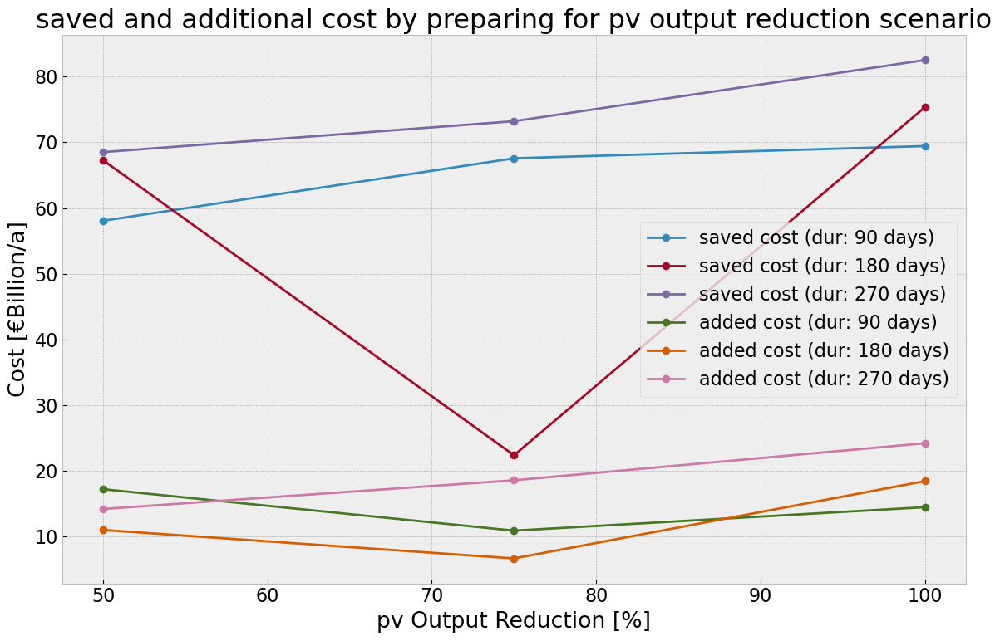

In [115]:
#rename index
cost_df = pd.concat([senscost_df, addcost_df], axis=1)

new_index = [(x - 1) * -100 for x in sens_reductionto]
cost_df.index = new_index


# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Plot each column in the DataFrame
for column in cost_df.columns:
    ax.plot(cost_df.index, cost_df[column], marker='o', label=column)

# Add labels and legend
ax.set_xlabel(f'{contingency} Output Reduction [%]')
ax.set_ylabel('Cost [€Billion/a]')
ax.set_title(f'saved and additional cost by preparing for {contingency} output reduction scenario')
ax.legend()

# Show the plot
plt.xticks()  # Rotate x-axis labels if necessary
plt.tight_layout()  # Adjust layout to make room for labels

# Save plot to the current working directory
filename = f"sens_saved_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()



### Built Generator & Storage Capacities

In [116]:
#create a country based generator capacity df for every investment models 
modname_iteration = []
red_iteration = []
dur_iteration = []

for red in sens_reductionto:
    for dur in sens_duration:
        #senscost_df[f'n_{red_sanitized}_{dur_sanitized}'] = [0]
        
        for mod in models:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_{mod}' 

            
            #model as variable
            model =  globals()[mod_name]

            if mod == 'inv_roll':
                #append modname list
                modname_iteration.append(f'n_{red_sanitized}_{dur_sanitized}_inv_roll')
                red_iteration.append(red)
                dur_iteration.append(dur)

                # cap table
                capacities = model.generators
                capacities['country'] = capacities['bus'].str[:2]
                capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
                capacities.fillna(0, inplace=True)
                #print(capacities)
                globals()[f'{mod_name}_cap_country'] = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
                globals()[f'{mod_name}_cap_country'].fillna(0, inplace=True)

                #sto table
                storage = n.storage_units
                storage['country'] = storage['bus'].str[:2]

                globals()[f'{mod_name}_sto_country'] = (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000) #GW
                globals()[f'{mod_name}_sto_country'].fillna(0, inplace=True)


                #create empty df for transmission
                trans_df = {
                    'Country' : cap_base_country.index,
                    'AC': np.zeros(len(cap_base_country.index)),
                    'DC': np.zeros(len(cap_base_country.index))
                }

                trans_df = pd.DataFrame(trans_df)
                trans_df.set_index('Country', inplace=True)
    
                #AC
                ac_df = model.lines
                ac_df['country'] = ac_df['bus0'].str[:2]
                ac_df = ac_df.groupby(['country', 'carrier']).s_nom_opt.sum()
                ac_df.fillna(0, inplace=True)
                ac_df = ac_df.unstack().div(1e3) #GVA
            
                #DC
                dc_df = model.links
                dc_df['country'] = dc_df['bus0'].str[:2]
                dc_df = dc_df.groupby(['country', 'carrier']).p_nom_opt.sum()
                dc_df.fillna(0, inplace=True)
                dc_df = dc_df.unstack().div(1e3) #GW

                #fill empty df with AC Cap
                for index, row in trans_df.iterrows():
                    if index in ac_df.index:
                        try:
                            trans_df.loc[index, 'AC'] = ac_df.loc[index, 'AC']
                        except KeyError: 
                            trans_df.loc[index, 'AC'] = 0

                #fill empty df with DC Cap
                for index, row in trans_df.iterrows():
                    if index in dc_df.index:
                        try:
                            trans_df.loc[index, 'DC'] = dc_df.loc[index, 'DC']
                        except KeyError: 
                            trans_df.loc[index, 'DC'] = 0


                #trans_df = pd.concat([ac_df, dc_df], axis=1)
                #trans_df.fillna(0, inplace=True)
                globals()[f'{mod_name}_trans'] = trans_df
                #globals()[f'{mod_name}_trans_country'] = trans_df
                

#### Bar Plot

In [117]:
# Define a color map using a color palette with 12 contrasting colors
colors = sns.color_palette("tab20", 13)  # 12 contrasting colors

# Mapping countries to colors
country_colors = {
    'AT': colors[0],
    'BE': colors[1],
    'CH': colors[2],
    'CZ': colors[3],
    'DE': colors[4],
    'DK': colors[5],
    'FR': colors[6],
    'GB': colors[7],
    'LU': colors[8],
    'NL': colors[9],
    'NO': colors[10],
    'PL': colors[11],
    'SE': colors[12]  # Reusing the first color for 'SE' to ensure there are 12 colors
}

In [118]:
extendables = ['OCGT', 'solar','onwind', 'offwind-dc', 'offwind-ac']

for e in extendables:

    e_sanitized = sanitize_variable_name(str(e))

    #Cap Sensitivity df
    globals()[f'sens_{e_sanitized}'] = {
        'Scenario' : ['Base Roll'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_sens_df'] = pd.DataFrame(globals()[f'sens_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if index != 'Base Roll':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_cap_country']

            for index, row in globals()[f'{e_sanitized}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_sens_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_sens_df'].drop(columns = ['Days', 'Reductionto'])
    

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2.8192' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '4.5323' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_sens_df'].loc['Base Roll', i] = cap_base_roll_country.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\298830397.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '22.8885365' has dtype incompatible with 

In [119]:
extendables_plot = {'OCGT', 'solar', 'onwind', 'offwind'}
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

element_to_ax

{'solar': 0, 'onwind': 1, 'OCGT': 2, 'offwind': 3}

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\2299092162.py:51: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

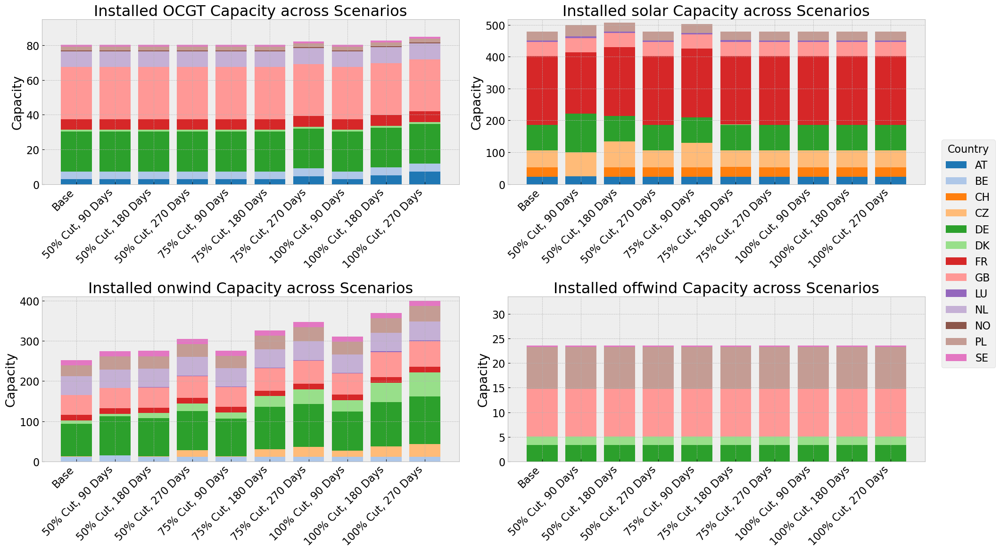

In [120]:
# combine offwind ac and dc
offwind_pivot_df = offwind_ac_pivot_df.select_dtypes(include='number') + offwind_dc_pivot_df.select_dtypes(include='number')
offwind_pivot_df

extendables_plot = ['OCGT', 'solar', 'onwind', 'offwind']

# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(extendables_plot)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()


### Built Storage Capacities

In [121]:
sto_type = n.storage_units.carrier.unique() 

for e in sto_type:

    #e_sanitized = sanitize_variable_name(str(e))

    #sto Sensitivity df
    globals()[f'sens_{e}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e}_sens_df'] = pd.DataFrame(globals()[f'sens_{e}'])

    #add column countries
    for country in store_base_df.index:
        globals()[f'{e}_sens_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e}_sens_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in store_base_df.index:
        globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e}_sens_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e}_sens_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            sto_df =  globals()[f'{mod_name}_sto_country']

            for index, row in globals()[f'{e}_sens_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e}_sens_df'].loc[index, i] = sto_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e}_pivot_df'] = globals()[f'{e}_sens_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.057300000000001' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '1.308' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e}_sens_df'].loc['Base', i] = store_base_df.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\278823690.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '5.089549999999999' has dtype incompatible with int64, please explicitly cast

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\4103942615.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, 

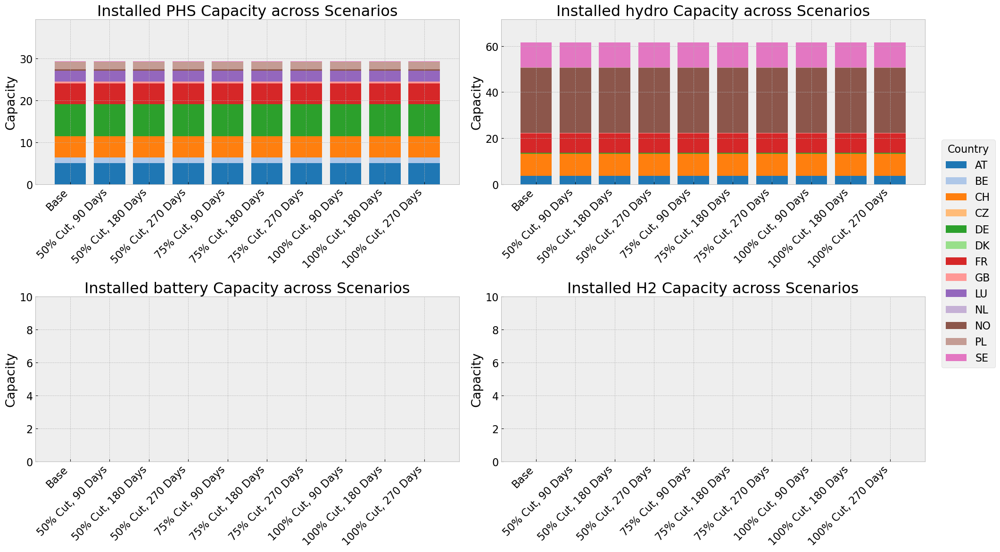

In [122]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(20,12))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(sto_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()

### Transmission Cap

In [123]:
line_type = ['AC', 'DC']

for e in line_type:

    e_sanitized = sanitize_variable_name(str(e))

    #trans Sensitivity df
    globals()[f'trans_{e_sanitized}'] = {
        'Scenario' : ['Base'] + modname_iteration,
        'Days' : [0] + dur_iteration,
        'Reductionto' : [0] + red_iteration
    }

    globals()[f'{e_sanitized}_trans_df'] = pd.DataFrame(globals()[f'trans_{e_sanitized}'])

    #add column countries
    for country in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'][country] = 0

    # Set the 'Scenario' column as the index
    globals()[f'{e_sanitized}_trans_df'].set_index('Scenario', inplace=True)
    
    # enter base capacitites
    for i in cap_base_country.index:
        globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]

    #edit reduction to column in %
    for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if index != 'Base':
                    new_red = (row['Reductionto']-1)* -100
                    globals()[f'{e_sanitized}_trans_df'].loc[index, 'Reductionto'] = new_red    

    for red in sens_reductionto:
        for dur in sens_duration:

            # Sanitize the names to be valid Python variable names
            red_sanitized = sanitize_variable_name(str(red))
            dur_sanitized = sanitize_variable_name(str(dur))

            # Variable names for models
            mod_name = f'n_{red_sanitized}_{dur_sanitized}_inv_roll' 

            #cap table as variable
            cap_df =  globals()[f'{mod_name}_trans']

            for index, row in globals()[f'{e_sanitized}_trans_df'].iterrows():
                if mod_name == index:
                    scen = index
                    for i in cap_base_country.index:
                        #condition = (cap_df['Scenario'] == mod_name)
                        #globals()[f'{e_sanitized}_sens_df'].loc[condition, i].values[0] = cap_df.loc[i,e]
                        #print(f'{scen}, {mod_name}, {index}, {i}')
                        globals()[f'{e_sanitized}_trans_df'].loc[index, i] = cap_df.loc[i, e]

    
    # Pivot the DataFrame to get the data in the right shape for stacking
    globals()[f'{e_sanitized}_pivot_df'] = globals()[f'{e_sanitized}_trans_df'].drop(columns = ['Days', 'Reductionto'])

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '27.214328698683715' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '17.249147582416935' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  globals()[f'{e_sanitized}_trans_df'].loc['Base', i] = trans_base_pv.loc[i,e]
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\1851231033.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '36.91138834993883' has dtype incompat

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_9440\3519662137.py:45: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(scen_tick, rotation=45, ha='right')


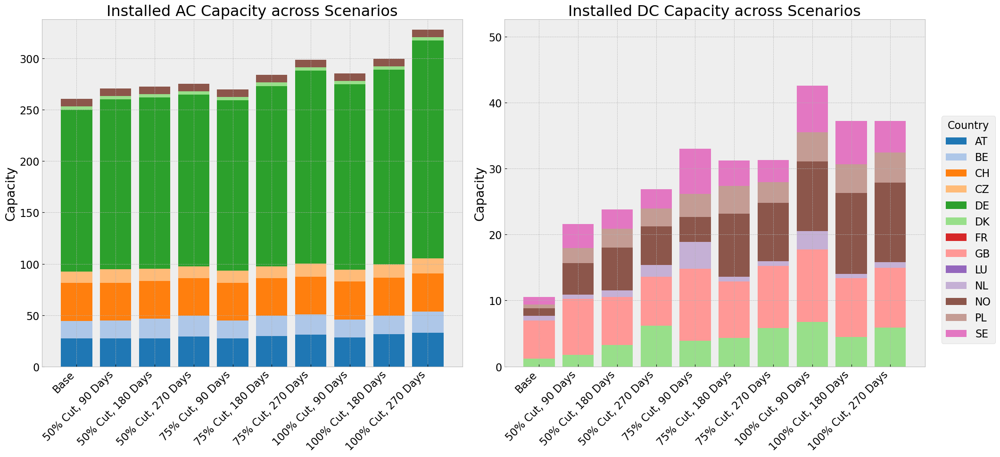

In [124]:
# Plotting with the legend outside and adjusting xticks
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
axes = axes.flatten()

# Define a dictionary to map each element to a specific subplot
element_to_ax = {element: i for i, element in enumerate(line_type)}

# Variable to store handles and labels for the legend
handles = []
labels = []

# Plotting each element in its corresponding subplot
for e, i in element_to_ax.items():

    ax = axes[i]
    # Plot the stacked bar chart with specified colors
    bottom = np.zeros(len(globals()[f'{e}_pivot_df']))
    for country in globals()[f'{e}_pivot_df'].columns:
        bars = ax.bar(globals()[f'{e}_pivot_df'].index, globals()[f'{e}_pivot_df'][country], label=country, color=country_colors[country], bottom=bottom)
        bottom += globals()[f'{e}_pivot_df'][country].values
    
    # Add labels, title
    ax.set_xlabel('')
    ax.set_ylabel('Capacity')
    ax.set_ylim([0, max(bottom)+10])
    ax.set_title(f'Installed {e} Capacity across Scenarios')

    # Move the legend outside the plot
    ax.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left')

    # Adjust xticks so that labels are centered
    #ax.set_xticks(ax.get_xticks())

    # Set xticks
    scen_tick = []
    for index, row in offwind_ac_sens_df.iterrows():
        red = int(row['Reductionto'])
        dur = int(row['Days'])

        if red == 0 and dur == 0:
            scen_tick.append('Base')
        else:
            scen_tick.append(f'{red}% Cut, {dur} Days')    

    ax.set_xticklabels(scen_tick, rotation=45, ha='right')

    # Capture handles and labels for the legend
    handle, label = ax.get_legend_handles_labels()
    handles.extend(handle)
    labels.extend(label)
        
# Remove legend from individual subplots
for ax in axes:
    ax.legend().remove()

# Adjust layout to make room for the legend
plt.tight_layout()

# Create a single legend outside the plot
fig.legend(handles[:len(country_colors)], labels[:len(country_colors)], title='Country', bbox_to_anchor=(1, 0.75), loc='upper left')

# Save plot to the current working directory
filename = "sens_sto.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path, bbox_inches='tight')

plt.show()